In [1]:

%reload_ext autoreload
%autoreload 2

import numpy as np
import matplotlib.pyplot as plt

from qick import *
from qick.helpers import gauss
from tqdm import tqdm_notebook as tqdm

import time
import os
import sys
sys.path.append('/home/xilinx/jupyter_notebooks/')
sys.path.append('C:\\_Lib\\python\\rfsoc\\rfsoc_multimode\\example_expts')
import scipy as sp
import json
from scipy.fft import fft, fftfreq

from slab.instruments import *
from slab.experiment import Experiment
from slab.datamanagement import SlabFile
from slab import get_next_filename, AttrDict
from slab import Experiment, dsfit, AttrDict

# Figure params
plt.rcParams['figure.figsize'] = [10,6]
plt.rcParams.update({'font.size': 14})

Warning serial library import failed.
Could not load InstrumentManagerWindow
Could not import QickInstrument, try install qick package
Could not load AD5780 dac 
Could not load labbrick
Could not load Autonics TM4 Driver


In [2]:
from slab.dsfit import *
import os
from scipy.interpolate import griddata
from numpy import mgrid, array, zeros,abs,pi,cos,transpose, linspace
from matplotlib.ticker import MultipleLocator, FormatStrFormatter
from tempfile import TemporaryFile
font = {'family' : 'DejaVu Sans',
        'weight' : 'normal',
        'size'   : 15}
import json
from h5py import File
from datetime import datetime
import time
from slab.datamanagement import SlabFile
import matplotlib.pyplot as plt
import numpy as np
import os
import json
from slab.dsfit import *
from scipy.optimize import curve_fit
# import experiments.fitting as fitter
from numpy.linalg import inv

## Import modules from parent and multimode expts

In [3]:
import json
import os

# Get the current working directory
path = os.getcwd()
print("Current Path:", path)

# Isolate the parent directory
parent_path = os.path.dirname(path)
print("Parent Path:", parent_path)

# Add the parent path to the sys.path
sys.path.append(parent_path)

Current Path: c:\_Lib\python\multimode_expts\analysis_notebooks
Parent Path: c:\_Lib\python\multimode_expts


In [4]:
import sys

# Path to add
expts_path = 'C:\\_Lib\\python\\multimode_expts'

# Add the path to the system path at the highest priority
if expts_path not in sys.path:
    sys.path.insert(0, expts_path)
    print('Path added at highest priority')

# Verify the path is added
print(sys.path)


Path added at highest priority
['C:\\_Lib\\python\\multimode_expts', 'c:\\_Lib\\python\\multimode_expts\\analysis_notebooks', 'C:\\_Lib\\python', 'C:\\_Lib\\python\\slab', 'C:\\_Lib\\python\\qick\\qick_lib', 'C:\\_Lib\\python\\rfsoc\\rfsoc_multimode\\example_expts', 'c:\\_Lib\\python\\multimode_expts\\analysis_notebooks', 'c:\\Users\\26049\\.conda\\envs\\slab\\python38.zip', 'c:\\Users\\26049\\.conda\\envs\\slab\\DLLs', 'c:\\Users\\26049\\.conda\\envs\\slab\\lib', 'c:\\Users\\26049\\.conda\\envs\\slab', '', 'C:\\Users\\26049\\AppData\\Roaming\\Python\\Python38\\site-packages', 'c:\\Users\\26049\\.conda\\envs\\slab\\lib\\site-packages', 'c:\\Users\\26049\\.conda\\envs\\slab\\lib\\site-packages\\easy_lmfit-1.0-py3.8.egg', 'c:\\Users\\26049\\.conda\\envs\\slab\\lib\\site-packages\\attrdict-2.0.1-py3.8.egg', 'c:\\Users\\26049\\.conda\\envs\\slab\\lib\\site-packages\\win32', 'c:\\Users\\26049\\.conda\\envs\\slab\\lib\\site-packages\\win32\\lib', 'c:\\Users\\26049\\.conda\\envs\\slab\\lib\\s

In [5]:
from multimode_expts.fit_display import *

importing from path  C:\_Lib\python\multimode_expts\experiments\clifford_averager_program.py
imported experiments.clifford_averager_program
importing from path  C:\_Lib\python\multimode_expts\experiments\fitting.py
imported experiments.fitting
importing from path  C:\_Lib\python\multimode_expts\experiments\qram_protocol_timestepped.py
imported experiments.qram_protocol_timestepped
importing from path  C:\_Lib\python\multimode_expts\experiments\qubit_cavity
imported experiments.qubit_cavity.amplitude_rabi_f0g1
imported experiments.qubit_cavity.displacement_enhanced_sideband
imported experiments.qubit_cavity.displace_amplitude_calibration
imported experiments.qubit_cavity.displace_pulse_probe
imported experiments.qubit_cavity.ecd
imported experiments.qubit_cavity.ecd_backup
imported experiments.qubit_cavity.ecd_read_spec
imported experiments.qubit_cavity.non_demolution_readout
imported experiments.qubit_cavity.out_and_back
imported experiments.qubit_cavity.photo_resolved_pulse_probe
impo

In [6]:
import experiments.fitting as fitter
from numpy.linalg import inv

# Exp path

In [8]:

# print("path: ", path)

"""Reopen saved data"""
def prev_data(expt_path, filename):
    temp_data_file = expt_path+'\\'+filename
    with SlabFile(temp_data_file) as a:
        attrs = dict()
        for key in list(a.attrs):
            attrs.update({key:json.loads(a.attrs[key])})
        keys = list(a)
        temp_data = dict()
        for key in keys:
            temp_data.update({key:np.array(a[key])})
        # print(f'Extracted data and attrs {list(a.attrs)}')
    return temp_data, attrs
data_parent =  r'H:\Shared drives\SLab\Multimode\experiment\240911'
expt_path=data_parent+'\\data1'
print('Data are extracted from', expt_path)

Data are extracted from H:\Shared drives\SLab\Multimode\experiment\240911\data1


# Actual experiment data

## Single shot

19838
19687
Unrotated:
Ig -250.32142857142856 +/- 66.23934493551388 	 Qg -319.72402597402595 +/- 57.043516682890754 	 Amp g 406.05944193809904
Ie 230.5064935064935 +/- 88.11596311727264 	 Qe -307.3376623376623 +/- 60.028258950050656 	 Amp e 384.1740259828065
Rotated:
Ig -258.3947767235094 +/- 66.23934493551388 	 Qg -313.20311481932976 +/- 57.043516682890754 	 Amp g 406.03454504576644
Ie 222.45886140149454 +/- 88.11596311727264 	 Qe -313.0550922899666 +/- 60.028258950050656 	 Amp e 384.04613762506307


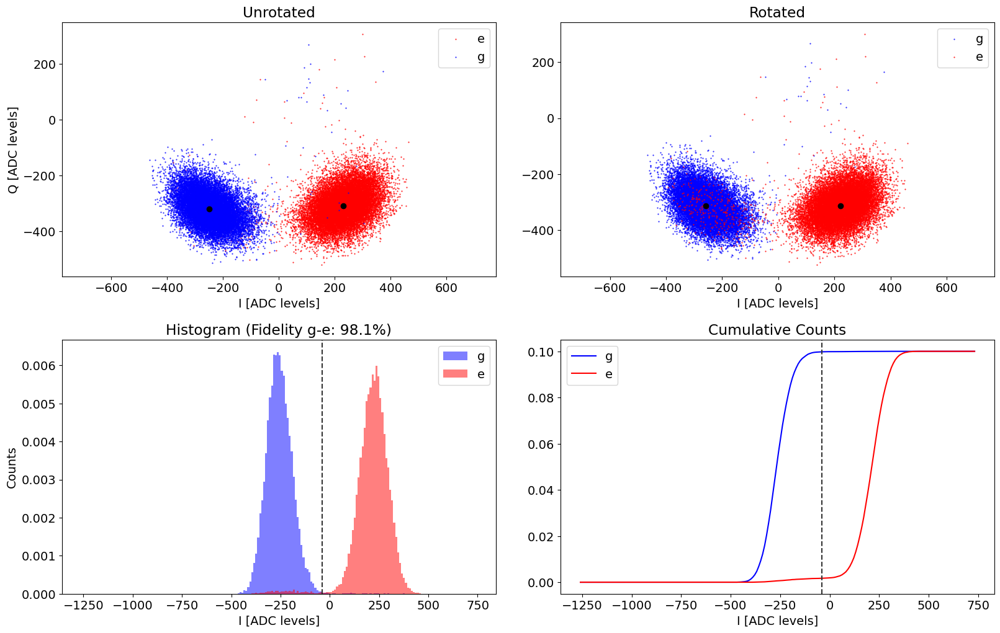

ge fidelity (%): 98.07645694026732
rotation angle (deg): -1.4756410900011336
threshold ge: -38.394776723509494
Confusion matrix [Pgg, Pge, Peg, Pee]:  [0.9979332594011494, 0.0020667405988505916, 0.017168689998476146, 0.9828313100015239]


In [9]:
temp_data, attrs = prev_data(expt_path, '00000_HistogramExperiment.h5')
# temp_data, attrs = prev_data(expt_path, '00000_HistogramExperiment.h5')
hist_display(temp_data, verbose=True, plot_f=False, active_reset=True, readout_per_round=4, span=1000, threshold=-40)#1000)

In [8]:
170.3273945474872 + 15.199855133484542 -180

5.527249680971721

### gef

Unrotated:
Ig 18.639024390243904 +/- 3.506033161195599 	 Qg -13.07479674796748 +/- 2.3583669287044855 	 Amp g 22.76759847284663
Ie -8.697560975609756 +/- 4.957793965714124 	 Qe -12.123577235772357 +/- 2.8829022240889848 	 Amp e 14.9207470294281
If -13.151219512195121 +/- 5.714079193761396 	 Qf 0.8999999999999999 +/- 5.205738847992782 	 Amp f 13.18197916315838
Rotated:
Ig 18.39273065405836 +/- 3.506033161195599 	 Qg 13.366472521564962 +/- 2.3583669287044855 	 Amp g 22.736647259050518
Ie 8.700480401530942 +/- 4.957793965714124 	 Qe -12.16322086930425 +/- 2.8829022240889848 	 Amp e 14.954674892250333
If -5.136710320567454 +/- 5.714079193761396 	 Qf -12.226105794830014 +/- 5.205738847992782 	 Amp f 13.261351960633586


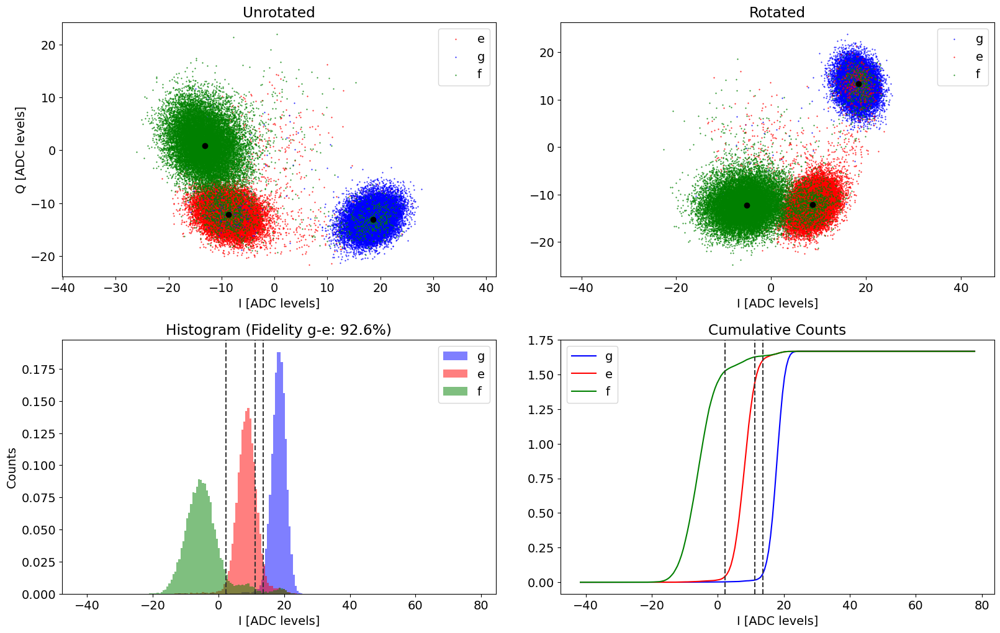

ge fidelity (%): 92.58000000000001
gf fidelity (%): 96.62999999999998
ef fidelity (%): 88.99499999999999
rotation angle (deg): 71.12090674396606
threshold ge: 13.592730654058357
Confusion matrix [Pgg, Pge, Peg, Pee]:  [0.035250000000000024, 0.96475, 0.96105, 0.03895000000000004]
threshold gf: 11.192730654058359
threshold ef: 2.1927306540583587


In [2273]:
temp_data, attrs = prev_data(expt_path, '00130_HistogramExperiment.h5')
hist_display(temp_data, verbose=True, plot_f=True, active_reset=False, readout_per_round=4, span=60, threshold=-4.493949739633393)#1000)

### With JPA on

Unrotated:
Ig -15.573746312684365 +/- 3.190871972486026 	 Qg -17.654867256637168 +/- 3.758289909147851 	 Amp g 23.54221553000756
Ie -22.327433628318584 +/- 3.2362201838950586 	 Qe 7.567846607669617 +/- 4.855753473765923 	 Amp e 23.575126610565384
Rotated:
Ig -13.054652252835577 +/- 3.190871972486026 	 Qg 19.55742074160535 +/- 3.758289909147851 	 Amp g 23.51417979659593
Ie 13.07920509998489 +/- 3.2362201838950586 	 Qe 19.59629992920956 +/- 4.855753473765923 	 Amp e 23.5601480675103


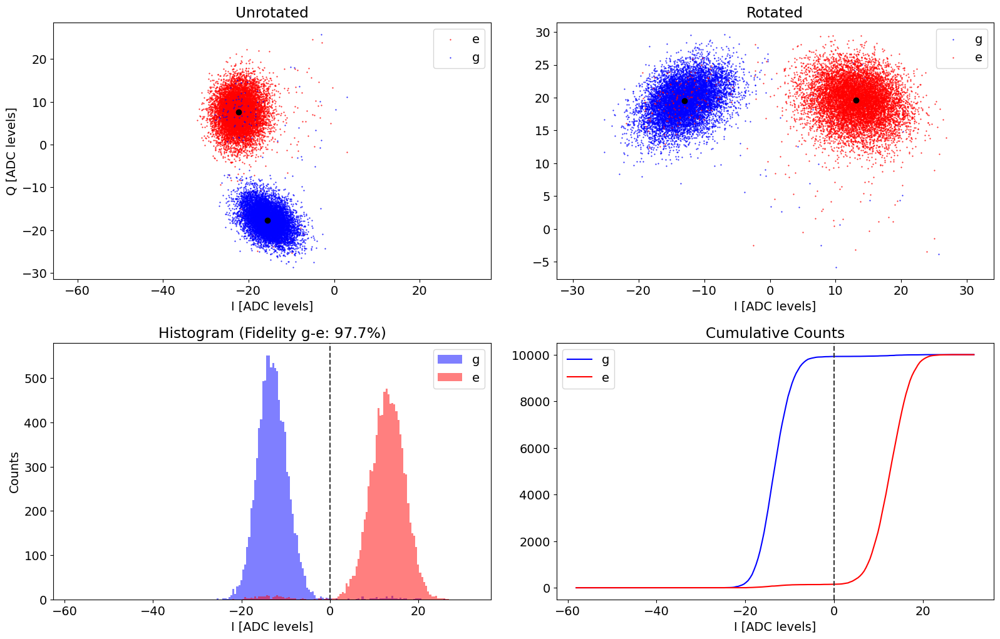

ge fidelity (%): 97.74000000000001
rotation angle (deg): -104.98999902819394
threshold ge: -0.004652252835576576
Confusion matrix [Pgg, Pge, Peg, Pee]:  [0.9923, 0.00770000000000004, 0.0149, 0.9851]


In [110]:
temp_data, attrs = prev_data(expt_path, '00090_HistogramExperiment.h5')
hist_display(temp_data, verbose=True, plot_f=False, span=45)

### Single shot sweep

In [208]:
file_list = np.arange(0,20,1)
vary_pts = np.concatenate([np.arange(3567.1143637946836, 3567.7043637946836, 0.06),np.arange(3567.7143637946836, 3568.3143637946836, 0.06)])
# vary_pts = np.arange(3567.1143637946836, 3567.7143637946836, 0.06)
fids_list = []
conf_m_list = []
freq_list = []
name = '_HistogramExperiment_freq_sweep.h5'
i = 0
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    fids, thresholds, angle, confusion_matrix = hist_display_sweep(temp_data, verbose=False, plot_f=False, span=45)
    fids_list.append(fids)
    conf_m_list.append(confusion_matrix)
    freq_list.append(vary_pts[i])
    i += 1


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


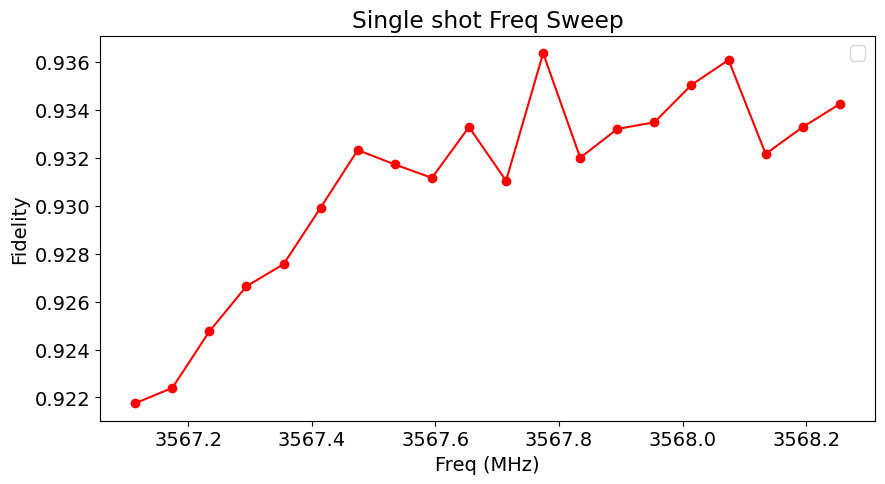

In [209]:
plt.figure(figsize=(10,5))
plt.subplot(111, title='Single shot Freq Sweep',  ylabel="Fidelity", xlabel="Freq (MHz)")
plt.plot(freq_list, fids_list,'-o',color='r')
# plt.axvline([3567.920628692002], color='b', ls='--', label='Ramsey Freq')
# plt.axvline([3567.1], color='g', ls='--', label='Max Fiedlity Frequency')
plt.legend()

#### Sweeping ef fidelity

In [159]:
file_list = np.arange(21,32,1)
# vary_pts = np.concatenate([np.arange(3566.2228027506, 3566.6228027506, 0.04),np.arange(3566.6228027506, 3567.0228027506, 0.04),np.arange(3567.0228027506, 3567.4228027506, 0.04)])
vary_pts = np.arange(3422.4015098021477, 3423.8015098021477, 0.04)
fids_list = []
conf_m_list = []
freq_list = []
name = '_HistogramExperiment_ef_freq_sweep.h5'
i = 0
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    fids, thresholds, angle, confusion_matrix = hist_display_sweep(temp_data, verbose=False, plot_f=True, span=45)
    fids_list.append(fids[2])
    conf_m_list.append(confusion_matrix)
    freq_list.append(vary_pts[i])
    i += 1

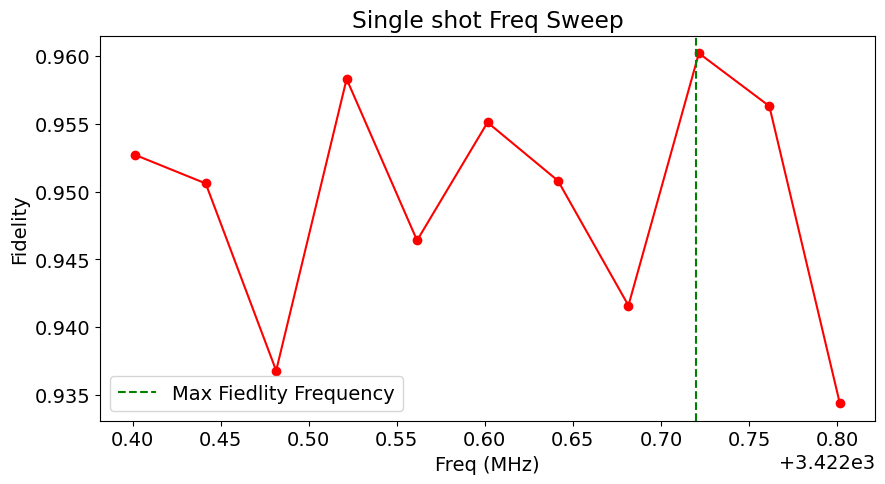

In [164]:
plt.figure(figsize=(10,5))
plt.subplot(111, title='Single shot Freq Sweep',  ylabel="Fidelity", xlabel="Freq (MHz)")
plt.plot(freq_list, fids_list,'-o',color='r')
# plt.axvline([3567.920628692002], color='b', ls='--', label='Ramsey Freq')
plt.axvline([3422.72], color='g', ls='--', label='Max Fiedlity Frequency')
plt.legend()

### prepulse with active reset

Ig -15.998376623376624 +/- 11.415928261725103 	 Qg 17.344155844155843 +/- 4.0716858373289035 	 Amp g 23.595927541204414
7968
|e> population (%): 18.80986346036275


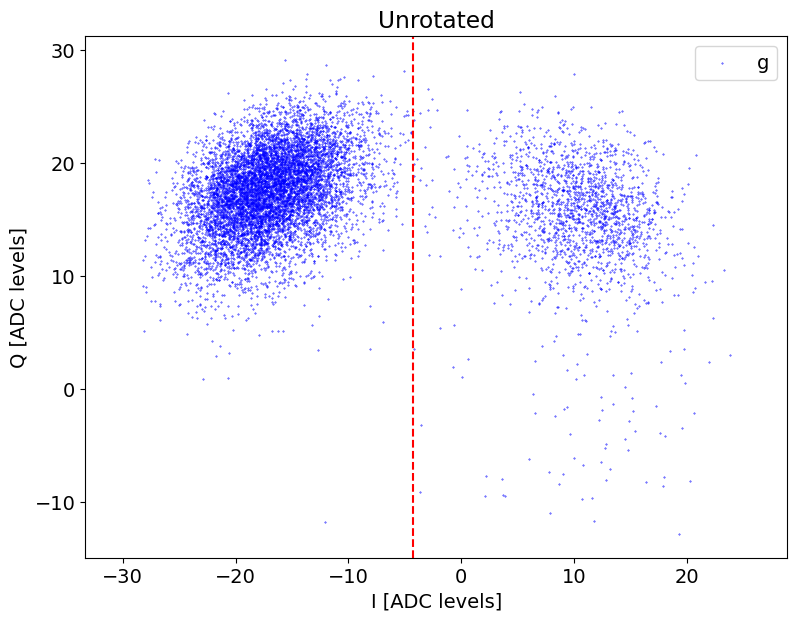

In [2134]:
# cavity 1, qubit pi/2, delay, qubit pi/2
temp_data, attrs = prev_data(expt_path, '00019_HistogramPrepulseExperiment.h5')
hist_new_display(temp_data, -4.3, verbose=True, plot_f=False, active_reset=True, readout_per_round=4, span=60, threshold=-4.3)

### Sweeping parity time

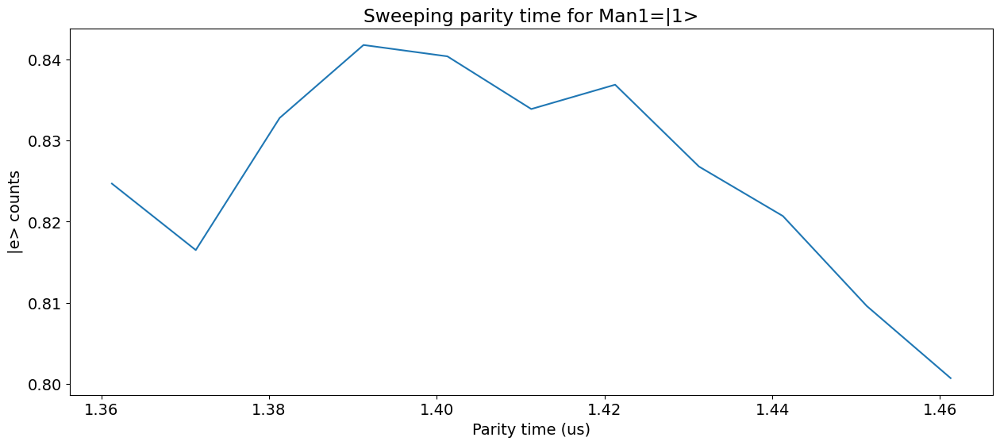

In [203]:
file_list = np.arange(32,43,1)
vary_pts = arange(1.3612596565537676, 1.9612596565537676,0.01)
y_list = []
name = '_single_shot_parity_time_sweep.h5'
for file_no in file_list:
    count = 0   # how many points possibly |f>
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef

    Ig = temp_data['I']
    Qg = temp_data['Q']
    for i in range(len(Ig)):
        if Ig[i] > -0.33093143003480563 :
            count += 1

    y_list.append(count/attrs['config']['expt']['reps'])
plt.figure(figsize = (15,6))
plt.subplot(111,xlabel='Parity time (us)',ylabel='|e> counts')
plt.title("Sweeping parity time for Man1=|1>")
plt.plot(vary_pts[0:len(y_list)], np.array(y_list))
# plt.axvline(140, color='r', ls='--')

### Sweeping f0-g1 time

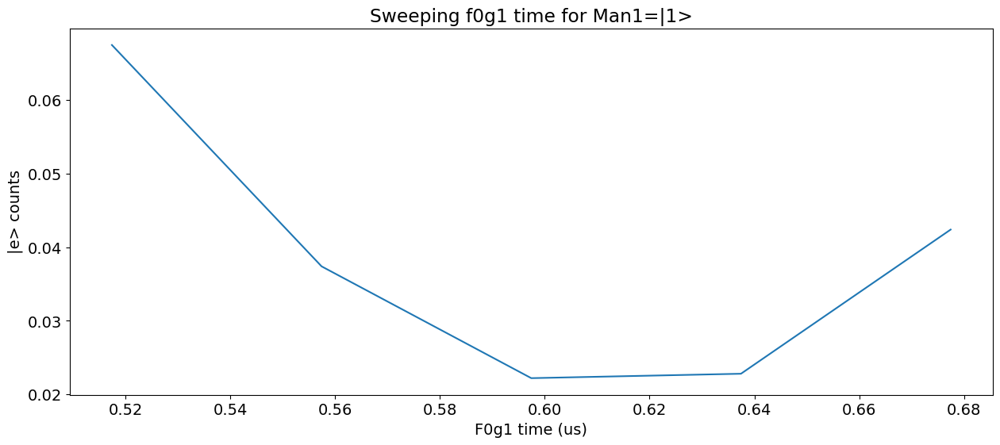

In [238]:
file_list = np.arange(43,48,1)
vary_pts = np.concatenate([np.arange(0.517429846443048, 0.717429846443048,0.04)])
y_list = []
name = '_single_shot_parity_time_sweep.h5'
for file_no in file_list:
    count = 0   # how many points possibly |f>
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef

    Ig = temp_data['I']
    Qg = temp_data['Q']
    for i in range(len(Ig)):
        if Ig[i] > -0.7696065582610032 :
            count += 1

    y_list.append(count/attrs['config']['expt']['reps'])
plt.figure(figsize = (15,6))
plt.subplot(111,xlabel='F0g1 time (us)',ylabel='|e> counts')
plt.title("Sweeping f0g1 time for Man1=|1>")
plt.plot(vary_pts[0:len(y_list)], np.array(y_list))
# plt.axvline(140, color='r', ls='--')

### Sweeping f0-g1 frequency

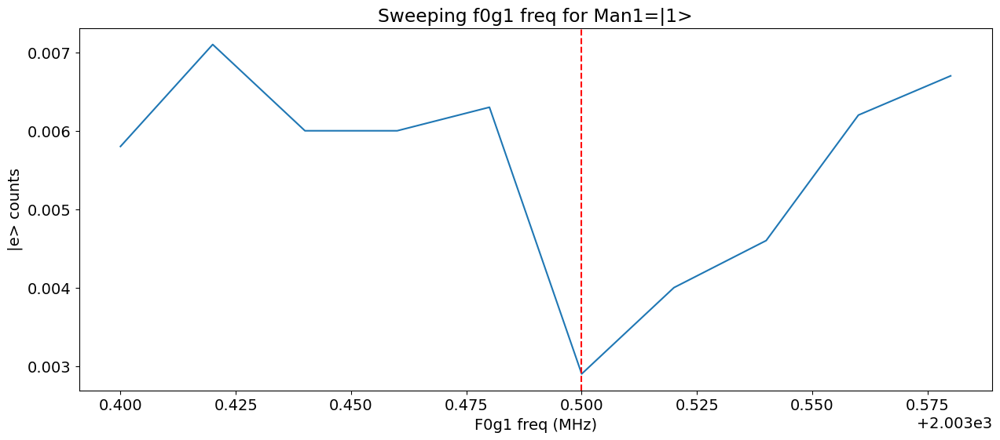

In [295]:
file_list = np.arange(46,56,1)
vary_pts = np.concatenate([arange(2003.4, 2003.6,0.02)])
y_list = []
name = '_single_shot_freq_sweep.h5'
for file_no in file_list:
    count = 0   # how many points possibly |f>
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef

    Ig = temp_data['I']
    Qg = temp_data['Q']
    for i in range(len(Ig)):
        if Ig[i] > 4.1684334808715064 :
            count += 1

    y_list.append(count/attrs['config']['expt']['reps'])
plt.figure(figsize = (15,6))
plt.subplot(111,xlabel='F0g1 freq (MHz)',ylabel='|e> counts')
plt.title("Sweeping f0g1 freq for Man1=|1>")
plt.plot(vary_pts[0:len(y_list)], np.array(y_list))
plt.axvline(2003.5, color='r', ls='--')

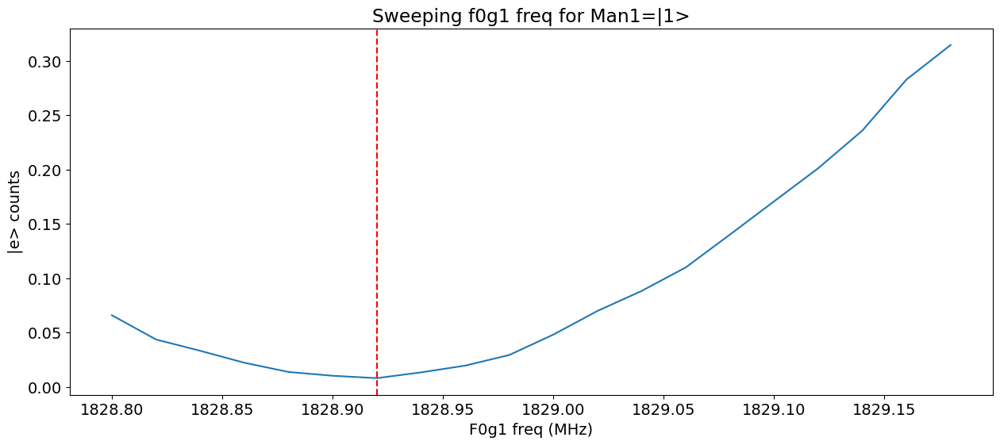

In [318]:
file_list = np.arange(56,76,1)
vary_pts = np.concatenate([arange(1828.8, 1829.2,0.02)])
y_list = []
name = '_single_shot_freq_sweep.h5'
for file_no in file_list:
    count = 0   # how many points possibly |f>
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef

    Ig = temp_data['I']
    Qg = temp_data['Q']
    for i in range(len(Ig)):
        if Ig[i] > 3.7616426080618837 :
            count += 1

    y_list.append(count/attrs['config']['expt']['reps'])
plt.figure(figsize = (15,6))
plt.subplot(111,xlabel='F0g1 freq (MHz)',ylabel='|e> counts')
plt.title("Sweeping f0g1 freq for Man1=|1>")
plt.plot(vary_pts[0:len(y_list)], np.array(y_list))
plt.axvline(1828.92, color='r', ls='--')

#### f0g1 swap on f0g1 phase 

[ 4.76400000e-01  2.78119863e-03 -9.09655089e+01  5.04086108e-01]
Pi length from avgi data: 180.742922658877
	Pi/2 length from avgi data: 90.3714613294385


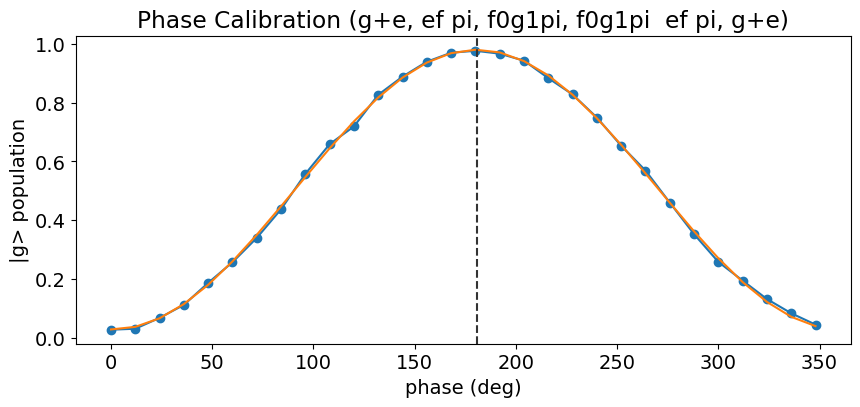

In [221]:
# file_list = np.arange(1495, 1526,1)
# file_list = np.arange(1565, 1591,1)
# file_list = np.arange(1592, 1597,1)
# file_list = np.arange(1600, 1620,1)
# file_list = np.arange(1623, 1628,1)
# file_list = np.arange(1633, 1664,1)
file_list = np.arange(1664, 1695,1)
vary_pts = np.arange(0, 361,12)
y_list = []
active_reset = False
threshold = -4.1
name = '_single_shot_phase_sweep.h5'
for file_no in file_list:
    count = 0   # how many points possibly |f>
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef

    # active reset:
    if active_reset:
        Ig, Qg = filter_data_IQ(temp_data['I'], temp_data['Q'],threshold, readout_per_experiment=4)
        total_counts = len(Ig)
        # Ig = I_selected
    else:

        Ig = temp_data['I']
        Qg = temp_data['Q']
        total_counts = len(Ig)
    for i in range(len(Ig)):
        if Ig[i] < threshold :
            count += 1

    y_list.append(count/total_counts)
xpts_ns = vary_pts[:len(y_list)]
phase_calibration(xpts_ns, y_list, fitparams=None, title='Phase Calibration (g+e, ef pi, f0g1pi, f0g1pi  ef pi, g+e)')

In [178]:
(180+96.7676608682845) + (-1*360)

-83.23233913171549

### f0g1 phase offset on ge 

[1.39986235e-01 5.51852867e-03 2.14865124e+02 1.67000000e-01]
Pi length from avgi data: 118.3562637029145
	Pi/2 length from avgi data: 59.17813185145725


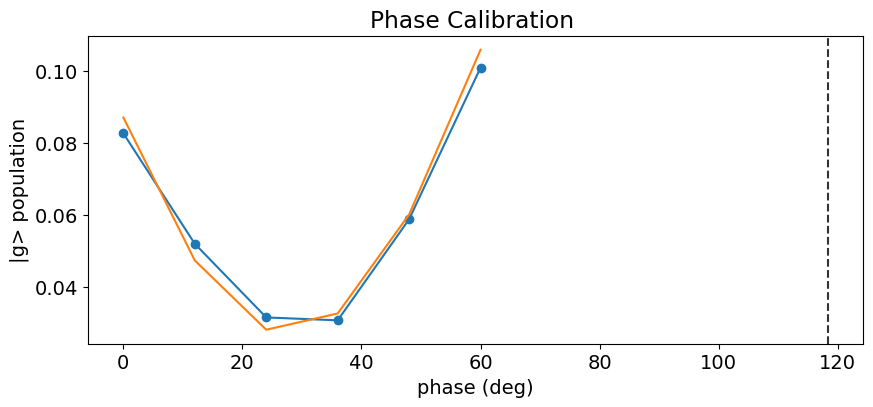

In [34]:
# file_list = np.arange(1861, 1892)
# file_list = np.arange(1942, 1972)
file_list = np.arange(1973, 1980)
vary_pts = np.arange(0, 361,12)
y_list = []
active_reset = False
threshold =  -50 #-40.69974573466379
name = '_single_shot_phase_sweep.h5'
for file_no in file_list:
    count = 0   # how many points possibly |f>
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef

    # active reset:
    if active_reset:
        Ig, Qg = filter_data_IQ(temp_data['I'], temp_data['Q'],threshold, readout_per_experiment=4)
        total_counts = len(Ig)
        # Ig = I_selected
    else:

        Ig = temp_data['I']
        Qg = temp_data['Q']
        total_counts = len(Ig)
    for i in range(len(Ig)):
        if Ig[i] < threshold :
            count += 1

    y_list.append(count/total_counts)
xpts_ns = vary_pts[:len(y_list)]
phase_calibration(xpts_ns, y_list, fitparams=None, title='Phase Calibration ')

In [232]:
247.34298131495413 - 180

67.34298131495413

### f0g1 phase offset on ef 

[4.60600000e-01 2.77700285e-03 1.19434837e+02 4.78948580e-01]
Pi length from avgi data: 150.60717858710814
	Pi/2 length from avgi data: 75.30358929355407


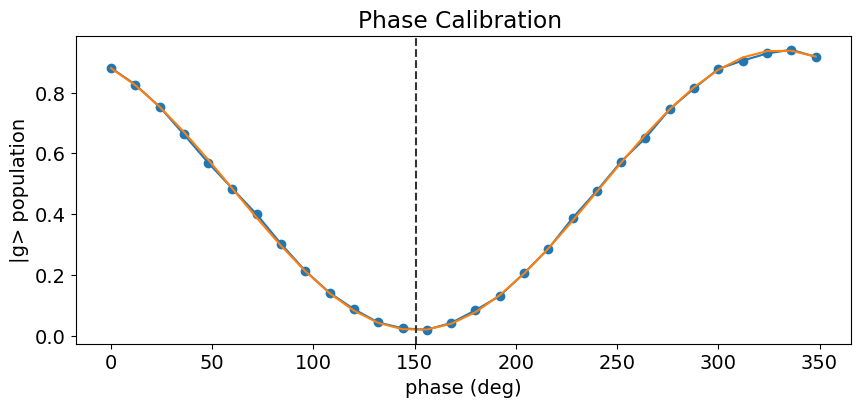

In [222]:
file_list = np.arange(1706, 1737)
vary_pts = np.arange(0, 361,12)
y_list = []
active_reset = False
threshold = -40.69974573466379
name = '_single_shot_phase_sweep.h5'
for file_no in file_list:
    count = 0   # how many points possibly |f>
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef

    # active reset:
    if active_reset:
        Ig, Qg = filter_data_IQ(temp_data['I'], temp_data['Q'],threshold, readout_per_experiment=4)
        total_counts = len(Ig)
        # Ig = I_selected
    else:

        Ig = temp_data['I']
        Qg = temp_data['Q']
        total_counts = len(Ig)
    for i in range(len(Ig)):
        if Ig[i] < threshold :
            count += 1

    y_list.append(count/total_counts)
xpts_ns = vary_pts[:len(y_list)]
phase_calibration(xpts_ns, y_list, fitparams=None, title='Phase Calibration ')

In [223]:
attrs['config']['expt']

{'reps': 5000,
 'qubits': [0],
 'prepulse': True,
 'active_reset': False,
 'man_reset': True,
 'pre_sweep_pulse': [[3568.1751638611518,
   3425.5537944060666,
   2007.08,
   2007.08,
   3425.5537944060666,
   3568.1751638611518],
  [10819, 3000, 15000, 15000, 3000, 10819],
  [0, 0.073291601301268, 0.609293, 0.609293, 0.073291601301268, 0],
  [0, 0, 0, 0, 360, 180],
  [2, 2, 0, 0, 2, 2],
  ['gaussian', 'flat_top', 'flat_top', 'flat_top', 'flat_top', 'gaussian'],
  [0.035, 0.005, 0.005, 0.005, 0.005, 0.035]]}

In [191]:
360 - (180 + 150.6051693498736)

29.394830650126437

### Ef swap on ge pulse

[4.79900000e-01 2.77469872e-03 7.70244959e+01 5.02619576e-01]
Pi length from avgi data: 193.18964708272625
	Pi/2 length from avgi data: 96.59482354136313


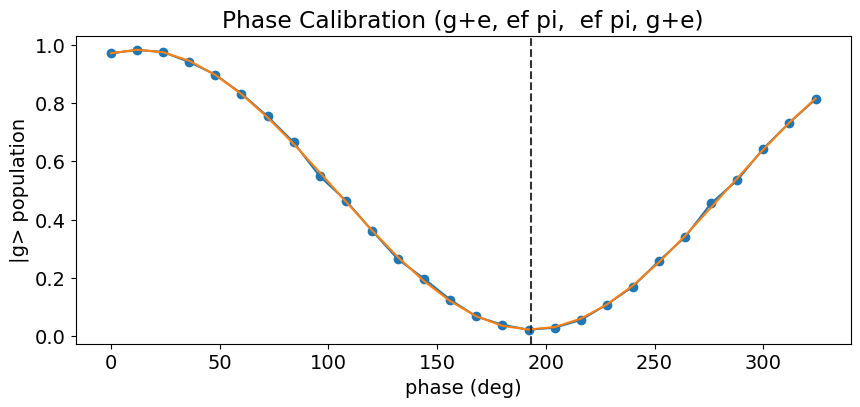

In [209]:
file_list = np.arange(1115, 1144)
vary_pts = np.arange(0, 361,12)
y_list = []
active_reset = False
threshold = -4.1
name = '_single_shot_phase_sweep.h5'
for file_no in file_list:
    count = 0   # how many points possibly |f>
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef

    # active reset:
    if active_reset:
        Ig, Qg = filter_data_IQ(temp_data['I'], temp_data['Q'],threshold, readout_per_experiment=4)
        total_counts = len(Ig)
        # Ig = I_selected
    else:

        Ig = temp_data['I']
        Qg = temp_data['Q']
        total_counts = len(Ig)
    for i in range(len(Ig)):
        if Ig[i] < threshold :
            count += 1

    y_list.append(count/total_counts)
xpts_ns = vary_pts[:len(y_list)]
phase_calibration(xpts_ns, y_list, fitparams=None, title='Phase Calibration (g+e, ef pi,  ef pi, g+e)')



In [210]:
193.18964708272625 - 180

13.189647082726253

#### With active reset

[ 5.01206813e-01  2.80498040e-03  7.53759733e+01  1.77025731e+04
  5.01052884e-01 -3.46369925e+02]
Pi length from avgi data: 192.73656800671765
	Pi/2 length from avgi data: 96.36828400335882


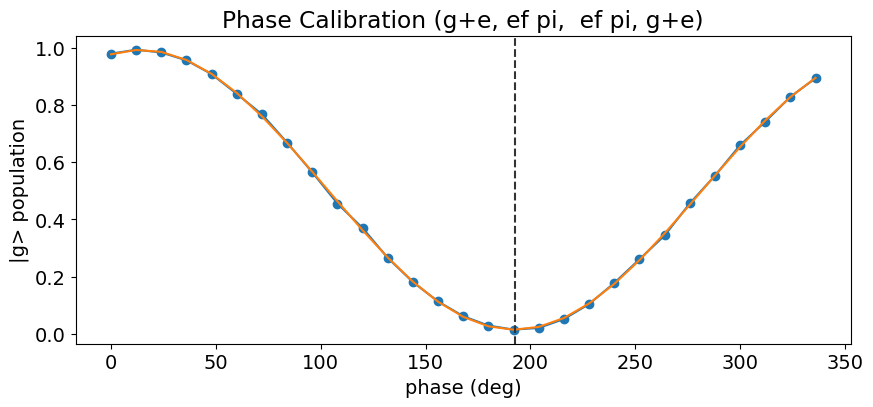

In [729]:
file_list = np.arange(1144, 1174) # 1 
# file_list = np.arange(1237, 1267) # same as above 
# file_list = np.arange(1270, 1301) # same sequence as 1 + pi/2ge (corrected phase), pi/2ge
# file_list = np.arange(1301, 1332) # same sequence as 1 + pi/2ge (uncorrected phase), pi/2ge
# file_list = np.arange(1332, 1362) # 2 sets of pi/2ge, pief, pief, pi/2ge, don't carry over phase
# OLD
# file_list = np.arange(1175, 1206) # 2 sets of pi/2ge, pief, pief, pi/2ge, carry over phase
# file_list = np.arange(1206, 1237) # 2 sets of pi/2ge, pief, pief, pi/2ge, don't carry over phase
vary_pts = np.arange(0, 361,12)
y_list = []
active_reset = True
threshold = -4.1
name = '_single_shot_phase_sweep.h5'
for file_no in file_list:
    count = 0   # how many points possibly |f>
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef

    # active reset:
    if active_reset:
        Ig, Qg = filter_data_IQ(temp_data['I'], temp_data['Q'],threshold, readout_per_experiment=4)
        total_counts = len(Ig)
        # Ig = I_selected
    else:

        Ig = temp_data['I']
        Qg = temp_data['Q']
        total_counts = len(Ig)
    for i in range(len(Ig)):
        if Ig[i] < threshold :
            count += 1

    y_list.append(count/total_counts)
xpts_ns = vary_pts[:len(y_list)]
phase_calibration(xpts_ns, y_list, fitparams=None, title='Phase Calibration (g+e, ef pi,  ef pi, g+e)')


[ 5.49837568e-01  2.37355889e-03  1.20420318e+02  3.27963181e+04
  5.35433644e-01 -3.44235898e+02]
Pi length from avgi data: 175.05321595712698
	Pi/2 length from avgi data: 87.52660797856349


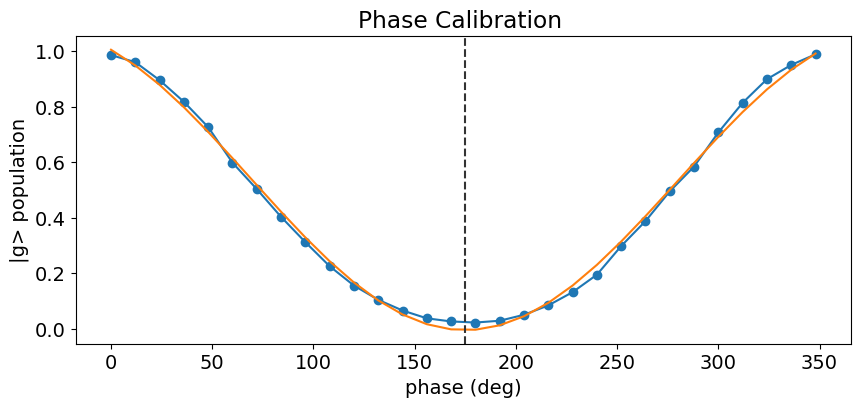

In [752]:
# file_list = np.arange(1363, 1393) # pi/2ge, pi/2ge, pief, pief, pi/2ge , pi/2ge(calib phase)
# file_list = np.arange(1394, 1425) # pi/2ge, pi/2ge, pief, pief, pi/2ge (calib phase), pi/2ge
vary_pts = np.arange(0, 361,12)
y_list = []
active_reset = True
threshold = -4.1
name = '_single_shot_phase_sweep.h5'
for file_no in file_list:
    count = 0   # how many points possibly |f>
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef

    # active reset:
    if active_reset:
        Ig, Qg = filter_data_IQ(temp_data['I'], temp_data['Q'],threshold, readout_per_experiment=4)
        total_counts = len(Ig)
        # Ig = I_selected
    else:

        Ig = temp_data['I']
        Qg = temp_data['Q']
        total_counts = len(Ig)
    for i in range(len(Ig)):
        if Ig[i] < threshold :
            count += 1

    y_list.append(count/total_counts)
xpts_ns = vary_pts[:len(y_list)]
phase_calibration(xpts_ns, y_list, fitparams=None, title='Phase Calibration ')

[ 4.90127246e-01  2.78444587e-03 -9.78506067e+01  2.42745899e+05
  5.04275561e-01 -3.59989879e+02]
Pi length from avgi data: 187.40074878462895
	Pi/2 length from avgi data: 93.70037439231447


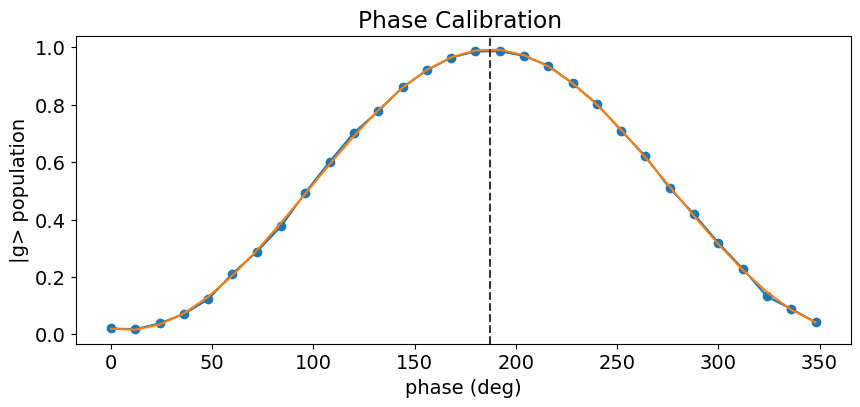

In [878]:
# using slow ef pulse 
file_list = np.arange(1464, 1495) # pi/2ge,  pief, pief, pi/2ge (calib phase)
vary_pts = np.arange(0, 361,12)
y_list = []
active_reset = True
threshold = -4.1
name = '_single_shot_phase_sweep.h5'
for file_no in file_list:
    count = 0   # how many points possibly |f>
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef

    # active reset:
    if active_reset:
        Ig, Qg = filter_data_IQ(temp_data['I'], temp_data['Q'],threshold, readout_per_experiment=4)
        total_counts = len(Ig)
        # Ig = I_selected
    else:

        Ig = temp_data['I']
        Qg = temp_data['Q']
        total_counts = len(Ig)
    for i in range(len(Ig)):
        if Ig[i] < threshold :
            count += 1

    y_list.append(count/total_counts)
xpts_ns = vary_pts[:len(y_list)]
phase_calibration(xpts_ns, y_list, fitparams=None, title='Phase Calibration ')

In [723]:
min(y_list)

0.01797979797979798

#### RB Check

In [51]:
temp_data, attrs = prev_data(expt_path, '00278_SingleRB.h5')
#temp_data, attrs = prev_data(expt_path, '00017_SingleBeamsplitterRB_sweep_depth.h5')
avg_readout = []
for i in range(len(temp_data['Idata'])):
    counting = 0
    for j in temp_data['Idata'][i][0]:
        if j<temp_data['thresholds']:
            counting += 1
    avg_readout.append(counting/len(temp_data['Idata'][i][0]))
#
# avg_readout = RB_extract(temp_data)
mean = np.average(avg_readout)
err = np.std(avg_readout)/np.sqrt(len(avg_readout))
print(mean, err)

0.5416 0.02901115302775813


In [50]:
temp_data['Idata'].shape

(20, 1, 1000)

In [48]:
avg_readout

[0.544,
 0.228,
 0.47,
 0.494,
 0.483,
 0.41,
 0.583,
 0.263,
 0.568,
 0.453,
 0.478,
 0.573,
 0.32,
 0.374,
 0.475,
 0.58,
 0.279,
 0.197,
 0.534,
 0.245]

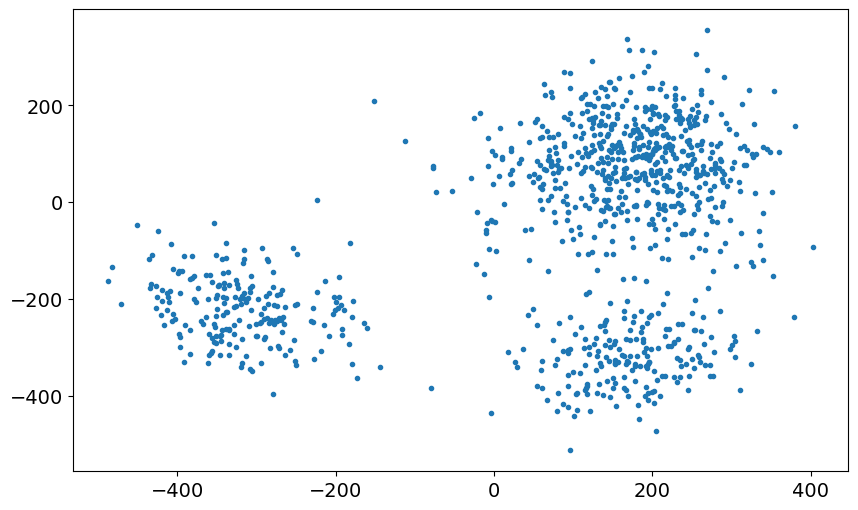

In [44]:
plt.plot(temp_data['Idata'][-2][0], temp_data['Qdata'][-2][0], '.')

### 2pi ef swap pulse effect on ge

[ 4.88723493e-01  2.77408882e-03  7.79657921e+01  1.29743852e+05
  5.06714795e-01 -3.59965942e+02]
Pi length from avgi data: 192.28957337620628
	Pi/2 length from avgi data: 96.14478668810314


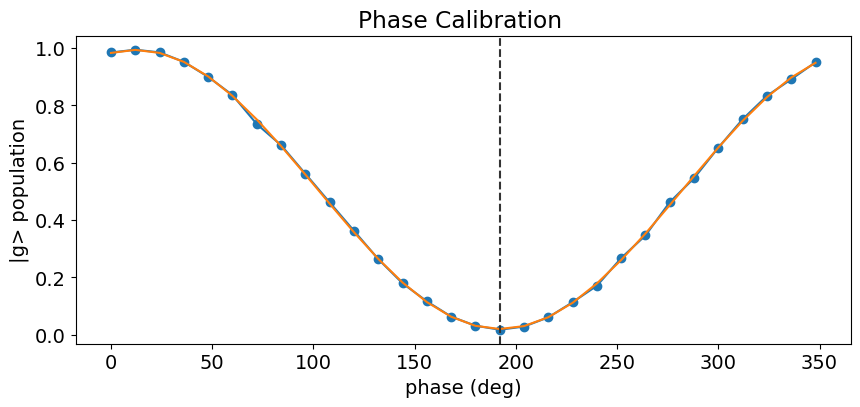

In [794]:
file_list = np.arange(1425, 1455) # pi/2ge, pi/2ge, pief, pief, pi/2ge (calib phase), pi/2ge
vary_pts = np.arange(0, 361,12)
y_list = []
active_reset = True
threshold = -4.1
name = '_single_shot_phase_sweep.h5'
for file_no in file_list:
    count = 0   # how many points possibly |f>
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef

    # active reset:
    if active_reset:
        Ig, Qg = filter_data_IQ(temp_data['I'], temp_data['Q'],threshold, readout_per_experiment=4)
        total_counts = len(Ig)
        # Ig = I_selected
    else:

        Ig = temp_data['I']
        Qg = temp_data['Q']
        total_counts = len(Ig)
    for i in range(len(Ig)):
        if Ig[i] < threshold :
            count += 1

    y_list.append(count/total_counts)
xpts_ns = vary_pts[:len(y_list)]
phase_calibration(xpts_ns, y_list, fitparams=None, title='Phase Calibration ')

In [796]:
#### RB Check
temp_data, attrs = prev_data(expt_path, '00224_SingleRB.h5')
#temp_data, attrs = prev_data(expt_path, '00017_SingleBeamsplitterRB_sweep_depth.h5')
avg_readout = []
for i in range(len(temp_data['Idata'])):
    counting = 0
    for j in temp_data['Idata'][i]:
        if j<temp_data['thresholds']:
            counting += 1
    avg_readout.append(counting/len(temp_data['Idata'][i]))
#
# avg_readout = RB_extract(temp_data)
mean = np.average(avg_readout)
err = np.std(avg_readout)/np.sqrt(len(avg_readout))
print(mean, err)

0.7118500000000001 0.03502472519521031


In [797]:
avg_readout

[0.739,
 0.829,
 0.498,
 0.768,
 0.781,
 0.884,
 0.416,
 0.79,
 0.853,
 0.419,
 0.8,
 0.72,
 0.834,
 0.784,
 0.335,
 0.675,
 0.807,
 0.784,
 0.72,
 0.801]

### f0g1 swap addition phase on M1

here
Ig -18.824675324675326 +/- 5.869066049565338 	 Qg 18.724025974025974 +/- 3.9214183325403886 	 Amp g 26.551036698318192
9793
|e> population (%): 2.07


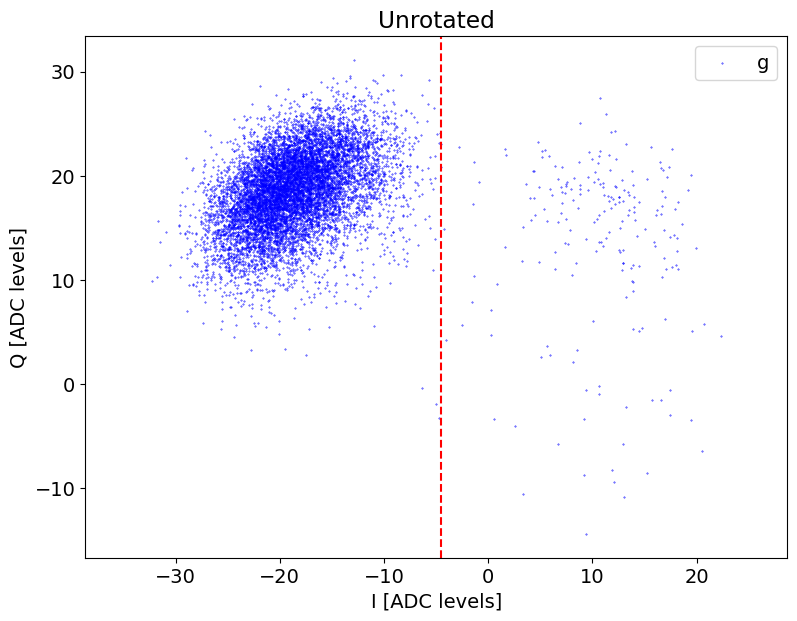

In [807]:
temp_data, attrs = prev_data(expt_path, '00026_HistogramPrepulseExperiment.h5')
hist_new_display(temp_data, -4.5, verbose=True, plot_f=False, active_reset=False, readout_per_round=4, span=60, threshold=-4)

[ 3.16000000e-02  4.05594965e-03  2.31132961e+02  1.34196381e+03
  9.50434949e-01 -3.60000000e+02]
Pi length from avgi data: 149.8943653955992
	Pi/2 length from avgi data: 74.9471826977996


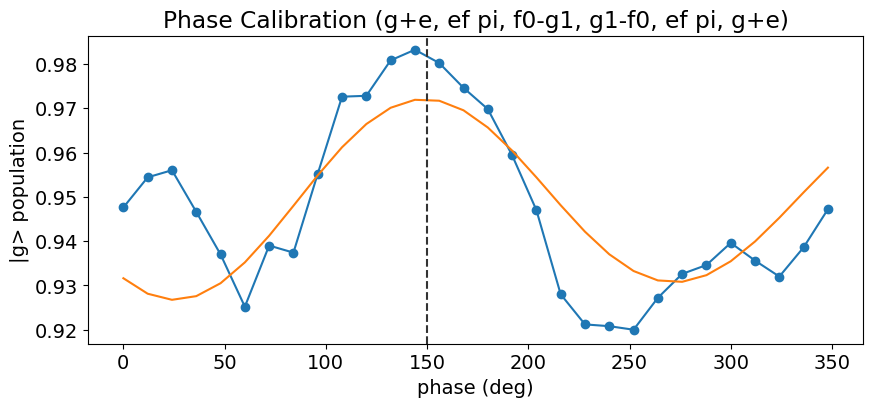

In [652]:
file_list = np.arange(988,1018,1)
file_list = np.arange(1019,1047,1)
# file_list = np.arange(1051,1075,1)
# file_list = np.arange(957,988,1)
file_list = np.arange(1077,1108,1)
vary_pts = np.arange(0, 361,12)
y_list = []
active_reset = False
name = '_single_shot_phase_sweep.h5'
for file_no in file_list:
    count = 0   # how many points possibly |f>
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef

    # active reset:
    if active_reset:
        Ig, Qg = filter_data_IQ(temp_data['I'], temp_data['Q'], -6.3, readout_per_experiment=4)
        total_counts = len(Ig)
        # Ig = I_selected
    else:

        Ig = temp_data['I']
        Qg = temp_data['Q']
        total_counts = len(Ig)
    for i in range(len(Ig)):
        if Ig[i] < -5.5 :
            count += 1

    y_list.append(count/total_counts)
xpts_ns = vary_pts[:len(y_list)]
phase_calibration(xpts_ns, y_list, fitparams=None, title='Phase Calibration (g+e, ef pi, f0-g1, g1-f0, ef pi, g+e)')



In [627]:
max(y_list)

0.9836

In [623]:
xpts_ns

array([  0,  12,  24,  36,  48,  60,  72,  84,  96, 108, 120, 132, 144,
       156, 168, 180, 192, 204, 216, 228, 240, 252, 264, 276, 288, 300,
       312, 324])

#### f0g1 on ef phase

[ 2.96032971e-02  3.32347802e-03 -2.32016229e+00  1.22538294e+03
  9.60403286e-01 -3.47981515e+02]
Pi length from avgi data: 77.16160413849269
	Pi/2 length from avgi data: 38.580802069246346


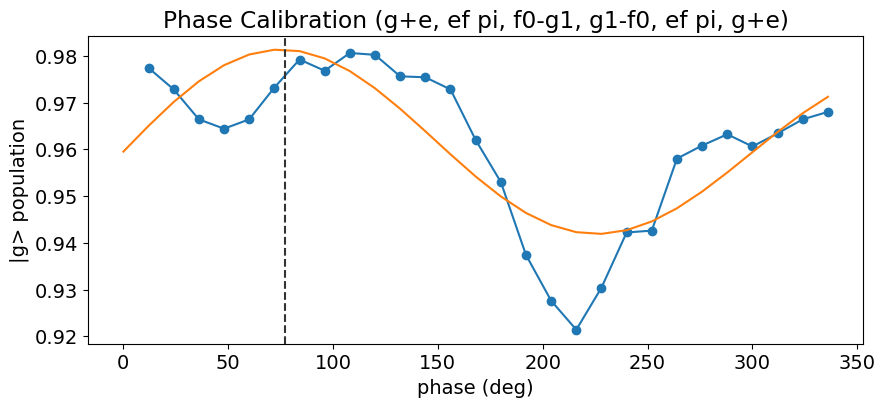

In [376]:
# file_list = np.arange(342,373,1)
# file_list = np.arange(373,404,1)
file_list = np.arange(851,881,1)
vary_pts = np.arange(0, 361,12)
y_list = []
active_reset = False
name = '_single_shot_phase_sweep.h5'
for file_no in file_list:
    count = 0   # how many points possibly |f>
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef

    # active reset:
    if active_reset:
        Ig, Qg = filter_data_IQ(temp_data['I'], temp_data['Q'], -6.3, readout_per_experiment=4)
        total_counts = len(Ig)
        Ig = I_selected
    else:

        Ig = temp_data['I']
        Qg = temp_data['Q']
        total_counts = len(Ig)
    for i in range(len(Ig)):
        if Ig[i] < -5 :
            count += 1

    y_list.append(count/total_counts)
xpts_ns = vary_pts[0:len(y_list)]
phase_calibration(xpts_ns, y_list, fitparams=None, title='Phase Calibration (g+e, ef pi, f0-g1, g1-f0, ef pi, g+e)')



In [2545]:
(259.50241630009293-180)

79.50241630009293

In [2548]:
max(y_list)

0.962

### Debug: f0g1 readout vs parioty readout of man 

Ig -293.3863636363636 +/- 190.33210814409227 	 Qg -278.0064935064935 +/- 87.06989896951755 	 Amp g 404.1820985639327
8335
|e> population (%): 15.552178318135764


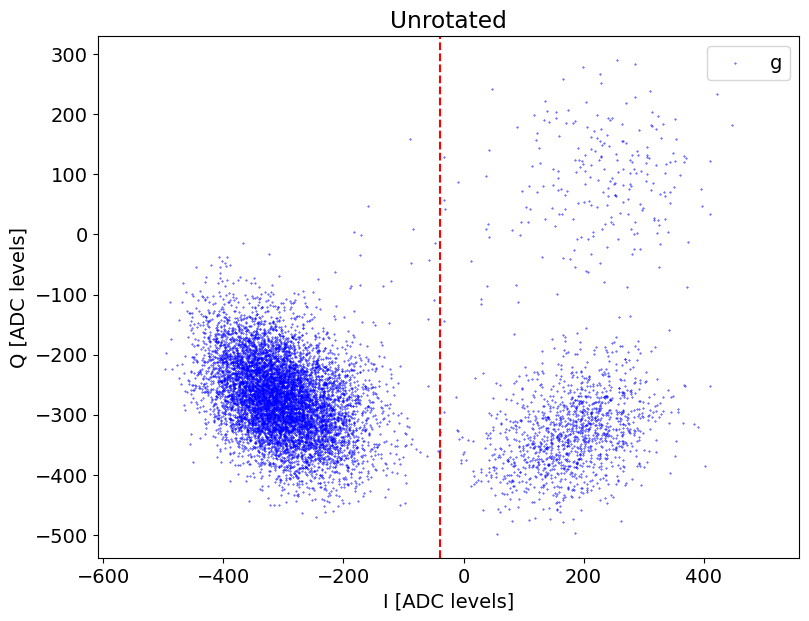

In [80]:
temp_data, attrs = prev_data(expt_path, '00061_HistogramPrepulseExperiment.h5')
hist_new_display(temp_data, -39, verbose=True, plot_f=False, active_reset=True, readout_per_round=4, span=60, threshold=-39)

In [70]:
attrs['config']['device']

{'qubit': {'T1': [127.0],
  'f_ge': [3568.1751638611518],
  'f_ge_resolved': [3568.1751638611518],
  'f_ge_idle': [3568.1751638611518],
  'f_ef': [3425.5564066067],
  'f_ef_idle': [3425.5564066067],
  'ramp_sigma': [0.005],
  'ramp_sigma_num': [3],
  'pulses': {'pi_ge': {'gain': [10716],
    'sigma': [0.035],
    'length': [0],
    'type': ['gauss']},
   'pi_ge_ftop': {'gain': [3000],
    'sigma': [0.005],
    'length': [0.190914187445986],
    'type': ['flat_top']},
   'pi_ge_fast': {'gain': [10682],
    'sigma': [0.035],
    'length': [0],
    'type': ['gauss']},
   'pi_ge_resolved': {'gain': [50],
    'sigma': [0.005],
    'length': [6.553697146578866],
    'type': ['flat_top'],
    'repeat_no': [1]},
   'hpi_ge': {'gain': [5510],
    'length': [0],
    'sigma': [0.035],
    'type': ['gauss']},
   'hpi_ge_ftop': {'gain': [3000],
    'sigma': [0.005],
    'length': [0.09131395179924079],
    'type': ['flat_top']},
   'hpi_ge_fast': {'gain': [5195],
    'length': [0],
    'sigma': [0.

In [71]:
5.05/3

1.6833333333333333

### sideband storage 1 phase on ge 

[4.70970159e-01 2.76886467e-03 5.52266897e+01 4.99787138e-01]
Pi length from avgi data: 215.46467561297192
	Pi/2 length from avgi data: 107.73233780648596


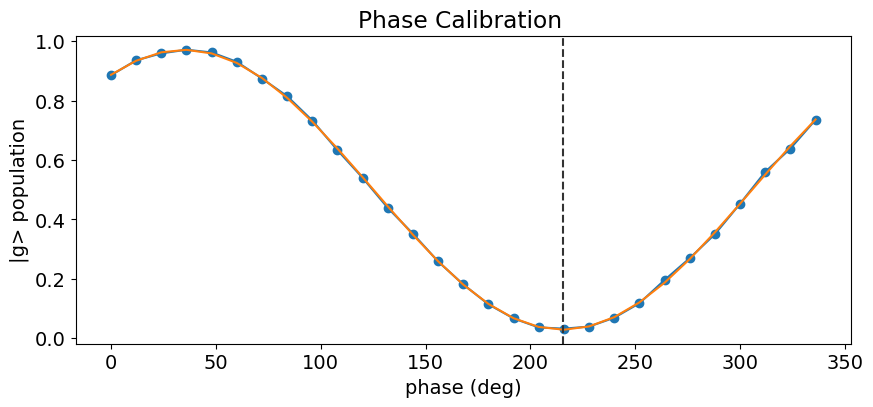

In [26]:
file_list = np.arange(1911, 1941)
vary_pts = np.arange(0, 361,12)
y_list = []
active_reset = False
threshold = -40.69974573466379
name = '_single_shot_phase_sweep.h5'
for file_no in file_list:
    count = 0   # how many points possibly |f>
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef

    # active reset:
    if active_reset:
        Ig, Qg = filter_data_IQ(temp_data['I'], temp_data['Q'],threshold, readout_per_experiment=4)
        total_counts = len(Ig)
        # Ig = I_selected
    else:

        Ig = temp_data['I']
        Qg = temp_data['Q']
        total_counts = len(Ig)
    for i in range(len(Ig)):
        if Ig[i] < threshold :
            count += 1

    y_list.append(count/total_counts)
xpts_ns = vary_pts[:len(y_list)]
phase_calibration(xpts_ns, y_list, fitparams=None, title='Phase Calibration ')

In [35]:
360- 215.46467561297192

144.53532438702808

### Check Demolition

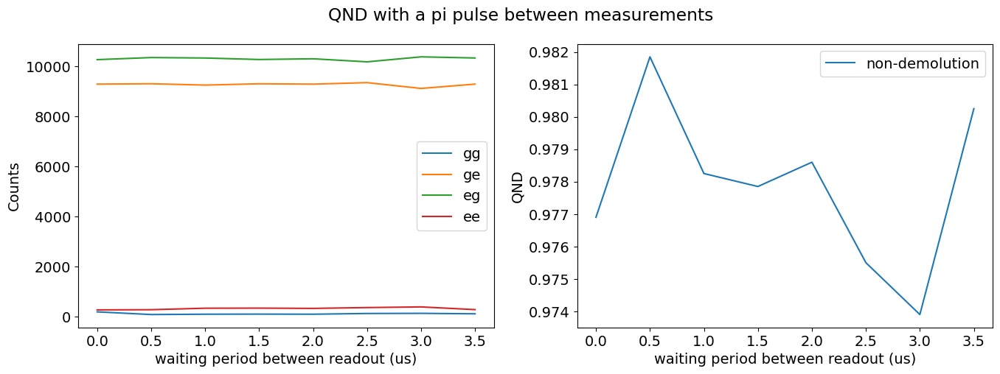

In [411]:
temp_data, attrs = prev_data(expt_path, '00000_DemolutionMeasurementExperiment.h5') # |e>
readout_list = attrs['config']['expt']["time_start"] + attrs['config']['expt']["time_step"] * np.arange(attrs['config']['expt']["time_expts"])
gg_list = []
ge_list = []
eg_list = []
ee_list = []
non_demolution = []
for i in range(len(readout_list)):
    gg = 0
    ge = 0
    eg = 0
    ee = 0
    for j in range(len(temp_data['i0'][0][0])):
        #  check if the counts are the same as initial counts
        if temp_data['i0'][i][0][j]>attrs['config']['device']['readout']['threshold'][0]: # classified as e
            if temp_data['i0'][i][1][j]>attrs['config']['device']['readout']['threshold'][0]:  # second e
                ee += 1
            else:
                eg +=1
        else:  # classified as g
            if temp_data['i0'][i][1][j]>attrs['config']['device']['readout']['threshold'][0]:  # second e
                ge +=1
            else:
                gg += 1
    gg_list.append(gg)
    ge_list.append(ge)
    eg_list.append(eg)
    ee_list.append(ee)
    non_demolution.append((ge+eg)/(gg+ge+eg+ee))

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))
fig.suptitle('QND with a pi pulse between measurements')
axs[0].plot(readout_list, gg_list, label='gg')
axs[0].plot(readout_list, ge_list, label='ge')
axs[0].plot(readout_list, eg_list, label='eg')
axs[0].plot(readout_list, ee_list, label='ee')
axs[0].set_xlabel('waiting period between readout (us)')
axs[0].set_ylabel('Counts')
axs[0].legend()

axs[1].plot(readout_list, non_demolution, label='non-demolution')
axs[1].set_xlabel('waiting period between readout (us)')
axs[1].set_ylabel('QND')
axs[1].legend()

## T1

Fit T1 avgi [us]: 492.9979042673381
Fit T1 avgq [us]: 586.7913333262306


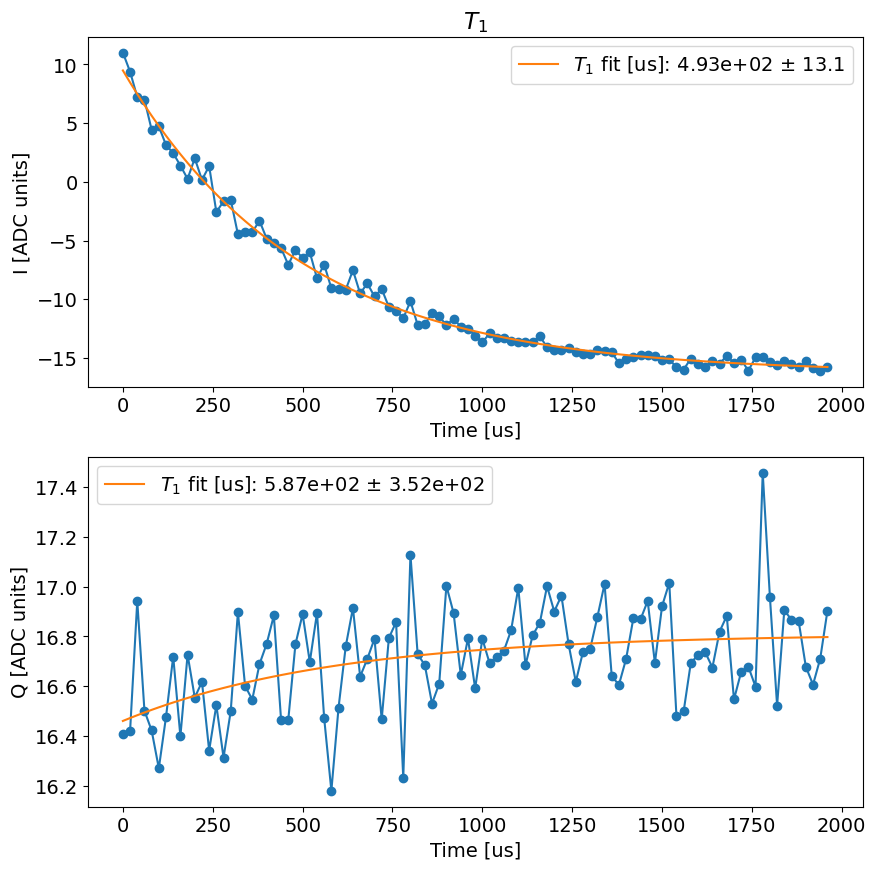

In [1703]:
temp_data, attrs = prev_data(expt_path, '00005_T1Experiment.h5')
t1_display(temp_data, fit=True)

## T1 gef

Fit T1 avgi [us]: 410.7158257434073
Fit T1 avgq [us]: 895.3084078129739


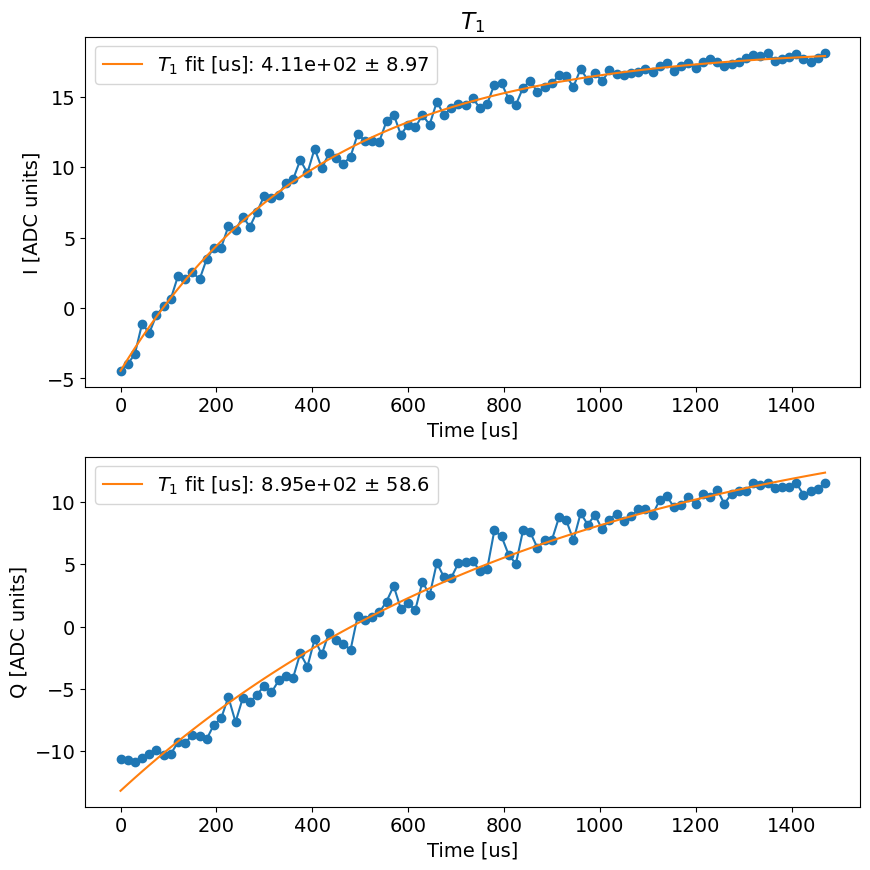

In [2276]:
temp_data, attrs = prev_data(expt_path, '00010_T1Experiment.h5')
t1_display(temp_data, fit=True)

Fit T1 |f> [us]: 234.53801451665092


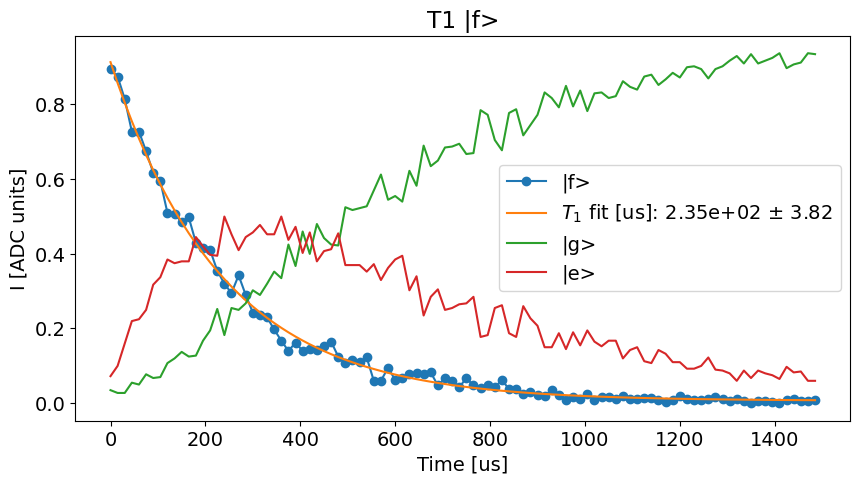

In [2287]:
count_g = []
count_e = []
count_f = []
for i in range(len(temp_data['I'])):
    if i%401 == 0:
        pg = 0
        pe = 0
        pf = 0
    
    if temp_data['I'][i] > 13.593:
        pg += 1
    elif temp_data['I'][i] > 2.193:
        pe += 1
    else:
        pf += 1

    if i%401 == 400:
        count_g.append(pg/401)
        count_e.append(pe/401)
        count_f.append(pf/401)

fit_avgf, fit_err_avgf = fitter.fitexp(temp_data['xpts'], np.array(count_f), fitparams=None)

plt.figure(figsize=(10,5))
plt.subplot(111, title='T1 |f>', ylabel="I [ADC units]")
plt.plot(temp_data['xpts'], count_f,'o-', label='|f>')

p = fit_avgf
pCov = fit_err_avgf
captionStr = f'$T_1$ fit [us]: {p[3]:.3} $\pm$ {np.sqrt(pCov[3][3]):.3}'
plt.plot(temp_data['xpts'], fitter.expfunc(temp_data['xpts'], *fit_avgf), label=captionStr)
plt.xlabel('Time [us]')
plt.legend()
print(f'Fit T1 |f> [us]: {fit_avgf[3]}')
    
plt.plot(temp_data['xpts'], count_g, label='|g>')
plt.plot(temp_data['xpts'], count_e, label='|e>')
# plt.plot(temp_data['xpts'], count_f, label='|f>')
plt.legend()

In [2281]:
count_f

[0.8927680798004988,
 0.8728179551122195,
 0.8129675810473815,
 0.7256857855361596,
 0.7256857855361596,
 0.6733167082294265,
 0.6159600997506235,
 0.5935162094763092,
 0.5087281795511222,
 0.5062344139650873,
 0.4837905236907731,
 0.49625935162094764,
 0.428927680798005,
 0.4139650872817955,
 0.4089775561097257,
 0.3541147132169576,
 0.3192019950124688,
 0.2942643391521197,
 0.341645885286783,
 0.2892768079800499,
 0.24189526184538654,
 0.2344139650872818,
 0.22942643391521197,
 0.1970074812967581,
 0.16708229426433915,
 0.1396508728179551,
 0.16209476309226933,
 0.1396508728179551,
 0.14463840399002495,
 0.14214463840399003,
 0.15211970074812967,
 0.16458852867830423,
 0.12468827930174564,
 0.10723192019950124,
 0.11471321695760599,
 0.10972568578553615,
 0.12219451371571072,
 0.059850374064837904,
 0.059850374064837904,
 0.09476309226932668,
 0.06234413965087282,
 0.06733167082294264,
 0.0773067331670823,
 0.0798004987531172,
 0.0773067331670823,
 0.08229426433915212,
 0.04738154613

## Manipulate 1 T1

Fit T1 avgi [us]: 213.23103162539965
Fit T1 avgq [us]: 209.33495649340972


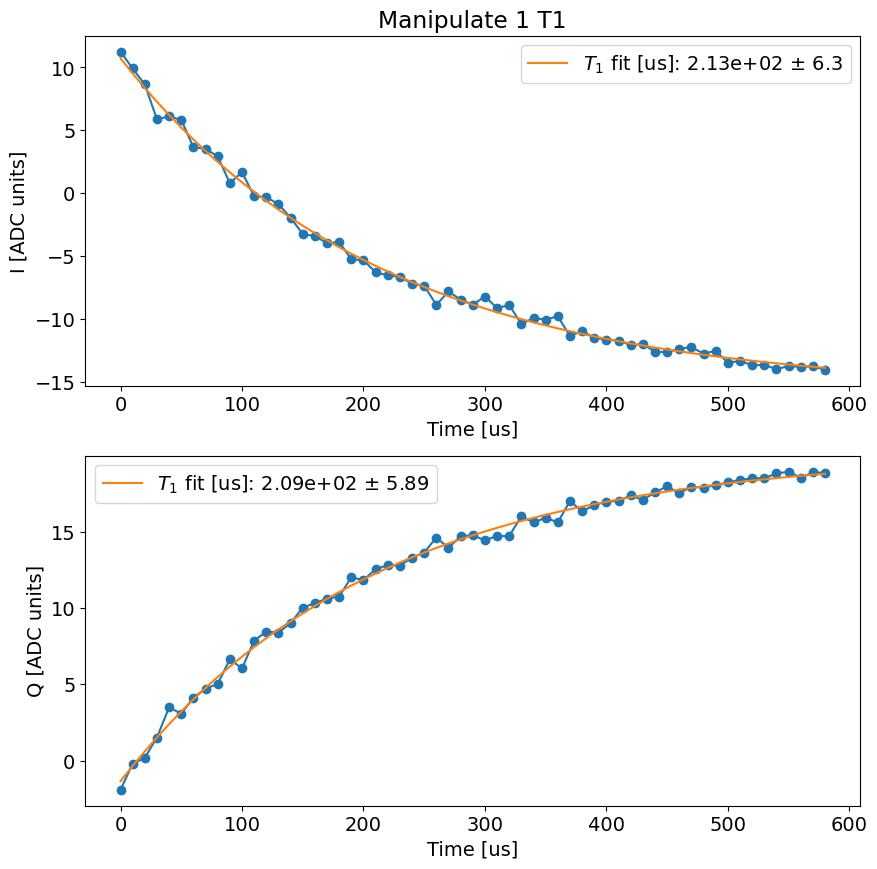

In [802]:
temp_data, attrs = prev_data(expt_path, '00002_T1CavityExperiment.h5')
t1_display(temp_data, fit=True, title='Manipulate 1 T1')

### Manipulate 1 T1 sweep

In [161]:
temp_data, attrs = prev_data(expt_path, '00029_cavity_t1_dc_flux_sweep.h5')
t1_display(temp_data, fit=True, title='Manipulate 1 T1')

FileNotFoundError: [Errno 2] Unable to open file (unable to open file: name = 'h:\Shared drives\multimode\Multimode\experiment\240724\data/00029_cavity_t1_dc_flux_sweep.h5', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)

In [340]:
attrs['config']['expt']

{'start': 0,
 'step': 8,
 'expts': 50,
 'reps': 50,
 'rounds': 10,
 'cavity_prepulse': [False, 300, 1.5],
 'f0g1_prep': True,
 'f0g1_param': [2004.074739988252, 15000, 0.6270767198638735],
 'resolved_pi': False,
 'cavity': 1,
 'qubit': 0,
 'current': -1.12}

## Manipulate 2 T1

Fit T1 avgi [us]: 120.43770980334241
Fit T1 avgq [us]: 117.64480551314237


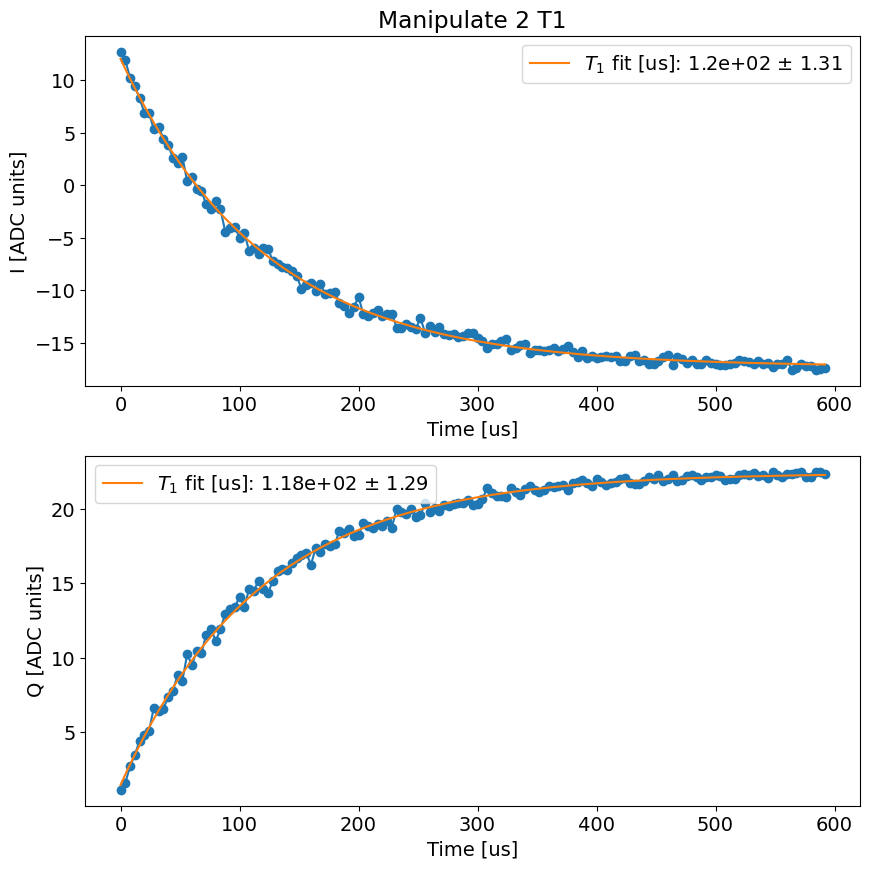

In [159]:
temp_data, attrs = prev_data(expt_path, '00003_T1CavityExperiment.h5')
t1_display(temp_data, fit=True, title='Manipulate 2 T1')

Fit T1 avgi [us]: 480.12457065159634
Fit T1 avgq [us]: 76.0672884887648


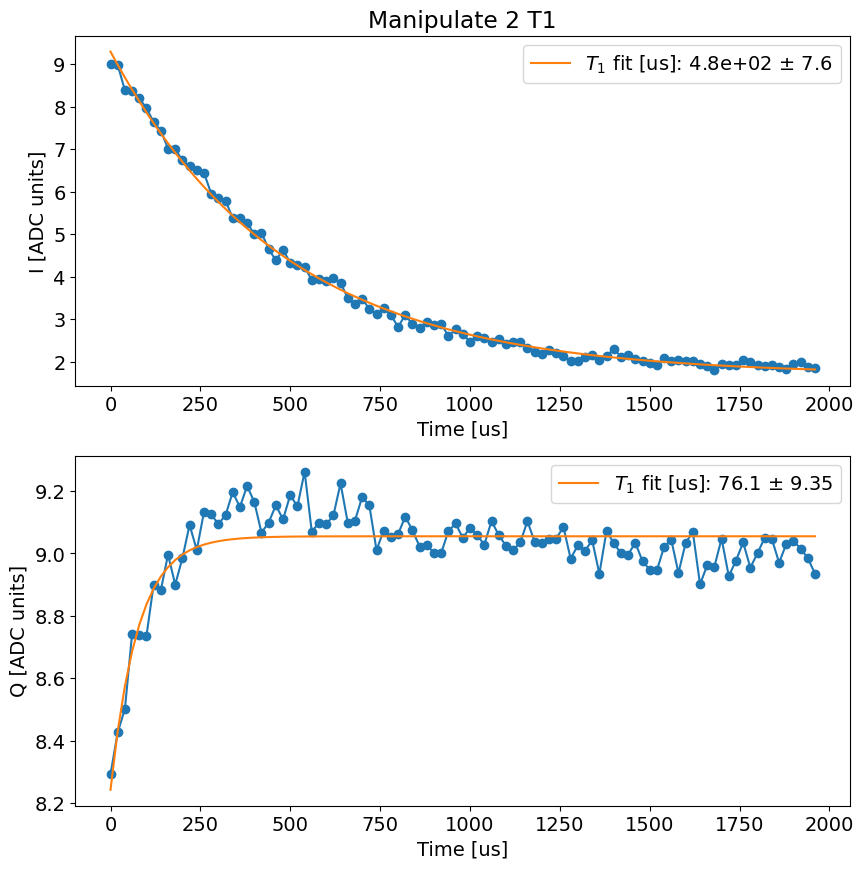

In [112]:
temp_data, attrs = prev_data(expt_path, '00009_T1CavityExperiment.h5')
t1_display(temp_data, fit=True, title='Manipulate 2 T1')

Fit T1 avgi [us]: 133.51552770737052
Fit T1 avgq [us]: 117.13647947939828


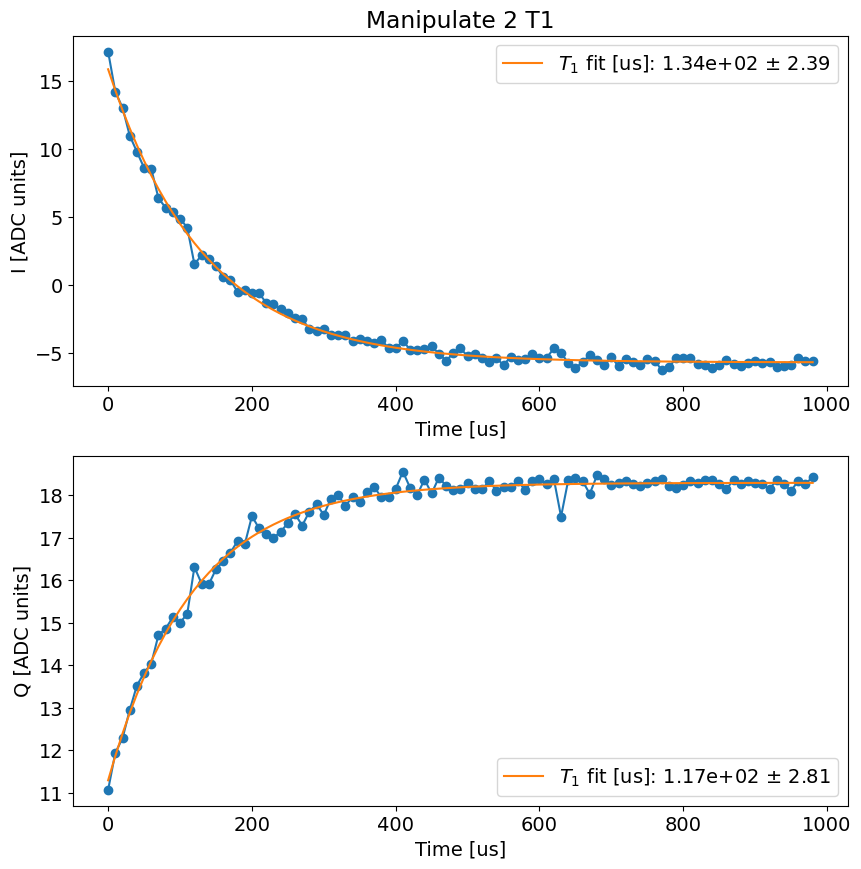

In [116]:
temp_data, attrs = prev_data(expt_path, '00009_T1CavityExperiment.h5')
t1_display(temp_data, fit=True, title='Manipulate 2 T1')

## Phase Sweep

Attempted to init fitparam 3 to 20, which is out of bounds 0.779120325203252 to 9.387089430894308. Instead init to 5.08310487804878
Attempted to init fitparam 3 to 5.08310487804878, which is out of bounds 7.84639837398374 to 9.24200487804878. Instead init to 8.54420162601626
amp: 4.238140112534213
freq: 0.0027853436995978987
phase_offset: -93.47687802423827
...: 5.111171213205359
ge phase per identity: 0


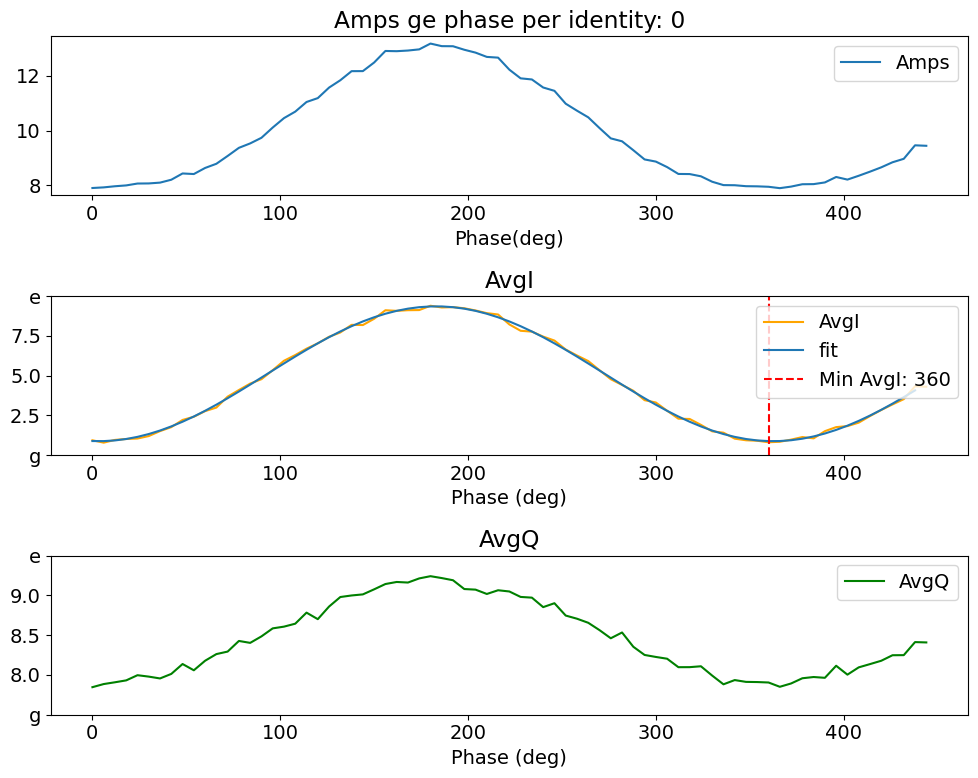

In [275]:
temp_data, attrs = prev_data(expt_path, '00037_PhaseSweepAveragerExperiment.h5')
phase_sweep_display(temp_data,attrs,  normalize=[True, 'g_data', 'e_data'], fit = True, fitparams=[6, 0.0005, 0, 20])



In [225]:
attrs['config']['expt']


{'phase_start': 0,
 'phase_step': 6,
 'expts': 75,
 'reps': 100,
 'rounds': 1,
 'qubits': [0],
 'normalize': True,
 'piEF': False,
 'prepulse': False,
 'postpulse': False,
 'post_prepulse_reset': False,
 'pre_sweep_pulse': [[3567.3995281841685],
  [1434],
  [0.0],
  [0],
  [2],
  ['gaussian'],
  [0.03]],
 'advance_qubit_phase': 180,
 'reps_middlepulse': 5,
 'middlepulse': True,
 'mid_sweep_pulse': [[3424.266002753798, 3424.266002753798],
  [2558, 2558],
  [0, 0],
  [168, 12],
  [2, 2],
  ['gaussian', 'gaussian'],
  [0.03, 0.03]],
 'phase_update': 444.0}

Attempted to init fitparam 3 to 20, which is out of bounds 1.5205658536585367 to 10.331162601626016. Instead init to 5.925864227642276
Attempted to init fitparam 3 to 5.925864227642276, which is out of bounds 8.820325203252033 to 9.337944715447154. Instead init to 9.079134959349593
amp: 4.334199221887495
freq: 0.0027768474673870217
phase_offset: -93.20127084898964
...: 5.980844575869736
Advance phase: 180


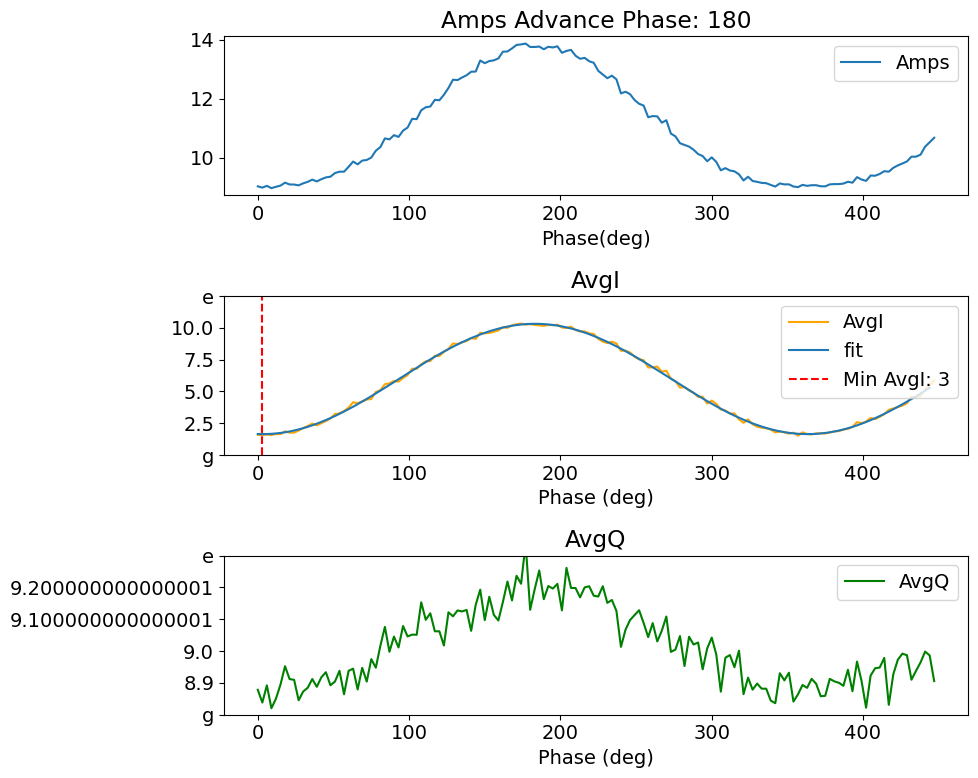

In [263]:
temp_data, attrs = prev_data(expt_path, '00010_PhaseSweepAverager_sweep_reps_middlepulse.h5')
phase_sweep_display(temp_data,attrs,  normalize=[True, 'g_data', 'e_data'], fit = True, fitparams=[6, 0.0005, 0, 20])



In [ ]:
file_list = np.arange(25, 33, 1)
avg_i_list = []
reps_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+'_PhaseSweepAveragerExperiment.h5'
    temp_data, attrs = prev_data(expt_path, full_name)
    avg_i = temp_data['avgi']
    avg_i_list.append(avg_i)
    reps_list.append(attrs['config']['expt']['reps_middlepulse'])
    xpts = temp_data['xpts']


# Create a colorplot with x
    

### Phase Sweep Averager sweep depth

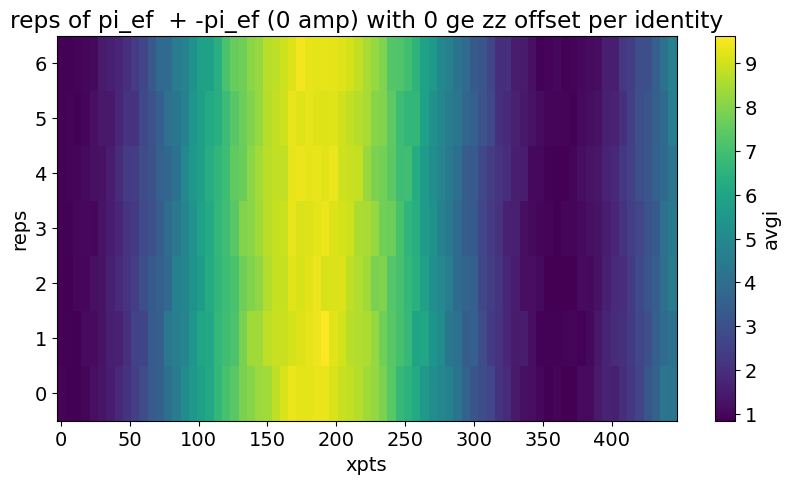

In [279]:

file_list = np.arange(50, 57, 1)
avg_i_list = []
reps_list = []
imin = []
imax = []
for file_no in file_list:
    full_name = str(file_no).zfill(5) + '_PhaseSweepAverager_sweep_reps_middlepulse.h5'
    temp_data, attrs = prev_data(expt_path, full_name)
    avg_i = temp_data['avgi']
    avg_i_list.append(avg_i)
    reps_list.append(attrs['config']['expt']['reps_middlepulse'])
    xpts = temp_data['xpts']
    imin.append(temp_data['g_data'][0])
    imax.append(temp_data['e_data'][0])


# Convert lists to numpy arrays for plotting
avg_i_array = np.array(avg_i_list)
reps_array = np.array(reps_list)

# Define colorbar limits
vmin = np.mean(imin)
vmax = np.mean(imax)

# Create the color plot
plt.figure(figsize=(10, 5))
plt.pcolormesh(xpts, reps_array, avg_i_array, shading='auto', vmin=vmin, vmax=vmax)
plt.colorbar(label='avgi')
plt.xlabel('xpts')
plt.ylabel('reps')
plt.title('reps of pi_ef  + -pi_ef (0 amp) with 0 ge zz offset per identity')
plt.show()


In [267]:
temp_data['e_data']

array([[10.48385854],
       [ 9.20660325],
       [13.95252068],
       [ 0.72062221]])

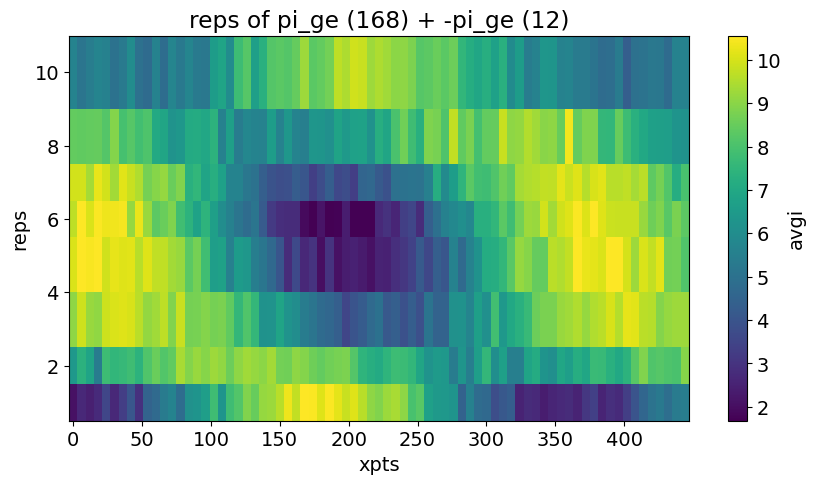

In [252]:
file_list = np.arange(25, 33, 1)
avg_i_list = []
reps_list = []
imin = []
imax = []
for file_no in file_list:
    full_name = str(file_no).zfill(5) + '_PhaseSweepAveragerExperiment.h5'
    temp_data, attrs = prev_data(expt_path, full_name)
    avg_i = temp_data['avgi']
    avg_i_list.append(avg_i)
    reps_list.append(attrs['config']['expt']['reps_middlepulse'])
    xpts = temp_data['xpts']
    imin.append(temp_data['g_data'][0])
    imax.append(temp_data['e_data'][0])


# Convert lists to numpy arrays for plotting
avg_i_array = np.array(avg_i_list)
reps_array = np.array(reps_list)

# Define colorbar limits
vmin = np.mean(imin)
vmax = np.mean(imax)

# Create the color plot
plt.figure(figsize=(10, 5))
plt.pcolormesh(xpts, reps_array, avg_i_array, shading='auto', vmin=vmin, vmax=vmax)
plt.colorbar(label='avgi')
plt.xlabel('xpts')
plt.ylabel('reps')
plt.title('reps of pi_ge (168) + -pi_ge (12)')
plt.show()

In [253]:
temp_data['e_data']

array([[10.61818537],
       [ 9.20590081],
       [14.05327258],
       [ 0.71427748]])

In [233]:
attrs['config']['expt']

{'phase_start': 0,
 'phase_step': 6,
 'expts': 75,
 'reps': 100,
 'rounds': 1,
 'qubits': [0],
 'normalize': True,
 'piEF': False,
 'prepulse': False,
 'postpulse': False,
 'post_prepulse_reset': False,
 'pre_sweep_pulse': [[3567.3995281841685],
  [1434],
  [0.0],
  [0],
  [2],
  ['gaussian'],
  [0.03]],
 'advance_qubit_phase': 180,
 'reps_middlepulse': 3,
 'middlepulse': True,
 'mid_sweep_pulse': [[3424.266002753798, 3424.266002753798],
  [2558, 2558],
  [0, 0],
  [168, 12],
  [2, 2],
  ['gaussian', 'gaussian'],
  [0.03, 0.03]],
 'phase_update': 444.0}

## Ramsey

Current pi pulse frequency: 3568.1751638611518
Fit frequency from I [MHz]: 0.19969079435583914 +/- 0.00017528638935759
Suggested new pi pulse frequency from fit I [MHz]:
 	3568.175473066796
 	3568.574854655508
T2 Ramsey from fit I [us]: 198.71447901231545
Fit frequency from Q [MHz]: 0.19762444698229825 +/- 0.001322759929983019
Suggested new pi pulse frequencies from fit Q [MHz]:
 	3568.1775394141696
 	3568.572788308134
T2 Ramsey from fit Q [us]: 71.23803940769783


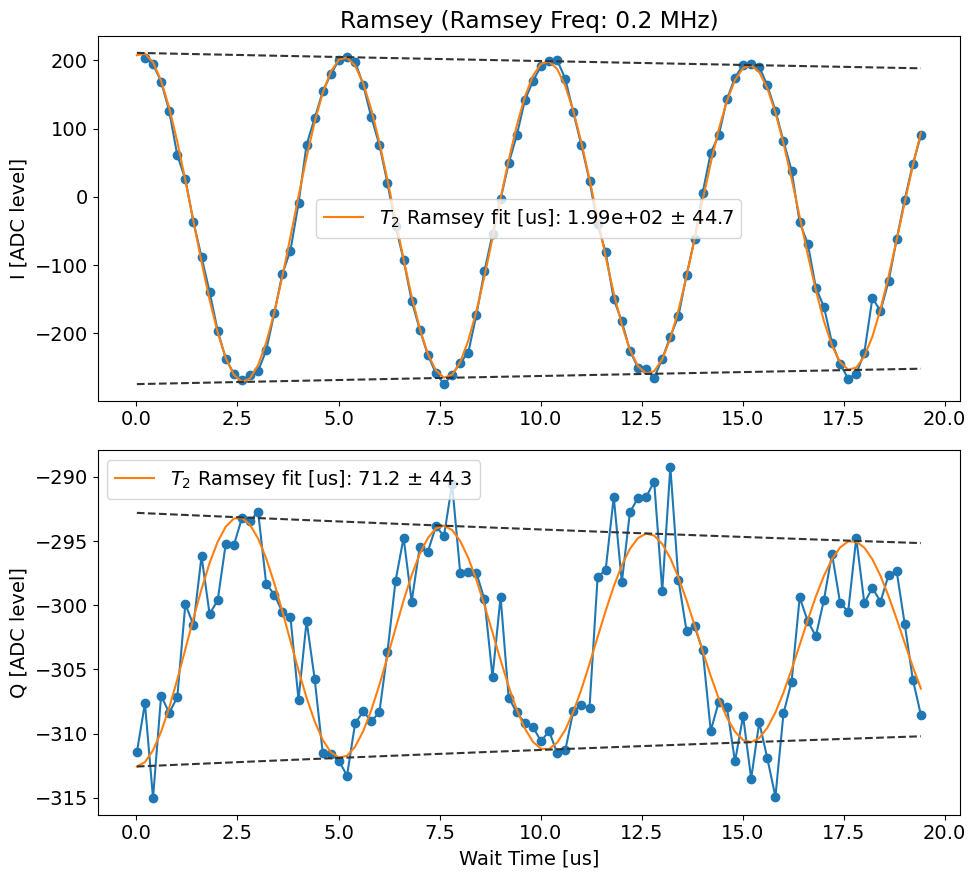

In [51]:
temp_data, attrs = prev_data(expt_path, '00222_RamseyExperiment.h5')
Ramsey_display(temp_data,  attrs, normalize = [False, 'g_data', 'e_data'], active_reset=True, threshold = -25.73026268397916, readouts_per_rep=4,
                ramsey_freq=attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['device']['qubit']['f_ge_idle'][0], fit=True, title='Ramsey')

Current pi pulse frequency: 3568.1751638611518
Fit frequency from I [MHz]: 0.4840855698030771 +/- 0.0003166047071532739
Suggested new pi pulse frequency from fit I [MHz]:
 	3567.8910782913485
 	3568.859249430955
T2 Ramsey from fit I [us]: 113.1608935455664
Fit frequency from Q [MHz]: 0.013162839723608873 +/- 0.28110284808514685
Suggested new pi pulse frequencies from fit Q [MHz]:
 	3568.362001021428
 	3568.3883267008755
T2 Ramsey from fit Q [us]: 52.57967689605567


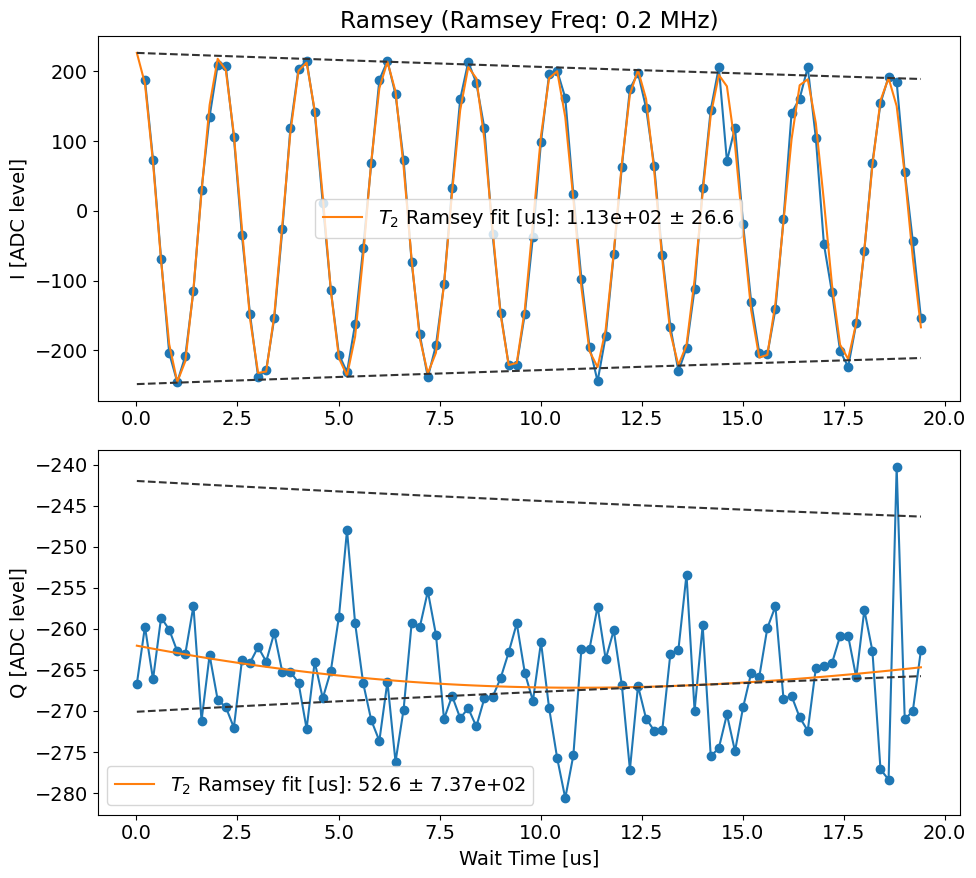

In [69]:
temp_data, attrs = prev_data(expt_path, '00215_RamseyExperiment.h5')
Ramsey_display(temp_data,  attrs, normalize = [False, 'g_data', 'e_data'], active_reset=True, threshold = -25.73026268397916,  readouts_per_rep=4,
                ramsey_freq=attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['device']['qubit']['f_ge_idle'][0], fit=True, title='Ramsey')

In [2592]:
attrs['config']['expt']

{'start': 0.01,
 'step': 0.2,
 'expts': 100,
 'ramsey_freq': 0.2,
 'reps': 500,
 'rounds': 1,
 'qubits': [0],
 'checkEF': False,
 'user_defined_freq': [False, 3425.30098176373, 7575, 0.035],
 'qubit_ge_init': False,
 'qubit_ge_after': False,
 'f0g1_cavity': 0,
 'normalize': False,
 'active_reset': True,
 'man_reset': True,
 'storage_reset': True,
 'prepulse': True,
 'postpulse': False,
 'pre_active_reset_pulse': False,
 'pre_sweep_pulse': [[3568.1751638611518,
   3425.5537944060666,
   2006.72,
   3567.900564,
   3425.300982,
   2006.72],
  [9653, 7575, 15000, 9653, 3835, 15000],
  [0, 0, 0.6087495795755329, 0, 0, 0.6087495795755329],
  [0, 0, 0, 0, 0, 0],
  [2, 2, 5, 2, 2, 5],
  ['gaussian', 'gaussian', 'flat_top', 'gaussian', 'gaussian', 'flat_top'],
  [0.035, 0.035, 0.005, 0.035, 0.035, 0.005]],
 'pre_active_reset_sweep_pulse': [[3568.1904347121535,
   3425.5537944060666,
   2006.72,
   1053.42],
  [9653, 7575, 15000, 7500],
  [0, 0, 0.6168960348389007, 1.9560044830465644],
  [0, 0,

Attempted to init fitparam 1 to 2.397959183673469, which is out of bounds 0.005154639175257732 to 0.7731958762886597. Instead init to 0.3891752577319587
Current pi pulse frequency: 3568.1904347121535
Fit frequency from I [MHz]: 0.20386120239538863 +/- 0.0002802919208200055
Suggested new pi pulse frequency from fit I [MHz]:
 	3568.186573509758
 	3568.594295914549
T2 Ramsey from fit I [us]: 229.1851119861111
Fit frequency from Q [MHz]: 0.4872729692332497 +/- 0.04766470474345621
Suggested new pi pulse frequencies from fit Q [MHz]:
 	3567.9031617429205
 	3568.8777076813867
T2 Ramsey from fit Q [us]: 5.820000001716366


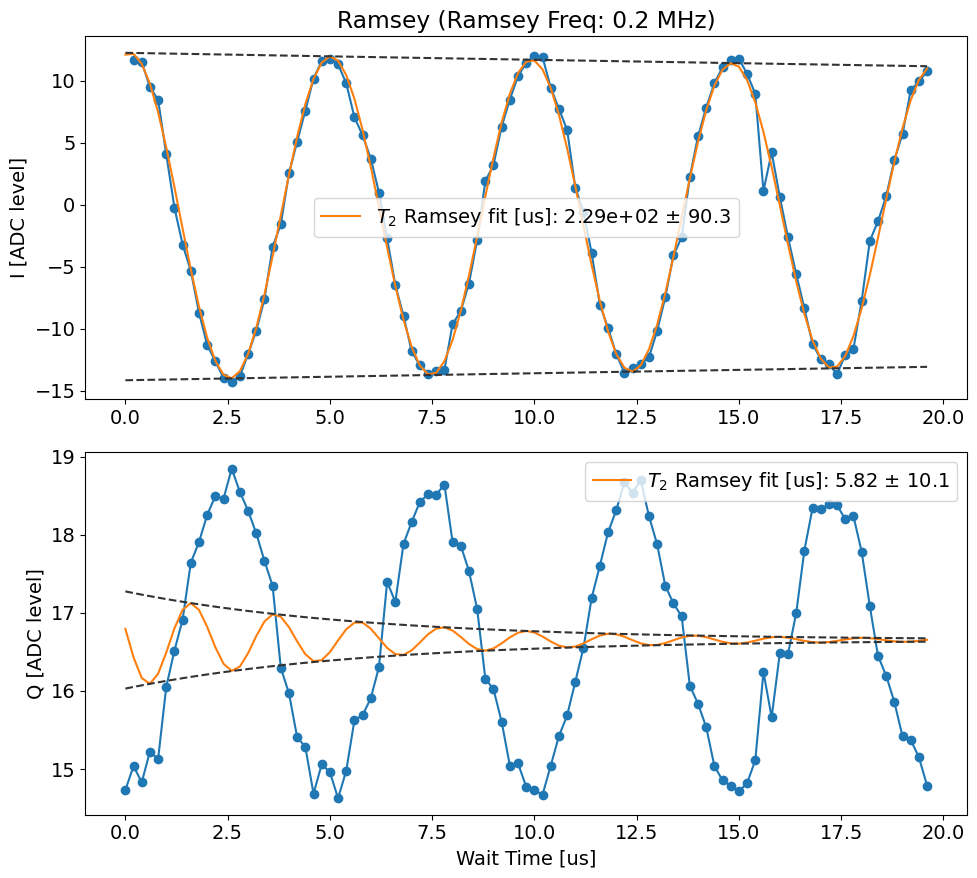

In [1429]:
temp_data, attrs = prev_data(expt_path, '00136_RamseyExperiment.h5')
Ramsey_display(temp_data,  attrs, normalize = [False, 'g_data', 'e_data'], active_reset=False, threshold = -4.323194812977462, readouts_per_rep=4,
                ramsey_freq=attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['device']['qubit']['f_ge_idle'][0], fit=True, title='Ramsey')

### Man 1 Reset 

487
474
470
482
479
480
481
478
472
484
484
475
482
475
478
481
480
478
482
477
477
473
483
479
480
484
478
479
477
479
480
472
477
484
478
482
481
481
473
483
476
477
469
479
473
480
478
481
479
474
481
486
481
474
484
485
481
478
476
478
482
480
488
477
476
474
479
471
476
477
478
468
485
484
478
483
474
478
478
483
476
478
478
481
477
481
474
490
478
479
480
481
476
482
477
476
485
479
486
Current pi pulse frequency: 3568.1904347121535
Fit frequency from I [MHz]: 0.4878593042573041 +/- 0.00033196383383223785
Suggested new pi pulse frequency from fit I [MHz]:
 	3567.902575407896
 	3568.878294016411
T2 Ramsey from fit I [us]: 116.38480747885013
Fit frequency from Q [MHz]: 0.4871633981063001 +/- 0.0009907108293673575
Suggested new pi pulse frequencies from fit Q [MHz]:
 	3567.9032713140473
 	3568.87759811026
T2 Ramsey from fit Q [us]: 106.36053083564276


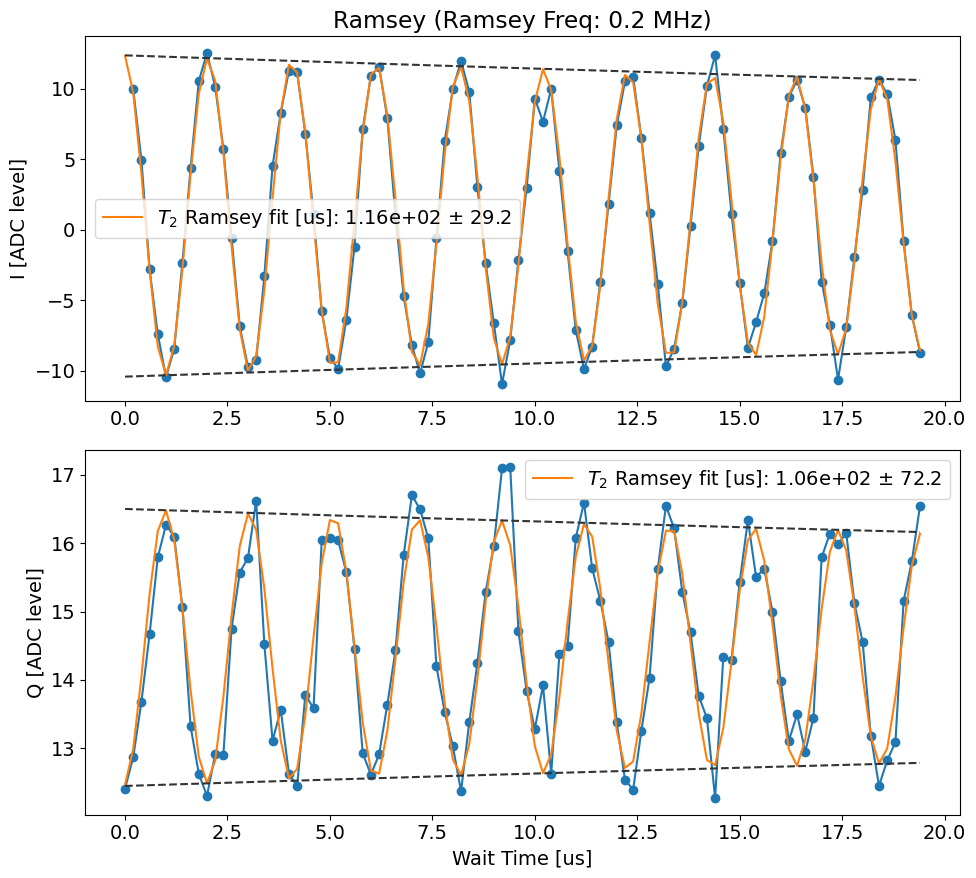

In [1439]:
temp_data, attrs = prev_data(expt_path, '00145_RamseyExperiment.h5')
Ramsey_display(temp_data,  attrs, normalize = [False, 'g_data', 'e_data'], active_reset=True, threshold = -4.323194812977462, readouts_per_rep=4,
                ramsey_freq=attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['device']['qubit']['f_ge_idle'][0], fit=True, title='Ramsey')

### Man 2 Reset

484
482
482
479
491
486
484
483
485
480
485
483
482
483
478
489
487
478
482
482
481
482
488
479
487
482
483
488
486
482
482
482
481
486
487
490
479
484
485
476
483
480
482
487
485
485
488
481
485
488
482
475
485
475
491
484
488
486
483
479
482
487
482
485
486
473
479
478
483
482
490
479
483
485
479
493
481
484
481
482
485
488
480
489
484
471
479
484
483
479
481
489
486
490
488
482
480
480
476
Current pi pulse frequency: 3568.1904347121535
Fit frequency from I [MHz]: 0.47419014961136735 +/- 0.00042878273422268667
Suggested new pi pulse frequency from fit I [MHz]:
 	3567.916244562542
 	3568.8646248617647
T2 Ramsey from fit I [us]: 83.32727940823042
Fit frequency from Q [MHz]: 0.4746669380839105 +/- 0.0008962256211005378
Suggested new pi pulse frequencies from fit Q [MHz]:
 	3567.9157677740695
 	3568.8651016502376
T2 Ramsey from fit Q [us]: 101.62302016626151


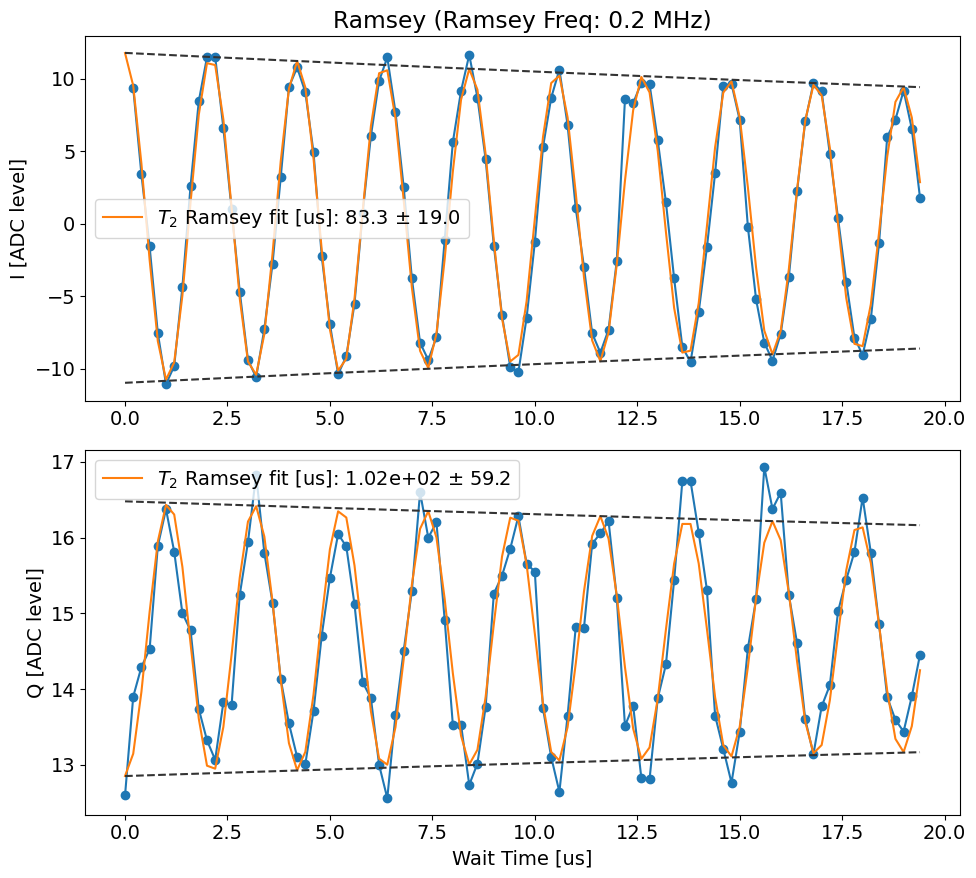

In [1437]:
temp_data, attrs = prev_data(expt_path, '00143_RamseyExperiment.h5')
Ramsey_display(temp_data,  attrs, normalize = [False, 'g_data', 'e_data'], active_reset=True, threshold = -4.323194812977462, readouts_per_rep=4,
                ramsey_freq=attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['device']['qubit']['f_ge_idle'][0], fit=True, title='Ramsey')

### Stor1  Reset

480
483
483
482
482
479
486
477
484
479
487
490
478
484
483
480
483
481
483
480
479
486
474
479
489
475
485
486
490
479
481
488
476
483
485
485
489
483
483
490
482
488
481
481
478
483
487
481
488
477
486
473
483
481
485
478
481
486
476
482
492
483
488
486
481
485
477
490
484
484
480
483
488
482
482
487
486
479
476
487
489
477
485
482
489
483
485
490
485
483
486
486
483
484
487
483
487
483
484
Current pi pulse frequency: 3568.1904347121535
Fit frequency from I [MHz]: 0.2041812532381577 +/- 0.00024759192182769075
Suggested new pi pulse frequency from fit I [MHz]:
 	3568.1862534589154
 	3568.5946159653918
T2 Ramsey from fit I [us]: 165.9966947099278
Fit frequency from Q [MHz]: 0.20425517018633665 +/- 0.000699733360982073
Suggested new pi pulse frequencies from fit Q [MHz]:
 	3568.1861795419672
 	3568.59468988234
T2 Ramsey from fit Q [us]: 150.10094560148767


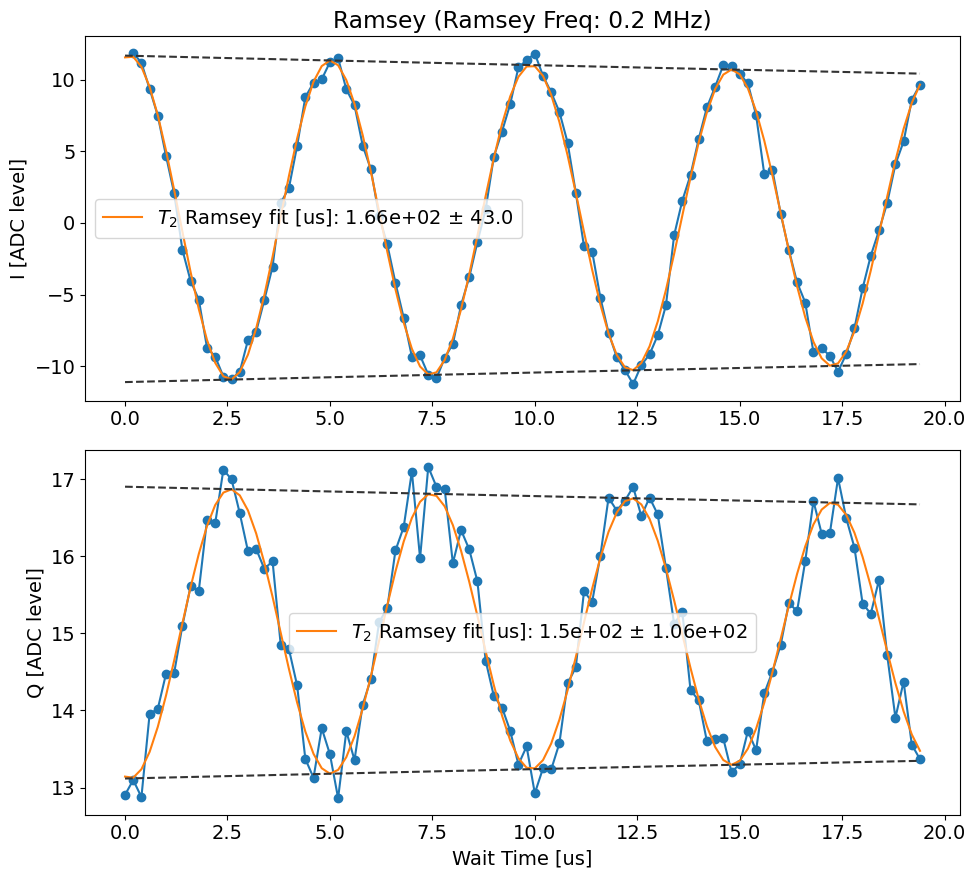

In [1435]:
temp_data, attrs = prev_data(expt_path, '00142_RamseyExperiment.h5')
Ramsey_display(temp_data,  attrs, normalize = [False, 'g_data', 'e_data'], active_reset=True, threshold = -4.323194812977462, readouts_per_rep=4,
                ramsey_freq=attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['device']['qubit']['f_ge_idle'][0], fit=True, title='Ramsey')

In [1144]:
def filter_data(II, threshold, readout_per_experiment=2):
    # assume the last one is experiment data, the last but one is for post selection
    result = []
    
    
    for k in range(len(II) // readout_per_experiment):
        index_4k_plus_2 = readout_per_experiment * k + readout_per_experiment-2
        index_4k_plus_3 = readout_per_experiment * k + readout_per_experiment-1
        
        # Ensure the indices are within the list bounds
        if index_4k_plus_2 < len(II) and index_4k_plus_3 < len(II):
            # Check if the value at 4k+2 exceeds the threshold
            if II[index_4k_plus_2] > threshold:
                # Add the value at 4k+3 to the result list
                result.append(II[index_4k_plus_3])
    
    return result

def filter_data_IQ(II, IQ, threshold, readout_per_experiment=2):
    # assume the last one is experiment data, the last but one is for post selection
    result_Ig = []
    result_Ie = []
    
    
    for k in range(len(II) // readout_per_experiment):
        index_4k_plus_2 = readout_per_experiment * k + readout_per_experiment-2
        index_4k_plus_3 = readout_per_experiment * k + readout_per_experiment-1
        
        # Ensure the indices are within the list bounds
        if index_4k_plus_2 < len(II) and index_4k_plus_3 < len(II):
            # Check if the value at 4k+2 exceeds the threshold
            if II[index_4k_plus_2] < threshold:
                # Add the value at 4k+3 to the result list
                result_Ig.append(II[index_4k_plus_3])
                result_Ie.append(IQ[index_4k_plus_3])
    
    return np.array(result_Ig), np.array(result_Ie)
def post_select_raverager_data(temp_data, attrs, threshold, readouts_per_rep):
    read_num = readouts_per_rep
    rounds = attrs['config']['expt']['rounds']
    reps = attrs['config']['expt']['reps']
    expts = attrs['config']['expt']['expts']
    I_data = np.array(temp_data['idata'])
    Q_data = np.array(temp_data['qdata'])

    # reshape data into (read_num x rounds x reps x expts)
    # I_data = np.reshape(np.transpose(np.reshape(I_data, (rounds, expts, reps, read_num)), (3, 0, 2, 1)), (read_num, rounds*reps, expts))
    # Q_data = np.reshape(np.transpose(np.reshape(Q_data, (rounds, expts, reps, read_num)), (3, 0, 2, 1)), (read_num, rounds*reps, expts))

    I_data = np.reshape(np.transpose(np.reshape(I_data, (rounds, expts, reps, read_num)), (1, 0, 2, 3)), (expts, rounds*reps * read_num))
    Q_data = np.reshape(np.transpose(np.reshape(Q_data, (rounds, expts, reps, read_num)), (1, 0, 2, 3)), (expts, rounds*reps * read_num))

    # ## Read tomography code for reshaping if rounds neq 1
    # I_data_ = np.reshape(I_data, (xpts, reps*read_num))
    # Q_data_ = np.reshape(Q_data, (xpts, reps*read_num))

    # now we do post selection
    Ilist = []
    Qlist = []
    for ii in range(len(I_data)-1):
        Ig, Qg = filter_data_IQ(I_data[ii], Q_data[ii], threshold, readout_per_experiment=read_num)
        Ilist.append(np.mean(Ig))
        Qlist.append(np.mean(Qg))


    return Ilist, Qlist

In [1194]:
temp_data, attrs = prev_data(expt_path, '00051_RamseyExperiment.h5')
temp_data['idata'].shape
read_num = 4 #readouts_per_rep
rounds = attrs['config']['expt']['rounds']
reps = attrs['config']['expt']['reps']
expts = attrs['config']['expt']['expts']
I_data = np.array(temp_data['idata'])
Q_data = np.array(temp_data['qdata'])
threshold = -4.323194812977462

1474
1472
1484
1472
1486
1480
1481
1488
1492
1494
1487
1496
1498
1496
1493
1488
1491
1486
1474
1486
1476
1478
1476
1479
1473
1477
1477
1479
1477
1471
1483
1489
1487
1479
1489
1486
1496
1484
1496
1495
1489
1490
1490
1485
1486
1483
1478
1486
1474
1484
1472
1487
1478
1476
1487
1476
1487
1490
1486
1493
1487
1486
1495
1489
1484
1486
1486
1482
1467
1485
1467
1475
1481
1481
1483
1481
1475
1482
1487
1484
1485
1486
1488
1494
1490
1493
1492
1492
1491
1483
1485
1491
1481
1491
1489
1480
1489
1490
1482
1482


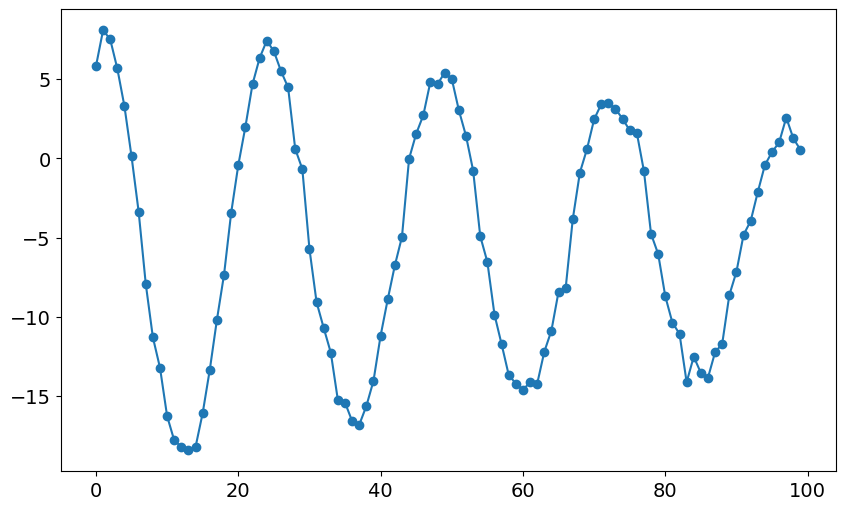

In [1195]:
d1 = np.reshape(I_data[0::4], (expts, rounds*reps))
d2 = np.reshape(I_data[1::4], (expts, rounds*reps))
d3 = np.reshape(I_data[2::4], (expts, rounds*reps))
d4 = np.reshape(I_data[3::4], (expts, rounds*reps))


# I1 = [np.average(raw_data[idx ::1500]) for idx in range(100)]
# d4 = [np.average(raw_data[idx*1500:(idx+1)*1500]) for idx in range(100)]

new_data = []
for expt in range(expts): 
    d3_ = d3[expt]
    d4_ = d4[expt]
    final = []
    for idx in range(len(d3_)): 
        if d3_[idx] <threshold: 
            final.append(d4_[idx])
    avg_expt= np.mean(final)
    print(len(final))
    new_data.append(avg_expt)
plt.plot(new_data, '-o')



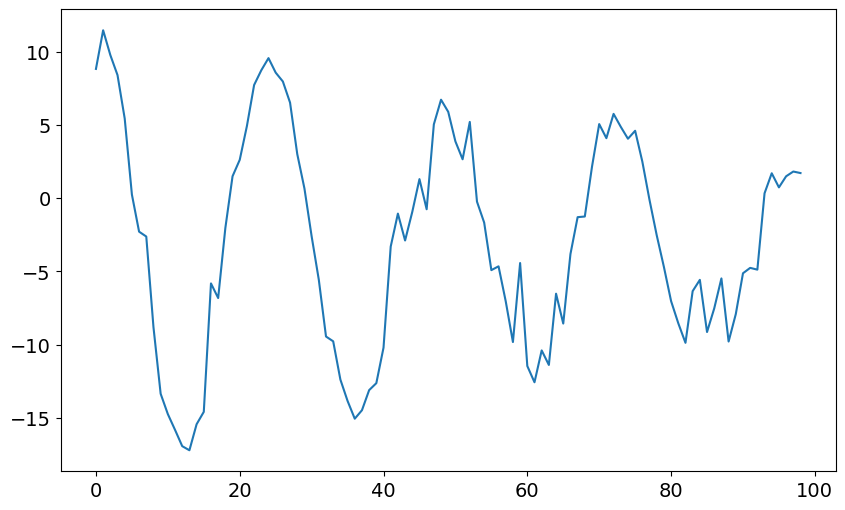

In [1143]:
threshold = 3
read_num = 4

def post_select_raverager_data(temp_data, attrs, threshold, readouts_per_rep):
    read_num = readouts_per_rep
    rounds = attrs['config']['expt']['rounds']
    reps = attrs['config']['expt']['reps']
    expts = attrs['config']['expt']['expts']
    I_data = np.array(temp_data['idata'])
    Q_data = np.array(temp_data['qdata'])

    # reshape data into (read_num x rounds x reps x expts)
    # I_data = np.reshape(np.transpose(np.reshape(I_data, (rounds, expts, reps, read_num)), (3, 0, 2, 1)), (read_num, rounds*reps, expts))
    # Q_data = np.reshape(np.transpose(np.reshape(Q_data, (rounds, expts, reps, read_num)), (3, 0, 2, 1)), (read_num, rounds*reps, expts))

    I_data = np.reshape(np.transpose(np.reshape(I_data, (rounds, expts, reps, read_num)), (1, 0, 2, 3)), (expts, rounds*reps * read_num))
    Q_data = np.reshape(np.transpose(np.reshape(Q_data, (rounds, expts, reps, read_num)), (1, 0, 2, 3)), (expts, rounds*reps * read_num))

    # ## Read tomography code for reshaping if rounds neq 1
    # I_data_ = np.reshape(I_data, (xpts, reps*read_num))
    # Q_data_ = np.reshape(Q_data, (xpts, reps*read_num))

    # now we do post selection
    Ilist = []
    Qlist = []
    for ii in range(len(I_data)-1):
        Ig, Qg = filter_data_IQ(I_data[ii], Q_data[ii], threshold, readout_per_experiment=read_num)
        Ilist.append(np.mean(Ig))
        Qlist.append(np.mean(Qg))


    return Ilist, Qlist

### Man1 at |1>

Current pi pulse frequency: 3568.1904347121535
Fit frequency from I [MHz]: 0.48633249868690626 +/- 0.0003597543889051978
Suggested new pi pulse frequency from fit I [MHz]:
 	3567.9041022134666
 	3568.8767672108406
T2 Ramsey from fit I [us]: 96.52975518334725
Fit frequency from Q [MHz]: 0.486116640553044 +/- 0.0016890128247903716
Suggested new pi pulse frequencies from fit Q [MHz]:
 	3567.9043180716003
 	3568.8765513527064
T2 Ramsey from fit Q [us]: 55.34553757075122


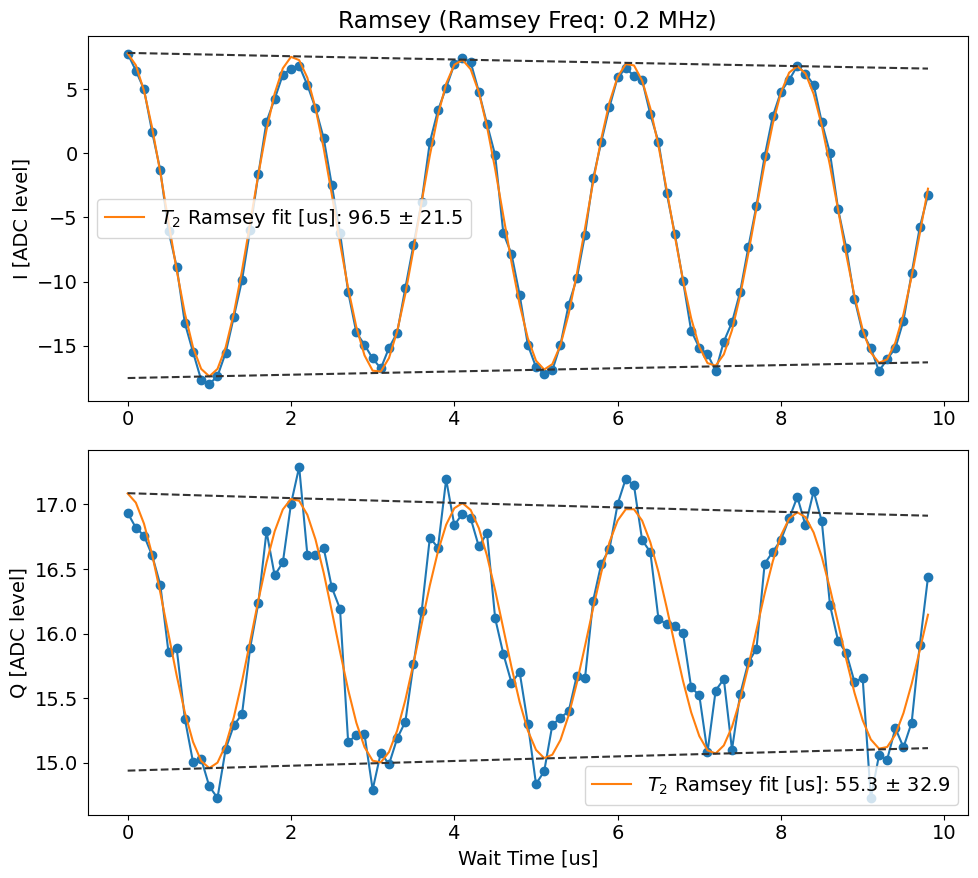

In [1219]:
temp_data, attrs = prev_data(expt_path, '00067_RamseyExperiment.h5')
Ramsey_display(temp_data,  attrs, normalize = [False, 'g_data', 'e_data'], active_reset=False, threshold = -4.323194812977462, readouts_per_rep=4,
                ramsey_freq=attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['device']['qubit']['f_ge_idle'][0], fit=True, title='Ramsey')

1471
1484
1468
1477
1475
1473
1481
1478
1477
1482
1472
1465
1484
1477
1481
1482
1468
1481
1472
1479
1475
1473
1478
1477
1478
1471
1475
1471
1471
1475
1475
1474
1469
1477
1472
1477
1484
1474
1465
1481
1484
1478
1485
1484
1476
1469
1482
1483
1481
1485
1480
1485
1478
1483
1480
1472
1470
1468
1481
1478
1472
1484
1481
1477
1483
1481
1485
1475
1473
1472
1478
1474
1476
1483
1475
1467
1472
1468
1467
1470
1465
1473
1476
1477
1472
1473
1479
1471
1476
1473
1478
1468
1482
1478
1484
1480
1480
1470
1484
Current pi pulse frequency: 3568.1904347121535
Fit frequency from I [MHz]: 0.48402309977187613 +/- 0.0015313105597035907
Suggested new pi pulse frequency from fit I [MHz]:
 	3567.906411612382
 	3568.8744578119254
T2 Ramsey from fit I [us]: 78.02677210116283
Fit frequency from Q [MHz]: 0.4810877864342659 +/- 0.0023728807904598507
Suggested new pi pulse frequencies from fit Q [MHz]:
 	3567.909346925719
 	3568.8715224985876
T2 Ramsey from fit Q [us]: 35.87026105419123


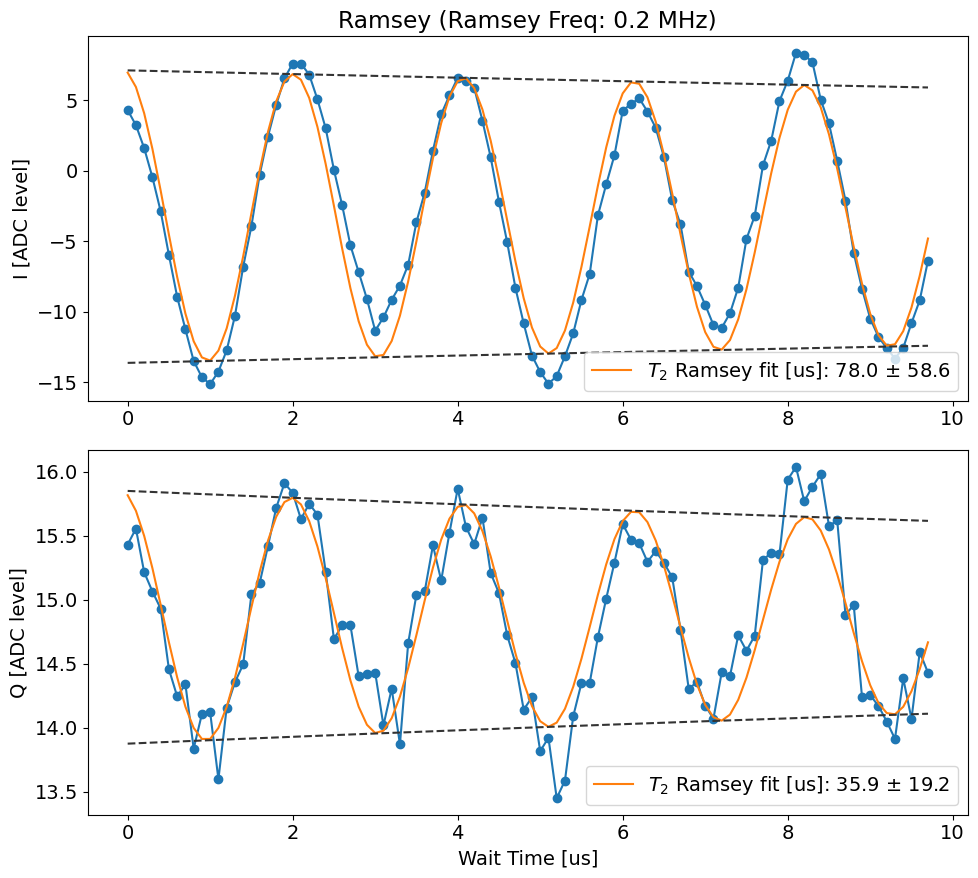

In [1232]:
temp_data, attrs = prev_data(expt_path, '00073_RamseyExperiment.h5')
Ramsey_display(temp_data,  attrs, normalize = [False, 'g_data', 'e_data'], active_reset=True, threshold = -4.323194812977462, readouts_per_rep=4,
                ramsey_freq=attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['device']['qubit']['f_ge_idle'][0], fit=True, title='Ramsey')

### Man2 at |1>

Attempted to init fitparam 1 to 0.9595959595959596, which is out of bounds 0.00510204081632653 to 0.7653061224489796. Instead init to 0.385204081632653
Current pi pulse frequency: 3568.187817769269
Fit frequency from I [MHz]: 0.47213668445553686 +/- 0.000303367588092597
Suggested new pi pulse frequency from fit I [MHz]:
 	3567.915681084813
 	3568.859954453724
T2 Ramsey from fit I [us]: 59.923736298260025
Fit frequency from Q [MHz]: 0.47537327274093644 +/- 0.00692777501427075
Suggested new pi pulse frequencies from fit Q [MHz]:
 	3567.9124444965278
 	3568.86319104201
T2 Ramsey from fit Q [us]: 11.805761867669636


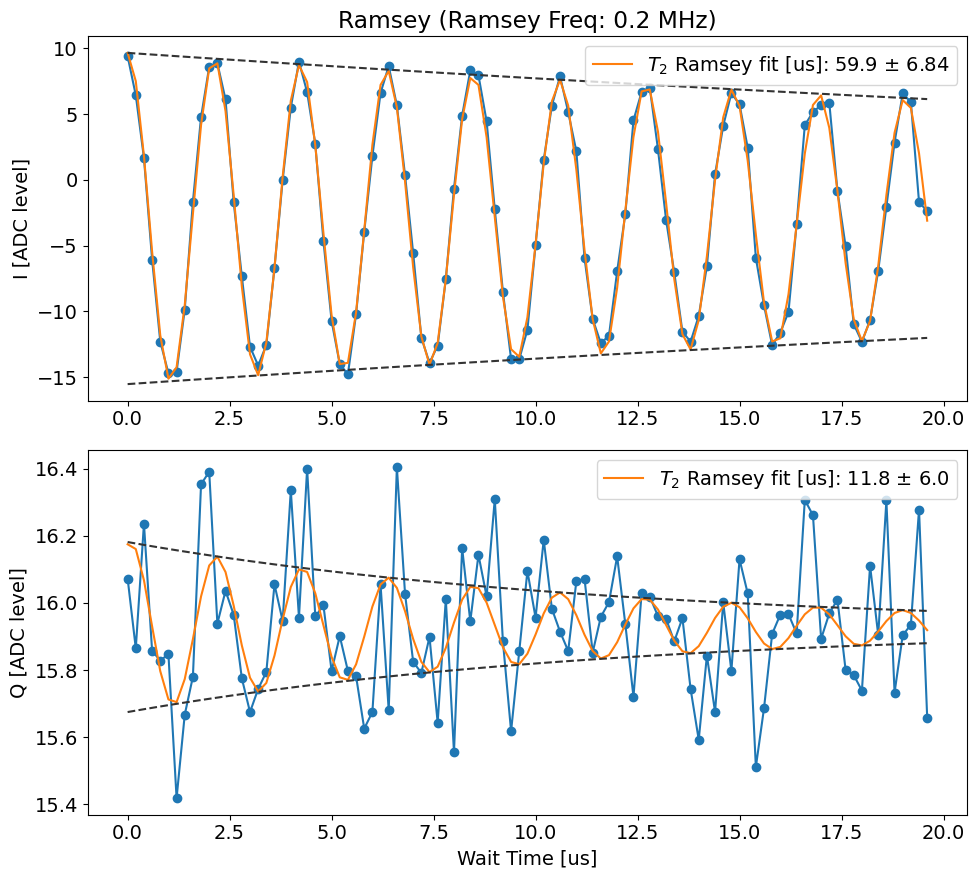

In [221]:
temp_data, attrs = prev_data(expt_path, '00008_RamseyExperiment.h5')
Ramsey_display(temp_data, normalize = [False, 'g_data', 'e_data'], ramsey_freq=attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['device']['qubit']['f_ge_idle'][0], fit=True, title='Ramsey')

## Ramsey User Defined

Attempted to init fitparam 1 to 1.4429530201342282, which is out of bounds 0.0033783783783783786 to 0.5067567567567567. Instead init to 0.25506756756756754
Attempted to init fitparam 1 to 2.214765100671141, which is out of bounds 0.0033783783783783786 to 0.5067567567567567. Instead init to 0.25506756756756754
Current pi pulse frequency: 4986.935933
Fit frequency from I [MHz]: 0.29944557150239387 +/- 0.007811758755577758
Suggested new pi pulse frequency from fit I [MHz]:
 	4986.836487428497
 	4987.435378571502
T2 Ramsey from fit I [us]: 14.667512486710367
Fit frequency from Q [MHz]: 0.31227801631822116 +/- 0.01038641078281128
Suggested new pi pulse frequencies from fit Q [MHz]:
 	4986.823654983681
 	4987.448211016318
T2 Ramsey from fit Q [us]: 16.926072785498935


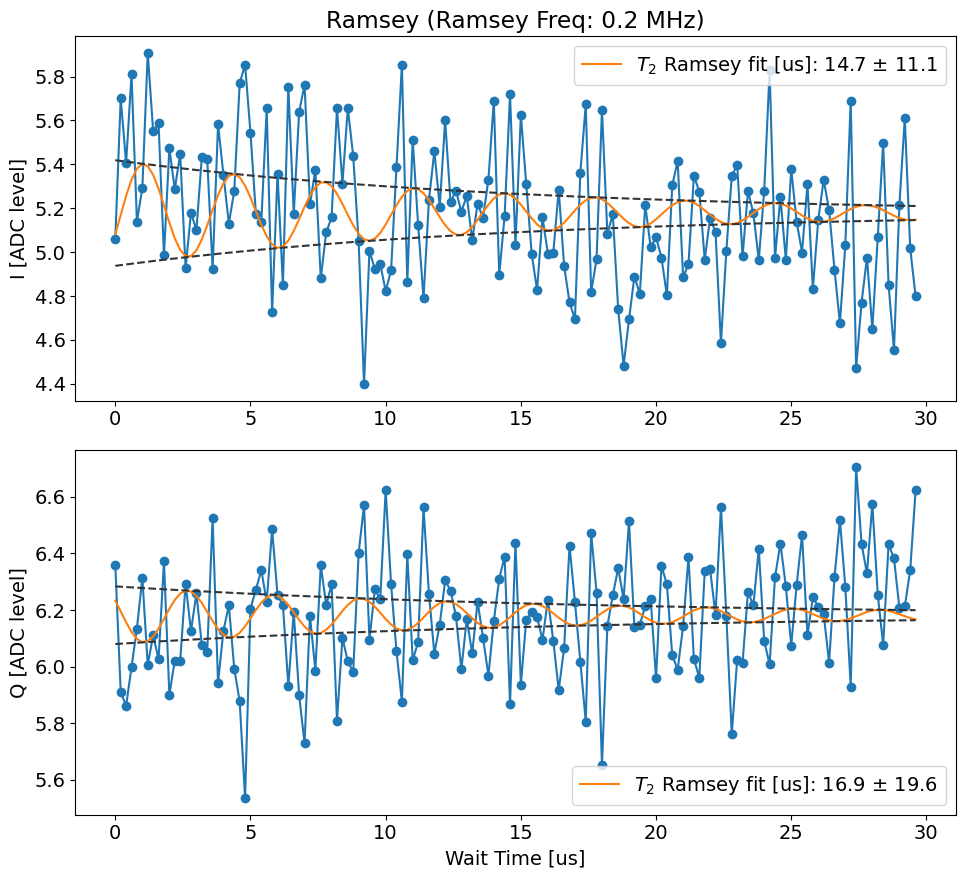

In [179]:
temp_data, attrs = prev_data(expt_path, '00042_RamseyExperiment.h5')
Ramsey_display(temp_data, normalize = [False, 'g_data', 'e_data'], ramsey_freq=attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['expt']['user_defined_freq'][1], fit=True, title='Ramsey')

## Ramsey EF

Current pi pulse frequency: 3425.5537944060666
Fit frequency from I [MHz]: 0.19738779936681639 +/- 0.0002662777105728357
Suggested new pi pulse frequency from fit I [MHz]:
 	3425.5564066067
 	3425.9511822054333
T2 Ramsey from fit I [us]: 87.03638141789898
Fit frequency from Q [MHz]: 0.19733522115988564 +/- 0.00026614267398885786
Suggested new pi pulse frequencies from fit Q [MHz]:
 	3425.5564591849065
 	3425.9511296272262
T2 Ramsey from fit Q [us]: 85.00786413333815


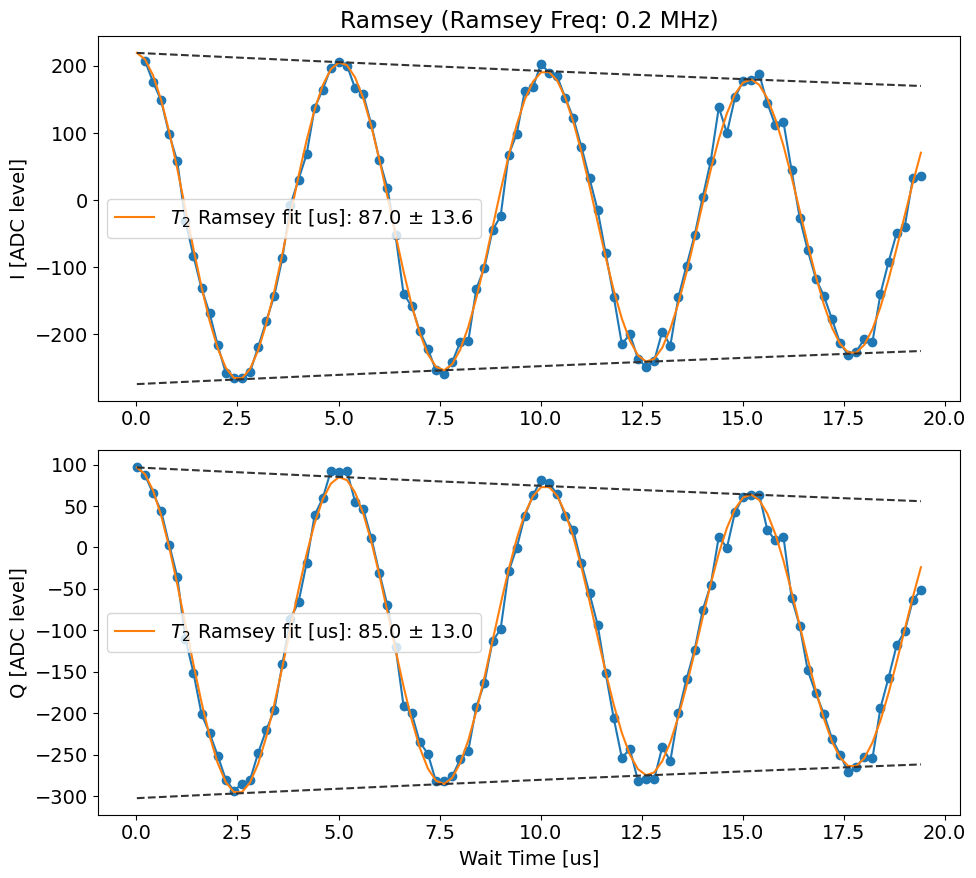

In [48]:
temp_data, attrs = prev_data(expt_path, '00221_RamseyExperiment.h5')
Ramsey_display(temp_data,  attrs, normalize = [False, 'g_data', 'e_data'], active_reset=True, threshold = -25.73026268397916, readouts_per_rep=4,
                ramsey_freq=attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['device']['qubit']['f_ef_idle'][0], fit=True, title='Ramsey')

In [2618]:
attrs['config']['expt']

{'start': 0.01,
 'step': 0.2,
 'expts': 100,
 'ramsey_freq': 0.2,
 'reps': 500,
 'rounds': 1,
 'qubits': [0],
 'checkEF': False,
 'user_defined_freq': [False, 3425.30098176373, 7575, 0.035],
 'qubit_ge_init': False,
 'qubit_ge_after': False,
 'f0g1_cavity': 0,
 'normalize': False,
 'active_reset': False,
 'man_reset': True,
 'storage_reset': True,
 'prepulse': False,
 'postpulse': False,
 'pre_active_reset_pulse': False,
 'pre_sweep_pulse': [[3568.1751638611518,
   3425.5537944060666,
   2006.72,
   3567.900564,
   3425.300982,
   2006.72],
  [9653, 7575, 15000, 9653, 3835, 15000],
  [0, 0, 0.6087495795755329, 0, 0, 0.6087495795755329],
  [0, 0, 0, 0, 0, 0],
  [2, 2, 5, 2, 2, 5],
  ['gaussian', 'gaussian', 'flat_top', 'gaussian', 'gaussian', 'flat_top'],
  [0.035, 0.035, 0.005, 0.035, 0.035, 0.005]],
 'pre_active_reset_sweep_pulse': [[3568.1904347121535,
   3425.5537944060666,
   2006.72,
   1053.42],
  [9653, 7575, 15000, 7500],
  [0, 0, 0.6168960348389007, 1.9560044830465644],
  [0, 

### man1 at |1>

Attempted to init fitparam 4 to 5.5, which is out of bounds 12.999772727272727 to 19.09524891774892. Instead init to 16.047510822510823
Current pi pulse frequency: 3425.559887601728
Fit frequency from I [MHz]: 0.20213369908530043 +/- 0.0008284620210776023
Suggested new pi pulse frequency from fit I [MHz]:
 	3425.5577539026426
 	3425.9620213008134
T2 Ramsey from fit I [us]: 62.123968753090075
Fit frequency from Q [MHz]: 0.20170155882510485 +/- 0.0008430458318491414
Suggested new pi pulse frequencies from fit Q [MHz]:
 	3425.558186042903
 	3425.961589160553
T2 Ramsey from fit Q [us]: 65.31169880173546


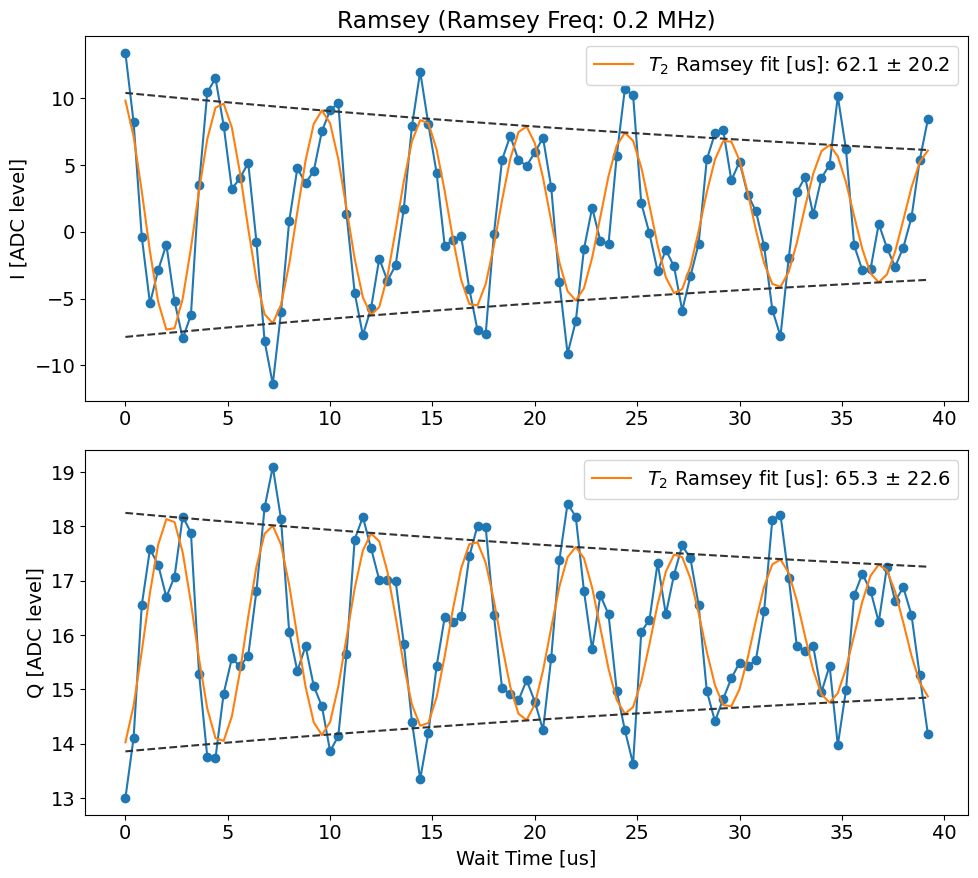

In [380]:
temp_data, attrs = prev_data(expt_path, '00044_RamseyExperiment.h5')
# fitparams=[amp, freq (non-angular), phase (deg), decay time, amp offset, decay time offset]
Ramsey_display(temp_data, ramsey_freq=attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['device']['qubit']['f_ef'][0], fit=True, fitparams=[3.5, None, 90, None, 5.5, None], title='Ramsey')

In [357]:
3422.72-(3423.4551757956383-3423.209680676009)

3422.4745048803707

### man2 at |1>

## Storage 5 sweep

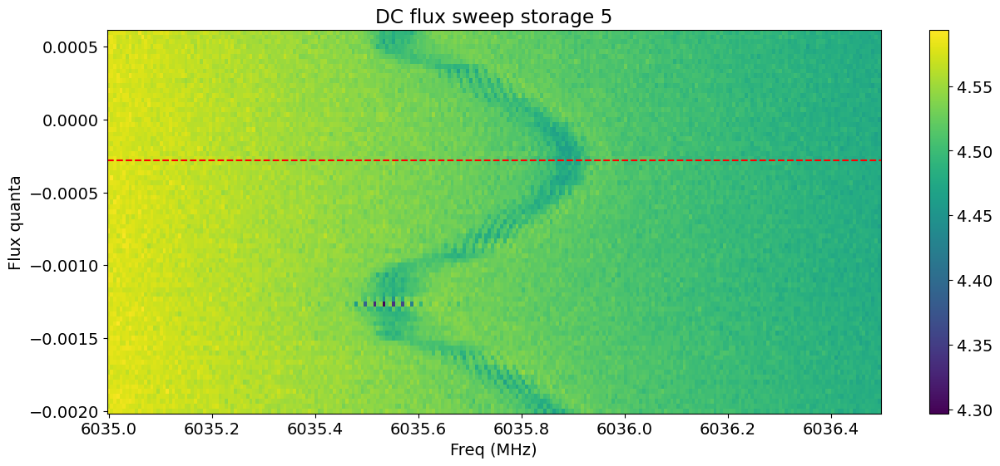

In [443]:
file_list = np.arange(116,195,1)
vary_pts = (linspace(-0.002, 0.002, 121))
y_list = []
freq_list = []
name = '_dc_flux_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['amps']
    len_x = temp_data['xpts']
    y_list.append(signal_y)

plot_cavity_sweep(len_x, vary_pts[0:len(y_list)], np.array(y_list), hlines=[-0.00028], vlines=None, title="DC flux sweep storage 5")
    

## Storage 4 sweep

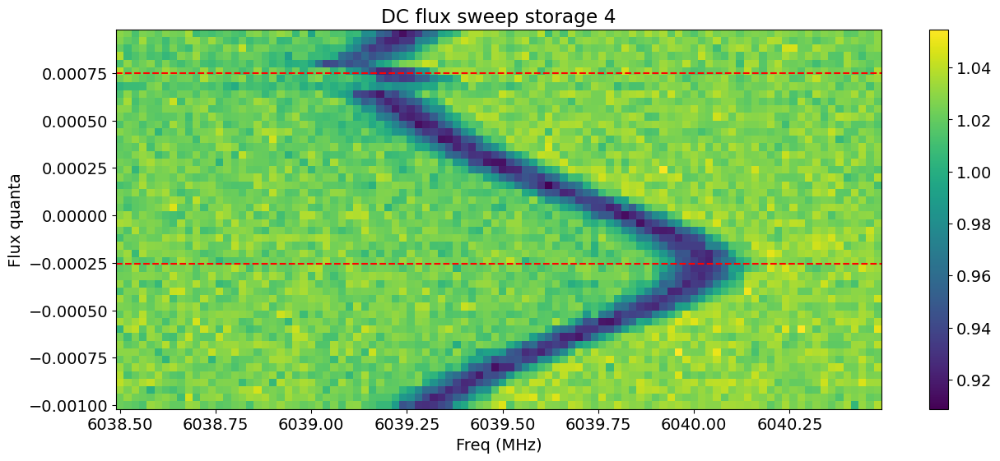

In [12]:
file_list = np.arange(5,55,1)
vary_pts = (linspace(-0.001, 0.001, 51))
y_list = []
freq_list = []
name = '_dc_flux_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['amps']
    len_x = temp_data['xpts']
    y_list.append(signal_y)

plot_cavity_sweep(len_x, vary_pts[0:len(y_list)], np.array(y_list), hlines=[-0.000255, 0.00075], vlines=None, title="DC flux sweep storage 4")
    

## Storage ramsey

### Storage 1

493
493
489
491
492
496
491
491
492
491
493
490
486
487
493
491
483
493
489
492
493
490
491
493
490
488
490
495
491
490
486
491
495
491
492
491
491
489
493
492
492
494
489
494
495
489
491
493
492
486
490
492
493
490
496
488
491
491
495
489
496
491
494
493
494
492
494
486
493
487
491
490
495
491
494
492
492
489
490
493
489
496
488
494
493
494
488
497
490
491
489
492
493
496
492
496
493
490
493
493


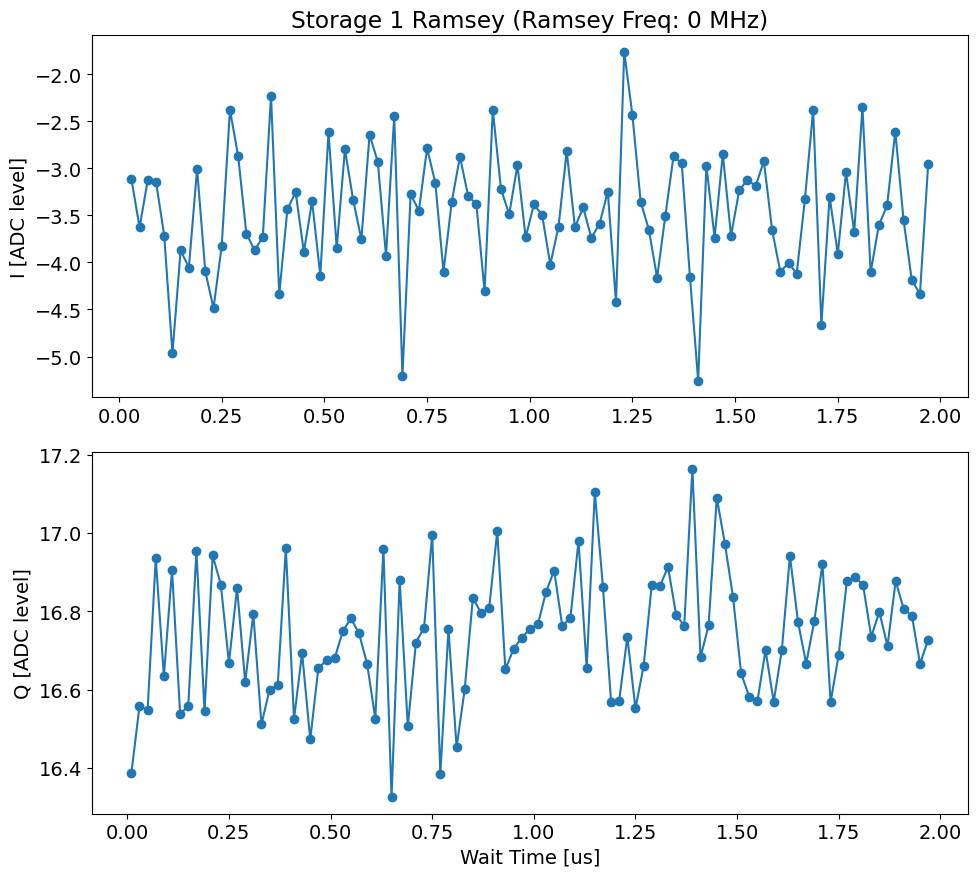

In [2610]:
temp_data, attrs = prev_data(expt_path, '00104_CavityRamseyExperiment.h5')   #39
temp_data, attrs = prev_data(expt_path, '00169_CavityRamseyExperiment.h5')
# temp_data, attrs = prev_data(expt_path, '00065_cross_kerr_sweep.h5')
temp_data, attrs = prev_data(expt_path, '00238_CavityRamseyExperiment.h5')
# temp_data, attrs = prev_data(expt_path, '00207_CavityRamseyExperiment.h5')
Ramsey_display(temp_data, attrs, ramsey_freq=attrs['config']['expt']['ramsey_freq'], 
               active_reset=True, threshold=-4.323194812977462, readouts_per_rep=4, initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=False, fitparams = None, title='Storage 1 Ramsey')

In [2606]:
attrs['config']['expt']

{'start': 0.01,
 'step': 6,
 'expts': 101,
 'ramsey_freq': -2.95,
 'reps': 500,
 'rounds': 1,
 'qubits': [0],
 'checkEF': False,
 'f0g1_cavity': 0,
 'init_gf': False,
 'active_reset': True,
 'man_reset': True,
 'storage_reset': True,
 'user_defined_pulse': [False, 4984.026194477733, 800, 0.15, 0, 4],
 'parity_meas': False,
 'man_idx': 1,
 'storage_ramsey': [True, 1],
 'prepulse': True,
 'postpulse': True,
 'pre_sweep_pulse': [[3568.1751638611518, 3425.5537944060666, 2006.72],
  [4930, 7575, 15000],
  [0, 0, 0.6168960348389007],
  [0, 0, 0],
  [2, 2, 5],
  ['gaussian', 'gaussian', 'flat_top'],
  [0.035, 0.035, 0.005]],
 'post_sweep_pulse': [[2006.72, 3425.5537944060666, 3568.1751638611518],
  [15000, 7575, 4930],
  [0.6168960348389007, 0, 0],
  [0, 0, 0],
  [5, 2, 2],
  ['flat_top', 'gaussian', 'gaussian'],
  [0.005, 0.035, 0.035]]}

480
485
478
473
477
465
461
486
465
476
479
481
470
476
460
454
464
470
476
481
479
477
480
457
469
478
483
480
485
480
472
473
463
473
471
474
473
461
476
473
471
464
475
476
480
472
484
491
480
487
485
485
486
478
481
487
477
481
481
479
478
485
488
484
476
478
490
479
478
483
484
482
481
484
487
489
486
486
479
488
484
482
492
482
485
483
484
489
483
484
487
490
479
486
481
487
478
474
486
490
Current pi pulse frequency: 4984.02431625832
Fit frequency from I [MHz]: 0.01787460160879259 +/- 3.8953829595035894e-05
Suggested new pi pulse frequency from fit I [MHz]:
 	4984.086441656711
 	4984.122190859929
T2 Ramsey from fit I [us]: 208.58434029734065
Fit frequency from Q [MHz]: 0.018066607703014187 +/- 9.19287378147263e-05
Suggested new pi pulse frequencies from fit Q [MHz]:
 	4984.086249650617
 	4984.122382866023
T2 Ramsey from fit Q [us]: 199.3592667135309
486
487
480
486
484
478
489
488
490
488
482
485
486
484
483
484
481
488
485
491
489
489
481
482
481
486
486
482
486
486
492
481
484

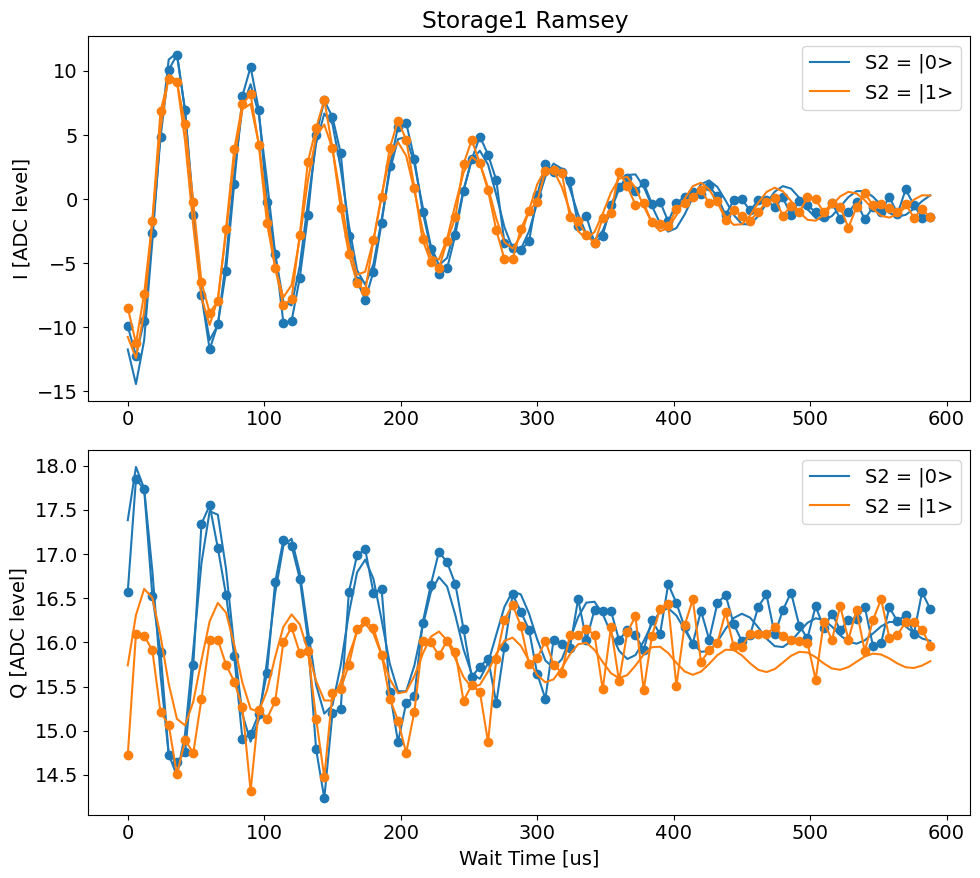

In [1880]:
file_list = np.array([169, 207])
label_list = [f'S2 = |0>', f'S2 = |1>']
color_list = ['tab:blue', 'tab:orange']#, 'tab:green']

temp_data, attrs = prev_data(expt_path, '00040_CavityRamseyExperiment.h5') # just to get configs
multiple_Ramsey_display(file_list, label_list, color_list, active_reset = True, threshold = -4.3, readouts_per_rep = 4,
                         ramsey_freq= attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
                         fitparams = None, #[100, 0.2, 90, 25.0, 8, None],
                           normalize= [False, 'g_data', 'e_data'], title='Storage1 Ramsey')

1973
1975
1964
1977
1986
1970
1971
1963
1966
1977
1961
1965
1971
1976
1971
1975
1974
1972
1976
1966
1967
1967
1971
1967
1970
1970
1974
1970
1972
1963
1964
1968
1959
1976
1979
1965
1973
1975
1968
1975
1975
1972
1967
1971
1978
1985
1970
1971
1971
1979
1966
1977
1961
1970
1974
1982
1969
1977
1967
1975
1982
1964
1972
1974
1983
1970
1979
1966
1971
1961
1964
1973
1971
1966
1968
1972
1973
1975
1962
1978
1967
1972
1960
1973
1971
1969
1960
1967
1974
1962
1966
1960
1975
1970
1964
1974
1971
1980
1968
1974
Attempted to init fitparam 1 to 0.1111111111111111, which is out of bounds 0.00034013605442176874 to 0.05102040816326531. Instead init to 0.02568027210884354
Current pi pulse frequency: 4984.02431625832
Fit frequency from I [MHz]: 0.03386155323841005 +/- 3.9672894933188376e-05
Suggested new pi pulse frequency from fit I [MHz]:
 	4984.070454705082
 	4984.138177811558
T2 Ramsey from fit I [us]: 290.97817789336096
Fit frequency from Q [MHz]: 0.03382925503503165 +/- 9.264834335457855e-05
Suggested n

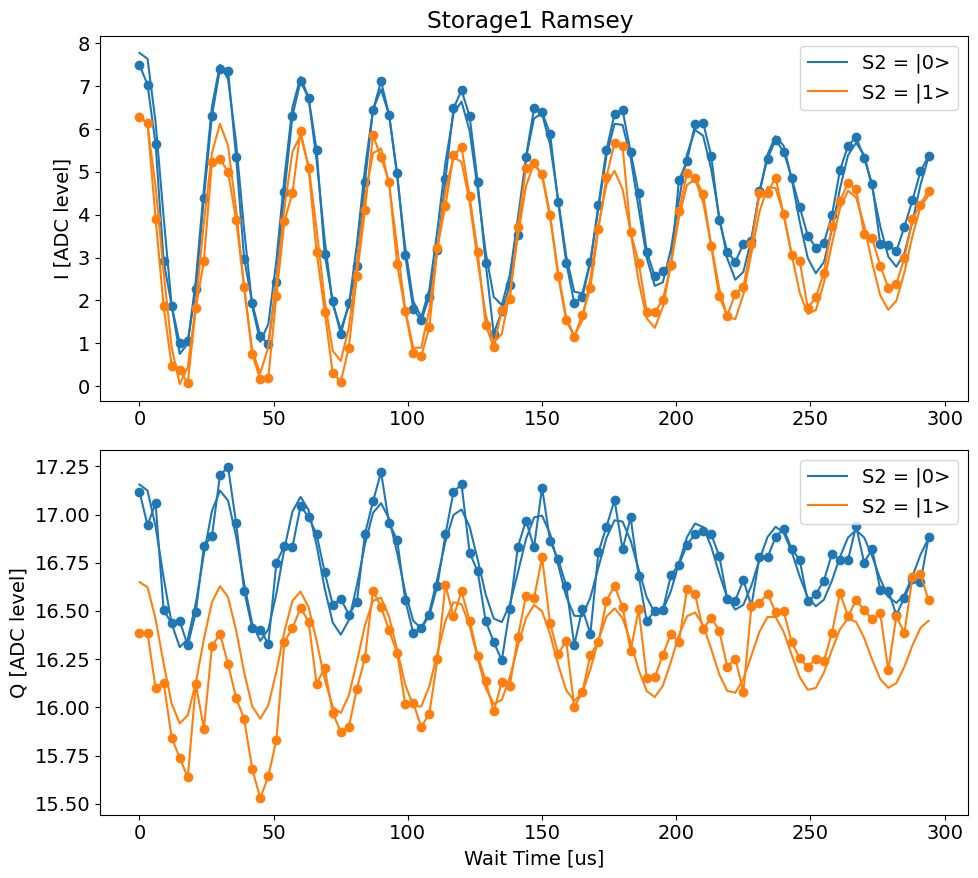

In [1657]:
file_list = np.array([66, 67])
label_list = [f'S2 = |0>', f'S2 = |1>']
color_list = ['tab:blue', 'tab:orange']#, 'tab:green']

temp_data, attrs = prev_data(expt_path, '00040_CavityRamseyExperiment.h5') # just to get configs
multiple_Ramsey_display(file_list, label_list, color_list, active_reset = True, threshold = -4.3, readouts_per_rep = 4,
                         ramsey_freq= attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
                         fitparams = None, #[100, 0.2, 90, 25.0, 8, None],
                           normalize= [False, 'g_data', 'e_data'], title='Storage1 Ramsey')

480
485
478
473
477
465
461
486
465
476
479
481
470
476
460
454
464
470
476
481
479
477
480
457
469
478
483
480
485
480
472
473
463
473
471
474
473
461
476
473
471
464
475
476
480
472
484
491
480
487
485
485
486
478
481
487
477
481
481
479
478
485
488
484
476
478
490
479
478
483
484
482
481
484
487
489
486
486
479
488
484
482
492
482
485
483
484
489
483
484
487
490
479
486
481
487
478
474
486
490
Current pi pulse frequency: 4984.02431625832
Fit frequency from I [MHz]: 0.01787460160879259 +/- 3.8953829595035894e-05
Suggested new pi pulse frequency from fit I [MHz]:
 	4984.086441656711
 	4984.122190859929
T2 Ramsey from fit I [us]: 208.58434029734065
Fit frequency from Q [MHz]: 0.018066607703014187 +/- 9.19287378147263e-05
Suggested new pi pulse frequencies from fit Q [MHz]:
 	4984.086249650617
 	4984.122382866023
T2 Ramsey from fit Q [us]: 199.3592667135309
485
487
479
493
483
486
481
489
480
492
483
484
486
487
483
485
484
484
486
489
489
486
485
490
490
487
487
485
486
493
481
493
484

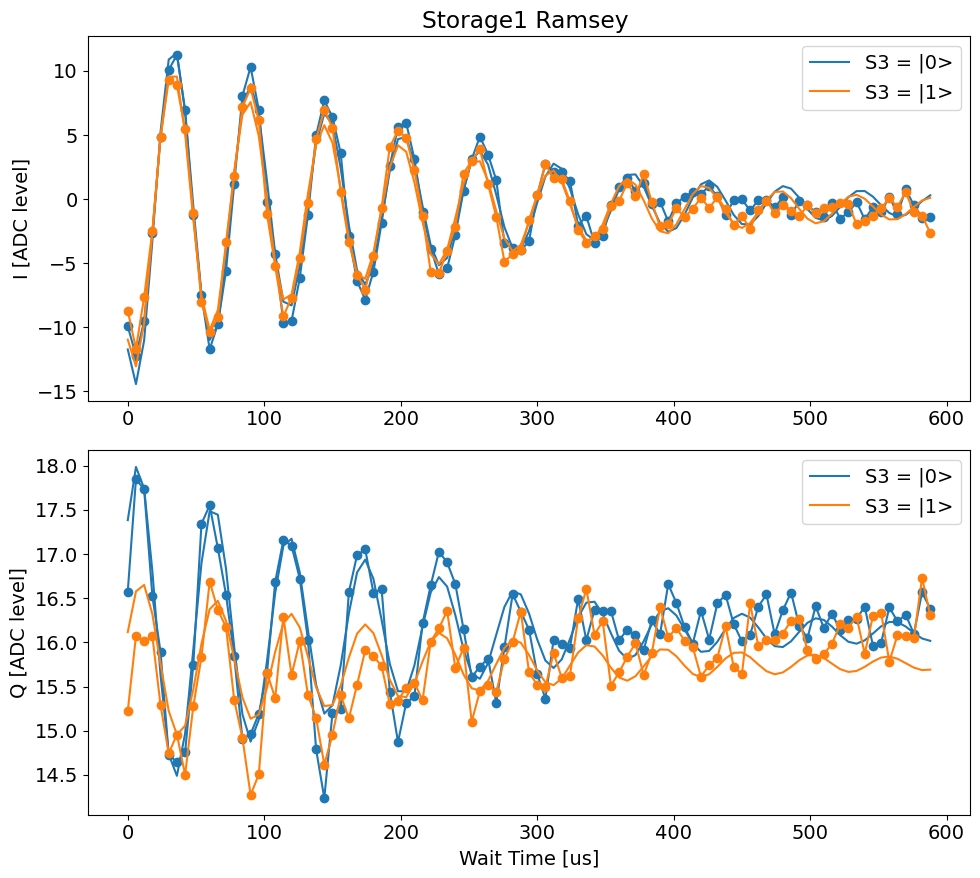

In [1883]:
file_list = np.array([169, 208])
label_list = [f'S3 = |0>', f'S3 = |1>']
color_list = ['tab:blue', 'tab:orange']#, 'tab:green']

temp_data, attrs = prev_data(expt_path, '00040_CavityRamseyExperiment.h5') # just to get configs
multiple_Ramsey_display(file_list, label_list, color_list, active_reset = True, threshold = -4.3, readouts_per_rep = 4,
                         ramsey_freq= attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
                         fitparams = None, #[100, 0.2, 90, 25.0, 8, None],
                           normalize= [False, 'g_data', 'e_data'], title='Storage1 Ramsey')

1973
1975
1964
1977
1986
1970
1971
1963
1966
1977
1961
1965
1971
1976
1971
1975
1974
1972
1976
1966
1967
1967
1971
1967
1970
1970
1974
1970
1972
1963
1964
1968
1959
1976
1979
1965
1973
1975
1968
1975
1975
1972
1967
1971
1978
1985
1970
1971
1971
1979
1966
1977
1961
1970
1974
1982
1969
1977
1967
1975
1982
1964
1972
1974
1983
1970
1979
1966
1971
1961
1964
1973
1971
1966
1968
1972
1973
1975
1962
1978
1967
1972
1960
1973
1971
1969
1960
1967
1974
1962
1966
1960
1975
1970
1964
1974
1971
1980
1968
1974
Attempted to init fitparam 1 to 0.1111111111111111, which is out of bounds 0.00034013605442176874 to 0.05102040816326531. Instead init to 0.02568027210884354
Current pi pulse frequency: 4984.02431625832
Fit frequency from I [MHz]: 0.03386155323841005 +/- 3.9672894933188376e-05
Suggested new pi pulse frequency from fit I [MHz]:
 	4984.070454705082
 	4984.138177811558
T2 Ramsey from fit I [us]: 290.97817789336096
Fit frequency from Q [MHz]: 0.03382925503503165 +/- 9.264834335457855e-05
Suggested n

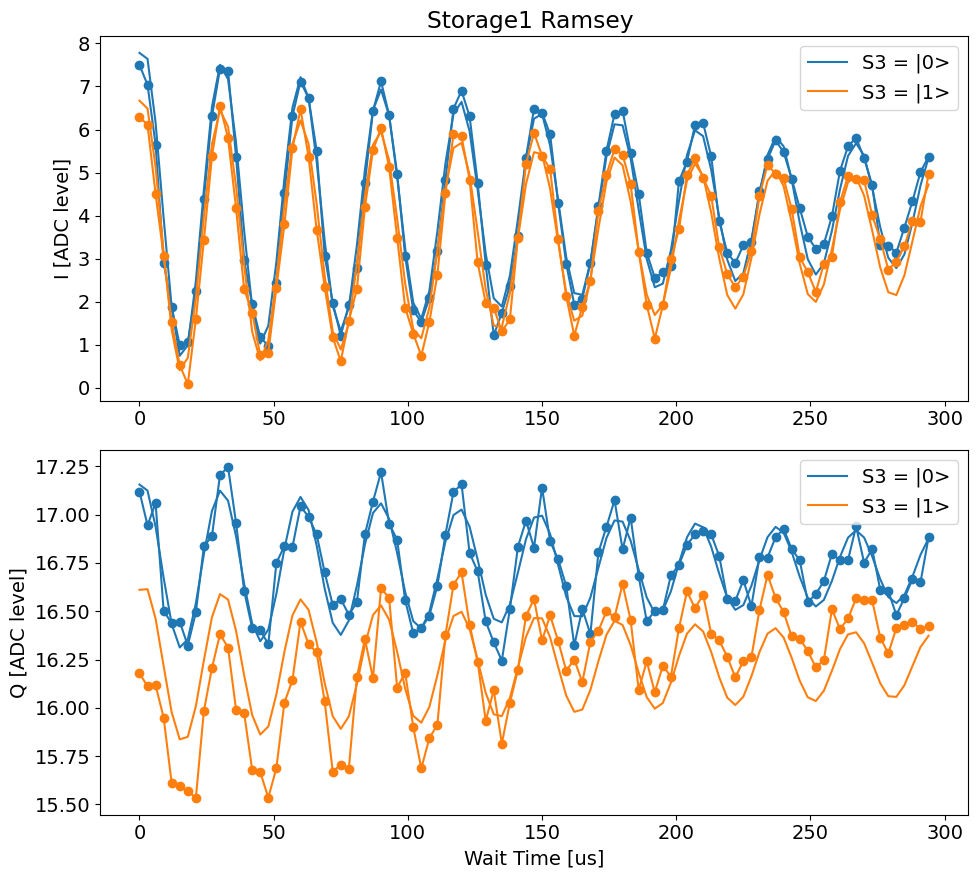

In [1659]:
file_list = np.array([66, 68])
label_list = [f'S3 = |0>', f'S3 = |1>']
color_list = ['tab:blue', 'tab:orange']#, 'tab:green']

temp_data, attrs = prev_data(expt_path, '00040_CavityRamseyExperiment.h5') # just to get configs
multiple_Ramsey_display(file_list, label_list, color_list, active_reset = True, threshold = -4.3, readouts_per_rep = 4,
                         ramsey_freq= attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
                         fitparams = None, #[100, 0.2, 90, 25.0, 8, None],
                           normalize= [False, 'g_data', 'e_data'], title='Storage1 Ramsey')

In [1653]:
attrs['config']['expt']

{'start': 0,
 'step': 3,
 'expts': 101,
 'ramsey_freq': 0.05,
 'reps': 2000,
 'rounds': 1,
 'qubits': [0],
 'checkEF': False,
 'f0g1_cavity': 0,
 'init_gf': False,
 'active_reset': True,
 'man_reset': True,
 'storage_reset': True,
 'user_defined_pulse': [True, 4984.02431625832, 700, 0.15, 0, 4],
 'parity_meas': True,
 'man_idx': 1,
 'manipulate': 0,
 'storage_ramsey': [True, 1],
 'prepulse': False,
 'postpulse': False,
 'pre_sweep_pulse': [[3568.187817769269, 3425.557033831784, 2006.76],
  [9653, 7575, 15000],
  [0, 0, 0.6151067375075144],
  [0, 0, 0],
  [2, 2, 5],
  ['gaussian', 'gaussian', 'flat_top'],
  [0.035, 0.035, 0.005]],
 'post_sweep_pulse': [[3567.9194338546786],
  [50],
  [6.288721018841144],
  [0],
  [2],
  ['flat_top'],
  [0.005]]}

#### Sweep for Kerr

Gain to alpha: 0.00093297


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


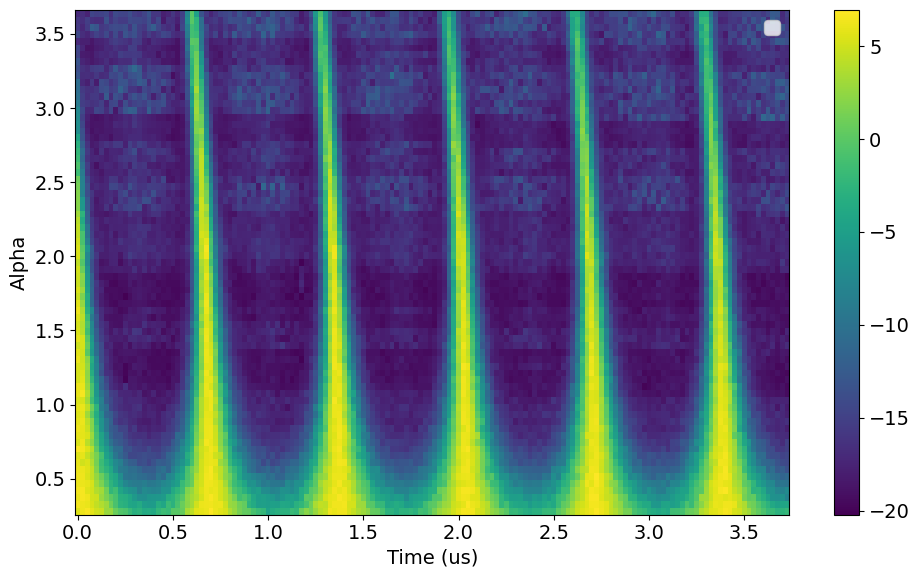

In [54]:
file_list = np.arange(625,698,1)
y_list = []
gain_list = []
name = '_cavity_ramsey_sweep.h5'
data_list = []
attrs_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    data_list.append(temp_data)
    attrs_list.append(attrs)
    gain_list.append(attrs['config']['expt']['user_defined_pulse'][2])

gain_to_alpha = 0.00031099 * 3 # attrs['config']['device']['manipulate']['gain_to_alpha'][0] * 3
alpha_list = np.array(gain_list)*gain_to_alpha
print('Gain to alpha:', gain_to_alpha)  

xlist, ylist, zlist = plot_ramsey_sideband(data_list, attrs_list, y_list = alpha_list, active_reset=True, threshold=-4.323194812977462, readouts_per_rep=4)

In [2475]:
attrs['config']['expt']['user_defined_pulse']

[True, 4984.026194477733, 600, 0.15, 0, 4]

In [2476]:
attrs['config']['device']['manipulate']['gain_to_alpha'][0]

0.00014572

In [55]:
import numpy as np
from scipy.optimize import minimize

idx_list = np.arange(0, len(ylist), 1)
freqs = []
alpha_list_ = []
t0s = []
alpha_list = ylist

for idx in idx_list:

# parameters for the model
# idx = 15
# pr
# int(f'Alpha: {alpha_list[idx]}')
#choose the ydata 
    ydata = zlist[idx]
    tlist = xlist
    omega = 0.5 * 2 *np.pi # MHz 
    alpha = alpha_list[idx]
    print(f'Alpha: {alpha_list[idx]}')

    args = {'alpha': alpha, 'omega': omega, 't0': 0.3}


    def small_angle_approx_P0(t, args): 
        return np.exp(-2* np.abs(args['alpha'])**2 * (1 - np.cos(args['omega'] * (t + args['t0']))) )




    #rescale data to be between 0 and 1
    min_value_model = np.exp(-2*2* np.abs(alpha)**2)
    ydata_scaled = (ydata - min(ydata))/(max(ydata) - min(ydata))

    # Map the scaled data to have min value of min_value_model and max value of 1
    min_value_model = np.exp(-2*2* np.abs(alpha)**2)
    ydata_final = ydata_scaled * (1 - min_value_model) + min_value_model




    # rescale data between 1 and min value

    # invert data
    # ydata = 1 - ydata
    # rescale data to have max value of max(ws)
    # ydata = ydata * max(ws)

    # Objective function to fit data to wigner function curve 
    def objective(param):

        args['omega'] = param[0]
        args['t0'] = param[1]
        ws = small_angle_approx_P0(tlist, args)

        return np.sum(np.abs(ws - ydata_final))  # sum of absolute differences

    # Initial guess for start and end of alpha_list
    initial_guess = [1.5 * 2 * np.pi, 0]

    # Bounds for start and end values of alpha_list
    bounds = [(1 * 2 * np.pi, 2 * 2 * np.pi), (-0.5, 1)]

    # Run the optimizer
    result = minimize(objective, initial_guess, bounds=bounds, tol=1e-5, options={'disp': True}) #, method = 'BFGS')

    # store all params
    freqs.append(result.x[0])
    t0s.append(result.x[1])
    alpha_list_.append(alpha_list[idx])

# plt.plot(tlist, ydata, 'o', label='Data')
# plt.plot(tlist, small_angle_approx_P0(tlist, args), label='Model')
# print(result.x)

Alpha: 0.279891
Alpha: 0.3265395
Alpha: 0.37318799999999996
Alpha: 0.4198365
Alpha: 0.466485
Alpha: 0.5131335
Alpha: 0.559782
Alpha: 0.6064305
Alpha: 0.653079
Alpha: 0.6997275
Alpha: 0.7463759999999999
Alpha: 0.7930245
Alpha: 0.839673
Alpha: 0.8863215
Alpha: 0.93297
Alpha: 0.9796185
Alpha: 1.026267
Alpha: 1.0729155
Alpha: 1.119564
Alpha: 1.1662124999999999
Alpha: 1.212861
Alpha: 1.2595095
Alpha: 1.306158
Alpha: 1.3528065
Alpha: 1.399455
Alpha: 1.4461035
Alpha: 1.4927519999999999
Alpha: 1.5394005
Alpha: 1.586049
Alpha: 1.6326975
Alpha: 1.679346
Alpha: 1.7259944999999999
Alpha: 1.772643
Alpha: 1.8192915
Alpha: 1.86594
Alpha: 1.9125885
Alpha: 1.959237
Alpha: 2.0058854999999998
Alpha: 2.052534
Alpha: 2.0991825
Alpha: 2.145831
Alpha: 2.1924795
Alpha: 2.239128
Alpha: 2.2857765
Alpha: 2.3324249999999997
Alpha: 2.3790735
Alpha: 2.425722
Alpha: 2.4723705
Alpha: 2.519019
Alpha: 2.5656675
Alpha: 2.612316
Alpha: 2.6589644999999997
Alpha: 2.705613
Alpha: 2.7522615
Alpha: 2.79891
Alpha: 2.8455585
Al

In [69]:
len(alpha_list)

73

In [68]:
3.2/(3 *0.000145)

7356.32183908046

Slope: 0.0009708800169209552
Stor 1 Slope: 0.97088 +/- 0.05853kHz


Text(0, 0.5, 'Ramsey Frequency (MHz)')

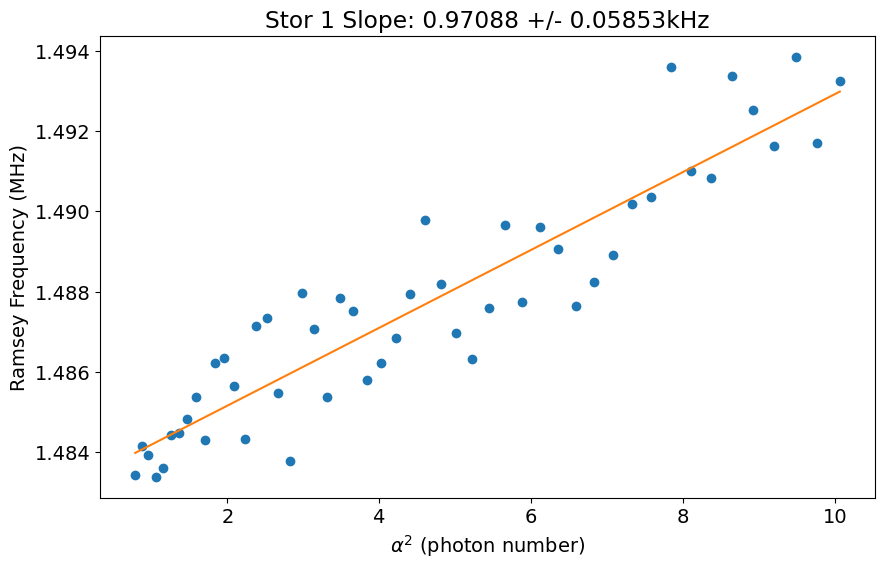

In [59]:
from scipy import stats
idx_skip = 13
idx_end = -10
plt.plot([alpha **2 for alpha in alpha_list_[idx_skip:idx_end]], np.array(freqs[idx_skip: idx_end])/(2*np.pi), 'o', label='Data')

x = [alpha **2 for alpha in alpha_list_[idx_skip:idx_end]]
y = np.array(freqs[idx_skip: idx_end])/(2*np.pi)
slope, intercept, r_value, p_value, std_err = stats.linregress(x, y)

print(f"Slope: {slope}")
plt.plot(x, [slope * x_ + intercept for x_ in x], label='Fit')
# put slope in title (round to 5 decimal places)
plt.title(f'Stor 1 Slope: {slope * 1e+3:.5f} +/- {std_err * 1e+3:.5f}kHz')
# print the title 
print(f'Stor 1 Slope: {slope * 1e+3:.5f} +/- {std_err * 1e+3:.5f}kHz')
plt.xlabel(r'$\alpha^2$ (photon number)')
plt.ylabel('Ramsey Frequency (MHz)')

[ 9.32289698e+00 -3.58884392e-03]
freq: 1.4837851380950278


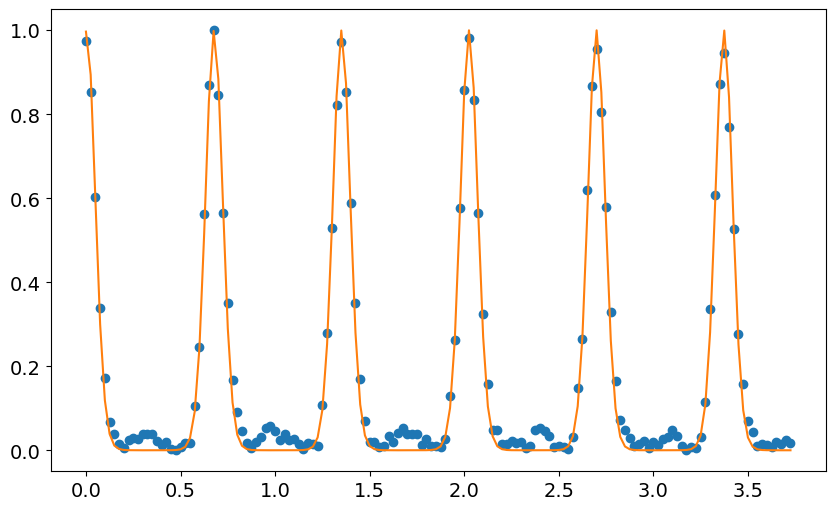

In [61]:
idx_list = np.arange(0, len(ylist), 1)
freqs = []
alpha_list_ = []
t0s = []
alpha_list = ylist

# for idx in idx_list:

# parameters for the model
idx = 30
# pr
# int(f'Alpha: {alpha_list[idx]}')
#choose the ydata 
ydata = zlist[idx]
tlist = xlist
omega = 0.5 * 2 *np.pi # MHz 
alpha = alpha_list[idx]

args = {'alpha': alpha, 'omega': omega, 't0': 0.3}


def small_angle_approx_P0(t, args): 
    return np.exp(-2* np.abs(args['alpha'])**2 * (1 - np.cos(args['omega'] * (t + args['t0']))) )



#rescale data to be between 0 and 1
min_value_model = np.exp(-2*2* np.abs(alpha)**2)
ydata_scaled = (ydata - min(ydata))/(max(ydata) - min(ydata))

# Map the scaled data to have min value of min_value_model and max value of 1
min_value_model = np.exp(-2*2* np.abs(alpha)**2)
ydata_final = ydata_scaled * (1 - min_value_model) + min_value_model




# rescale data between 1 and min value

# invert data
# ydata = 1 - ydata
# rescale data to have max value of max(ws)
# ydata = ydata * max(ws)

# Objective function to fit data to wigner function curve 
def objective(param):

    args['omega'] = param[0]
    args['t0'] = param[1]
    ws = small_angle_approx_P0(tlist, args)

    return np.sum(np.abs(ws - ydata_final))  # sum of absolute differences

# Initial guess for start and end of alpha_list
initial_guess = [1.5 * 2 * np.pi, 0]

# Bounds for start and end values of alpha_list
bounds = [(1 * 2 * np.pi, 2 * 2 * np.pi), (-0.5, 1)]

# Run the optimizer
result = minimize(objective, initial_guess, bounds=bounds, tol=1e-5, options={'disp': True}) #, method = 'BFGS')

# store all params
freqs.append(result.x[0])
t0s.append(result.x[1])
alpha_list_.append(alpha_list[idx])

plt.plot(tlist, ydata_final, 'o', label='Data')
args['omega'] = result.x[0]
args['t0'] = result.x[1]
plt.plot(tlist, small_angle_approx_P0(tlist, args), label='Model')
print(result.x)
print('freq:', result.x[0]/(2*np.pi))

#### Cross Kerr Measurements

In [475]:
diff_list, diff_err_list , ck_file_list = [], [], []

00066_cross_kerr_sweep.h5
Attempted to init fitparam 4 to -2.14604920733323, which is out of bounds 14.41190542181396 to 16.816650641447804. Instead init to 15.614278031630882
Attempted to init fitparam 4 to 15.614278031630882, which is out of bounds 16.45469164513448 to 22.521597649782407. Instead init to 19.488144647458444
Current pi pulse frequency: 4984.02431625832
Fit frequency from I [MHz]: 0.022918298142955634 +/- 2.1964698329110824e-05
Suggested new pi pulse frequency from fit I [MHz]:
 	4984.081397960177
 	4984.127234556463
T2 Ramsey from fit I [us]: 252.13014275384742
Fit frequency from Q [MHz]: 0.023120935796666058 +/- 0.00017281156511449078
Suggested new pi pulse frequencies from fit Q [MHz]:
 	4984.081195322524
 	4984.127437194117
T2 Ramsey from fit Q [us]: 166.48769225600276
00067_cross_kerr_sweep.h5
Attempted to init fitparam 4 to 19.488144647458444, which is out of bounds -12.198473861164215 to 9.204853564802546. Instead init to -1.4968101481808347
Attempted to init fit

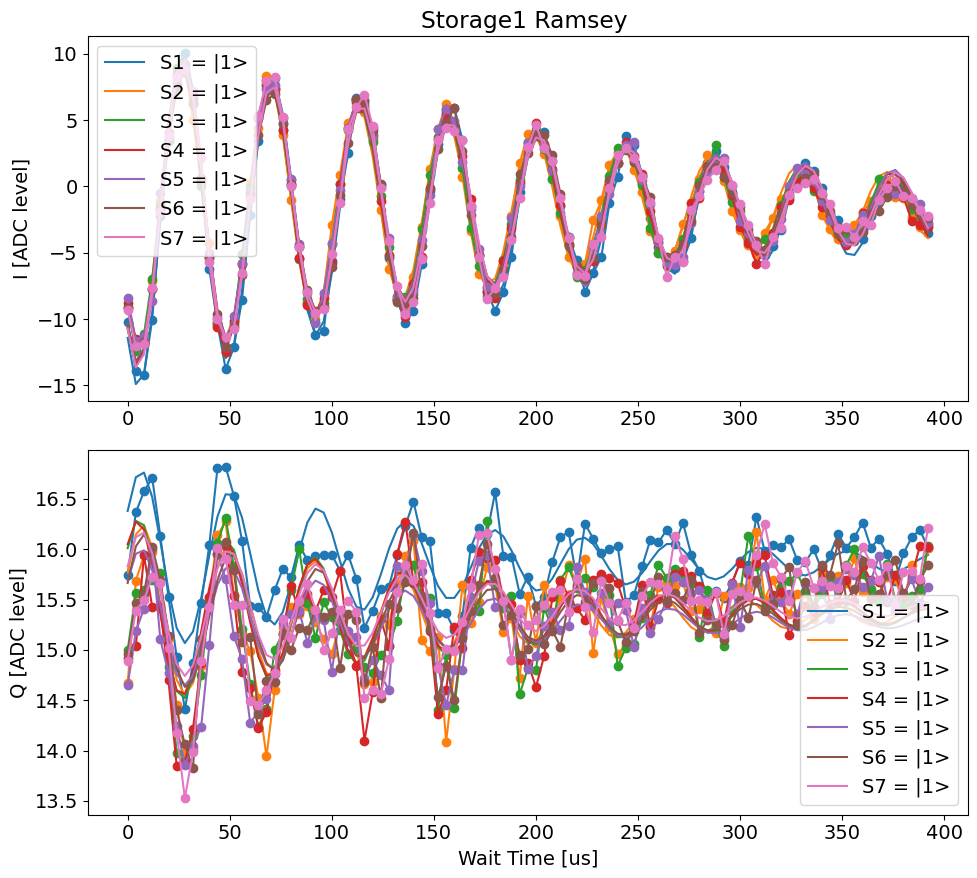

[ 0.00000000e+00  2.69516637e-04  1.26486438e-04  8.86845176e-05
  4.26936404e-05  1.94041328e-05 -1.95956248e-05]
[2.19646983e-05 2.41393547e-05 2.44440720e-05 2.51601129e-05
 2.52388042e-05 2.52973987e-05 2.72364845e-05]


In [476]:
file_list = np.arange(66,73,1)
orig_idx = 0
label_list =  [f'S1 = |1>',  f'S2 = |1>',  f'S3 = |1>', f'S4 = |1>', f'S5 = |1>', f'S6 = |1>', f'S7 = |1>']
color_list = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple', 'tab:brown', 'tab:pink']#, 'tab:green']

temp_data, attrs = prev_data(expt_path, '00040_CavityRamseyExperiment.h5') # just to get configs
diffs, diffs_err = cross_kerr_display(file_list,  label_list, color_list, orig_idx = orig_idx, active_reset = True, threshold = -4.3, readouts_per_rep = 4,
                         ramsey_freq= attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
                         fitparams = [20, None, None, None, None, None],
                           normalize= [False, 'g_data', 'e_data'], title='Storage1 Ramsey')
print(diffs)
print(diffs_err)

In [477]:
diff_list.append(diffs)
diff_err_list.append(diffs_err)
ck_file_list.append(file_list)

#### Debug

In [2004]:
diff_list, diff_err_list = [], []

00066_cross_kerr_sweep.h5
974
990
989
990
988
984
980
984
984
988
988
989
986
984
985
982
984
975
979
985
986
989
984
983
981
981
983
982
988
984
990
982
983
989
983
982
985
988
982
982
984
981
983
982
986
987
985
987
978
985
979
989
981
970
988
988
986
985
982
983
980
987
980
982
984
986
978
984
995
986
984
979
982
984
985
982
988
987
980
987
984
986
984
983
980
981
986
986
993
979
980
988
995
975
988
985
983
981
984
987
Attempted to init fitparam 4 to -2.14604920733323, which is out of bounds 14.41190542181396 to 16.816650641447804. Instead init to 15.614278031630882
Attempted to init fitparam 4 to 15.614278031630882, which is out of bounds 16.45469164513448 to 22.521597649782407. Instead init to 19.488144647458444
Current pi pulse frequency: 4984.02431625832
Fit frequency from I [MHz]: 0.022918298142955634 +/- 2.1964698329110824e-05
Suggested new pi pulse frequency from fit I [MHz]:
 	4984.081397960177
 	4984.127234556463
T2 Ramsey from fit I [us]: 252.13014275384742
Fit frequency f

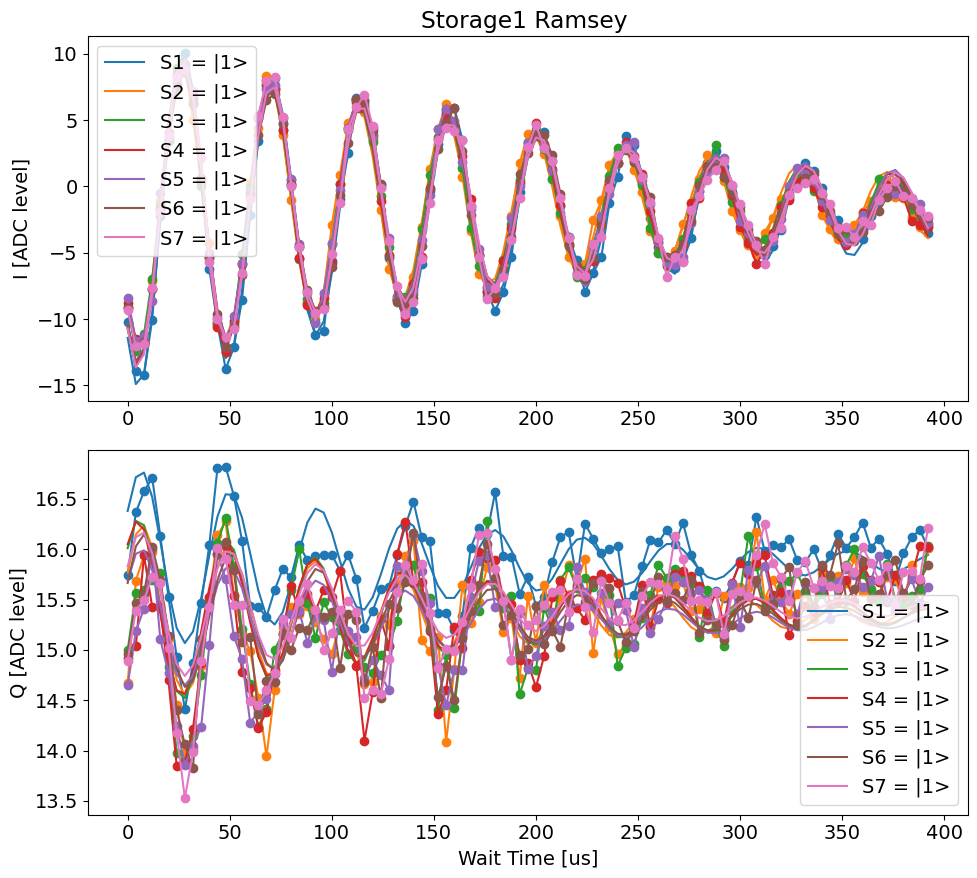

[array([ 0.00000000e+00,  2.69516637e-04,  1.26486438e-04,  8.86845176e-05,
        4.26936404e-05,  1.94041328e-05, -1.95956248e-05])]
[array([2.19646983e-05, 2.41393547e-05, 2.44440720e-05, 2.51601129e-05,
       2.52388042e-05, 2.52973987e-05, 2.72364845e-05])]


In [2005]:
# file_list = np.arange(44, 47, 1 )
# file_list = np.arange(53,56,1)
# file_list = np.arange(56,59,1)
file_list = np.arange(66,73,1)
orig_idx = 0
label_list =  [f'S1 = |1>',  f'S2 = |1>',  f'S3 = |1>', f'S4 = |1>', f'S5 = |1>', f'S6 = |1>', f'S7 = |1>']
color_list = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple', 'tab:brown', 'tab:pink']#, 'tab:green']

temp_data, attrs = prev_data(expt_path, '00040_CavityRamseyExperiment.h5') # just to get configs
diffs, diffs_err = cross_kerr_display(file_list,  label_list, color_list, orig_idx = orig_idx, active_reset = True, threshold = -4.3, readouts_per_rep = 4,
                         ramsey_freq= attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
                         fitparams = [20, None, None, None, None, None],
                           normalize= [False, 'g_data', 'e_data'], title='Storage1 Ramsey')
diff_list.append(diffs)
diff_err_list.append(diffs_err)
print(diff_list)
print(diff_err_list)

00047_cross_kerr_sweep.h5
490
494
494
497
488
494
491
497
498
492
498
497
491
490
491
489
485
493
492
492
495
495
496
497
492
492
492
495
495
496
486
481
489
488
489
493
492
491
494
495
494
496
495
488
488
491
491
493
495
491
495
495
498
491
492
491
494
488
493
490
492
494
491
496
493
494
495
492
497
491
493
492
495
491
497
492
492
496
496
490
492
489
495
493
494
487
491
490
492
494
491
496
494
494
492
493
496
491
497
495
Current pi pulse frequency: 4984.02431625832
Fit frequency from I [MHz]: 0.009877248253636796 +/- 1.1971829443770778e-05
Suggested new pi pulse frequency from fit I [MHz]:
 	4984.094439010067
 	4984.114193506573
T2 Ramsey from fit I [us]: 794.814313371242
Fit frequency from Q [MHz]: 0.0099292731089902 +/- 2.2215790908825343e-05
Suggested new pi pulse frequencies from fit Q [MHz]:
 	4984.094386985211
 	4984.114245531429
T2 Ramsey from fit Q [us]: 755.8665963309644
00048_cross_kerr_sweep.h5
492
490
492
493
492
490
496
497
494
494
493
494
495
492
492
490
493
492
498
496


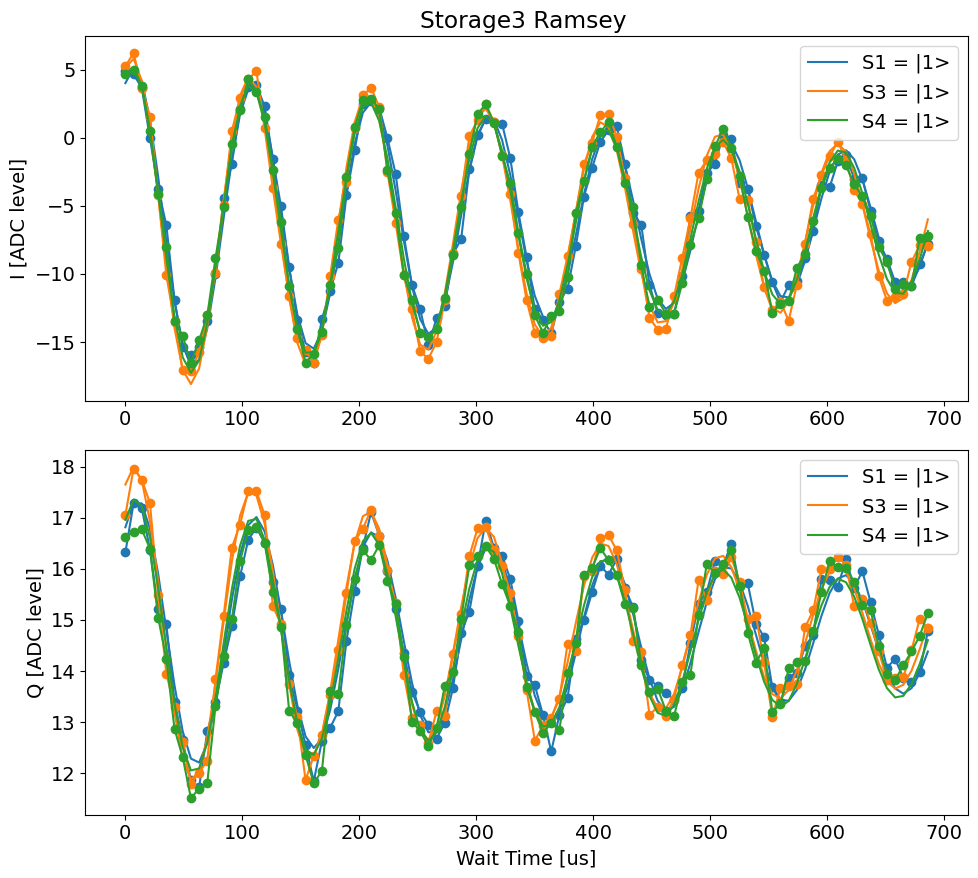

(array([-6.72829300e-05,  0.00000000e+00, -3.66298437e-05]),
 array([1.19718294e-05, 9.74104669e-06, 1.00007871e-05]))

In [1959]:
file_list = np.arange(47, 50, 1 )
orig_idx = 1
label_list = [f'S1 = |1>',   f'S3 = |1>', f'S4 = |1>']# [f'S1 = |1>',  f'S2 = |1>',  f'S3 = |1>', f'S4 = |1>', f'S5 = |1>', f'S6 = |1>', f'S7 = |1>']
color_list = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple', 'tab:brown', 'tab:pink']#, 'tab:green']

temp_data, attrs = prev_data(expt_path, '00040_CavityRamseyExperiment.h5') # just to get configs
cross_kerr_display(file_list,  label_list, color_list, orig_idx = orig_idx, active_reset = True, threshold = -4.3, readouts_per_rep = 4,
                         ramsey_freq= attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
                         fitparams = None, #[100, 0.2, 90, 25.0, 8, None],
                           normalize= [False, 'g_data', 'e_data'], title='Storage3 Ramsey')

In [1988]:
temp_data, attrs = prev_data(expt_path, '00050_cross_kerr_sweep.h5') # just to get configs
attrs['config']['expt']

{'start': 0.01,
 'step': 7,
 'expts': 101,
 'ramsey_freq': -2.21,
 'reps': 500,
 'rounds': 1,
 'qubits': [0],
 'checkEF': False,
 'f0g1_cavity': 0,
 'init_gf': False,
 'active_reset': True,
 'man_reset': True,
 'storage_reset': True,
 'user_defined_pulse': [False, None, None, None, None, 4],
 'parity_meas': False,
 'man_idx': 1,
 'storage_ramsey': [True, 4],
 'prepulse': True,
 'postpulse': True,
 'pre_sweep_pulse': [[3568.1751638611518,
   3425.5537944060666,
   2006.72,
   349.41,
   3568.1751638611518,
   3425.5537944060666,
   2006.72],
  [9653, 7575, 15000, 3000, 4930, 7575, 15000],
  [0, 0, 0.6168960348389007, 0.9937219465181768, 0, 0, 0.6168960348389007],
  [0, 0, 0, 0, 0, 0, 0],
  [2, 2, 5, 1, 2, 2, 5],
  ['gaussian',
   'gaussian',
   'flat_top',
   'flat_top',
   'gaussian',
   'gaussian',
   'flat_top'],
  [0.035, 0.035, 0.005, 0.005, 0.035, 0.035, 0.005]],
 'post_sweep_pulse': [[2006.72, 3425.5537944060666, 3568.1751638611518],
  [15000, 7575, 4930],
  [0.6168960348389007, 

00050_cross_kerr_sweep.h5
488
493
493
493
491
497
493
495
493
496
495
492
490
495
492
494
487
488
494
489
496
495
493
491
497
496
489
493
495
486
494
495
496
489
496
489
493
495
487
492
496
488
490
494
492
494
496
495
493
498
496
494
495
489
494
494
487
496
496
494
486
492
489
491
494
497
496
495
492
493
498
493
489
491
493
495
494
496
494
493
493
492
496
493
494
493
496
492
495
496
494
492
490
492
492
490
488
494
491
491
Current pi pulse frequency: 4984.02431625832
Fit frequency from I [MHz]: 0.007188052846240068 +/- 1.0312370599230244e-05
Suggested new pi pulse frequency from fit I [MHz]:
 	4984.097128205474
 	4984.111504311167
T2 Ramsey from fit I [us]: 839.708354888946
Fit frequency from Q [MHz]: 0.00709202543554446 +/- 2.4436581584752347e-05
Suggested new pi pulse frequencies from fit Q [MHz]:
 	4984.097224232884
 	4984.111408283756
T2 Ramsey from fit Q [us]: 715.1089625188159
00051_cross_kerr_sweep.h5
494
495
488
493
493
488
495
497
494
495
492
490
488
494
485
493
490
495
491
492

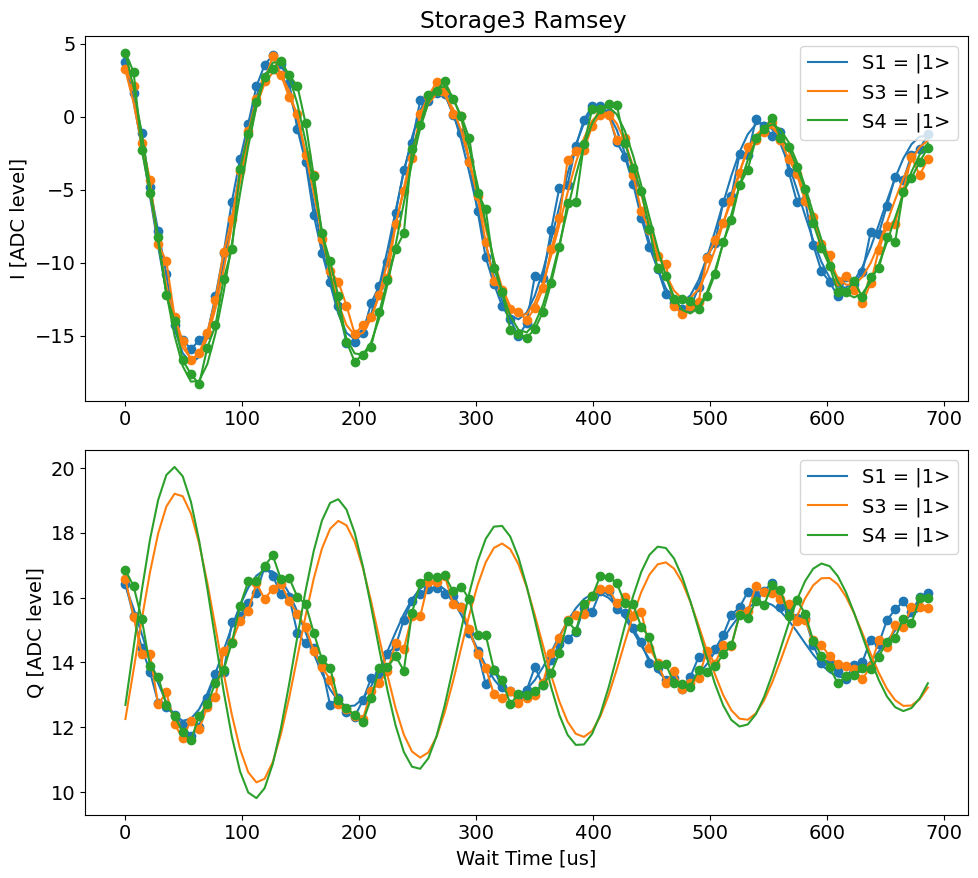

(array([9.36749604e-05, 3.06035546e-05, 0.00000000e+00]),
 array([1.03123706e-05, 1.19824083e-05, 9.73959330e-06]))

In [1961]:
file_list = np.arange(50, 53, 1 )
orig_idx = 2
label_list = [f'S1 = |1>',   f'S3 = |1>', f'S4 = |1>']# [f'S1 = |1>',  f'S2 = |1>',  f'S3 = |1>', f'S4 = |1>', f'S5 = |1>', f'S6 = |1>', f'S7 = |1>']
color_list = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple', 'tab:brown', 'tab:pink']#, 'tab:green']

temp_data, attrs = prev_data(expt_path, '00040_CavityRamseyExperiment.h5') # just to get configs
cross_kerr_display(file_list,  label_list, color_list, orig_idx = orig_idx, active_reset = True, threshold = -4.3, readouts_per_rep = 4,
                         ramsey_freq= attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
                         fitparams = None, #[100, 0.2, 90, 25.0, 8, None],
                           normalize= [False, 'g_data', 'e_data'], title='Storage3 Ramsey')

In [470]:
np.array(diff_errs_list)

NameError: name 'diff_errs_list' is not defined

TypeError: __init__() got an unexpected keyword argument 'scale'

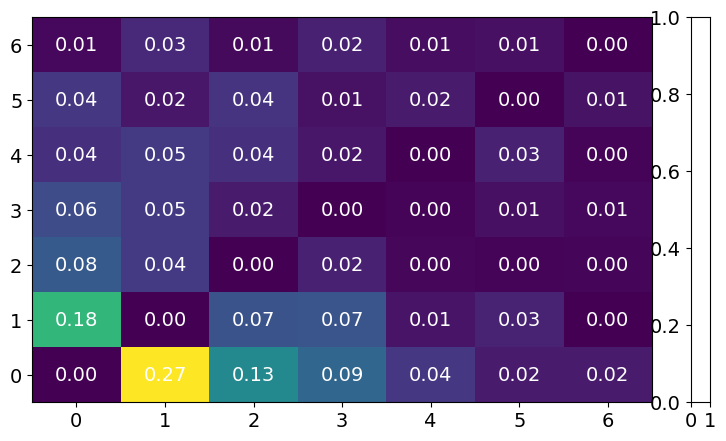

In [2086]:
cross_kerr_array = np.array(diff_list)
# np.array([[0.        ,  0.00017916, 0.00016997], 
#                              [-6.72829300e-05,  0.00000000e+00, -3.66298437e-05], 
#                              [9.36749604e-05, 3.06035546e-05, 0.00000000e+00]] )

# make a colorplot 
plt.figure(figsize=(10, 5))
plt.pcolormesh(np.arange(7), np.arange(7), np.abs(cross_kerr_array * 1e+3), shading='auto')
# print values on the plot
for i in range(7):
    for j in range(7):
        plt.text(j, i, f'{np.abs(cross_kerr_array[i, j]*1e+3):.2f}', ha='center', va='center', color='w')
plt.colorbar(label='|Cross Kerr| (kHz)', scale = 'log')
# plt.yscale('log')
plt.xlabel('Storage')
plt.ylabel('Storage')   
# change tick marks so they start with 1
plt.xticks(np.arange(7), np.arange(1, 8))
plt.yticks(np.arange(7), np.arange(1, 8))


In [1952]:
file_list

array([44, 45])

In [1928]:
diffs

array([ 0.00000000e+00,  1.90154858e-04,  1.18744152e-04,  8.40705202e-05,
        2.92805919e-05, -4.63929809e-05,  3.27236460e-05])

([<matplotlib.axis.YTick at 0x1702a111e80>,
 [Text(0, 0, '1'),
  Text(0, 1, '2'),
  Text(0, 2, '3'),
  Text(0, 3, '4'),
  Text(0, 4, '5'),
  Text(0, 5, '6'),
  Text(0, 6, '7')])

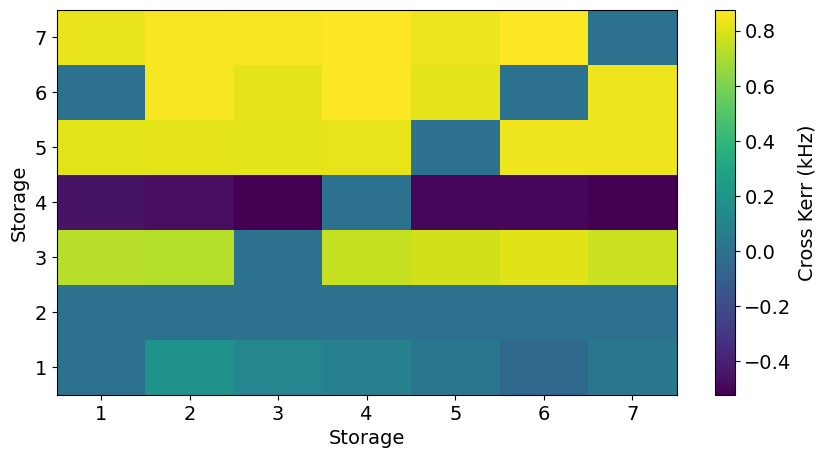

In [1944]:
cross_kerr_array = np.array([[0.00000000e+00,  1.90154858e-04,  1.18744152e-04,  8.40705202e-05,
        2.92805919e-05, -4.63929809e-05,  3.27236460e-05], 
        [0 for i in range(7)],
        [ 0.000728  , 0.00071927, 0, 0.00075332, 0.00077363,  # storage 3
        0.00080987, 0.0007651], 
        [ -0.00045236, -0.00047134, -0.00051703, 0,  -0.00049661, # storage 4
        -0.00049373, -0.00052072], 
        [ 0.00081303, 0.00081936, 0.00081497, 0.00082563, 0, # storage 5
        0.00084239, 0.00084165], 
        [ 0,  0.00085528,  0.00081824,  0.00086737, # storage 6
         0.00081934, 0,   0.0008419],
        [ 0.00083119, 0.00085998, 0.00085824, 0.00087536,
        0.00083647, 0.00087584, 0]] )

# make a colorplot 
plt.figure(figsize=(10, 5))
plt.pcolormesh(np.arange(7), np.arange(7), cross_kerr_array * 1e+3, shading='auto')
plt.colorbar(label='Cross Kerr (kHz)')
plt.xlabel('Storage')
plt.ylabel('Storage')   
# change tick marks so they start with 1
plt.xticks(np.arange(7), np.arange(1, 8))
plt.yticks(np.arange(7), np.arange(1, 8))

        



### Storage 2

488
495
495
492
494
494
495
498
495
498
497
494
497
491
491
492
493
497
487
493
493
495
493
490
484
491
493
490
497
490
488
490
493
495
494
493
494
494
499
498
492
497
490
485
490
489
490
489
493
492
489
489
489
491
497
497
493
491
498
490
495
494
493
494
493
494
495
488
491
488
492
493
490
490
488
491
491
496
497
493
493
492
486
497
491
492
496
491
497
491
488
497
491
493
491
494
494
498
491
494
Attempted to init fitparam 4 to -5.2245482284459435, which is out of bounds 14.044330920588465 to 16.705487210558204. Instead init to 15.374909065573334
Attempted to init fitparam 4 to 15.374909065573334, which is out of bounds 17.1595432694627 to 23.56324988893659. Instead init to 20.361396579199642
Current pi pulse frequency: 2006.72
Fit frequency from I [MHz]: 0.008191443478238 +/- 1.1222327082955408e-05
Suggested new pi pulse frequency from fit I [MHz]:
 	2003.4931914434783
 	2003.4768085565217
T2 Ramsey from fit I [us]: 587.4353759109418
Fit frequency from Q [MHz]: 0.00826144991822299 +/-

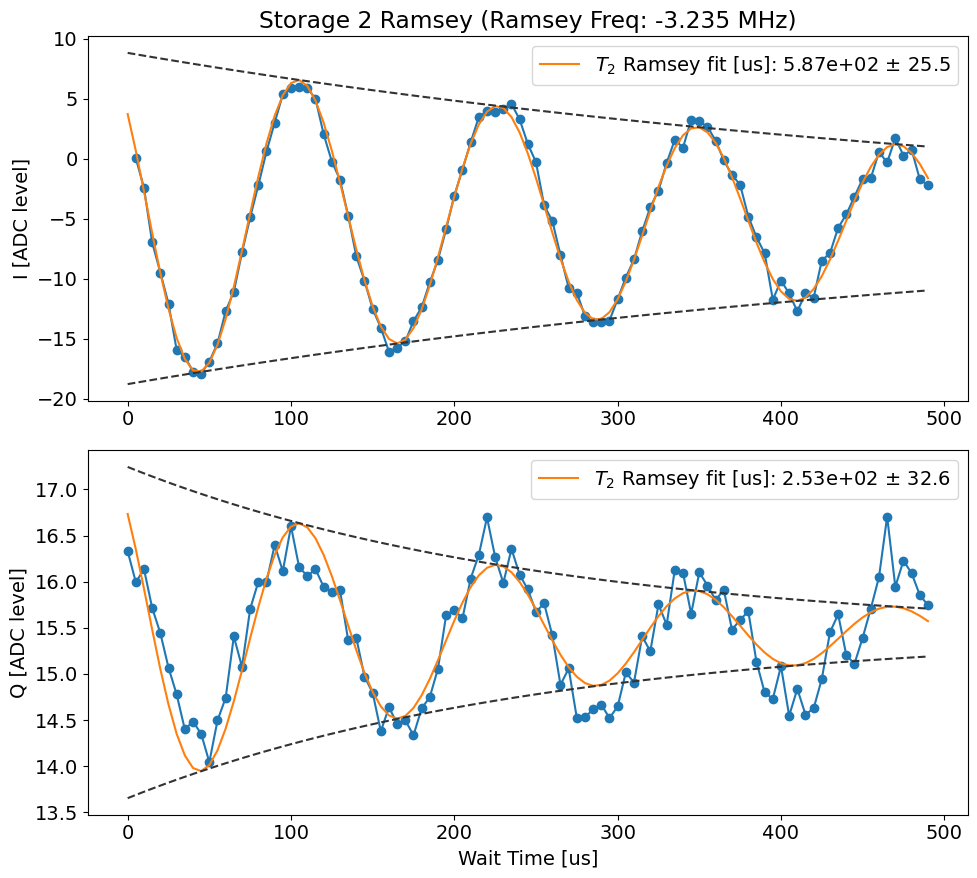

In [2061]:
temp_data, attrs = prev_data(expt_path, '00160_CavityRamseyExperiment.h5')
temp_data, attrs = prev_data(expt_path, '00229_CavityRamseyExperiment.h5')
Ramsey_display(temp_data, attrs, ramsey_freq=attrs['config']['expt']['ramsey_freq'], 
               active_reset=True, threshold=-4.323194812977462, readouts_per_rep=4, initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
               fitparams = [None, None, None, None, None, None],
                 title='Storage 2 Ramsey')

In [2062]:
diff_list.append(diffs)
diff_err_list.append(diffs_err)

#### Sweep for Kerr

Gain to alpha: 0.00042195000000000004


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


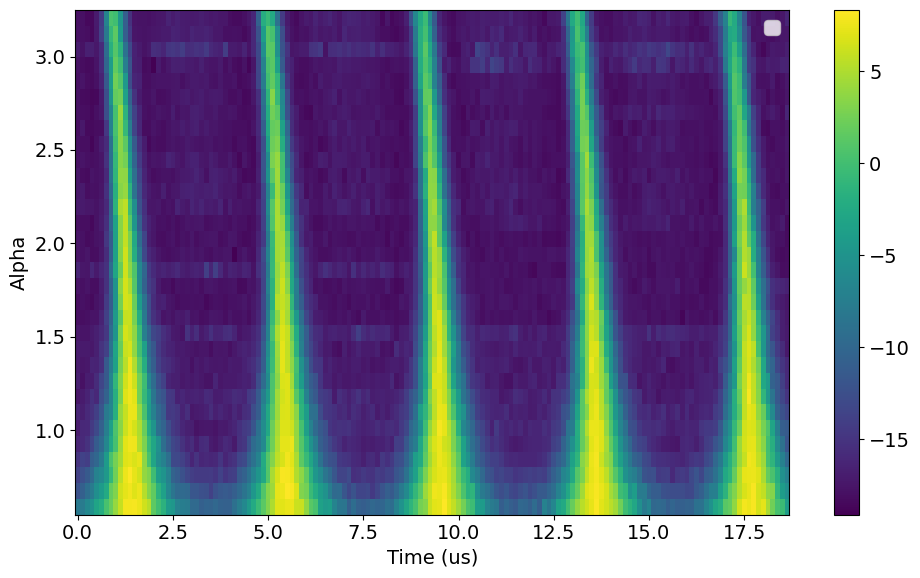

In [580]:
# file_list = np.arange(699,752,1)
file_list = np.arange(754,776,1)
# file_list = np.arange(780,782,1) np.arange(813, 825, 1)
file_list = np.arange(785,812,1)
file_list = np.concatenate((np.arange(785,812,1), np.arange(850, 852, 1)))
file_list = np.arange(854, 886, 1)
y_list = []
gain_list = []
name = '_cavity_ramsey_sweep.h5'
data_list = []
attrs_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    data_list.append(temp_data)
    attrs_list.append(attrs)
    gain_list.append(attrs['config']['expt']['user_defined_pulse'][2])

gain_to_alpha = attrs['config']['device']['manipulate']['gain_to_alpha'][0] * 3
alpha_list = np.array(gain_list)*gain_to_alpha
print('Gain to alpha:', gain_to_alpha)  

xlist, ylist, zlist = plot_ramsey_sideband(data_list, attrs_list, y_list = alpha_list, active_reset=True, threshold=-4.323194812977462, readouts_per_rep=4)

In [353]:
gain_list

[2200,
 2300,
 2400,
 2500,
 2600,
 2700,
 2000,
 2200,
 2400,
 2600,
 2800,
 3000,
 3200,
 3400,
 3600,
 3800,
 4000,
 4200,
 4400,
 4600,
 4800,
 5000,
 5200,
 5400,
 5600,
 5800,
 6000,
 6200,
 6400]

In [350]:
attrs_list[0]['config']['expt']

{'start': 0,
 'step': 0.125,
 'expts': 151,
 'ramsey_freq': 0,
 'reps': 500,
 'rounds': 1,
 'qubits': [0],
 'checkEF': False,
 'f0g1_cavity': 0,
 'init_gf': False,
 'active_reset': True,
 'man_reset': True,
 'storage_reset': True,
 'user_defined_pulse': [True, 4984.026194477733, 2200, 0.15, 0, 4],
 'parity_meas': False,
 'man_idx': 1,
 'storage_ramsey': [True, 2, False],
 'prepulse': False,
 'postpulse': True,
 'pre_sweep_pulse': [[3568.1782381859975, 3425.559887601728, 0],
  [13639, 10338, 0],
  [0, 0, 0.01],
  [0, 0, 0],
  [2, 2, 5],
  ['gaussian', 'gaussian', 'flat_top'],
  [0.025, 0.025, 0.005]],
 'post_sweep_pulse': [[3568.1782381859975],
  [50],
  [6.504911065860095],
  [0],
  [2],
  ['flat_top'],
  [0.005]]}

In [338]:
xlist

array([ 0.   ,  0.125,  0.25 ,  0.375,  0.5  ,  0.625,  0.75 ,  0.875,
        1.   ,  1.125,  1.25 ,  1.375,  1.5  ,  1.625,  1.75 ,  1.875,
        2.   ,  2.125,  2.25 ,  2.375,  2.5  ,  2.625,  2.75 ,  2.875,
        3.   ,  3.125,  3.25 ,  3.375,  3.5  ,  3.625,  3.75 ,  3.875,
        4.   ,  4.125,  4.25 ,  4.375,  4.5  ,  4.625,  4.75 ,  4.875,
        5.   ,  5.125,  5.25 ,  5.375,  5.5  ,  5.625,  5.75 ,  5.875,
        6.   ,  6.125,  6.25 ,  6.375,  6.5  ,  6.625,  6.75 ,  6.875,
        7.   ,  7.125,  7.25 ,  7.375,  7.5  ,  7.625,  7.75 ,  7.875,
        8.   ,  8.125,  8.25 ,  8.375,  8.5  ,  8.625,  8.75 ,  8.875,
        9.   ,  9.125,  9.25 ,  9.375,  9.5  ,  9.625,  9.75 ,  9.875,
       10.   , 10.125, 10.25 , 10.375, 10.5  , 10.625, 10.75 , 10.875,
       11.   , 11.125, 11.25 , 11.375, 11.5  , 11.625, 11.75 , 11.875,
       12.   , 12.125, 12.25 , 12.375, 12.5  , 12.625, 12.75 , 12.875,
       13.   , 13.125, 13.25 , 13.375, 13.5  , 13.625, 13.75 , 13.875,
      

In [342]:
data_list[1]['xpts']

array([ 0.   ,  0.125,  0.25 ,  0.375,  0.5  ,  0.625,  0.75 ,  0.875,
        1.   ,  1.125,  1.25 ,  1.375,  1.5  ,  1.625,  1.75 ,  1.875,
        2.   ,  2.125,  2.25 ,  2.375,  2.5  ,  2.625,  2.75 ,  2.875,
        3.   ,  3.125,  3.25 ,  3.375,  3.5  ,  3.625,  3.75 ,  3.875,
        4.   ,  4.125,  4.25 ,  4.375,  4.5  ,  4.625,  4.75 ,  4.875,
        5.   ,  5.125,  5.25 ,  5.375,  5.5  ,  5.625,  5.75 ,  5.875,
        6.   ,  6.125,  6.25 ,  6.375,  6.5  ,  6.625,  6.75 ,  6.875,
        7.   ,  7.125,  7.25 ,  7.375,  7.5  ,  7.625,  7.75 ,  7.875,
        8.   ,  8.125,  8.25 ,  8.375,  8.5  ,  8.625,  8.75 ,  8.875,
        9.   ,  9.125,  9.25 ,  9.375,  9.5  ,  9.625,  9.75 ,  9.875,
       10.   , 10.125, 10.25 , 10.375, 10.5  , 10.625, 10.75 , 10.875,
       11.   , 11.125, 11.25 , 11.375, 11.5  , 11.625, 11.75 , 11.875,
       12.   , 12.125, 12.25 , 12.375, 12.5  , 12.625, 12.75 , 12.875,
       13.   , 13.125, 13.25 , 13.375, 13.5  , 13.625, 13.75 , 13.875,
      

In [330]:
attrs['config']['expt']

{'start': 0,
 'step': 0.25,
 'expts': 151,
 'ramsey_freq': -0.125,
 'reps': 500,
 'rounds': 1,
 'qubits': [0],
 'checkEF': False,
 'f0g1_cavity': 0,
 'init_gf': False,
 'active_reset': True,
 'man_reset': True,
 'storage_reset': True,
 'user_defined_pulse': [True, 4984.026194477733, 6000, 0.15, 0, 4],
 'parity_meas': False,
 'man_idx': 1,
 'storage_ramsey': [True, 2, False],
 'prepulse': False,
 'postpulse': True,
 'pre_sweep_pulse': [[3568.1782381859975, 3425.559887601728, 0],
  [13639, 10338, 0],
  [0, 0, 0.01],
  [0, 0, 0],
  [2, 2, 5],
  ['gaussian', 'gaussian', 'flat_top'],
  [0.025, 0.025, 0.005]],
 'post_sweep_pulse': [[3568.1782381859975],
  [50],
  [6.504911065860095],
  [0],
  [2],
  ['flat_top'],
  [0.005]]}

In [442]:
import numpy as np
from scipy.optimize import minimize

idx_list = np.arange(0, len(ylist), 1)
freqs = []
alpha_list_ = []
t0s = []
alpha_list = ylist

for idx in idx_list:

# parameters for the model
# idx = 15
# pr
# int(f'Alpha: {alpha_list[idx]}')
#choose the ydata 
    ydata = zlist[idx]
    tlist = xlist
    omega = 0.5 * 2 *np.pi # MHz 
    alpha = alpha_list[idx]
    print(f'Alpha: {alpha_list[idx]}')

    args = {'alpha': alpha, 'omega': omega, 't0': 0.3}


    def small_angle_approx_P0(t, args): 
        return np.exp(-2* np.abs(args['alpha'])**2 * (1 - np.cos(args['omega'] * (t + args['t0']))) )




    #rescale data to be between 0 and 1
    min_value_model = np.exp(-2*2* np.abs(alpha)**2)
    ydata_scaled = (ydata - min(ydata))/(max(ydata) - min(ydata))

    # Map the scaled data to have min value of min_value_model and max value of 1
    min_value_model = np.exp(-2*2* np.abs(alpha)**2)
    ydata_final = ydata_scaled * (1 - min_value_model) + min_value_model




    # rescale data between 1 and min value

    # invert data
    # ydata = 1 - ydata
    # rescale data to have max value of max(ws)
    # ydata = ydata * max(ws)

    # Objective function to fit data to wigner function curve 
    center_freq = 0.25 * 2 * np.pi
    init_f0 = 0.3
    freq = 0
    while np.abs(freq - center_freq)/center_freq >0.1:
        
        init_f0 -= 0.01
        if init_f0 == 0.1: 
            break
        def objective(param):

            args['omega'] = param[0]
            args['t0'] = param[1]
            ws = small_angle_approx_P0(tlist, args)

            return np.sum(np.abs(ws - ydata_final))  # sum of absolute differences

        # Initial guess for start and end of alpha_list
        initial_guess = [init_f0 * 2 * np.pi, 2]

        # Bounds for start and end values of alpha_list
        bounds = [(0 * 2 * np.pi, 0.3 * 2 * np.pi), (-10, 30)]

        # Run the optimizer
        result = minimize(objective, initial_guess, bounds=bounds, tol=1e-5, options={'disp': True}) #, method = 'BFGS')

        freq = result.x[0]

        # Run the optimizer
        result = minimize(objective, initial_guess, bounds=bounds, tol=1e-5, options={'disp': True}) #, method = 'BFGS')

        freq = result.x[0]
    

    # store all params
    freqs.append(result.x[0])
    t0s.append(result.x[1])
    alpha_list_.append(alpha_list[idx])

# plt.plot(tlist, ydata, 'o', label='Data')
# plt.plot(tlist, small_angle_approx_P0(tlist, args), label='Model')
# print(result.x)

Alpha: 0.5907300000000001
Alpha: 0.67512
Alpha: 0.75951
Alpha: 0.8439000000000001
Alpha: 0.9282900000000001
Alpha: 1.01268
Alpha: 1.09707
Alpha: 1.1814600000000002
Alpha: 1.2658500000000001
Alpha: 1.35024
Alpha: 1.43463
Alpha: 1.51902
Alpha: 1.6034100000000002
Alpha: 1.6878000000000002
Alpha: 1.7721900000000002
Alpha: 1.8565800000000001
Alpha: 1.94097
Alpha: 2.02536
Alpha: 2.10975
Alpha: 2.19414
Alpha: 2.2785300000000004
Alpha: 2.3629200000000004
Alpha: 2.4473100000000003
Alpha: 2.5317000000000003
Alpha: 2.6160900000000002
Alpha: 2.70048
Alpha: 2.78487
Alpha: 2.86926
Alpha: 2.95365
Alpha: 3.03804
Alpha: 3.1224300000000005
Alpha: 3.2068200000000004


In [183]:
center_freq*0.02

0.1884955592153876

In [184]:
len(alpha_list)

12

In [185]:
3.2/(3 *0.000145)

7356.32183908046

Slope: 4.507234048186802e-05
Stor 1 Slope: 0.04507 +/- 0.01502kHz


Text(0, 0.5, 'Ramsey Frequency (MHz)')

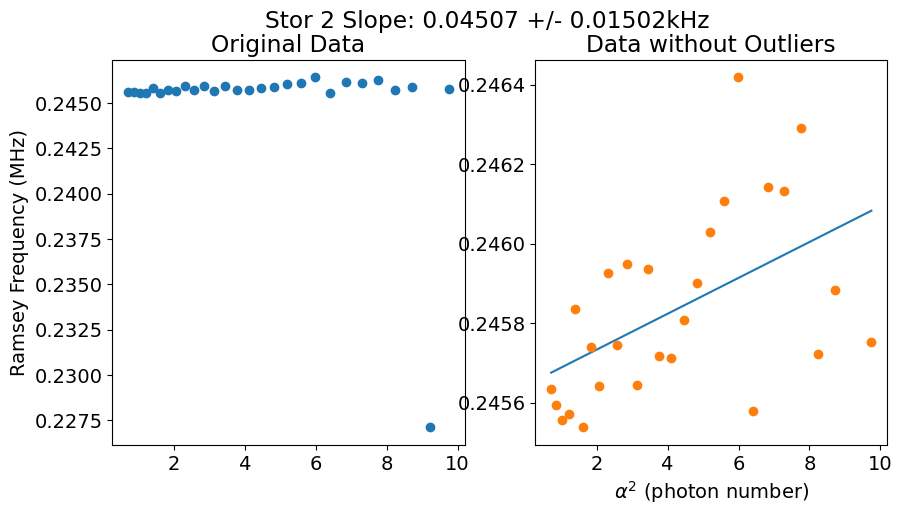

In [447]:
from scipy import stats
idx_skip = 3
idx_end = -1
# make figure with 2 subplots 
fig, ax = plt.subplots(1, 2, figsize=(10, 5))
ax[0].plot([alpha **2 for alpha in alpha_list_[idx_skip:idx_end]], np.array(freqs[idx_skip: idx_end])/(2*np.pi), 'o', label='Data')

x = [alpha **2 for alpha in alpha_list_[idx_skip:idx_end]]
y = np.array(freqs[idx_skip: idx_end])/(2*np.pi)

# skip over outliers 
center = 0.245
new_x, new_y = [], []
for idx, freq in enumerate(y):
    if np.abs(freq - center)/ center < 0.01:
        new_x.append(x[idx])
        new_y.append(y[idx])
slope, intercept, r_value, p_value, std_err = stats.linregress(new_x, new_y)

print(f"Slope: {slope}")
ax[1].plot(new_x, [slope * x_ + intercept for x_ in new_x], label='Fit')
ax[1].plot(new_x, new_y, 'o', label='Data without outliers')

# put slope in title (round to 5 decimal places)
plt.suptitle(f'Stor 2 Slope: {slope * 1e+3:.5f} +/- {std_err * 1e+3:.5f}kHz')
ax[0].set_title('Original Data')
ax[1].set_title('Data without Outliers')
# print the title 
print(f'Stor 1 Slope: {slope * 1e+3:.5f} +/- {std_err * 1e+3:.5f}kHz')
plt.xlabel(r'$\alpha^2$ (photon number)')
ax[0].set_ylabel('Ramsey Frequency (MHz)')

[ 1.54663128 14.80722449]
freq: 0.24615401347602578


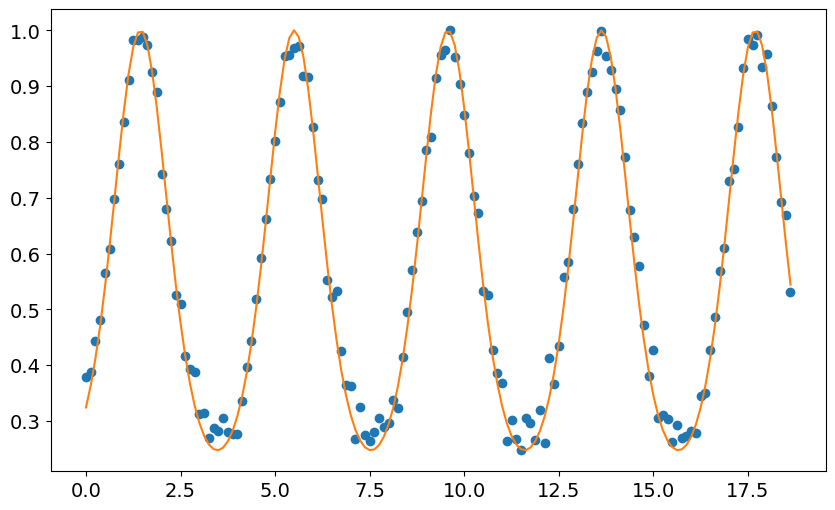

In [436]:
idx_list = np.arange(0, len(ylist), 1)
freqs = []
alpha_list_ = []
t0s = []
alpha_list = ylist

# for idx in idx_list:

# parameters for the model
idx = 0
# pr
# int(f'Alpha: {alpha_list[idx]}')
#choose the ydata 
ydata = zlist[idx]
tlist = xlist
omega = 0.5 * 2 *np.pi # MHz 
alpha = alpha_list[idx]

args = {'alpha': alpha, 'omega': omega, 't0': 0.3}


def small_angle_approx_P0(t, args): 
    return np.exp(-2* np.abs(args['alpha'])**2 * (1 - np.cos(args['omega'] * (t + args['t0']))) )



#rescale data to be between 0 and 1
min_value_model = np.exp(-2*2* np.abs(alpha)**2)
ydata_scaled = (ydata - min(ydata))/(max(ydata) - min(ydata))

# Map the scaled data to have min value of min_value_model and max value of 1
min_value_model = np.exp(-2*2* np.abs(alpha)**2)
ydata_final = ydata_scaled * (1 - min_value_model) + min_value_model




# rescale data between 1 and min value

# invert data
# ydata = 1 - ydata
# rescale data to have max value of max(ws)
# ydata = ydata * max(ws)

# Objective function to fit data to wigner function curve 
def objective(param):

    args['omega'] = param[0]
    args['t0'] = param[1]
    ws = small_angle_approx_P0(tlist, args)

    return np.sum(np.abs(ws - ydata_final))  # sum of absolute differences

# Initial guess for start and end of alpha_list

initial_guess = [0.25 * 2 * np.pi, 10]

# Bounds for start and end values of alpha_list
bounds = [(0 * 2 * np.pi, 0.3 * 2 * np.pi), (-10, 50)]

# Run the optimizer
result = minimize(objective, initial_guess, bounds=bounds, tol=1e-5, options={'disp': True}) #, method = 'BFGS')

# store all params
freqs.append(result.x[0])
t0s.append(result.x[1])
alpha_list_.append(alpha_list[idx])

plt.plot(tlist, ydata_final, 'o', label='Data')
args['omega'] = result.x[0]
args['t0'] = result.x[1]
plt.plot(tlist, small_angle_approx_P0(tlist, args), label='Model')
print(result.x)
print('freq:', result.x[0]/(2*np.pi))

In [263]:
alpha

1.01268

Alpha: 2.70048
percent diff 0.015474057394996769
[1.54648973 2.95946425]
freq: 0.24613148565125081


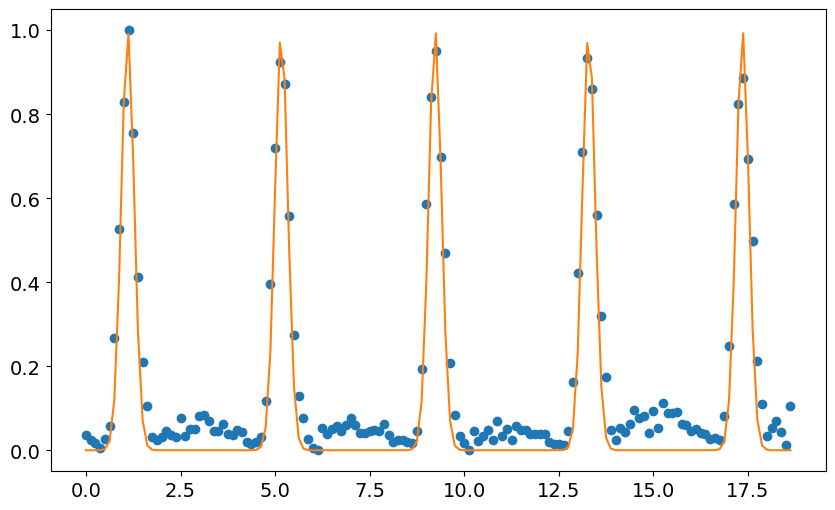

In [450]:
idx = -7
# pr
# int(f'Alpha: {alpha_list[idx]}')
#choose the ydata 
ydata = zlist[idx]
tlist = xlist
omega = 0.5 * 2 *np.pi # MHz 
alpha = alpha_list[idx]
print(f'Alpha: {alpha_list[idx]}')

args = {'alpha': alpha, 'omega': omega, 't0': 0.3}


def small_angle_approx_P0(t, args): 
    return np.exp(-2* np.abs(args['alpha'])**2 * (1 - np.cos(args['omega'] * (t + args['t0']))) )




#rescale data to be between 0 and 1
min_value_model = np.exp(-2*2* np.abs(alpha)**2)
ydata_scaled = (ydata - min(ydata))/(max(ydata) - min(ydata))

# Map the scaled data to have min value of min_value_model and max value of 1
min_value_model = np.exp(-2*2* np.abs(alpha)**2)
ydata_final = ydata_scaled * (1 - min_value_model) + min_value_model




# rescale data between 1 and min value

# invert data
# ydata = 1 - ydata
# rescale data to have max value of max(ws)
# ydata = ydata * max(ws)

# Objective function to fit data to wigner function curve 
center_freq = 0.25 * 2 * np.pi
init_f0 = 0.3
freq = 0
while np.abs(freq - center_freq)/center_freq >0.1:
    
    init_f0 -= 0.01
    if init_f0 == 0.1: 
        break
    def objective(param):

        args['omega'] = param[0]
        args['t0'] = param[1]
        ws = small_angle_approx_P0(tlist, args)

        return np.sum(np.abs(ws - ydata_final))  # sum of absolute differences

    # Initial guess for start and end of alpha_list
    initial_guess = [init_f0 * 2 * np.pi, 2]

    # Bounds for start and end values of alpha_list
    bounds = [(0 * 2 * np.pi, 0.3 * 2 * np.pi), (-10, 30)]

    # Run the optimizer
    result = minimize(objective, initial_guess, bounds=bounds, tol=1e-5, options={'disp': True}) #, method = 'BFGS')

    freq = result.x[0]
    print('percent diff', (np.abs(freq - center_freq)/center_freq))

# store all params
# freqs.append(result.x[0])
# t0s.append(result.x[1])
# alpha_list_.append(alpha_list[idx])

plt.plot(tlist, ydata_final, 'o', label='Data')
args['omega'] = result.x[0]
args['t0'] = result.x[1]
plt.plot(tlist, small_angle_approx_P0(tlist, args), label='Model')
print(result.x)
print('freq:', result.x[0]/(2*np.pi))

In [318]:
0.25*0.1

0.025

In [308]:
0.25*0.5

0.125

#### Cross Kerr Measurements

00108_cross_kerr_sweep.h5
Attempted to init fitparam 4 to -5.037922531323066, which is out of bounds 13.616649797570851 to 16.226412221825065. Instead init to 14.921531009697958
Attempted to init fitparam 4 to 14.921531009697958, which is out of bounds 16.788917119071588 to 22.62718170631555. Instead init to 19.70804941269357
Current pi pulse frequency: 4984.02431625832
Fit frequency from I [MHz]: 0.00802187319909915 +/- 1.0565425359176246e-05
Suggested new pi pulse frequency from fit I [MHz]:
 	4984.096294385121
 	4984.112338131519
T2 Ramsey from fit I [us]: 544.1742131082829
Fit frequency from Q [MHz]: 0.008009197671147996 +/- 5.2542055351572046e-05
Suggested new pi pulse frequencies from fit Q [MHz]:
 	4984.0963070606485
 	4984.112325455992
T2 Ramsey from fit Q [us]: 310.63885742402647
00109_cross_kerr_sweep.h5
Attempted to init fitparam 4 to 19.70804941269357, which is out of bounds -17.267051176416732 to 6.684314412674901. Instead init to -5.291368381870916
Attempted to init fitpa

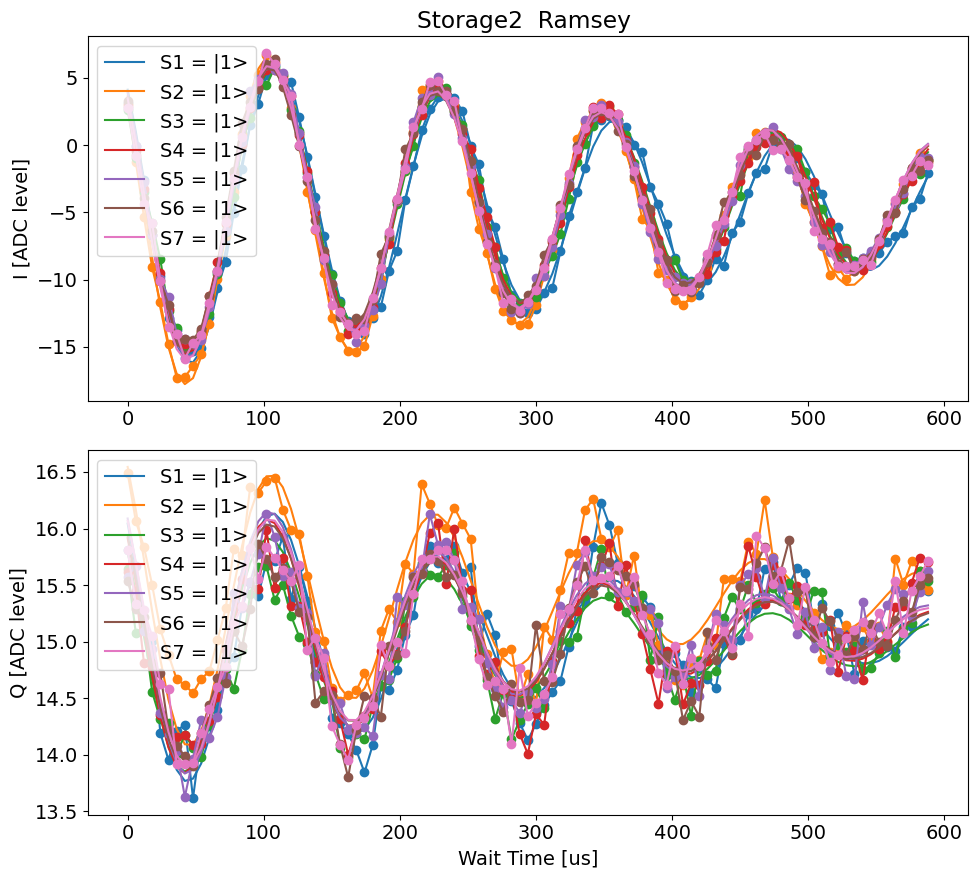

[-1.77543592e-04  0.00000000e+00 -6.92266452e-05 -7.10978126e-05
  1.37913777e-05 -2.56223707e-05  9.10903529e-07]
[1.05654254e-05 8.29864967e-06 1.01238095e-05 9.83818715e-06
 9.97873680e-06 1.03723199e-05 1.01565265e-05]


In [478]:
file_list = np.arange(108,115,1)
orig_idx = 1
label_list =  [f'S1 = |1>',  f'S2 = |1>',  f'S3 = |1>', f'S4 = |1>', f'S5 = |1>', f'S6 = |1>', f'S7 = |1>']
color_list = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple', 'tab:brown', 'tab:pink']#, 'tab:green']

temp_data, attrs = prev_data(expt_path, '00040_CavityRamseyExperiment.h5') # just to get configs
diffs, diffs_err = cross_kerr_display(file_list,  label_list, color_list, orig_idx = orig_idx, active_reset = True, threshold = -4.3, readouts_per_rep = 4,
                         ramsey_freq= attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
                         fitparams = [20, None, None, None, None, None],
                           normalize= [False, 'g_data', 'e_data'], title='Storage2  Ramsey')
# diff_list.append(diffs)
# diff_err_list.append(diffs_err)
print(diffs)
print(diffs_err)

In [479]:
diff_list.append(diffs)
diff_err_list.append(diffs_err)
ck_file_list.append(file_list)

In [2068]:
diff_list

[array([ 0.00000000e+00,  2.69516637e-04,  1.26486438e-04,  8.86845176e-05,
         4.26936404e-05,  1.94041328e-05, -1.95956248e-05]),
 array([-1.77543592e-04,  0.00000000e+00, -6.92266452e-05, -7.10978126e-05,
         1.37913777e-05, -2.56223707e-05,  9.10903529e-07])]

### STorage 3 ramsey

Current pi pulse frequency: 4984.026194477733
Fit frequency from I [MHz]: 0.26439603528514194 +/- 0.00045560331362491923
Suggested new pi pulse frequency from fit I [MHz]:
 	4984.190590513018
 	4983.661798442448
T2 Ramsey from fit I [us]: 407.23878281163786
Fit frequency from Q [MHz]: 0.2614175135286953 +/- 0.005239803268373428
Suggested new pi pulse frequencies from fit Q [MHz]:
 	4984.187611991261
 	4983.664776964204
T2 Ramsey from fit Q [us]: 19.3784550792937


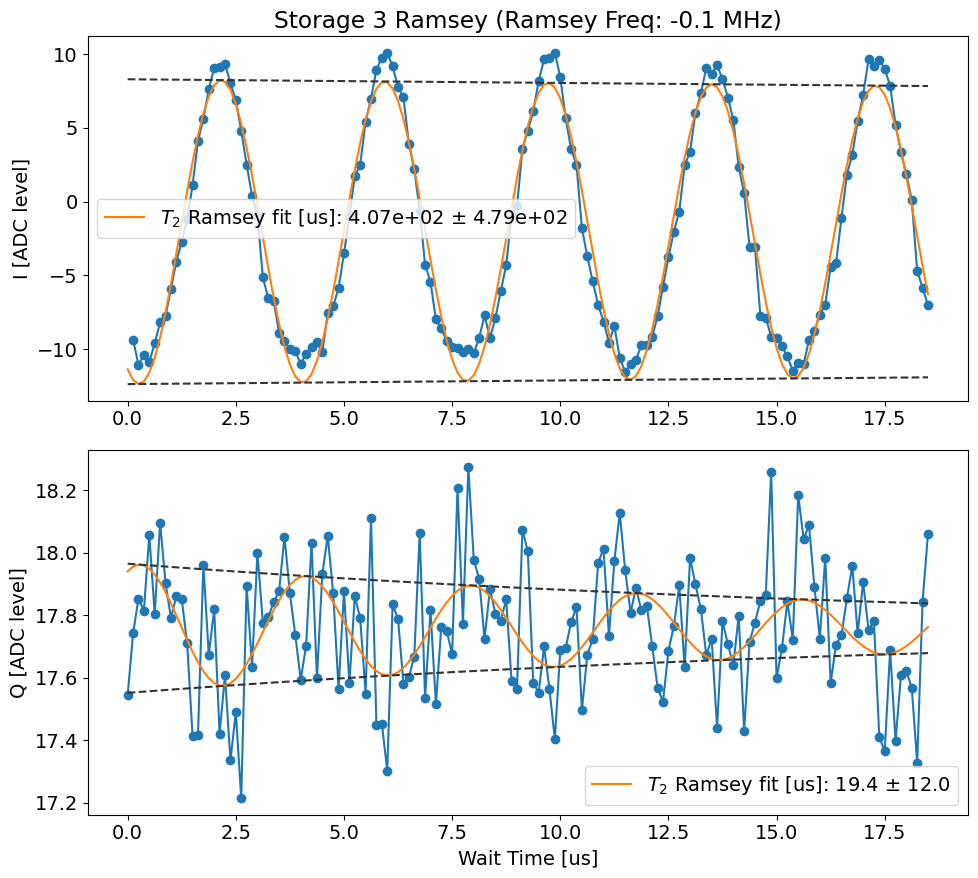

In [583]:
# temp_data, attrs = prev_data(expt_path, '00179_CavityRamseyExperiment.h5')
temp_data, attrs = prev_data(expt_path, '01001_cavity_ramsey_sweep.h5')
Ramsey_display(temp_data, attrs, ramsey_freq=attrs['config']['expt']['ramsey_freq'], 
               active_reset=True, threshold=-4.323194812977462, readouts_per_rep=4, initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, fitparams = None, title='Storage 3 Ramsey')

In [1876]:
attrs['config']['expt']

{'start': 0.01,
 'step': 10,
 'expts': 151,
 'ramsey_freq': -2.83,
 'reps': 500,
 'rounds': 1,
 'qubits': [0],
 'checkEF': False,
 'f0g1_cavity': 0,
 'init_gf': False,
 'active_reset': True,
 'man_reset': True,
 'storage_reset': True,
 'user_defined_pulse': [False, 4984.026194477733, 800, 0.15, 0, 4],
 'parity_meas': False,
 'man_idx': 1,
 'storage_ramsey': [True, 3],
 'prepulse': True,
 'postpulse': True,
 'pre_sweep_pulse': [[3568.1751638611518, 3425.5537944060666, 2006.72],
  [4930, 7575, 15000],
  [0, 0, 0.6168960348389007],
  [0, 0, 0],
  [2, 2, 5],
  ['gaussian', 'gaussian', 'flat_top'],
  [0.035, 0.035, 0.005]],
 'post_sweep_pulse': [[2006.72, 3425.5537944060666, 3568.1751638611518],
  [15000, 7575, 4930],
  [0.6168960348389007, 0, 0],
  [0, 0, 0],
  [5, 2, 2],
  ['flat_top', 'gaussian', 'gaussian'],
  [0.005, 0.035, 0.035]]}

#### Sweep for Kerr

Gain to alpha: 0.00042195000000000004


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


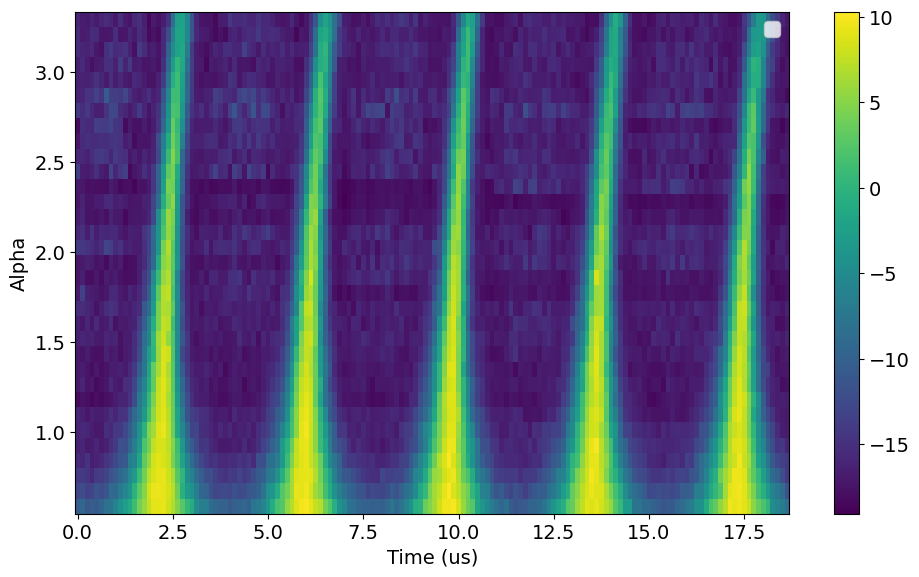

In [856]:
file_list = np.arange(894, 926, 1)
file_list = np.arange(1001, 1034, 1)
y_list = []
gain_list = []
name = '_cavity_ramsey_sweep.h5'
data_list = []
attrs_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    data_list.append(temp_data)
    attrs_list.append(attrs)
    gain_list.append(attrs['config']['expt']['user_defined_pulse'][2])

gain_to_alpha = attrs['config']['device']['manipulate']['gain_to_alpha'][0] * 3
alpha_list = np.array(gain_list)*gain_to_alpha
print('Gain to alpha:', gain_to_alpha)  

xlist, ylist, zlist = plot_ramsey_sideband(data_list, attrs_list, y_list = alpha_list, active_reset=True, threshold=-4.323194812977462, readouts_per_rep=4)

In [858]:
attrs['config']['device']

{'qubit': {'T1': [127.0],
  'f_ge': [3568.1751638611518],
  'f_ge_resolved': [3568.1751638611518],
  'f_ge_idle': [3568.1751638611518],
  'f_ef': [3425.5537944060666],
  'f_ef_idle': [3425.5537944060666],
  'ramp_sigma': [0.01],
  'ramp_sigma_num': [2],
  'pulses': {'pi_ge': {'gain': [9653], 'sigma': [0.035], 'type': ['gauss']},
   'pi_ge_fast': {'gain': [9653], 'sigma': [0.035], 'type': ['gauss']},
   'pi_ge_resolved': {'gain': [50],
    'sigma': [0.005],
    'length': [6.553697146578866],
    'type': ['flat_top'],
    'repeat_no': [1]},
   'hpi_ge': {'gain': [4930], 'sigma': [0.035], 'type': ['gauss']},
   'hpi_ge_fast': {'gain': [4930], 'sigma': [0.035], 'type': ['gauss']},
   'pi_ef_new': {'gain': [3000],
    'sigma': [0.005],
    'length': [0.146324483174444],
    'type': ['flat_top']},
   'hpi_ef_new': {'gain': [3000],
    'sigma': [0.005],
    'length': [0.07316224158722213],
    'type': ['flat_top']},
   'pi_ef': {'gain': [7575], 'sigma': [0.035], 'type': ['gauss']},
   'hpi_ef

In [ ]:
gain_list

[2200,
 2300,
 2400,
 2500,
 2600,
 2700,
 2000,
 2200,
 2400,
 2600,
 2800,
 3000,
 3200,
 3400,
 3600,
 3800,
 4000,
 4200,
 4400,
 4600,
 4800,
 5000,
 5200,
 5400,
 5600,
 5800,
 6000,
 6200,
 6400]

In [835]:
import numpy as np
from scipy.optimize import minimize

idx_list = np.arange(0, len(ylist), 1)
freqs = []
alpha_list_ = []
t0s = []
alpha_list = ylist

for idx in idx_list:

# parameters for the model
# idx = 15
# pr
# int(f'Alpha: {alpha_list[idx]}')
#choose the ydata 
    ydata = zlist[idx]
    tlist = xlist
    omega = 0.5 * 2 *np.pi # MHz 
    alpha = alpha_list[idx]
    print(f'Alpha: {alpha_list[idx]}')

    args = {'alpha': alpha, 'omega': omega, 't0': 0.3}


    def small_angle_approx_P0(t, args): 
        return np.exp(-2* np.abs(args['alpha'])**2 * (1 - np.cos(args['omega'] * (t + args['t0']))) )




    #rescale data to be between 0 and 1
    min_value_model = np.exp(-2*2* np.abs(alpha)**2)
    ydata_scaled = (ydata - min(ydata))/(max(ydata) - min(ydata))

    # Map the scaled data to have min value of min_value_model and max value of 1
    min_value_model = np.exp(-2*2* np.abs(alpha)**2)
    ydata_final = ydata_scaled * (1 - min_value_model) + min_value_model




    # rescale data between 1 and min value

    # invert data
    # ydata = 1 - ydata
    # rescale data to have max value of max(ws)
    # ydata = ydata * max(ws)

    # Objective function to fit data to wigner function curve 
    center_freq = 0.26 * 2 * np.pi
    init_f0 = 0.3
    freq = 0
    while np.abs(freq - center_freq)/center_freq >0.1:
        
        init_f0 -= 0.01
        if init_f0 == 0.1: 
            break
        def objective(param):

            args['omega'] = param[0]
            args['t0'] = param[1]
            ws = small_angle_approx_P0(tlist, args)

            return np.sum(np.abs(ws - ydata_final))  # sum of absolute differences

        # Initial guess for start and end of alpha_list
        initial_guess = [init_f0 * 2 * np.pi, 15]

        # Bounds for start and end values of alpha_list
        bounds = [(0 * 2 * np.pi, 0.3 * 2 * np.pi), (-10, 30)]

        # Run the optimizer
        result = minimize(objective, initial_guess, bounds=bounds, tol=1e-5, options={'disp': True}) #, method = 'BFGS')

        freq = result.x[0]

        # Run the optimizer
        result = minimize(objective, initial_guess, bounds=bounds, tol=1e-5, options={'disp': True}) #, method = 'BFGS')

        freq = result.x[0]
    

    # store all params
    freqs.append(result.x[0])
    t0s.append(result.x[1])
    alpha_list_.append(alpha_list[idx])

# plt.plot(tlist, ydata, 'o', label='Data')
# plt.plot(tlist, small_angle_approx_P0(tlist, args), label='Model')
# print(result.x)

Alpha: 0.5907300000000001
Alpha: 0.67512
Alpha: 0.75951
Alpha: 0.8439000000000001
Alpha: 0.9282900000000001
Alpha: 1.01268
Alpha: 1.09707
Alpha: 1.1814600000000002
Alpha: 1.2658500000000001
Alpha: 1.35024
Alpha: 1.43463
Alpha: 1.51902
Alpha: 1.6034100000000002
Alpha: 1.6878000000000002
Alpha: 1.7721900000000002
Alpha: 1.8565800000000001
Alpha: 1.94097
Alpha: 2.02536
Alpha: 2.10975
Alpha: 2.19414
Alpha: 2.2785300000000004
Alpha: 2.3629200000000004
Alpha: 2.4473100000000003
Alpha: 2.5317000000000003
Alpha: 2.6160900000000002
Alpha: 2.70048
Alpha: 2.78487
Alpha: 2.86926
Alpha: 2.95365
Alpha: 3.03804
Alpha: 3.1224300000000005
Alpha: 3.2068200000000004
Alpha: 3.2912100000000004


In [ ]:
center_freq*0.02

0.1884955592153876

In [ ]:
len(alpha_list)

12

In [ ]:
3.2/(3 *0.000145)

7356.32183908046

Slope: -8.142087588706046e-05
Stor 3 Slope: -0.08142 +/- 0.02465kHz


Text(0, 0.5, 'Ramsey Frequency (MHz)')

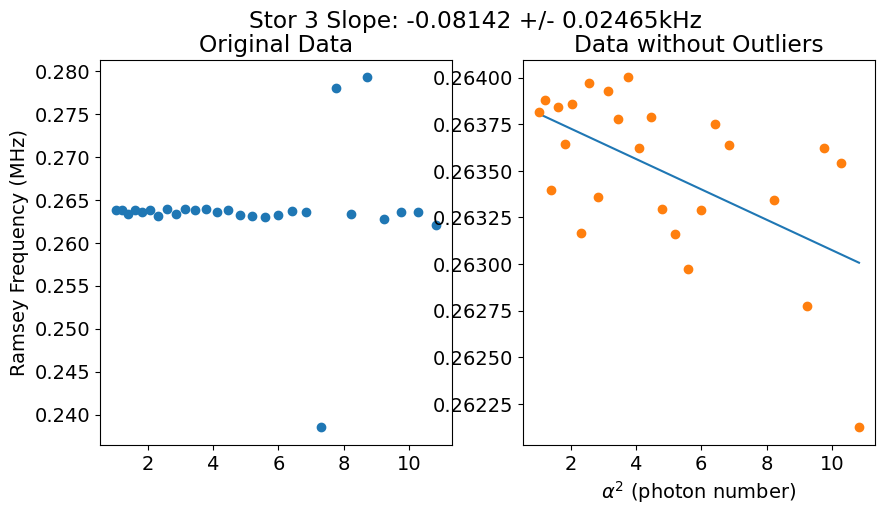

In [839]:
from scipy import stats
idx_skip = 5
idx_end = None
# make figure with 2 subplots 
fig, ax = plt.subplots(1, 2, figsize=(10, 5))
ax[0].plot([alpha **2 for alpha in alpha_list_[idx_skip:idx_end]], np.array(freqs[idx_skip: idx_end])/(2*np.pi), 'o', label='Data')

x = [alpha **2 for alpha in alpha_list_[idx_skip:idx_end]]
y = np.array(freqs[idx_skip: idx_end])/(2*np.pi)

# skip over outliers 
center = 0.26
new_x, new_y = [], []
for idx, freq in enumerate(y):
    if np.abs(freq - center)/ center < 0.04:
        new_x.append(x[idx])
        new_y.append(y[idx])
slope, intercept, r_value, p_value, std_err = stats.linregress(new_x, new_y)

print(f"Slope: {slope}")
ax[1].plot(new_x, [slope * x_ + intercept for x_ in new_x], label='Fit')
ax[1].plot(new_x, new_y, 'o', label='Data without outliers')

# put slope in title (round to 5 decimal places)
plt.suptitle(f'Stor 3 Slope: {slope * 1e+3:.5f} +/- {std_err * 1e+3:.5f}kHz')
ax[0].set_title('Original Data')
ax[1].set_title('Data without Outliers')
# print the title 
print(f'Stor 3 Slope: {slope * 1e+3:.5f} +/- {std_err * 1e+3:.5f}kHz')
plt.xlabel(r'$\alpha^2$ (photon number)')
ax[0].set_ylabel('Ramsey Frequency (MHz)')

Alpha: 2.5317000000000003
percent diff 0.004913589294391105
[ 1.65686276 12.67581995]
freq: 0.26369789883698636


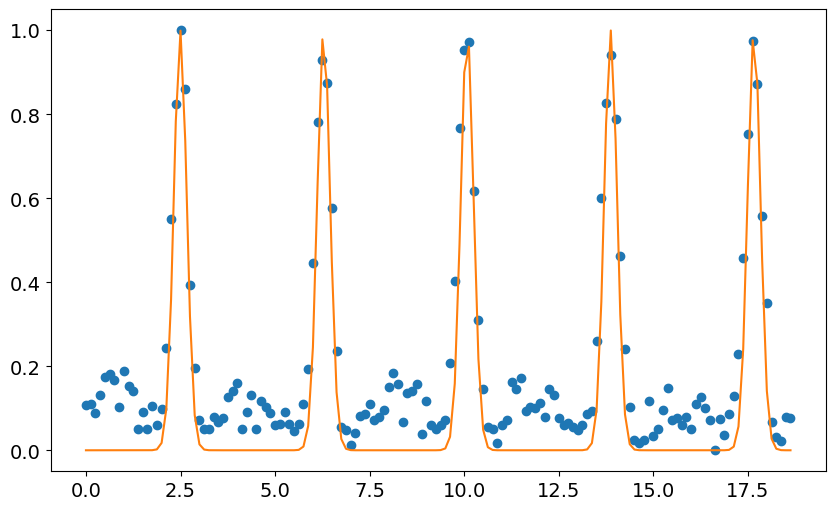

In [838]:
idx = -10
# pr
# int(f'Alpha: {alpha_list[idx]}')
#choose the ydata 
ydata = zlist[idx]
tlist = xlist
omega = 0.5 * 2 *np.pi # MHz 
alpha = alpha_list[idx]
print(f'Alpha: {alpha_list[idx]}')

args = {'alpha': alpha, 'omega': omega, 't0': 0.3}


def small_angle_approx_P0(t, args): 
    return np.exp(-2* np.abs(args['alpha'])**2 * (1 - np.cos(args['omega'] * (t + args['t0']))) )




#rescale data to be between 0 and 1
min_value_model = np.exp(-2*2* np.abs(alpha)**2)
ydata_scaled = (ydata - min(ydata))/(max(ydata) - min(ydata))

# Map the scaled data to have min value of min_value_model and max value of 1
min_value_model = np.exp(-2*2* np.abs(alpha)**2)
ydata_final = ydata_scaled * (1 - min_value_model) + min_value_model




# rescale data between 1 and min value

# invert data
# ydata = 1 - ydata
# rescale data to have max value of max(ws)
# ydata = ydata * max(ws)

# Objective function to fit data to wigner function curve 
center_freq = 0.265 * 2 * np.pi
init_f0 = 0.3
freq = 0
while np.abs(freq - center_freq)/center_freq >0.1:
    
    init_f0 -= 0.01
    if init_f0 == 0.1: 
        break
    def objective(param):

        args['omega'] = param[0]
        args['t0'] = param[1]
        ws = small_angle_approx_P0(tlist, args)

        return np.sum(np.abs(ws - ydata_final))  # sum of absolute differences

    # Initial guess for start and end of alpha_list
    initial_guess = [init_f0 * 2 * np.pi, 10]

    # Bounds for start and end values of alpha_list
    bounds = [(0 * 2 * np.pi, 0.3 * 2 * np.pi), (-10, 30)]

    # Run the optimizer
    result = minimize(objective, initial_guess, bounds=bounds, tol=1e-5, options={'disp': True}) #, method = 'BFGS')

    freq = result.x[0]
    print('percent diff', (np.abs(freq - center_freq)/center_freq))

# store all params
# freqs.append(result.x[0])
# t0s.append(result.x[1])
# alpha_list_.append(alpha_list[idx])

plt.plot(tlist, ydata_final, 'o', label='Data')
args['omega'] = result.x[0]
args['t0'] = result.x[1]
plt.plot(tlist, small_angle_approx_P0(tlist, args), label='Model')
print(result.x)
print('freq:', result.x[0]/(2*np.pi))

#### Cross Kerr

00073_cross_kerr_sweep.h5
Attempted to init fitparam 4 to -2.085974319415594, which is out of bounds 13.899589918781322 to 16.061622521348966. Instead init to 14.980606220065145
Attempted to init fitparam 4 to 14.980606220065145, which is out of bounds 16.683935822056963 to 22.1719405632832. Instead init to 19.427938192670084
Current pi pulse frequency: 4984.02431625832
Fit frequency from I [MHz]: 0.01078851216994111 +/- 8.650798348526422e-06
Suggested new pi pulse frequency from fit I [MHz]:
 	4984.09352774615
 	4984.11510477049
T2 Ramsey from fit I [us]: 768.4144503708854
Fit frequency from Q [MHz]: 0.010892067539478523 +/- 0.0003133001965856648
Suggested new pi pulse frequencies from fit Q [MHz]:
 	4984.093424190781
 	4984.115208325859
T2 Ramsey from fit Q [us]: 176.40000000000003
00074_cross_kerr_sweep.h5
Attempted to init fitparam 4 to 19.427938192670084, which is out of bounds -13.018750246713772 to 8.764937054773622. Instead init to -2.126906595970075
Attempted to init fitparam 

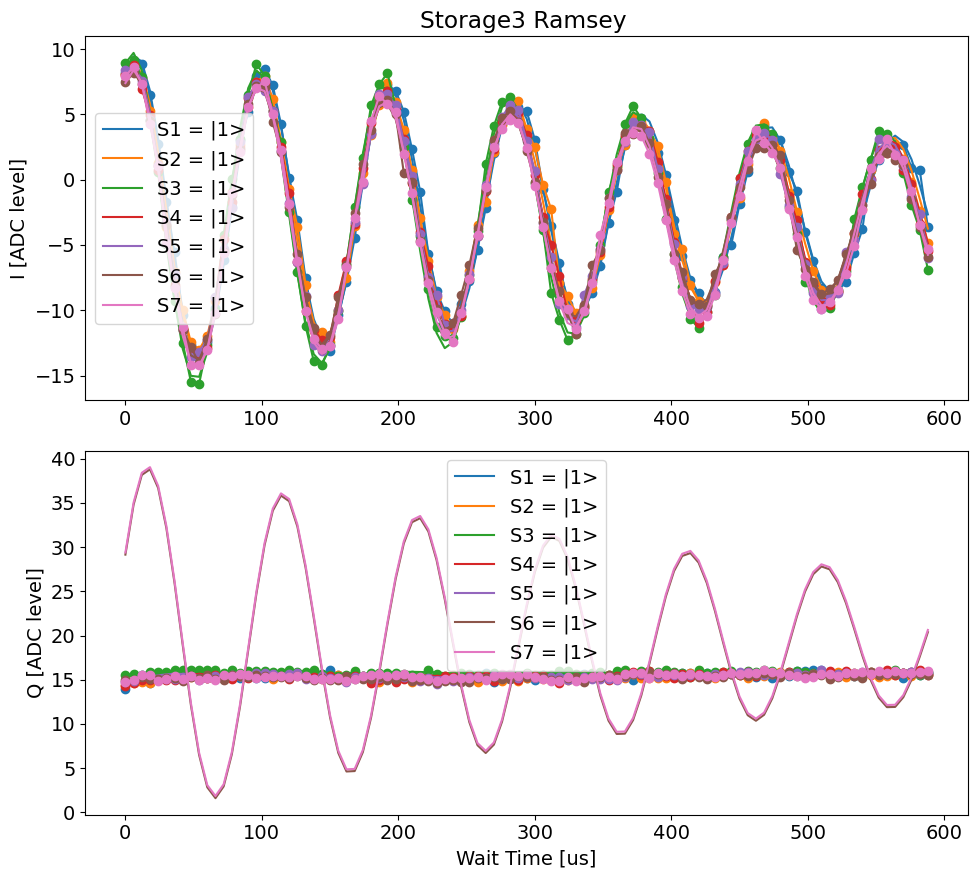

[-7.56355942e-05 -4.42189013e-05  0.00000000e+00 -2.45449305e-05
 -4.28864355e-06  2.24512793e-06 -3.33552244e-06]
[8.65079835e-06 1.01269991e-05 7.36090240e-06 7.85033768e-06
 8.32563830e-06 8.77969967e-06 7.48635345e-06]


In [481]:
file_list = np.arange(73,80,1)
orig_idx = 2
label_list =  [f'S1 = |1>',  f'S2 = |1>',  f'S3 = |1>', f'S4 = |1>', f'S5 = |1>', f'S6 = |1>', f'S7 = |1>']
color_list = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple', 'tab:brown', 'tab:pink']#, 'tab:green']

temp_data, attrs = prev_data(expt_path, '00040_CavityRamseyExperiment.h5') # just to get configs
diffs, diffs_err = cross_kerr_display(file_list,  label_list, color_list, orig_idx = orig_idx, active_reset = True, threshold = -4.3, readouts_per_rep = 4,
                         ramsey_freq= attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
                         fitparams = [20, None, None, None, None, None],
                           normalize= [False, 'g_data', 'e_data'], title='Storage3 Ramsey')
# diff_list.append(diffs)
# diff_err_list.append(diffs_err)
print(diffs)
print(diffs_err)

In [482]:
diff_list.append(diffs)
diff_err_list.append(diffs_err)
ck_file_list.append(file_list)

487
487
483
490
485
483
491
483
478
484
487
485
483
482
487
482
491
481
480
488
488
486
484
485
490
486
485
475
485
482
483
478
485
480
486
488
481
483
479
488
479
487
486
480
494
485
481
486
492
486
483
482
484
490
480
490
485
488
489
486
489
486
483
486
492
482
486
490
490
487
484
476
482
481
489
478
487
483
482
483
487
483
482
486
487
484
486
489
484
487
486
482
484
483
487
491
483
479
483
490
483
480
488
488
483
484
483
490
483
478
483
491
484
478
485
481
485
486
491
484
479
489
494
484
485
481
485
485
480
483
486
486
481
486
487
487
475
480
488
486
493
489
477
485
485
480
473
484
486
482
Attempted to init fitparam 1 to 0.03557046979865772, which is out of bounds 6.756756756756757e-05 to 0.010135135135135136. Instead init to 0.005101351351351351
Attempted to init fitparam 1 to 0.020134228187919462, which is out of bounds 6.756756756756757e-05 to 0.010135135135135136. Instead init to 0.005101351351351351
Current pi pulse frequency: 4984.02431625832
Fit frequency from I [MHz]: 0.0101

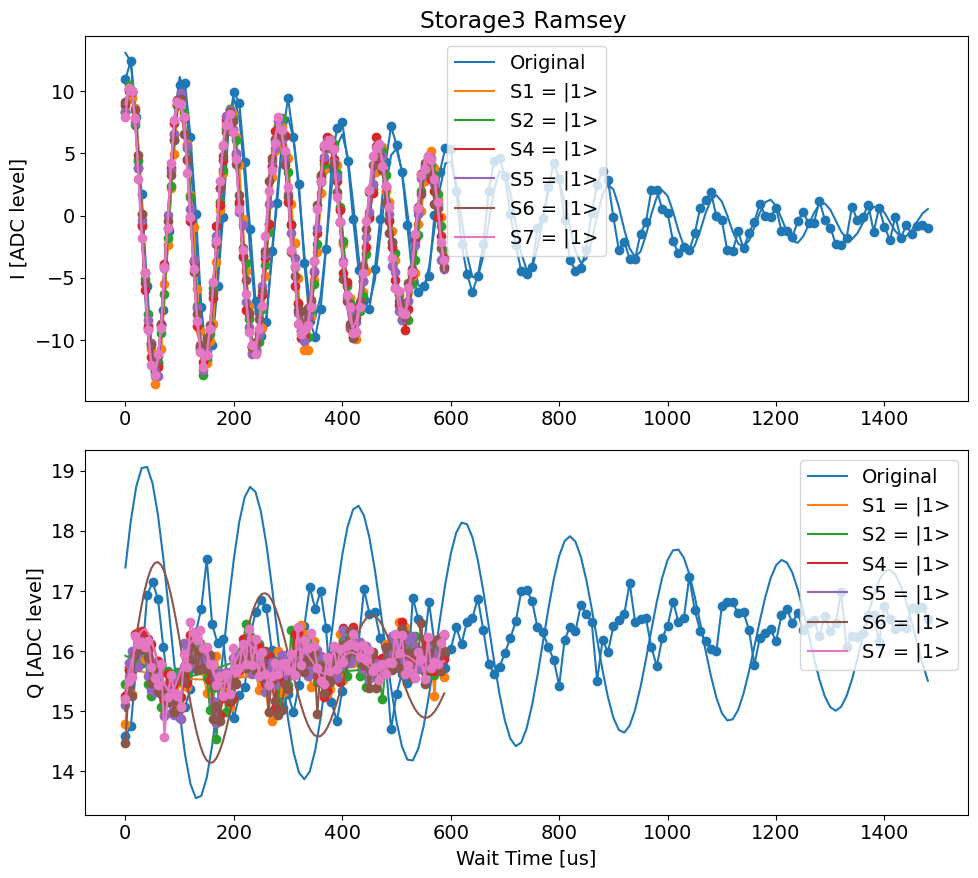

(array([0.        , 0.000728  , 0.00071927, 0.00075332, 0.00077363,
        0.00080987, 0.0007651 ]),
 array([1.54215902e-05, 1.10478132e-05, 9.77075648e-06, 1.11124929e-05,
        9.98819062e-06, 1.04289846e-05, 8.71833832e-06]))

In [1930]:
file_list = np.array(['00179_CavityRamseyExperiment.h5', '00009_cross_kerr_sweep.h5', '00010_cross_kerr_sweep.h5', '00012_cross_kerr_sweep.h5', 
                      '00013_cross_kerr_sweep.h5', '00014_cross_kerr_sweep.h5', '00015_cross_kerr_sweep.h5'])
label_list = [f'Original',  f'S1 = |1>',  f'S2 = |1>', f'S4 = |1>', f'S5 = |1>', f'S6 = |1>', f'S7 = |1>']
color_list = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple', 'tab:brown', 'tab:pink']#, 'tab:green']

temp_data, attrs = prev_data(expt_path, '00040_CavityRamseyExperiment.h5') # just to get configs
multiple_Ramsey_display(file_list, label_list, color_list, active_reset = True, threshold = -4.3, readouts_per_rep = 4,
                         ramsey_freq= attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
                         fitparams = None, #[100, 0.2, 90, 25.0, 8, None],
                           normalize= [False, 'g_data', 'e_data'], title='Storage3 Ramsey')

### Storage 4

Attempted to init fitparam 4 to -1.5523248746092202, which is out of bounds 17.06580307447654 to 18.364092734574662. Instead init to 17.7149479045256
Attempted to init fitparam 4 to 17.7149479045256, which is out of bounds 19.87012636712154 to 24.87341679020807. Instead init to 22.371771578664806
Current pi pulse frequency: 4984.026194477733
Fit frequency from I [MHz]: 0.2680651647113117 +/- 0.000997869102046303
Suggested new pi pulse frequency from fit I [MHz]:
 	4984.2581293130215
 	4984.794259642445
T2 Ramsey from fit I [us]: 16.06062299450515
Fit frequency from Q [MHz]: 0.26277680455504093 +/- 0.0038564631751419787
Suggested new pi pulse frequencies from fit Q [MHz]:
 	4984.263417673178
 	4984.788971282288
T2 Ramsey from fit Q [us]: 5.512500000000001


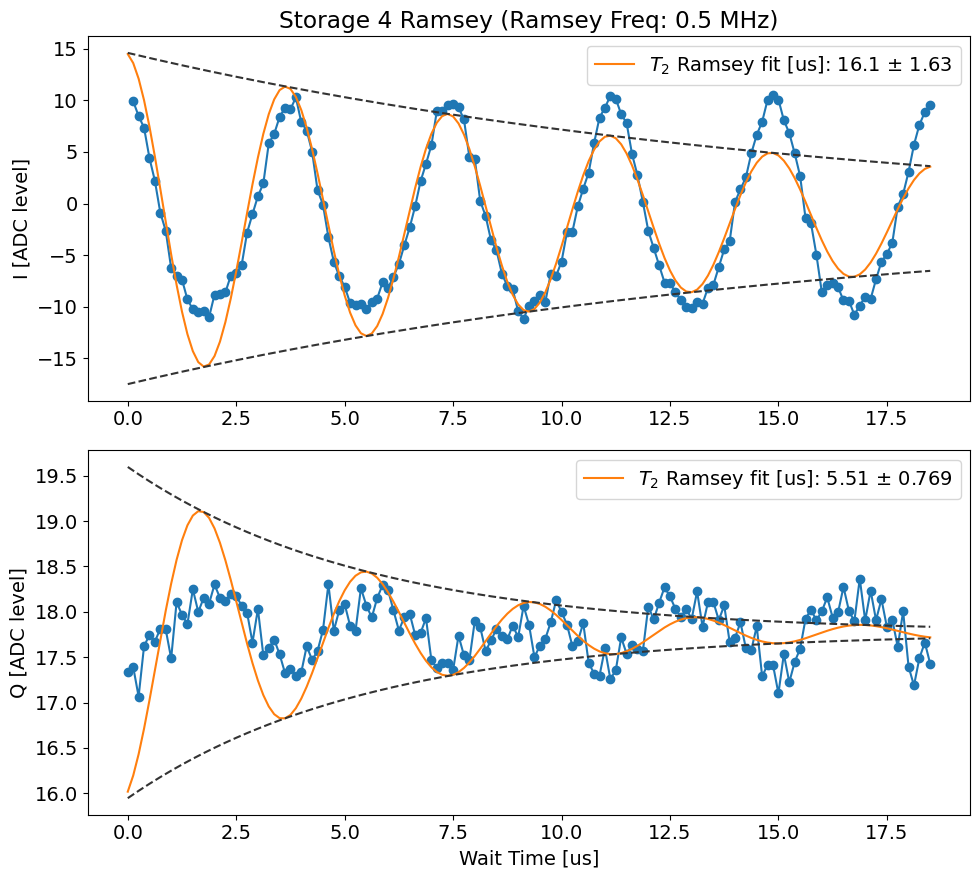

In [551]:
# temp_data, attrs = prev_data(expt_path, '00187_CavityRamseyExperiment.h5')
temp_data, attrs = prev_data(expt_path, '00968_cavity_ramsey_sweep.h5')
Ramsey_display(temp_data, attrs, ramsey_freq=attrs['config']['expt']['ramsey_freq'], 
               active_reset=True, threshold=-4.323194812977462, readouts_per_rep=4, initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
               fitparams = [100, None, None, None, None, None],
                 title='Storage 4 Ramsey')

#### Sweep for Kerr

Gain to alpha: 0.00042195000000000004


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


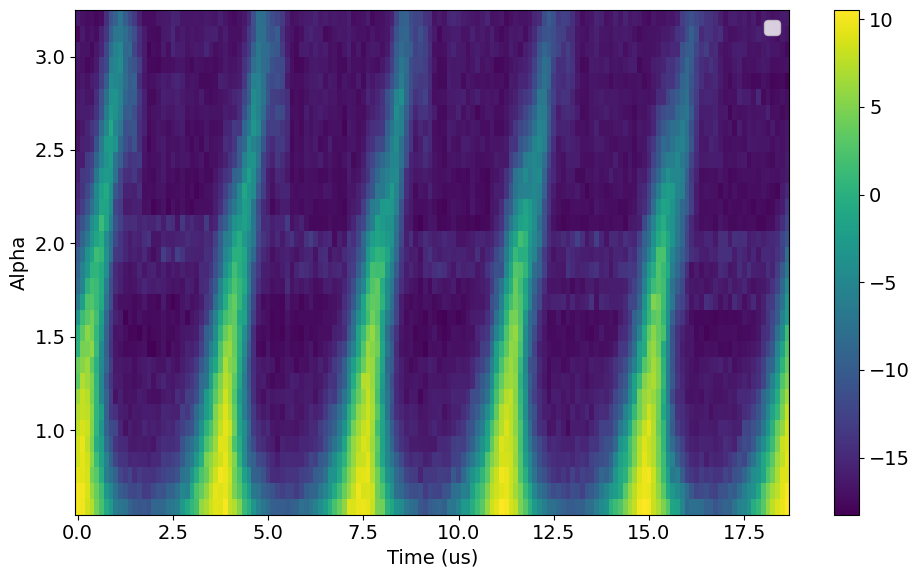

In [830]:
# file_list = np.arange(935, 968, 1)
file_list = np.arange(968, 1000, 1)
y_list = []
gain_list = []
name = '_cavity_ramsey_sweep.h5'
data_list = []
attrs_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    data_list.append(temp_data)
    attrs_list.append(attrs)
    gain_list.append(attrs['config']['expt']['user_defined_pulse'][2])

gain_to_alpha = attrs['config']['device']['manipulate']['gain_to_alpha'][0] * 3
alpha_list = np.array(gain_list)*gain_to_alpha
print('Gain to alpha:', gain_to_alpha)  

xlist, ylist, zlist = plot_ramsey_sideband(data_list, attrs_list, y_list = alpha_list, active_reset=True, threshold=-4.323194812977462, readouts_per_rep=4)

In [831]:
attrs_list[0]['config']['expt']

{'start': 0,
 'step': 0.125,
 'expts': 151,
 'ramsey_freq': 0.5,
 'reps': 500,
 'rounds': 1,
 'qubits': [0],
 'checkEF': False,
 'f0g1_cavity': 0,
 'init_gf': False,
 'active_reset': True,
 'man_reset': True,
 'storage_reset': True,
 'user_defined_pulse': [True, 4984.026194477733, 1400, 0.15, 0, 4],
 'parity_meas': False,
 'man_idx': 1,
 'storage_ramsey': [True, 4, False],
 'prepulse': False,
 'postpulse': True,
 'pre_sweep_pulse': [[3568.1782381859975, 3425.559887601728, 0],
  [13639, 10338, 0],
  [0, 0, 0.01],
  [0, 0, 0],
  [2, 2, 5],
  ['gaussian', 'gaussian', 'flat_top'],
  [0.025, 0.025, 0.005]],
 'post_sweep_pulse': [[3568.1782381859975],
  [50],
  [6.504911065860095],
  [0],
  [2],
  ['flat_top'],
  [0.005]]}

In [814]:
import numpy as np
from scipy.optimize import minimize

idx_list = np.arange(0, len(ylist), 1)
freqs = []
alpha_list_ = []
t0s = []
alpha_list = ylist

for idx in idx_list:

# parameters for the model
# idx = 15
# pr
# int(f'Alpha: {alpha_list[idx]}')
#choose the ydata 
    ydata = zlist[idx]
    tlist = xlist
    omega = 0.5 * 2 *np.pi # MHz 
    alpha = alpha_list[idx]
    print(f'Alpha: {alpha_list[idx]}')

    args = {'alpha': alpha, 'omega': omega, 't0': 0.3}


    def small_angle_approx_P0(t, args): 
        return np.exp(-2* np.abs(args['alpha'])**2 * (1 - np.cos(args['omega'] * (t + args['t0']))) )




    #rescale data to be between 0 and 1
    min_value_model = np.exp(-2*2* np.abs(alpha)**2)
    ydata_scaled = (ydata - min(ydata))/(max(ydata) - min(ydata))

    # Map the scaled data to have min value of min_value_model and max value of 1
    min_value_model = np.exp(-2*2* np.abs(alpha)**2)
    ydata_final = ydata_scaled * (1 - min_value_model) + min_value_model




    # rescale data between 1 and min value

    # invert data
    # ydata = 1 - ydata
    # rescale data to have max value of max(ws)
    # ydata = ydata * max(ws)

    # Objective function to fit data to wigner function curve 
    center_freq = 0.27 * 2 * np.pi
    init_f0 = 0.3
    freq = 0
    while np.abs(freq - center_freq)/center_freq >0.1:
        
        init_f0 -= 0.01
        if init_f0 == 0.1: 
            break
        def objective(param):

            args['omega'] = param[0]
            args['t0'] = param[1]
            ws = small_angle_approx_P0(tlist, args)

            return np.sum(np.abs(ws - ydata_final))  # sum of absolute differences

        # Initial guess for start and end of alpha_list
        initial_guess = [init_f0 * 2 * np.pi, 7]

        # Bounds for start and end values of alpha_list
        bounds = [(0 * 2 * np.pi, 0.3 * 2 * np.pi), (-10, 30)]

        # Run the optimizer
        result = minimize(objective, initial_guess, bounds=bounds, tol=1e-5, options={'disp': True}) #, method = 'BFGS')

        freq = result.x[0]

        # Run the optimizer
        result = minimize(objective, initial_guess, bounds=bounds, tol=1e-5, options={'disp': True}) #, method = 'BFGS')

        freq = result.x[0]
    

    # store all params
    freqs.append(result.x[0])
    t0s.append(result.x[1])
    alpha_list_.append(alpha_list[idx])

# plt.plot(tlist, ydata, 'o', label='Data')
# plt.plot(tlist, small_angle_approx_P0(tlist, args), label='Model')
# print(result.x)

Alpha: 0.5907300000000001
Alpha: 0.67512
Alpha: 0.75951
Alpha: 0.8439000000000001
Alpha: 0.9282900000000001
Alpha: 1.01268
Alpha: 1.09707
Alpha: 1.1814600000000002
Alpha: 1.2658500000000001
Alpha: 1.35024
Alpha: 1.43463
Alpha: 1.51902
Alpha: 1.6034100000000002
Alpha: 1.6878000000000002
Alpha: 1.7721900000000002
Alpha: 1.8565800000000001
Alpha: 1.94097
Alpha: 2.02536
Alpha: 2.10975
Alpha: 2.19414
Alpha: 2.2785300000000004
Alpha: 2.3629200000000004
Alpha: 2.4473100000000003
Alpha: 2.5317000000000003
Alpha: 2.6160900000000002
Alpha: 2.70048
Alpha: 2.78487
Alpha: 2.86926
Alpha: 2.95365
Alpha: 3.03804
Alpha: 3.1224300000000005
Alpha: 3.2068200000000004


In [546]:
center_freq*0.02

0.03392920065876977

In [547]:
len(alpha_list)

33

In [548]:
3.2/(3 *0.000145)

7356.32183908046

Slope: 0.0006788661594994504
Stor 3 Slope: 0.67887 +/- 0.07469kHz


Text(0, 0.5, 'Ramsey Frequency (MHz)')

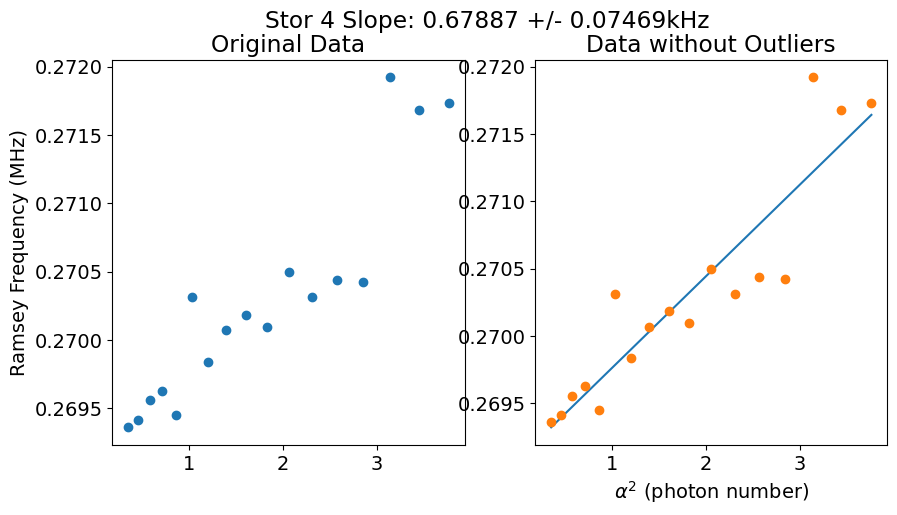

In [820]:
from scipy import stats
idx_skip = 0
idx_end = -15 #None
# make figure with 2 subplots 
fig, ax = plt.subplots(1, 2, figsize=(10, 5))
ax[0].plot([alpha **2 for alpha in alpha_list_[idx_skip:idx_end]], np.array(freqs[idx_skip: idx_end])/(2*np.pi), 'o', label='Data')

x = [alpha **2 for alpha in alpha_list_[idx_skip:idx_end]]
y = np.array(freqs[idx_skip: idx_end])/(2*np.pi)

# skip over outliers 
center = 0.27
new_x, new_y = [], []
for idx, freq in enumerate(y):
    if np.abs(freq - center)/ center < 0.04:
        new_x.append(x[idx])
        new_y.append(y[idx])
slope, intercept, r_value, p_value, std_err = stats.linregress(new_x, new_y)

print(f"Slope: {slope}")
ax[1].plot(new_x, [slope * x_ + intercept for x_ in new_x], label='Fit')
ax[1].plot(new_x, new_y, 'o', label='Data without outliers')

# put slope in title (round to 5 decimal places)
plt.suptitle(f'Stor 4 Slope: {slope * 1e+3:.5f} +/- {std_err * 1e+3:.5f}kHz')
ax[0].set_title('Original Data')
ax[1].set_title('Data without Outliers')
# print the title 
print(f'Stor 3 Slope: {slope * 1e+3:.5f} +/- {std_err * 1e+3:.5f}kHz')
plt.xlabel(r'$\alpha^2$ (photon number)')
ax[0].set_ylabel('Ramsey Frequency (MHz)')

Alpha: 1.6878000000000002
percent diff 0.5040174206743188
percent diff 0.0015585553228585375
[1.69910406 7.02333756]
freq: 0.2704208099371718


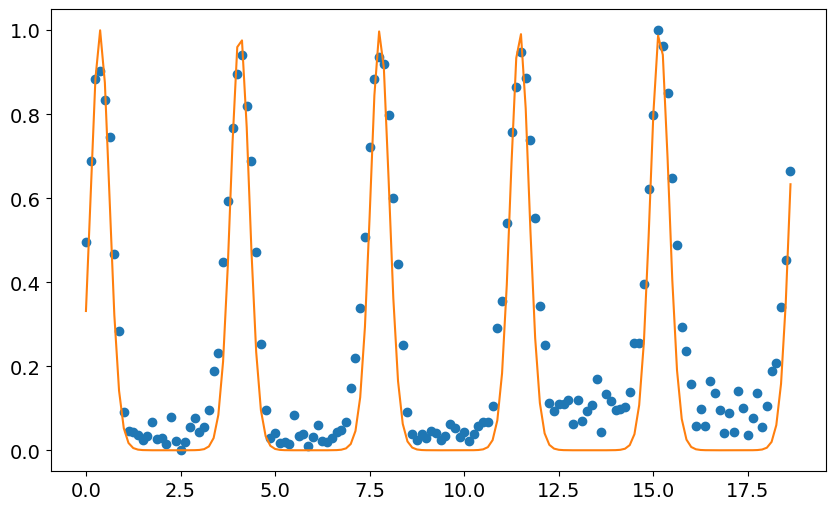

In [823]:
idx = -19
# pr
# int(f'Alpha: {alpha_list[idx]}')
#choose the ydata 
ydata = zlist[idx]
tlist = xlist
omega = 0.5 * 2 *np.pi # MHz 
alpha = alpha_list[idx]
print(f'Alpha: {alpha_list[idx]}')

args = {'alpha': alpha, 'omega': omega, 't0': 0.3}


def small_angle_approx_P0(t, args): 
    return np.exp(-2* np.abs(args['alpha'])**2 * (1 - np.cos(args['omega'] * (t + args['t0']))) )




#rescale data to be between 0 and 1
min_value_model = np.exp(-2*2* np.abs(alpha)**2)
ydata_scaled = (ydata - min(ydata))/(max(ydata) - min(ydata))

# Map the scaled data to have min value of min_value_model and max value of 1
min_value_model = np.exp(-2*2* np.abs(alpha)**2)
ydata_final = ydata_scaled * (1 - min_value_model) + min_value_model




# rescale data between 1 and min value

# invert data
# ydata = 1 - ydata
# rescale data to have max value of max(ws)
# ydata = ydata * max(ws)

# Objective function to fit data to wigner function curve 
center_freq = 0.27 * 2 * np.pi
init_f0 = 0.3
freq = 0
while np.abs(freq - center_freq)/center_freq >0.1:
    
    init_f0 -= 0.01
    if init_f0 == 0.1: 
        break
    def objective(param):

        args['omega'] = param[0]
        args['t0'] = param[1]
        ws = small_angle_approx_P0(tlist, args)

        return np.sum(np.abs(ws - ydata_final))  # sum of absolute differences

    # Initial guess for start and end of alpha_list
    initial_guess = [init_f0 * 2 * np.pi, 7]

    # Bounds for start and end values of alpha_list
    bounds = [(0 * 2 * np.pi, 0.3 * 2 * np.pi), (-10, 30)]

    # Run the optimizer
    result = minimize(objective, initial_guess, bounds=bounds, tol=1e-5, options={'disp': True}) #, method = 'BFGS')

    freq = result.x[0]
    print('percent diff', (np.abs(freq - center_freq)/center_freq))

# store all params
# freqs.append(result.x[0])
# t0s.append(result.x[1])
# alpha_list_.append(alpha_list[idx])

plt.plot(tlist, ydata_final, 'o', label='Data')
args['omega'] = result.x[0]
args['t0'] = result.x[1]
plt.plot(tlist, small_angle_approx_P0(tlist, args), label='Model')
print(result.x)
print('freq:', result.x[0]/(2*np.pi))

#### Cross Kerr

00080_cross_kerr_sweep.h5
Attempted to init fitparam 4 to -3.631209835382039, which is out of bounds 13.857942973523421 to 16.021000276319423. Instead init to 14.939471624921422
Attempted to init fitparam 4 to 14.939471624921422, which is out of bounds 16.814634799937295 to 22.538279509042052. Instead init to 19.676457154489675
Current pi pulse frequency: 4984.02431625832
Fit frequency from I [MHz]: 0.0064202913439895285 +/- 8.934235458467895e-06
Suggested new pi pulse frequency from fit I [MHz]:
 	4984.0978959669765
 	4984.110736549665
T2 Ramsey from fit I [us]: 800.7499323215334
Fit frequency from Q [MHz]: 0.01431621735557247 +/- 0.00030992081443294517
Suggested new pi pulse frequencies from fit Q [MHz]:
 	4984.090000040965
 	4984.118632475675
T2 Ramsey from fit Q [us]: 176.40000000000003
00081_cross_kerr_sweep.h5
Attempted to init fitparam 4 to 19.676457154489675, which is out of bounds -13.251795727023229 to 6.785383937747762. Instead init to -3.2332058946377336
Attempted to init f

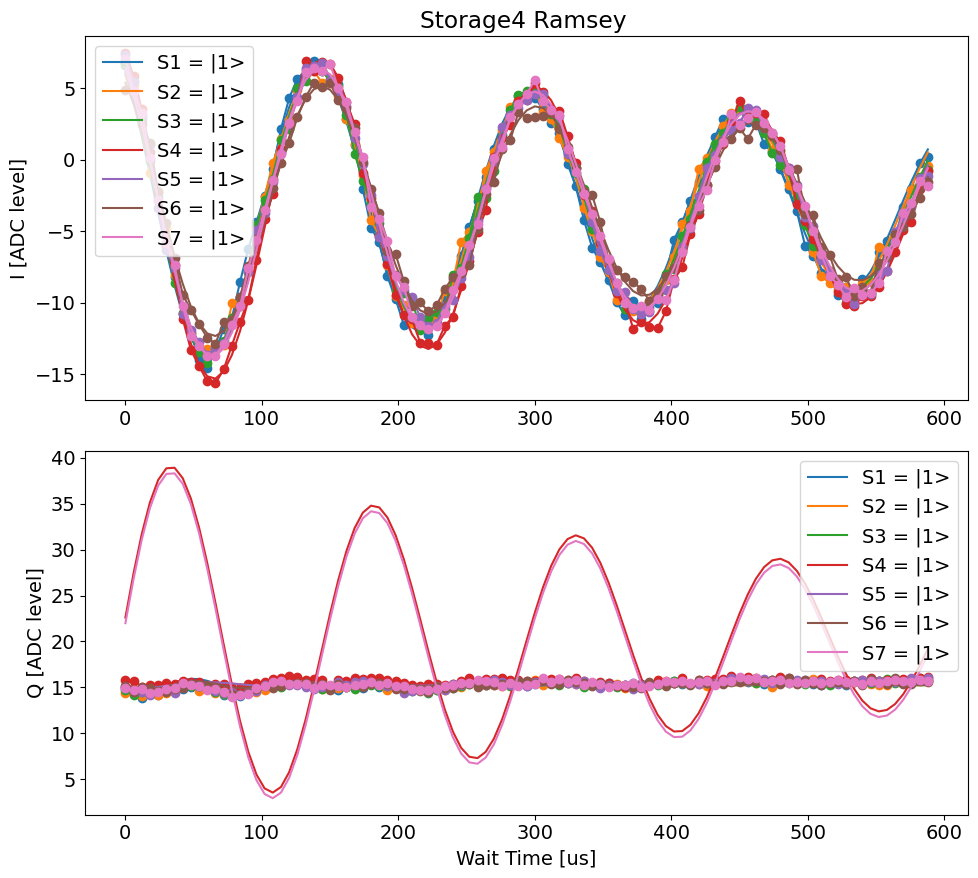

[ 6.10648017e-05  4.56428583e-05  1.96973208e-05  0.00000000e+00
  2.41548015e-06 -1.08904643e-05 -6.20592017e-06]
[8.93423546e-06 9.02314693e-06 9.12695981e-06 6.75331489e-06
 8.79065434e-06 9.83080858e-06 7.82242301e-06]


In [484]:
file_list = np.arange(80,87,1)
orig_idx = 3
label_list =  [f'S1 = |1>',  f'S2 = |1>',  f'S3 = |1>', f'S4 = |1>', f'S5 = |1>', f'S6 = |1>', f'S7 = |1>']
color_list = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple', 'tab:brown', 'tab:pink']#, 'tab:green']

temp_data, attrs = prev_data(expt_path, '00040_CavityRamseyExperiment.h5') # just to get configs
diffs, diffs_err = cross_kerr_display(file_list,  label_list, color_list, orig_idx = orig_idx, active_reset = True, threshold = -4.3, readouts_per_rep = 4,
                         ramsey_freq= attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
                         fitparams = [20, None, None, None, None, None],
                           normalize= [False, 'g_data', 'e_data'], title='Storage4 Ramsey')
# diff_list.append(diffs)
# diff_err_list.append(diffs_err)
print(diffs)
print(diffs_err)

In [485]:
diff_list.append(diffs)
diff_err_list.append(diffs_err)
ck_file_list.append(file_list)

In [2074]:
diff_list

[array([ 0.00000000e+00,  2.69516637e-04,  1.26486438e-04,  8.86845176e-05,
         4.26936404e-05,  1.94041328e-05, -1.95956248e-05]),
 array([-1.77543592e-04,  0.00000000e+00, -6.92266452e-05, -7.10978126e-05,
         1.37913777e-05, -2.56223707e-05,  9.10903529e-07]),
 array([-7.56355942e-05, -4.42189013e-05,  0.00000000e+00, -2.45449305e-05,
        -4.28864355e-06,  2.24512793e-06, -3.33552244e-06]),
 array([ 6.10648017e-05,  4.56428583e-05,  1.96973208e-05,  0.00000000e+00,
         2.41548015e-06, -1.08904643e-05, -6.20592017e-06])]

489
480
486
486
487
487
484
487
490
484
485
482
489
479
479
480
484
486
483
485
491
479
482
486
482
489
485
485
485
491
489
488
488
483
488
491
486
490
488
493
490
495
489
488
486
477
485
485
491
488
482
486
479
486
486
485
486
483
485
482
484
484
488
482
490
492
491
484
483
486
481
493
492
490
487
485
489
484
486
490
493
489
490
483
486
487
484
482
491
492
487
486
482
480
489
484
489
483
482
487
491
491
489
490
490
486
490
489
484
493
486
483
486
485
482
481
487
482
484
492
488
483
487
488
487
483
492
486
483
481
482
483
478
485
479
492
483
486
489
490
488
490
488
483
484
481
489
481
479
485
Attempted to init fitparam 1 to 0.03557046979865772, which is out of bounds 6.756756756756757e-05 to 0.010135135135135136. Instead init to 0.005101351351351351
Current pi pulse frequency: 4984.02431625832
Fit frequency from I [MHz]: 0.006818937696613558 +/- 5.812356504425309e-06
Suggested new pi pulse frequency from fit I [MHz]:
 	4984.097497320624
 	4984.111135196017
T2 Ramsey from fit I [us]: 75

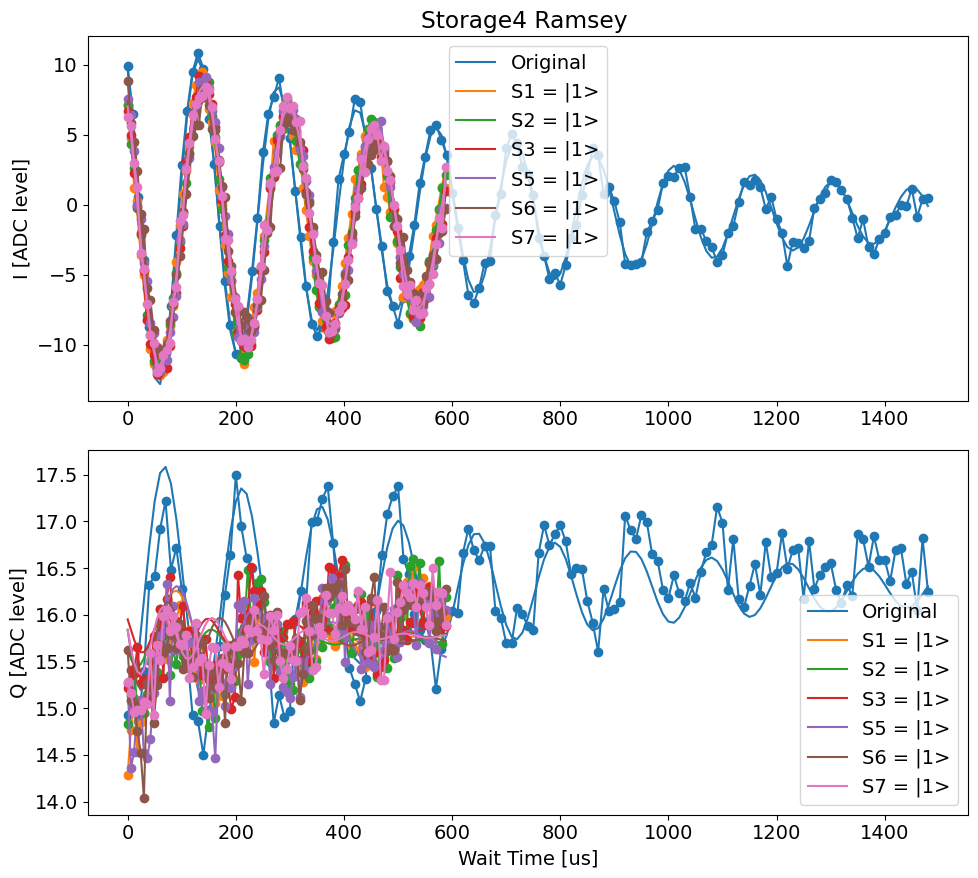

(array([ 0.        , -0.00045236, -0.00047134, -0.00051703, -0.00049661,
        -0.00049373, -0.00052072]),
 array([5.81235650e-06, 9.11809200e-06, 9.40092727e-06, 9.91004982e-06,
        1.03816812e-05, 1.41200449e-05, 1.15452344e-05]))

In [1931]:
file_list = np.array(['00187_CavityRamseyExperiment.h5', '00016_cross_kerr_sweep.h5', '00017_cross_kerr_sweep.h5', '00018_cross_kerr_sweep.h5', 
                      '00020_cross_kerr_sweep.h5', '00021_cross_kerr_sweep.h5', '00022_cross_kerr_sweep.h5'])
label_list = [f'Original',  f'S1 = |1>',  f'S2 = |1>', f'S3 = |1>', f'S5 = |1>', f'S6 = |1>', f'S7 = |1>']
color_list = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple', 'tab:brown', 'tab:pink']#, 'tab:green']

temp_data, attrs = prev_data(expt_path, '00040_CavityRamseyExperiment.h5') # just to get configs
multiple_Ramsey_display(file_list, label_list, color_list, active_reset = True, threshold = -4.3, readouts_per_rep = 4,
                         ramsey_freq= attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
                         fitparams = None, #[100, 0.2, 90, 25.0, 8, None],
                           normalize= [False, 'g_data', 'e_data'], title='Storage4 Ramsey')

### Storage 5

Attempted to init fitparam 4 to 7.001178702949302, which is out of bounds 15.808382526564344 to 17.783633202497303. Instead init to 16.79600786453082
Attempted to init fitparam 4 to 16.79600786453082, which is out of bounds 17.963155507979256 to 21.298667148057238. Instead init to 19.630911328018247
Current pi pulse frequency: 4984.026194477733
Fit frequency from I [MHz]: 0.28695545132438044 +/- 0.000427445139245689
Suggested new pi pulse frequency from fit I [MHz]:
 	4983.963149929057
 	4983.389239026409
T2 Ramsey from fit I [us]: 218.90721224684927
Fit frequency from Q [MHz]: 0.28772112106369646 +/- 0.002110084177375481
Suggested new pi pulse frequencies from fit Q [MHz]:
 	4983.963915598797
 	4983.388473356669
T2 Ramsey from fit Q [us]: 10.889394986704259


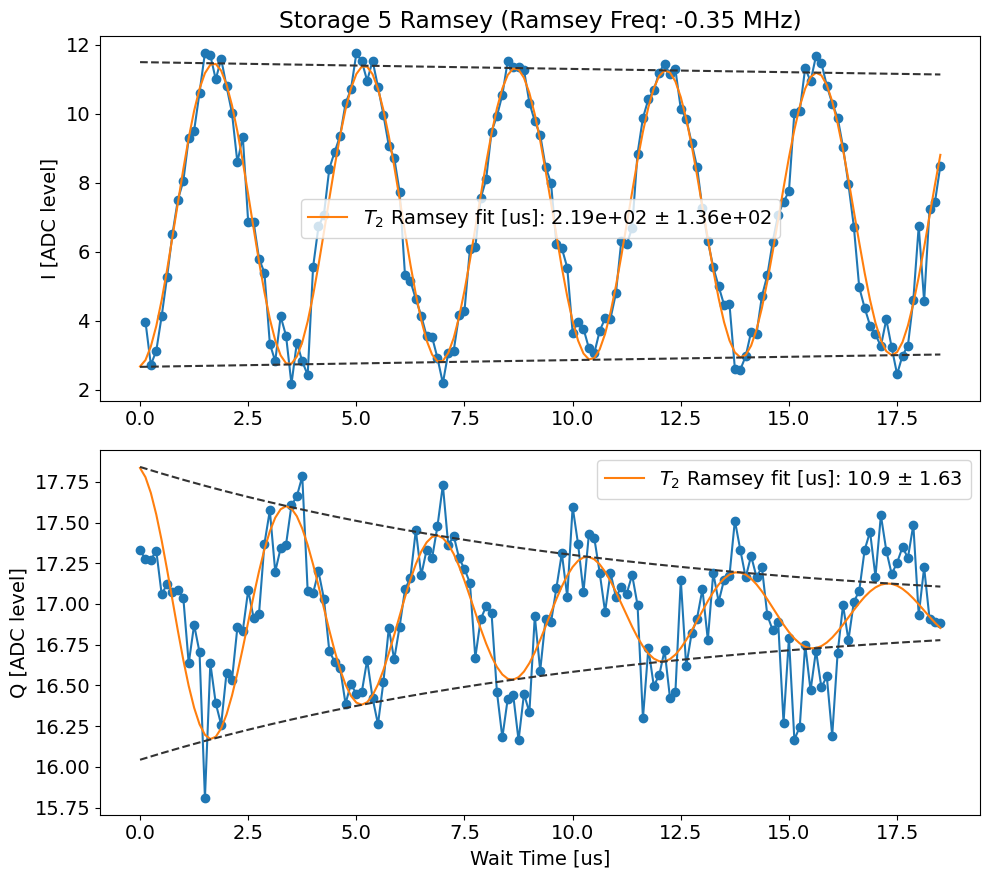

In [833]:
temp_data, attrs = prev_data(expt_path, '00194_CavityRamseyExperiment.h5')
temp_data, attrs = prev_data(expt_path, '01040_cavity_ramsey_sweep.h5')
Ramsey_display(temp_data, attrs, ramsey_freq=attrs['config']['expt']['ramsey_freq'], 
               active_reset=True, threshold=-4.323194812977462, readouts_per_rep=4, initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
               fitparams = [None, None, None, None, None, None],
                 title='Storage 5 Ramsey')

#### Sweep for Kerr

Gain to alpha: 0.00095481


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


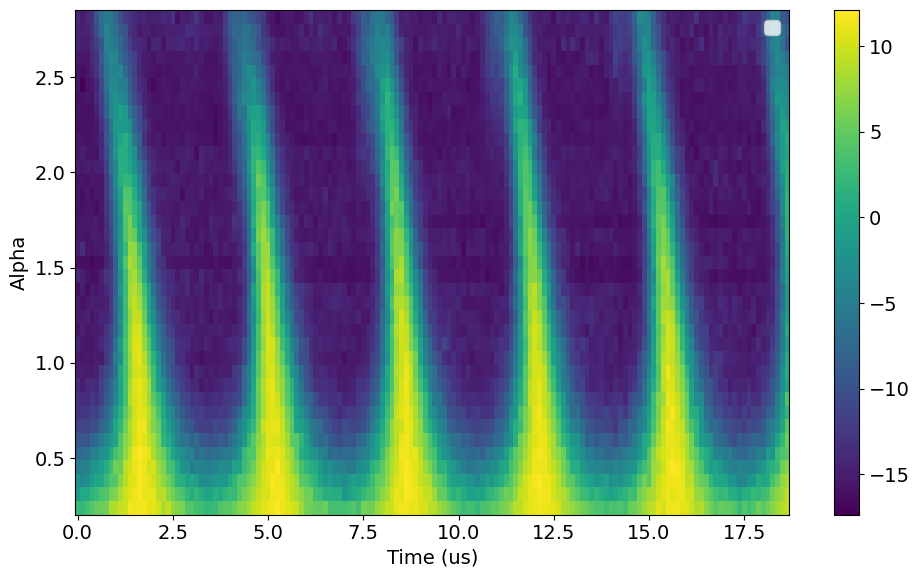

In [870]:
# file_list = np.arange(935, 968, 1)
file_list = np.arange(1042, 1079, 1)
y_list = []
gain_list = []
name = '_cavity_ramsey_sweep.h5'
data_list = []
attrs_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    data_list.append(temp_data)
    attrs_list.append(attrs)
    gain_list.append(attrs['config']['expt']['user_defined_pulse'][2])

gain_to_alpha = attrs['config']['device']['manipulate']['gain_to_alpha'][0] * 3
alpha_list = np.array(gain_list)*gain_to_alpha
print('Gain to alpha:', gain_to_alpha)  

xlist, ylist, zlist = plot_ramsey_sideband(data_list, attrs_list, y_list = alpha_list, active_reset=True, threshold=-4.323194812977462, readouts_per_rep=4)

In [867]:
attrs_list[0]['config']['expt']

{'start': 0,
 'step': 0.125,
 'expts': 151,
 'ramsey_freq': -0.35,
 'reps': 500,
 'rounds': 1,
 'qubits': [0],
 'checkEF': False,
 'f0g1_cavity': 0,
 'init_gf': False,
 'active_reset': True,
 'man_reset': True,
 'storage_reset': True,
 'user_defined_pulse': [True, 4984.026194477733, 250, 0.15, 0, 4],
 'parity_meas': False,
 'man_idx': 1,
 'storage_ramsey': [True, 5, False],
 'prepulse': False,
 'postpulse': True,
 'pre_sweep_pulse': [[3568.1782381859975, 3425.559887601728, 0],
  [13639, 10338, 0],
  [0, 0, 0.01],
  [0, 0, 0],
  [2, 2, 5],
  ['gaussian', 'gaussian', 'flat_top'],
  [0.025, 0.025, 0.005]],
 'post_sweep_pulse': [[3568.1782381859975],
  [50],
  [6.504911065860095],
  [0],
  [2],
  ['flat_top'],
  [0.005]]}

In [871]:
import numpy as np
from scipy.optimize import minimize

idx_list = np.arange(0, len(ylist), 1)
freqs = []
alpha_list_ = []
t0s = []
alpha_list = ylist

for idx in idx_list:

# parameters for the model
# idx = 15
# pr
# int(f'Alpha: {alpha_list[idx]}')
#choose the ydata 
    ydata = zlist[idx]
    tlist = xlist
    omega = 0.5 * 2 *np.pi # MHz 
    alpha = alpha_list[idx]
    print(f'Alpha: {alpha_list[idx]}')

    args = {'alpha': alpha, 'omega': omega, 't0': 0.3}


    def small_angle_approx_P0(t, args): 
        return np.exp(-2* np.abs(args['alpha'])**2 * (1 - np.cos(args['omega'] * (t + args['t0']))) )




    #rescale data to be between 0 and 1
    min_value_model = np.exp(-2*2* np.abs(alpha)**2)
    ydata_scaled = (ydata - min(ydata))/(max(ydata) - min(ydata))

    # Map the scaled data to have min value of min_value_model and max value of 1
    min_value_model = np.exp(-2*2* np.abs(alpha)**2)
    ydata_final = ydata_scaled * (1 - min_value_model) + min_value_model




    # rescale data between 1 and min value

    # invert data
    # ydata = 1 - ydata
    # rescale data to have max value of max(ws)
    # ydata = ydata * max(ws)

    # Objective function to fit data to wigner function curve 
    center_freq = 0.286 * 2 * np.pi
    init_f0 = 0.3
    freq = 0
    while np.abs(freq - center_freq)/center_freq >0.1:
        
        init_f0 -= 0.01
        if init_f0 == 0.1: 
            break
        def objective(param):

            args['omega'] = param[0]
            args['t0'] = param[1]
            ws = small_angle_approx_P0(tlist, args)

            return np.sum(np.abs(ws - ydata_final))  # sum of absolute differences

        # Initial guess for start and end of alpha_list
        initial_guess = [init_f0 * 2 * np.pi, 20]

        # Bounds for start and end values of alpha_list
        bounds = [(0 * 2 * np.pi, 0.3 * 2 * np.pi), (-10, 30)]

        # Run the optimizer
        result = minimize(objective, initial_guess, bounds=bounds, tol=1e-5, options={'disp': True}) #, method = 'BFGS')

        freq = result.x[0]

        # Run the optimizer
        result = minimize(objective, initial_guess, bounds=bounds, tol=1e-5, options={'disp': True}) #, method = 'BFGS')


        freq = result.x[0]
    

    # store all params
    freqs.append(result.x[0])
    t0s.append(result.x[1])
    alpha_list_.append(alpha_list[idx])

# plt.plot(tlist, ydata, 'o', label='Data')
# plt.plot(tlist, small_angle_approx_P0(tlist, args), label='Model')
# print(result.x)

Alpha: 0.23870249999999998
Alpha: 0.31031325
Alpha: 0.381924
Alpha: 0.45353475
Alpha: 0.5251454999999999
Alpha: 0.59675625
Alpha: 0.6683669999999999
Alpha: 0.73997775
Alpha: 0.8115884999999999
Alpha: 0.88319925
Alpha: 0.9548099999999999
Alpha: 1.02642075
Alpha: 1.0980315
Alpha: 1.1696422499999999
Alpha: 1.241253
Alpha: 1.31286375
Alpha: 1.3844744999999998
Alpha: 1.4560852499999999
Alpha: 1.527696
Alpha: 1.59930675
Alpha: 1.6709174999999998
Alpha: 1.74252825
Alpha: 1.814139
Alpha: 1.88574975
Alpha: 1.9573604999999998
Alpha: 2.0289712499999997
Alpha: 2.1005819999999997
Alpha: 2.17219275
Alpha: 2.2438035
Alpha: 2.31541425
Alpha: 2.387025
Alpha: 2.45863575
Alpha: 2.5302465
Alpha: 2.6018572499999997
Alpha: 2.6734679999999997
Alpha: 2.74507875
Alpha: 2.8166895


In [ ]:
center_freq*0.02

0.03392920065876977

In [ ]:
len(alpha_list)

33

In [ ]:
3.2/(3 *0.000145)

7356.32183908046

Slope: 0.00020919844908603148
Stor 5 Slope: 0.20920 +/- 0.03980kHz


Text(0, 0.5, 'Ramsey Frequency (MHz)')

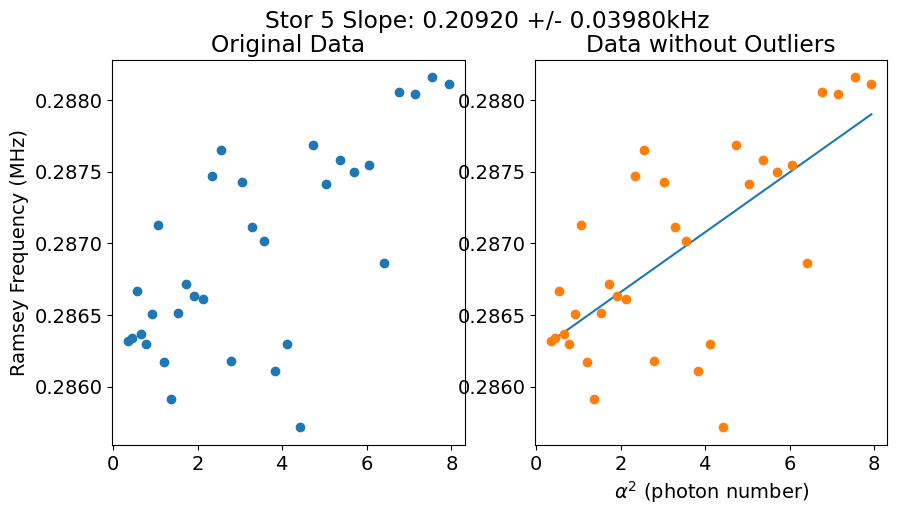

In [872]:
from scipy import stats
idx_skip = 5
idx_end = None
# make figure with 2 subplots 
fig, ax = plt.subplots(1, 2, figsize=(10, 5))
ax[0].plot([alpha **2 for alpha in alpha_list_[idx_skip:idx_end]], np.array(freqs[idx_skip: idx_end])/(2*np.pi), 'o', label='Data')

x = [alpha **2 for alpha in alpha_list_[idx_skip:idx_end]]
y = np.array(freqs[idx_skip: idx_end])/(2*np.pi)

# skip over outliers 
center = 0.27
new_x, new_y = [], []
for idx, freq in enumerate(y):
    if np.abs(freq - center)/ center < 1:
        new_x.append(x[idx])
        new_y.append(y[idx])
slope, intercept, r_value, p_value, std_err = stats.linregress(new_x, new_y)

print(f"Slope: {slope}")
ax[1].plot(new_x, [slope * x_ + intercept for x_ in new_x], label='Fit')
ax[1].plot(new_x, new_y, 'o', label='Data without outliers')

# put slope in title (round to 5 decimal places)
plt.suptitle(f'Stor 5 Slope: {slope * 1e+3:.5f} +/- {std_err * 1e+3:.5f}kHz')
ax[0].set_title('Original Data')
ax[1].set_title('Data without Outliers')
# print the title 
print(f'Stor 5 Slope: {slope * 1e+3:.5f} +/- {std_err * 1e+3:.5f}kHz')
plt.xlabel(r'$\alpha^2$ (photon number)')
ax[0].set_ylabel('Ramsey Frequency (MHz)')

Alpha: 1.527696
percent diff 0.24936773319604422
percent diff 0.005147813404676986
[ 1.80624157 19.39544702]
freq: 0.2874722746337376


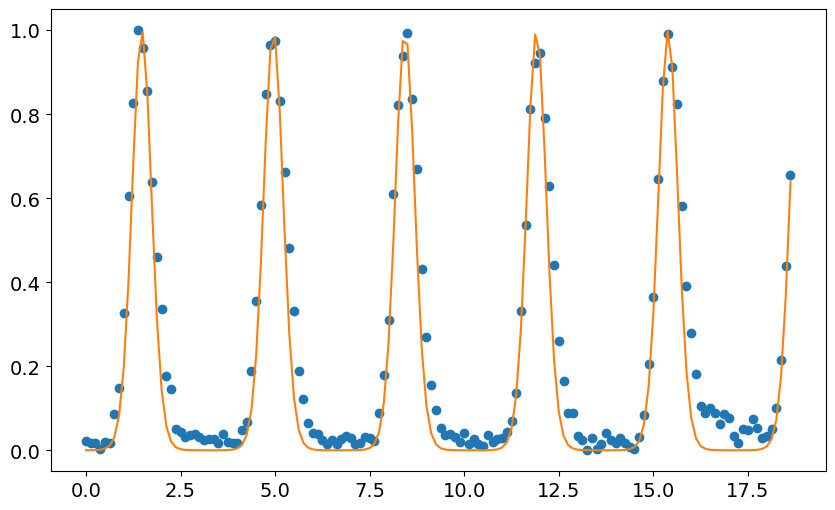

In [863]:
idx = -1
# pr
# int(f'Alpha: {alpha_list[idx]}')
#choose the ydata 
ydata = zlist[idx]
tlist = xlist
omega = 0.5 * 2 *np.pi # MHz 
alpha = alpha_list[idx]
print(f'Alpha: {alpha_list[idx]}')

args = {'alpha': alpha, 'omega': omega, 't0': 0.3}


def small_angle_approx_P0(t, args): 
    return np.exp(-2* np.abs(args['alpha'])**2 * (1 - np.cos(args['omega'] * (t + args['t0']))) )




#rescale data to be between 0 and 1
min_value_model = np.exp(-2*2* np.abs(alpha)**2)
ydata_scaled = (ydata - min(ydata))/(max(ydata) - min(ydata))

# Map the scaled data to have min value of min_value_model and max value of 1
min_value_model = np.exp(-2*2* np.abs(alpha)**2)
ydata_final = ydata_scaled * (1 - min_value_model) + min_value_model




# rescale data between 1 and min value

# invert data
# ydata = 1 - ydata
# rescale data to have max value of max(ws)
# ydata = ydata * max(ws)

# Objective function to fit data to wigner function curve 
center_freq = 0.286 * 2 * np.pi
init_f0 = 0.3
freq = 0
while np.abs(freq - center_freq)/center_freq >0.1:
    
    init_f0 -= 0.01
    if init_f0 == 0.1: 
        break
    def objective(param):

        args['omega'] = param[0]
        args['t0'] = param[1]
        ws = small_angle_approx_P0(tlist, args)

        return np.sum(np.abs(ws - ydata_final))  # sum of absolute differences

    # Initial guess for start and end of alpha_list
    initial_guess = [init_f0 * 2 * np.pi, 20]

    # Bounds for start and end values of alpha_list
    bounds = [(0 * 2 * np.pi, 0.3 * 2 * np.pi), (-10, 30)]

    # Run the optimizer
    result = minimize(objective, initial_guess, bounds=bounds, tol=1e-5, options={'disp': True}) #, method = 'BFGS')

    freq = result.x[0]
    print('percent diff', (np.abs(freq - center_freq)/center_freq))

# store all params
# freqs.append(result.x[0])
# t0s.append(result.x[1])
# alpha_list_.append(alpha_list[idx])

plt.plot(tlist, ydata_final, 'o', label='Data')
args['omega'] = result.x[0]
args['t0'] = result.x[1]
plt.plot(tlist, small_angle_approx_P0(tlist, args), label='Model')
print(result.x)
print('freq:', result.x[0]/(2*np.pi))

#### Cross Kerr

00087_cross_kerr_sweep.h5
Attempted to init fitparam 4 to -3.6588847722815325, which is out of bounds 14.477544117452375 to 16.123310565324807. Instead init to 15.300427341388591
Attempted to init fitparam 4 to 15.300427341388591, which is out of bounds 17.03015078111553 to 22.602976248033215. Instead init to 19.816563514574373
Current pi pulse frequency: 4984.02431625832
Fit frequency from I [MHz]: 0.009332719408154125 +/- 9.896357495710902e-06
Suggested new pi pulse frequency from fit I [MHz]:
 	4984.094983538912
 	4984.113648977728
T2 Ramsey from fit I [us]: 583.674741537646
Fit frequency from Q [MHz]: 0.009381547146790866 +/- 0.0004483569628558856
Suggested new pi pulse frequencies from fit Q [MHz]:
 	4984.094934711174
 	4984.113697805467
T2 Ramsey from fit Q [us]: 191.14548272824794
00088_cross_kerr_sweep.h5
Attempted to init fitparam 4 to 19.816563514574373, which is out of bounds -14.313384574609065 to 7.520595226903396. Instead init to -3.396394673852835
Attempted to init fitpa

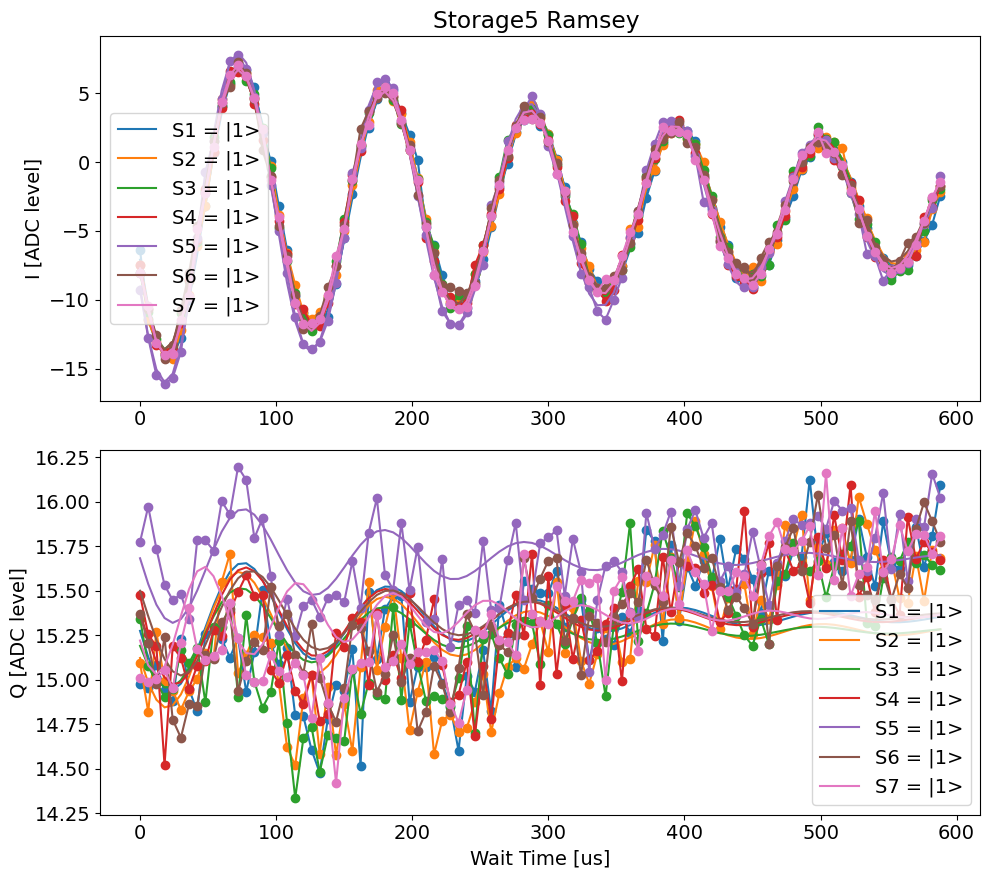

[-3.72488668e-05 -4.62192947e-05 -3.77809419e-05 -1.58034621e-05
  0.00000000e+00 -2.52649638e-05 -2.20498490e-06]
[9.89635750e-06 9.01466277e-06 9.02747919e-06 8.87843044e-06
 8.18835136e-06 9.29222097e-06 7.83356758e-06]


In [486]:
file_list = np.arange(87,94,1)
orig_idx = 4
label_list =  [f'S1 = |1>',  f'S2 = |1>',  f'S3 = |1>', f'S4 = |1>', f'S5 = |1>', f'S6 = |1>', f'S7 = |1>']
color_list = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple', 'tab:brown', 'tab:pink']#, 'tab:green']

temp_data, attrs = prev_data(expt_path, '00040_CavityRamseyExperiment.h5') # just to get configs
diffs, diffs_err = cross_kerr_display(file_list,  label_list, color_list, orig_idx = orig_idx, active_reset = True, threshold = -4.3, readouts_per_rep = 4,
                         ramsey_freq= attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
                         fitparams = [20, None, None, None, None, None],
                           normalize= [False, 'g_data', 'e_data'], title='Storage5 Ramsey')
# diff_list.append(diffs)
# diff_err_list.append(diffs_err)
print(diffs)
print(diffs_err)

In [487]:
diff_list.append(diffs)
diff_err_list.append(diffs_err)
ck_file_list.append(file_list)

490
485
496
489
488
488
493
485
486
485
491
487
490
488
489
485
482
482
484
485
482
484
482
484
486
481
493
487
488
493
486
490
488
480
484
489
491
495
492
489
482
483
492
492
488
489
482
485
479
484
490
488
490
493
486
490
488
483
478
489
484
489
492
485
485
488
485
487
487
490
486
486
484
485
483
483
492
477
487
483
486
496
488
490
486
483
483
484
483
492
483
483
485
482
488
485
488
488
479
484
484
482
490
485
491
485
482
486
486
490
482
491
487
488
486
492
485
488
487
488
485
486
495
489
485
490
492
490
489
485
485
488
489
490
492
491
489
481
485
487
483
489
481
487
482
488
484
486
481
487
Current pi pulse frequency: 4984.02431625832
Fit frequency from I [MHz]: 0.008584886614588704 +/- 7.550836080439341e-06
Suggested new pi pulse frequency from fit I [MHz]:
 	4984.095731371705
 	4984.112901144935
T2 Ramsey from fit I [us]: 620.0143106907524
Fit frequency from Q [MHz]: 0.008426607736359407 +/- 3.164879200387773e-05
Suggested new pi pulse frequencies from fit Q [MHz]:
 	4984.095889650

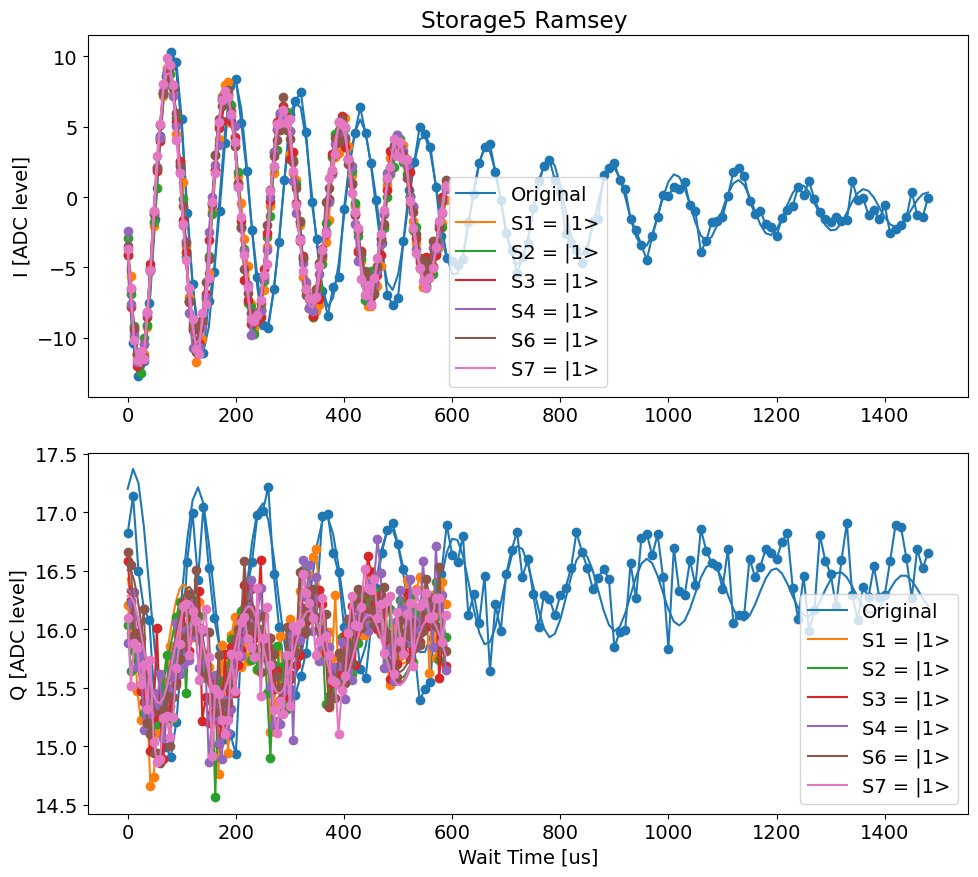

(array([0.        , 0.00081303, 0.00081936, 0.00081497, 0.00082563,
        0.00084239, 0.00084165]),
 array([7.55083608e-06, 1.36955813e-05, 1.04685767e-05, 1.12100667e-05,
        1.26834399e-05, 1.02059217e-05, 1.21692174e-05]))

In [1932]:
file_list = np.array(['00194_CavityRamseyExperiment.h5', '00023_cross_kerr_sweep.h5', '00024_cross_kerr_sweep.h5', '00025_cross_kerr_sweep.h5', 
                      '00026_cross_kerr_sweep.h5', '00028_cross_kerr_sweep.h5', '00029_cross_kerr_sweep.h5'])
label_list = [f'Original',  f'S1 = |1>',  f'S2 = |1>', f'S3 = |1>', f'S4 = |1>', f'S6 = |1>', f'S7 = |1>']
color_list = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple', 'tab:brown', 'tab:pink']#, 'tab:green']

temp_data, attrs = prev_data(expt_path, '00040_CavityRamseyExperiment.h5') # just to get configs
multiple_Ramsey_display(file_list, label_list, color_list, active_reset = True, threshold = -4.3, readouts_per_rep = 4,
                         ramsey_freq= attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
                         fitparams = None, #[100, 0.2, 90, 25.0, 8, None],
                           normalize= [False, 'g_data', 'e_data'], title='Storage5 Ramsey')

### Storage 6

488
490
485
482
487
487
489
492
485
489
484
476
484
489
486
483
480
491
484
489
484
489
486
483
484
480
489
487
495
485
484
491
483
485
492
486
488
484
487
488
482
477
477
488
484
480
481
490
483
480
489
490
487
489
492
484
486
491
488
483
485
492
482
487
486
485
492
486
489
484
482
485
479
487
488
492
493
486
493
483
488
490
485
490
486
477
490
491
486
486
481
491
487
480
488
492
485
483
475
491
490
491
487
482
481
486
487
483
493
491
493
487
481
488
489
486
488
486
484
485
487
487
484
494
487
489
494
491
483
487
485
484
489
490
491
482
484
479
492
486
490
484
492
478
489
486
488
489
483
490
494
487
484
492
487
488
488
488
492
485
485
486
486
488
486
490
488
487
486
489
489
486
492
486
486
484
484
490
492
491
488
490
483
487
487
493
486
486
486
486
487
485
491
483
491
481
485
485
488
491
Attempted to init fitparam 4 to -0.9815368058161201, which is out of bounds 14.65987921543477 to 17.251120264033485. Instead init to 15.955499739734128
Attempted to init fitparam 4 to 15.9554997397341

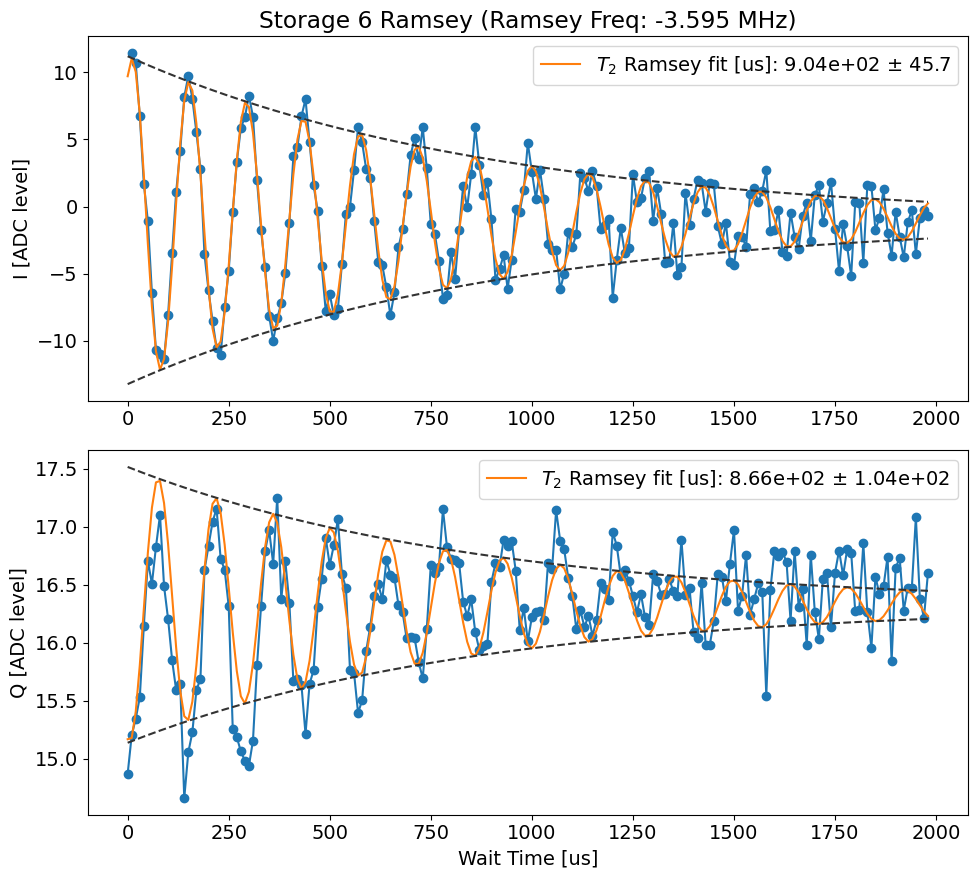

In [1933]:
temp_data, attrs = prev_data(expt_path, '00201_CavityRamseyExperiment.h5')
Ramsey_display(temp_data, attrs, ramsey_freq=attrs['config']['expt']['ramsey_freq'], 
               active_reset=True, threshold=-4.323194812977462, readouts_per_rep=4, initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
               fitparams = [None, None, None, None, None, None],
                 title='Storage 6 Ramsey')

#### Cross Kerr

00094_cross_kerr_sweep.h5
Attempted to init fitparam 4 to -2.752164671318537, which is out of bounds 14.196250757356236 to 16.22776687051457. Instead init to 15.212008813935403
Attempted to init fitparam 4 to 15.212008813935403, which is out of bounds 16.270792355246154 to 21.591682659197986. Instead init to 18.93123750722207
Current pi pulse frequency: 4984.02431625832
Fit frequency from I [MHz]: 0.006613596986453638 +/- 1.3576030795174414e-05
Suggested new pi pulse frequency from fit I [MHz]:
 	4984.097702661334
 	4984.1109298553065
T2 Ramsey from fit I [us]: 883.2547309934357
Fit frequency from Q [MHz]: 0.0008151128678440626 +/- 0.0002063219990003806
Suggested new pi pulse frequencies from fit Q [MHz]:
 	4984.103501145452
 	4984.105131371188
T2 Ramsey from fit Q [us]: 205.80000000033183
00095_cross_kerr_sweep.h5
Attempted to init fitparam 4 to 18.93123750722207, which is out of bounds -12.462751606845293 to 8.071868753061413. Instead init to -2.19544142689194
Attempted to init fitpa

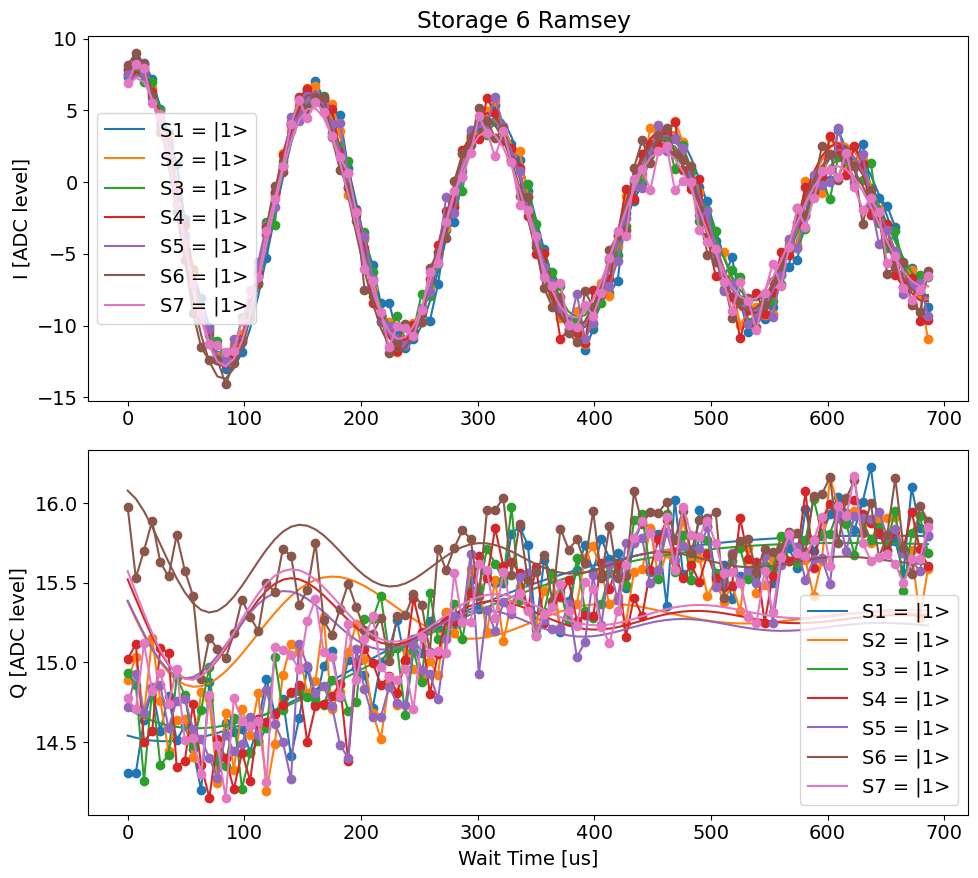

[-4.31597553e-05 -1.65832342e-05 -4.06943788e-05  1.21448311e-05
 -1.92766876e-05  0.00000000e+00  1.27297852e-05]
[1.35760308e-05 1.37773242e-05 1.63056708e-05 1.37112870e-05
 1.53958703e-05 1.54189492e-05 1.74830549e-05]


In [488]:
file_list = np.arange(94,101,1)
orig_idx = 5
label_list =  [f'S1 = |1>',  f'S2 = |1>',  f'S3 = |1>', f'S4 = |1>', f'S5 = |1>', f'S6 = |1>', f'S7 = |1>']
color_list = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple', 'tab:brown', 'tab:pink']#, 'tab:green']

temp_data, attrs = prev_data(expt_path, '00040_CavityRamseyExperiment.h5') # just to get configs
diffs, diffs_err = cross_kerr_display(file_list,  label_list, color_list, orig_idx = orig_idx, active_reset = True, threshold = -4.3, readouts_per_rep = 4,
                         ramsey_freq= attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
                         fitparams = [20, None, None, None, None, None],
                           normalize= [False, 'g_data', 'e_data'], title='Storage 6 Ramsey')
# diff_list.append(diffs)
# diff_err_list.append(diffs_err)
print(diffs)
print(diffs_err)

In [489]:
diff_list.append(diffs)
diff_err_list.append(diffs_err)
ck_file_list.append(file_list)

In [490]:
ck_file_list

[array([66, 67, 68, 69, 70, 71, 72]),
 array([108, 109, 110, 111, 112, 113, 114]),
 array([73, 74, 75, 76, 77, 78, 79]),
 array([80, 81, 82, 83, 84, 85, 86]),
 array([87, 88, 89, 90, 91, 92, 93]),
 array([ 94,  95,  96,  97,  98,  99, 100])]

488
490
485
482
487
487
489
492
485
489
484
476
484
490
486
483
481
491
484
489
484
489
486
483
484
480
489
487
495
485
485
491
483
485
492
486
488
484
487
488
482
479
477
488
484
480
481
490
483
480
489
490
487
489
492
484
486
491
488
483
485
492
482
487
486
485
492
486
489
484
482
485
479
487
488
492
493
486
493
483
488
490
485
490
486
477
490
491
486
486
481
491
487
480
488
492
485
483
475
491
490
491
487
482
481
486
487
483
493
491
493
487
481
488
489
486
488
486
484
485
487
487
484
494
487
489
494
491
483
487
485
484
489
490
491
482
484
479
492
486
490
484
492
478
489
486
488
489
483
490
494
487
484
492
487
488
488
489
492
485
485
487
486
488
486
490
488
487
486
489
489
486
492
486
486
484
484
490
492
491
488
490
483
487
488
493
487
486
486
486
487
485
491
483
491
481
485
485
488
491
Attempted to init fitparam 1 to 0.02311557788944724, which is out of bounds 5.0505050505050505e-05 to 0.007575757575757576. Instead init to 0.0038131313131313134
Attempted to init fitparam 1 to 0.0306

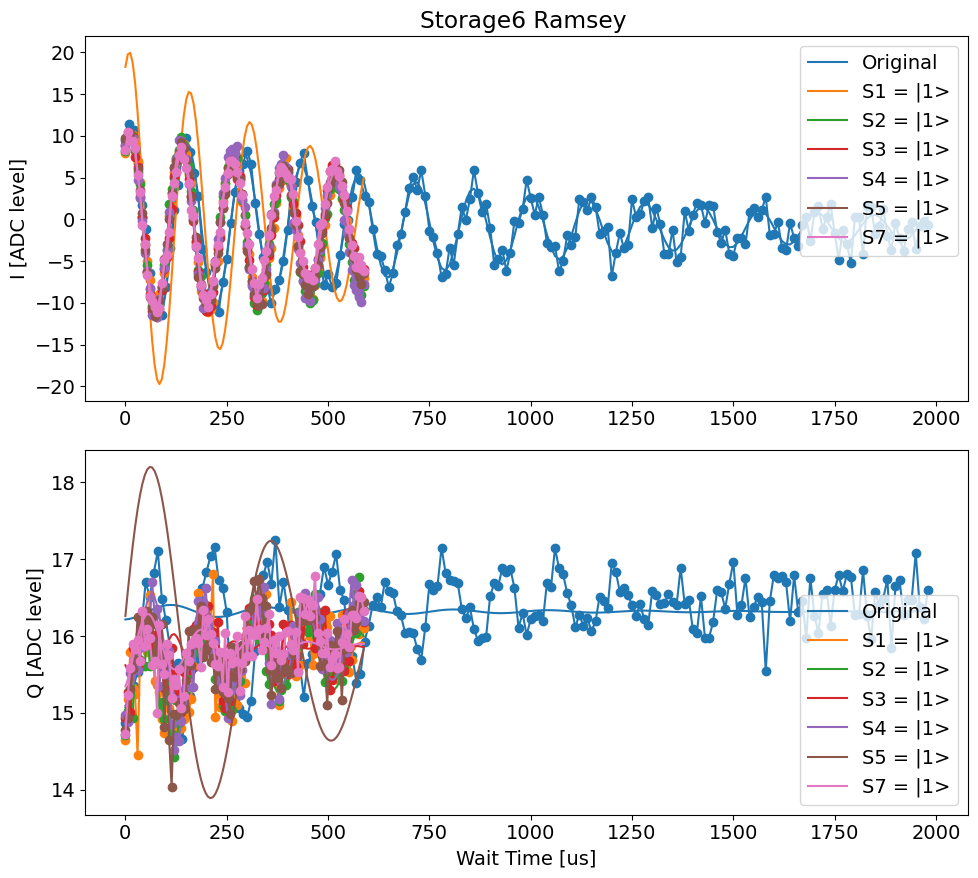

(array([ 0.        , -0.00034407,  0.00085528,  0.00081824,  0.00086737,
         0.00081934,  0.0008419 ]),
 array([8.95021104e-06,            inf, 1.43124835e-05, 1.31050040e-05,
        1.21782959e-05, 1.17589633e-05, 1.39009763e-05]))

In [1934]:
file_list = np.array(['00201_CavityRamseyExperiment.h5', '00030_cross_kerr_sweep.h5', '00031_cross_kerr_sweep.h5', '00032_cross_kerr_sweep.h5', 
                      '00033_cross_kerr_sweep.h5', '00034_cross_kerr_sweep.h5', '00036_cross_kerr_sweep.h5'])

label_list = [f'Original',  f'S1 = |1>',  f'S2 = |1>', f'S3 = |1>', f'S4 = |1>', f'S5 = |1>', f'S7 = |1>']
color_list = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple', 'tab:brown', 'tab:pink']#, 'tab:green']

temp_data, attrs = prev_data(expt_path, '00040_CavityRamseyExperiment.h5') # just to get configs
multiple_Ramsey_display(file_list, label_list, color_list, active_reset = True, threshold = -4.3, readouts_per_rep = 4,
                         ramsey_freq= attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
                         fitparams = None, #[100, 0.2, 90, 25.0, 8, None],
                           normalize= [False, 'g_data', 'e_data'], title='Storage6 Ramsey')

### Storage 7

486
482
490
486
488
481
482
492
484
482
489
484
486
488
488
481
488
488
484
479
487
477
479
492
487
482
485
488
491
492
485
485
484
490
481
487
490
490
487
487
486
493
490
487
484
487
486
490
486
492
487
481
492
483
487
481
485
487
484
491
495
488
483
496
490
486
487
488
491
489
490
483
486
489
485
490
479
488
482
491
489
485
488
486
488
486
485
486
489
486
487
480
488
481
484
480
490
491
488
484
481
487
476
483
476
491
479
479
489
486
487
482
483
491
489
486
473
486
485
492
487
481
494
485
481
485
488
487
485
490
483
492
482
484
487
483
484
489
487
495
487
489
490
486
485
490
483
487
489
488
Attempted to init fitparam 1 to 0.019594594594594592, which is out of bounds 6.802721088435374e-05 to 0.01020408163265306. Instead init to 0.005136054421768707
Attempted to init fitparam 4 to -1.071727296983147, which is out of bounds 14.306279301611253 to 17.151393176495638. Instead init to 15.728836239053447
Attempted to init fitparam 4 to 15.728836239053447, which is out of bounds 16.9117503682

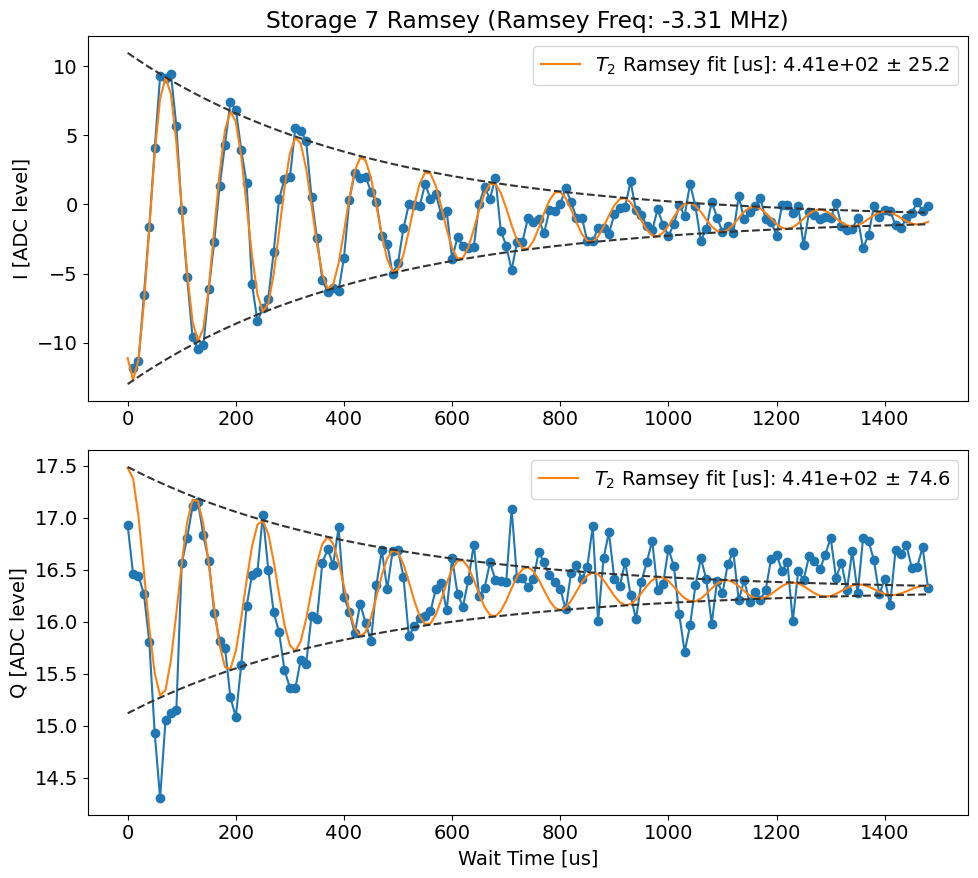

In [1878]:
temp_data, attrs = prev_data(expt_path, '00206_CavityRamseyExperiment.h5')
Ramsey_display(temp_data, attrs, ramsey_freq=attrs['config']['expt']['ramsey_freq'], 
               active_reset=True, threshold=-4.323194812977462, readouts_per_rep=4, initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
               fitparams = [None, None, None, None, None, None],
                 title='Storage 7 Ramsey')

#### Cross Kerr

00101_cross_kerr_sweep.h5
Attempted to init fitparam 4 to -3.8086211313044407, which is out of bounds 14.118019151234162 to 16.007039566310084. Instead init to 15.062529358772123
Attempted to init fitparam 4 to 15.062529358772123, which is out of bounds 17.020407257116517 to 22.249783334100453. Instead init to 19.635095295608487
Current pi pulse frequency: 4984.02431625832
Fit frequency from I [MHz]: 0.007933129091488803 +/- 9.883441620761534e-06
Suggested new pi pulse frequency from fit I [MHz]:
 	4984.096383129228
 	4984.112249387412
T2 Ramsey from fit I [us]: 670.0434847341211
Fit frequency from Q [MHz]: 0.007997202037507962 +/- 0.00019888878807398079
Suggested new pi pulse frequencies from fit Q [MHz]:
 	4984.0963190562825
 	4984.112313460358
T2 Ramsey from fit Q [us]: 269.125425229273
00102_cross_kerr_sweep.h5
Attempted to init fitparam 4 to 19.635095295608487, which is out of bounds -14.272923847091356 to 6.172653798800588. Instead init to -4.0501350241453835
Attempted to init fi

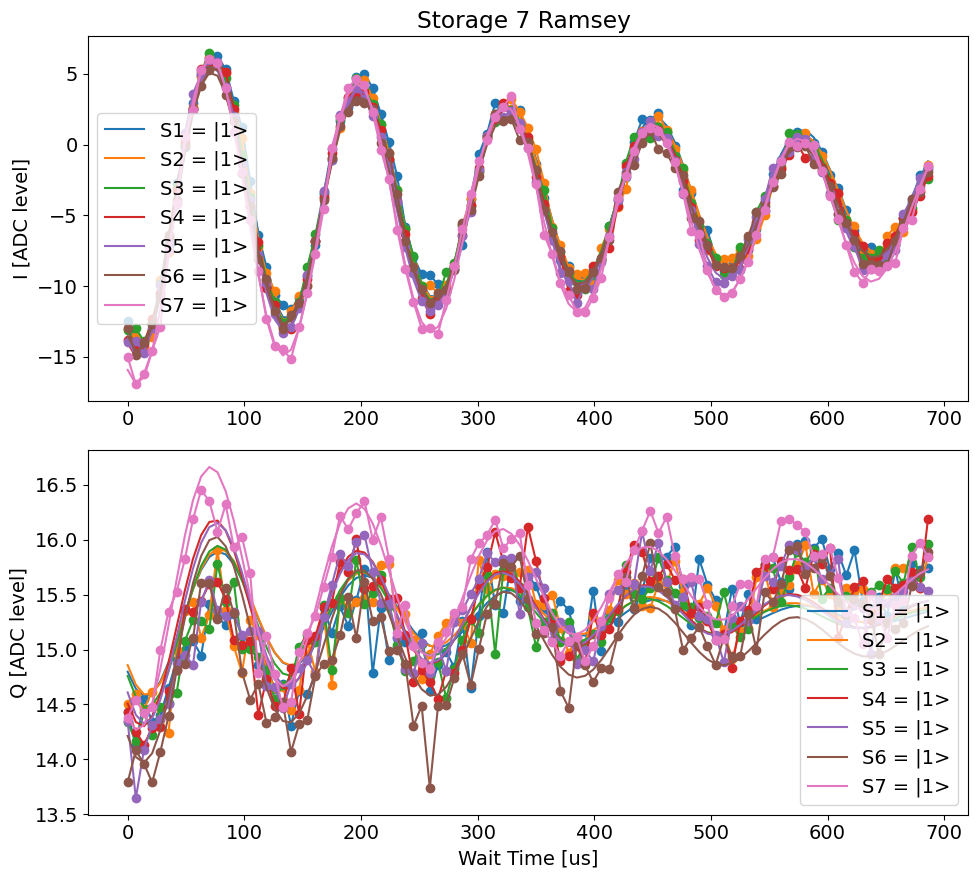

[-5.42085347e-06 -3.00407857e-05 -7.10933782e-06 -2.45232181e-05
  8.53857371e-06 -1.07023464e-05  0.00000000e+00]
[9.88344162e-06 9.14306062e-06 9.59114024e-06 8.50964972e-06
 8.00871615e-06 9.61036059e-06 7.22940608e-06]


In [491]:
file_list = np.arange(101,108,1)
orig_idx = 6
label_list =  [f'S1 = |1>',  f'S2 = |1>',  f'S3 = |1>', f'S4 = |1>', f'S5 = |1>', f'S6 = |1>', f'S7 = |1>']
color_list = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple', 'tab:brown', 'tab:pink']#, 'tab:green']

temp_data, attrs = prev_data(expt_path, '00040_CavityRamseyExperiment.h5') # just to get configs
diffs, diffs_err = cross_kerr_display(file_list,  label_list, color_list, orig_idx = orig_idx, active_reset = True, threshold = -4.3, readouts_per_rep = 4,
                         ramsey_freq= attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
                         fitparams = [20, None, None, None, None, None],
                           normalize= [False, 'g_data', 'e_data'], title='Storage 7 Ramsey')
# diff_list.append(diffs)
# diff_err_list.append(diffs_err)
print(diffs)
print(diffs_err)

In [492]:
diff_list.append(diffs)
diff_err_list.append(diffs_err)
ck_file_list.append(file_list)

487
482
490
486
488
481
482
492
484
483
489
484
486
488
488
481
488
488
484
479
487
477
479
492
487
482
485
488
491
492
485
485
484
490
481
487
490
490
487
487
486
493
490
487
484
487
486
490
486
492
487
481
492
483
487
481
485
487
484
491
495
488
483
496
490
486
487
488
491
489
490
483
486
489
485
490
479
488
482
491
489
485
488
486
488
486
485
486
489
486
487
480
488
481
484
480
490
491
488
484
481
487
476
483
476
491
479
479
489
486
487
482
483
491
489
486
473
486
485
492
487
481
494
485
481
485
488
487
485
490
483
492
482
484
487
483
484
489
487
495
487
489
490
486
485
490
483
487
489
488
Attempted to init fitparam 1 to 0.010738255033557046, which is out of bounds 6.756756756756757e-05 to 0.010135135135135136. Instead init to 0.005101351351351351
Current pi pulse frequency: 4984.02431625832
Fit frequency from I [MHz]: 0.008274510720695231 +/- 2.1052522353100997e-05
Suggested new pi pulse frequency from fit I [MHz]:
 	4984.0960417476
 	4984.112590769041
T2 Ramsey from fit I [us]: 44

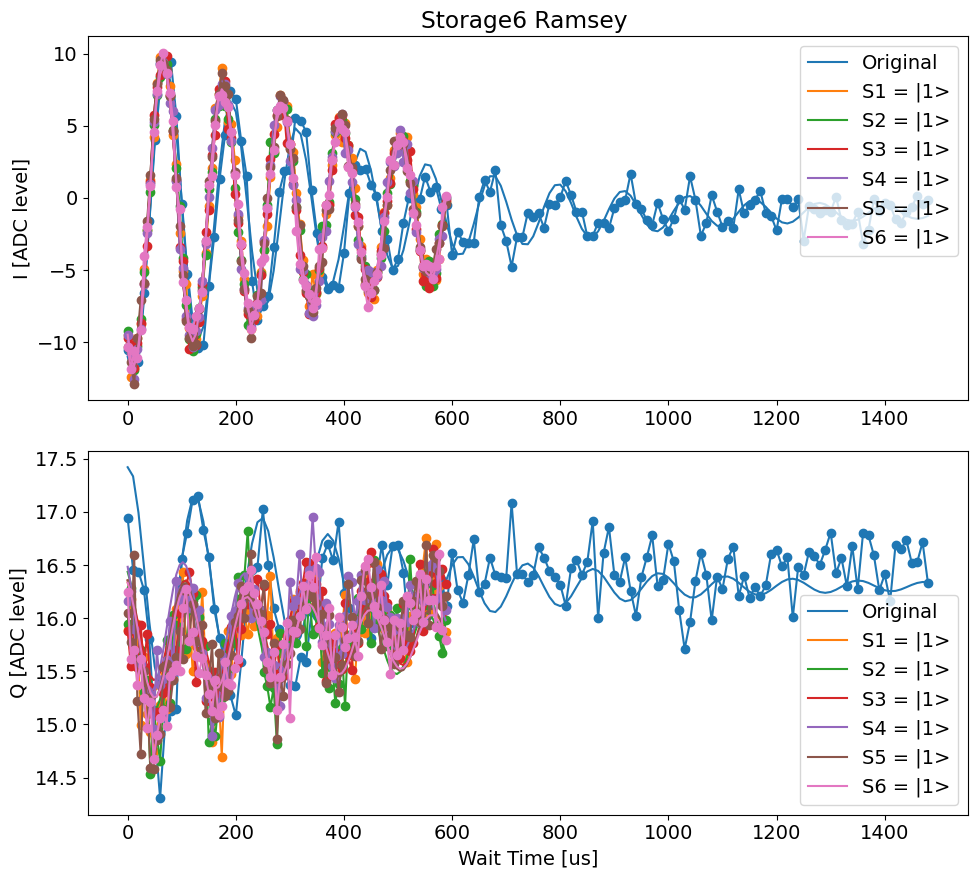

(array([0.        , 0.00083119, 0.00085998, 0.00085824, 0.00087536,
        0.00083647, 0.00087584]),
 array([2.10525224e-05, 1.32295558e-05, 1.34319862e-05, 1.28736491e-05,
        1.33288207e-05, 1.19500459e-05, 1.42649348e-05]))

In [1937]:
file_list = np.array(['00206_CavityRamseyExperiment.h5', '00037_cross_kerr_sweep.h5', '00038_cross_kerr_sweep.h5', '00039_cross_kerr_sweep.h5', 
                      '00040_cross_kerr_sweep.h5', '00041_cross_kerr_sweep.h5', '00042_cross_kerr_sweep.h5'])

label_list = [f'Original',  f'S1 = |1>',  f'S2 = |1>', f'S3 = |1>', f'S4 = |1>', f'S5 = |1>', f'S6 = |1>']
color_list = ['tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple', 'tab:brown', 'tab:pink']#, 'tab:green']

temp_data, attrs = prev_data(expt_path, '00040_CavityRamseyExperiment.h5') # just to get configs
multiple_Ramsey_display(file_list, label_list, color_list, active_reset = True, threshold = -4.3, readouts_per_rep = 4,
                         ramsey_freq= attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
                         fitparams = None, #[100, 0.2, 90, 25.0, 8, None],
                           normalize= [False, 'g_data', 'e_data'], title='Storage6 Ramsey')

In [497]:
np.array(ck_file_list)

array([[ 66,  67,  68,  69,  70,  71,  72],
       [108, 109, 110, 111, 112, 113, 114],
       [ 73,  74,  75,  76,  77,  78,  79],
       [ 80,  81,  82,  83,  84,  85,  86],
       [ 87,  88,  89,  90,  91,  92,  93],
       [ 94,  95,  96,  97,  98,  99, 100],
       [101, 102, 103, 104, 105, 106, 107]])

## Manipulate 1 Ramsey

486
482
487
483
488
494
480
484
488
489
485
490
486
485
489
491
488
488
488
486
486
487
492
486
486
479
491
481
486
484
486
484
481
485
484
484
491
485
488
489
489
493
482
490
487
490
487
485
482
483
490
487
491
490
486
486
494
484
485
490
485
482
491
486
486
490
488
490
488
490
491
488
490
487
481
487
482
483
487
485
479
485
490
493
483
490
490
489
491
490
487
489
494
494
483
491
492
487
491
484
Attempted to init fitparam 1 to 0.7142857142857142, which is out of bounds 0.002061855670103093 to 0.30927835051546393. Instead init to 0.1556701030927835
Current pi pulse frequency: 2006.72
Fit frequency from I [MHz]: 0.08365514894341976 +/- 9.665403230328761e-05
Suggested new pi pulse frequency from fit I [MHz]:
 	2003.7036551489434
 	2003.5363448510566
T2 Ramsey from fit I [us]: 75.48658986189561
Fit frequency from Q [MHz]: 0.1556701030927835 +/- inf
Suggested new pi pulse frequencies from fit Q [MHz]:
 	2003.7756701030928
 	2003.4643298969072
T2 Ramsey from fit Q [us]: 48.5


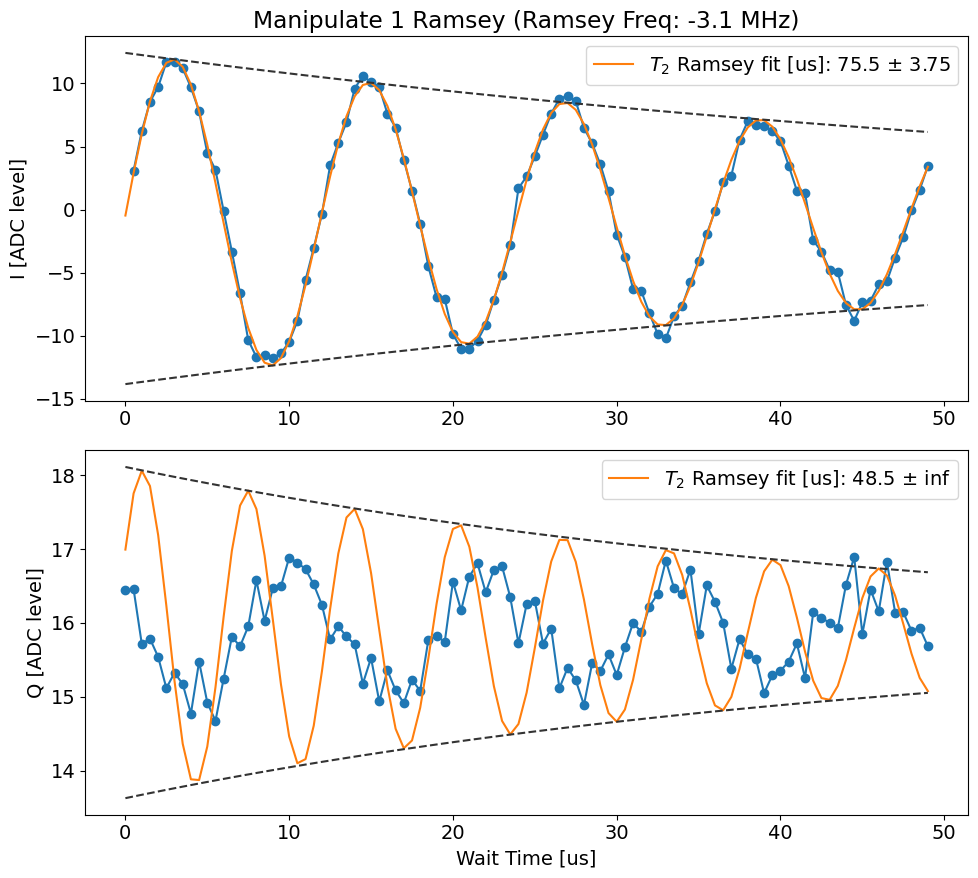

In [1886]:
temp_data, attrs = prev_data(expt_path, '00211_CavityRamseyExperiment.h5')
Ramsey_display(temp_data, attrs, ramsey_freq=attrs['config']['expt']['ramsey_freq'], 
               active_reset=True, threshold=-4.323194812977462, readouts_per_rep=4, initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, fitparams = None, title='Manipulate 1 Ramsey')

497
493
495
498
495
497
493
490
494
493
495
493
493
491
491
496
494
490
494
489
489
496
495
495
494
495
496
494
498
496
496
497
486
497
493
489
497
494
492
495
490
497
498
494
497
495
500
493
494
498
496
496
492
492
495
494
497
497
494
495
497
499
494
494
493
494
497
493
495
492
490
490
495
498
493
494
494
495
495
493
493
500
493
497
492
493
497
492
495
494
489
487
492
493
494
497
493
496
490
494
493
487
494
498
498
495
494
497
495
497
486
496
492
495
493
491
497
492
494
497
495
497
493
488
496
492
495
495
492
496
491
499
492
499
491
494
495
495
491
497
494
497
494
499
494
490
496
492
492
486
Current pi pulse frequency: 4984.026194477733
Fit frequency from I [MHz]: 1.5035536325813335 +/- 0.0024343027506946472
Suggested new pi pulse frequency from fit I [MHz]:
 	4984.022640845152
 	4987.029748110314
T2 Ramsey from fit I [us]: 60.915252732114524
Fit frequency from Q [MHz]: 1.5030100418552603 +/- 0.004328088026878283
Suggested new pi pulse frequencies from fit Q [MHz]:
 	4984.023184435878

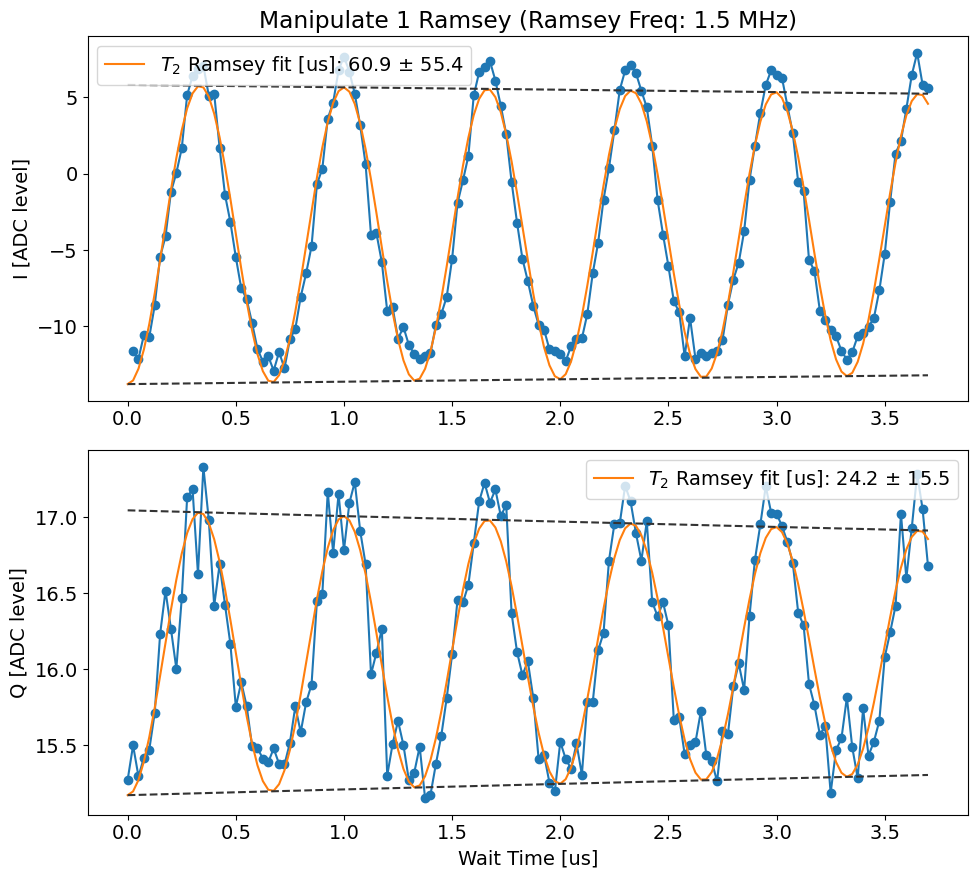

In [2403]:
temp_data, attrs = prev_data(expt_path, '00555_cavity_ramsey_sweep.h5')
# temp_data, attrs = prev_data(expt_path, '00234_CavityRamseyExperiment.h5')
Ramsey_display(temp_data, attrs, ramsey_freq=attrs['config']['expt']['ramsey_freq'], 
               active_reset=True, threshold=-4.323194812977462, readouts_per_rep=4, initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, fitparams = None, title='Manipulate 1 Ramsey')


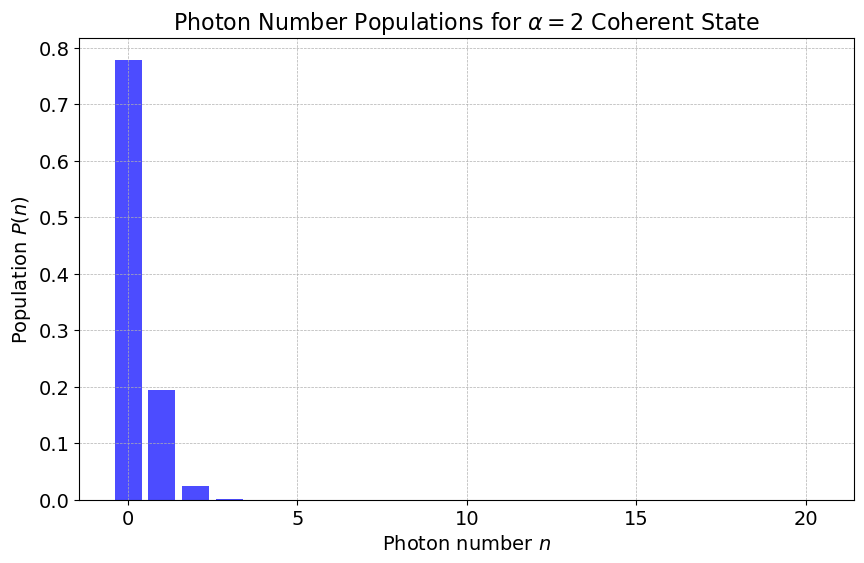

In [2362]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.special import factorial

# Define the amplitude alpha
alpha = 0.5

# Define the range of n (photon numbers)
n_max = 20
n = np.arange(0, n_max + 1)

# Calculate the photon number populations P(n)
P_n = (np.abs(alpha)**(2 * n) * np.exp(-np.abs(alpha)**2)) / factorial(n)

# Plot the photon number populations
plt.figure(figsize=(10, 6))
plt.bar(n, P_n, color='blue', alpha=0.7)
plt.xlabel('Photon number $n$', fontsize=14)
plt.ylabel('Population $P(n)$', fontsize=14)
plt.title('Photon Number Populations for $\\alpha = 2$ Coherent State', fontsize=16)
# plt.yscale('log')
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.show()

494
494
497
494
497
497
496
493
497
496
496
494
492
496
498
495
493
494
497
494
495
496
499
495
493
495
497
497
498
496
495
492
487
496
495
495
498
492
492
497
496
497
495
491
497
496
490
489
496
495
494
496
495
496
496
494
496
489
493
492
494
496
494
496
495
497
497
497
496
497
492
493
499
496
499
496
497
496
496
497
492
495
494
494
492
494
490
493
493
488
499
495
499
490
492
494
494
490
493
493
Current pi pulse frequency: 4984.026194477733
Fit frequency from I [MHz]: 3.000137121579294 +/- 0.03162679072098607
Suggested new pi pulse frequency from fit I [MHz]:
 	4982.526057356154
 	4988.5263315993125
T2 Ramsey from fit I [us]: 6.407920567918055
Fit frequency from Q [MHz]: 2.9932570235702016 +/- 0.05198312758981807
Suggested new pi pulse frequencies from fit Q [MHz]:
 	4982.5329374541625
 	4988.519451501304
T2 Ramsey from fit Q [us]: 3.052084382773706


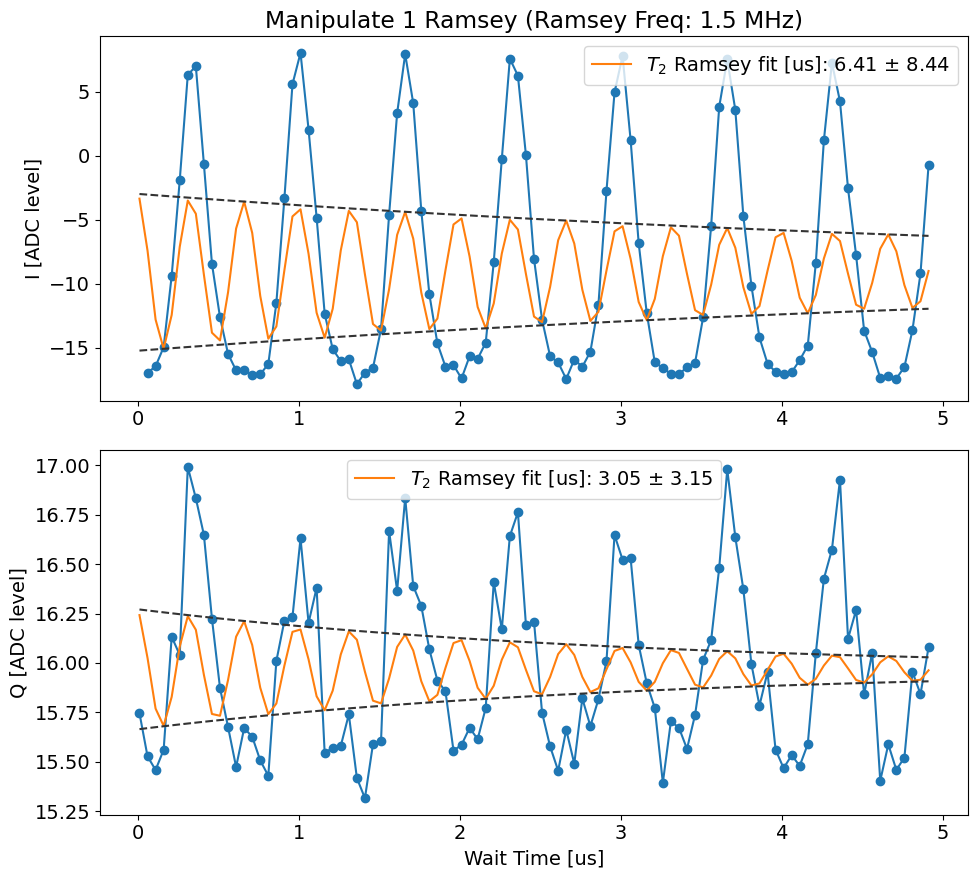

In [2333]:
temp_data, attrs = prev_data(expt_path, '00230_CavityRamseyExperiment.h5')
Ramsey_display(temp_data, attrs, ramsey_freq=attrs['config']['expt']['ramsey_freq'], 
               active_reset=True, threshold=-4.323194812977462, readouts_per_rep=4, initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, fitparams = None, title='Manipulate 1 Ramsey')

1959
1963
1974
1944
1971
1970
1969
1983
1962
1979
1978
1963
1970
1973
1960
1966
1958
1961
1948
1959
1958
1966
1968
1965
1968
1969
1962
1965
1978
1966
1934
1942
1931
1945
1970
1970
1962
1951
1935
1955
1971
1927
1965
1978
1967
1966
1974
1978
1975
1955
1938
1943
1962
1961
1964
1960
1965
1939
1961
1969
1966
1970
1968
1960
1963
1965
1965
1962
1973
1971
1971
1971
1962
1957
1975
1956
1976
1977
1971
1964
1968
1970
1968
1977
1965
1987
1965
1961
1971
1973
1974
1979
1983
1971
1973
1971
1966
1975
1968
1977
Current pi pulse frequency: 4984.02431625832
Fit frequency from I [MHz]: 0.08003144634619623 +/- 0.00018690258251473235
Suggested new pi pulse frequency from fit I [MHz]:
 	4984.024284811974
 	4984.184347704666
T2 Ramsey from fit I [us]: 95.58881474665287
Fit frequency from Q [MHz]: 0.07820640682172503 +/- 0.000610837122354925
Suggested new pi pulse frequencies from fit Q [MHz]:
 	4984.026109851498
 	4984.182522665142
T2 Ramsey from fit Q [us]: 98.09060192005465


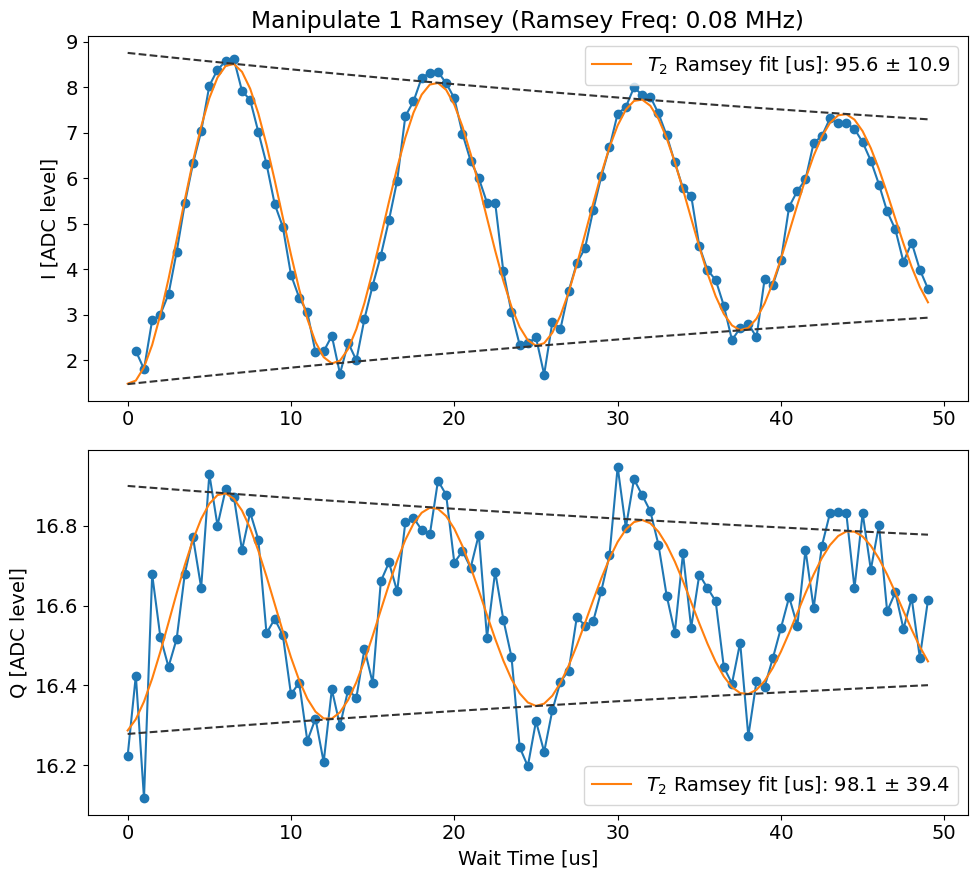

In [1536]:
temp_data, attrs = prev_data(expt_path, '00036_CavityRamseyExperiment.h5')
Ramsey_display(temp_data, attrs, ramsey_freq=attrs['config']['expt']['ramsey_freq'], 
               active_reset=True, threshold=-4.323194812977462, readouts_per_rep=4, initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, fitparams = None, title='Manipulate 1 Ramsey')

In [1537]:
attrs['config']['expt']

{'start': 0,
 'step': 0.5,
 'expts': 101,
 'ramsey_freq': 0.08,
 'reps': 2000,
 'rounds': 1,
 'qubits': [0],
 'checkEF': False,
 'f0g1_cavity': 0,
 'init_gf': False,
 'active_reset': True,
 'man_reset': True,
 'storage_reset': True,
 'user_defined_pulse': [True, 4984.02431625832, 700, 0.15, 0, 4],
 'parity_meas': True,
 'man_idx': 1,
 'manipulate': 0,
 'storage_ramsey': [False, 1],
 'prepulse': False,
 'postpulse': False,
 'pre_sweep_pulse': [[3568.187817769269, 3425.557033831784, 2006.76],
  [9653, 7575, 15000],
  [0, 0, 0.6151067375075144],
  [0, 0, 0],
  [2, 2, 5],
  ['gaussian', 'gaussian', 'flat_top'],
  [0.035, 0.035, 0.005]],
 'post_sweep_pulse': [[3567.9194338546786],
  [50],
  [6.288721018841144],
  [0],
  [2],
  ['flat_top'],
  [0.005]]}

In [1473]:
attrs

{'config': {'prepulse_qubit': {'freq': [3568.184366463191],
   'length': [0.06],
   'gain': [30],
   'phase': [0],
   'repeat_time': 10},
  'device': {'qubit': {'T1': [127.0],
    'f_ge': [3568.187817769269],
    'f_ge_resolved': [3568.187817769269],
    'f_ge_idle': [3568.187817769269],
    'f_ef': [3425.557033831784],
    'f_ef_idle': [3425.557033831784],
    'ramp_sigma': [0.01],
    'ramp_sigma_num': [2],
    'pulses': {'pi_ge': {'gain': [9653], 'sigma': [0.035], 'type': ['gauss']},
     'pi_ge_fast': {'gain': [9653], 'sigma': [0.035], 'type': ['gauss']},
     'pi_ge_resolved': {'gain': [50],
      'sigma': [0.005],
      'length': [6.553697146578866],
      'type': ['flat_top'],
      'repeat_no': [1]},
     'hpi_ge': {'gain': [4930], 'sigma': [0.035], 'type': ['gauss']},
     'hpi_ge_fast': {'gain': [4930], 'sigma': [0.035], 'type': ['gauss']},
     'pi_ef_new': {'gain': [3000],
      'sigma': [0.005],
      'length': [0.146324483174444],
      'type': ['flat_top']},
     'hpi_ef

In [271]:
attrs['config']['expt']

{'start': 0,
 'step': 0.2,
 'expts': 101,
 'ramsey_freq': 0.2,
 'reps': 500,
 'rounds': 1,
 'qubits': [0],
 'checkEF': False,
 'f0g1_cavity': 0,
 'init_gf': False,
 'user_defined_pulse': [True, 4984.02431625832, 300, 0.15, 0, 4],
 'parity_meas': True,
 'manipulate': 1,
 'prepulse': False,
 'postpulse': False,
 'pre_sweep_pulse': [[3568.187817769269, 3425.557033831784, 2006.76, 349.37],
  [9653, 7575, 15000, 5000],
  [0, 0, 0.6151067375075144, 0.5905848097264548],
  [0, 0, 0, 0],
  [2, 2, 5, 1],
  ['gaussian', 'gaussian', 'flat_top', 'flat_top'],
  [0.035, 0.035, 0.005, 0.005]],
 'post_sweep_pulse': [[349.37],
  [5000],
  [0.5905848097264548],
  [0],
  [1],
  ['flat_top'],
  [0.005]]}

#### Multiple Ramseys

486
482
487
483
488
494
480
484
488
489
485
490
486
485
489
491
488
488
488
486
486
487
492
487
486
480
491
481
486
484
486
484
481
485
484
484
491
485
488
489
489
493
482
490
487
490
487
485
482
483
490
487
491
490
486
486
494
484
485
490
485
482
491
486
486
490
488
490
488
490
491
488
490
487
481
487
482
483
487
485
479
485
490
493
483
490
490
489
491
490
487
489
494
494
483
491
492
487
491
484
Current pi pulse frequency: 2006.72
Fit frequency from I [MHz]: 0.08367376646923162 +/- 9.300427223763975e-05
Suggested new pi pulse frequency from fit I [MHz]:
 	2003.7036737664694
 	2003.5363262335309
T2 Ramsey from fit I [us]: 75.37772718039781
Fit frequency from Q [MHz]: 0.08495579673824426 +/- 0.0005329544158254945
Suggested new pi pulse frequencies from fit Q [MHz]:
 	2003.7049557967382
 	2003.5350442032618
T2 Ramsey from fit Q [us]: 84.35314318215403
487
490
490
491
487
484
487
484
487
486
491
486
487
481
491
487
488
493
482
487
495
483
483
484
482
484
486
491
487
488
489
485
491
491
48

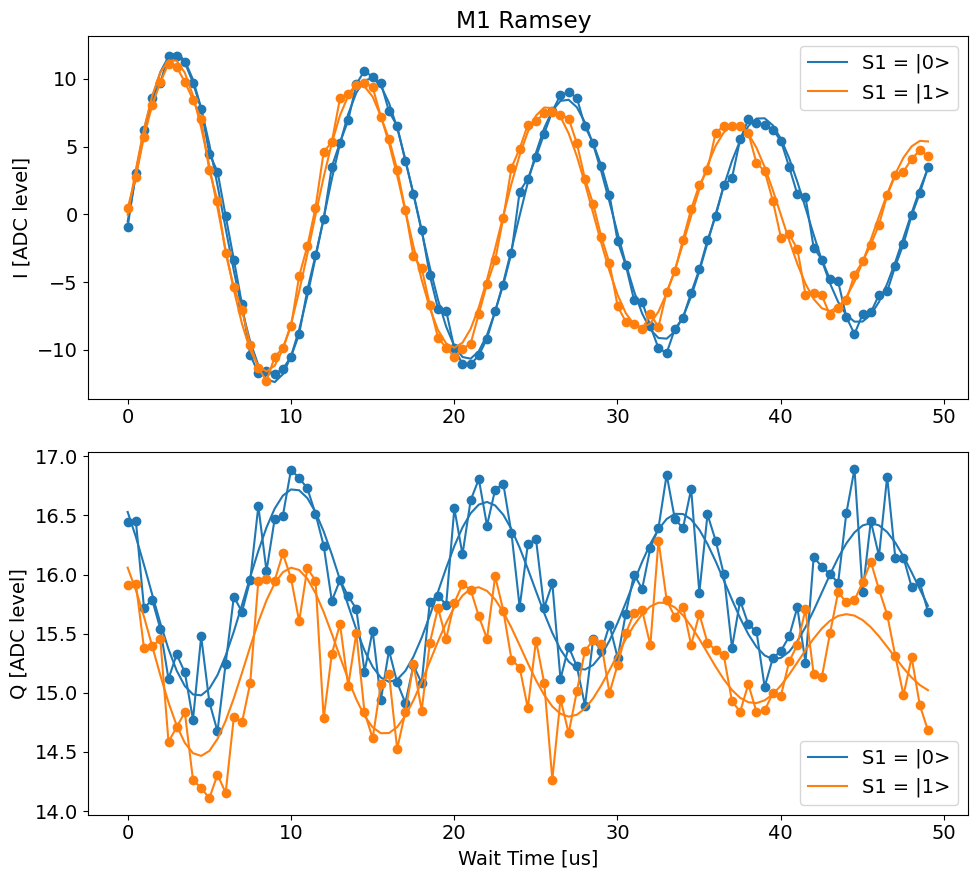

In [1902]:
file_list = np.array([211, 212])
label_list = [f'S1 = |0>', f'S1 = |1>']
color_list = ['tab:blue', 'tab:orange']#, 'tab:green']

temp_data, attrs = prev_data(expt_path, '00211_CavityRamseyExperiment.h5') # just to get configs
multiple_Ramsey_display(file_list, label_list, color_list, active_reset = True, threshold = -4.3, readouts_per_rep = 4,
                         ramsey_freq= attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
                         fitparams = None, #[100, 0.2, 90, 25.0, 8, None],
                           normalize= [False, 'g_data', 'e_data'], title='M1 Ramsey')

In [1895]:
# 0.08703514818486707 +/- 0.00012292906013367717
# 0.08367376646923162 +/- 9.300427223763975e-05
print(0.08367376646923162-0.08703514818486707,'+- ', np.sqrt(0.00012292906013367717**2+9.300427223763975e-05**2))

-0.0033613817156354503 +-  0.00015414716500734688


494
486
491
491
492
493
496
490
484
496
495
494
490
490
494
489
497
496
493
499
496
493
491
494
493
492
493
481
492
492
489
495
496
498
494
492
494
493
490
494
493
499
494
490
488
489
496
493
493
488
498
494
493
494
495
495
491
490
493
492
492
491
498
490
495
497
494
494
494
490
491
492
496
491
495
492
493
488
489
493
494
489
488
491
497
493
486
490
490
494
493
494
497
490
491
490
498
494
487
493
Current pi pulse frequency: 2006.72
Fit frequency from I [MHz]: 0.0834692184894246 +/- 0.00010652576731592861
Suggested new pi pulse frequency from fit I [MHz]:
 	2003.7034692184895
 	2003.5365307815107
T2 Ramsey from fit I [us]: 66.63137679651896
Fit frequency from Q [MHz]: 0.08483910832519373 +/- 0.0012220773279551043
Suggested new pi pulse frequencies from fit Q [MHz]:
 	2003.7048391083251
 	2003.5351608916749
T2 Ramsey from fit Q [us]: 41.64039785114099
491
491
489
487
491
493
487
491
493
487
493
497
495
496
494
496
495
490
491
496
496
499
497
493
491
492
492
487
485
489
492
488
492
487
49

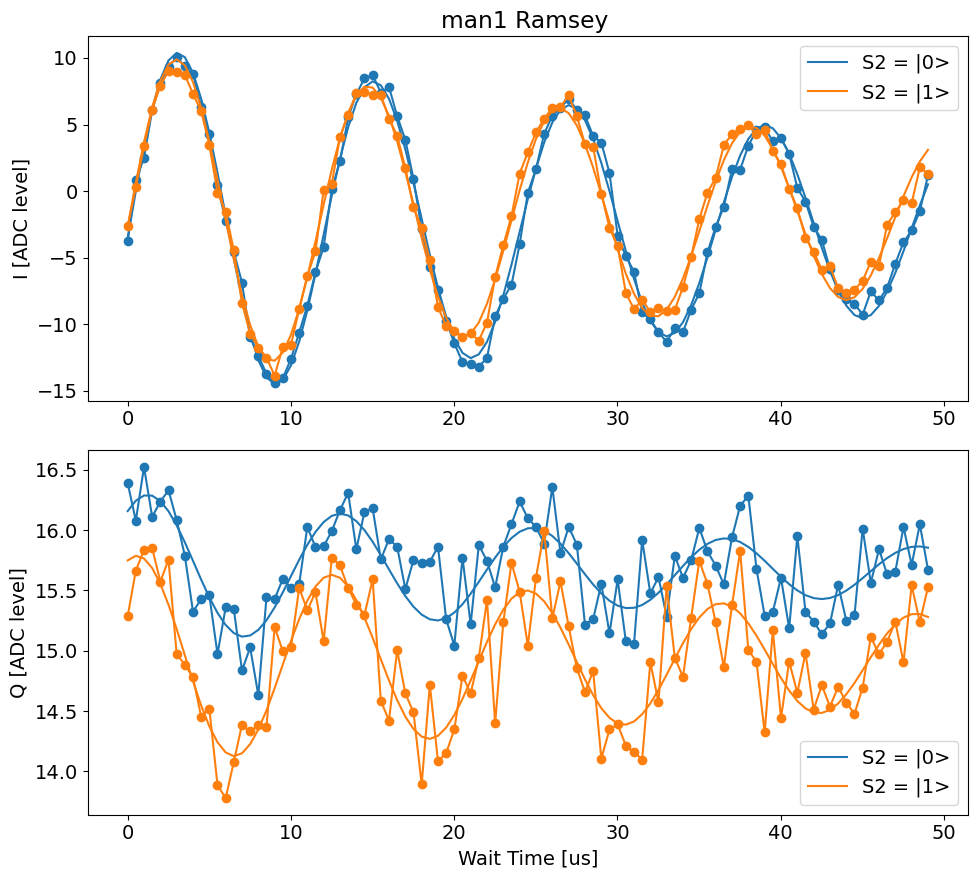

In [1889]:
file_list = np.array([214, 213])
label_list = [f'S2 = |0>', f'S2 = |1>']
color_list = ['tab:blue', 'tab:orange']#, 'tab:green']

temp_data, attrs = prev_data(expt_path, '00214_CavityRamseyExperiment.h5') # just to get configs
multiple_Ramsey_display(file_list, label_list, color_list, active_reset = True, threshold = -4.3, readouts_per_rep = 4,
                         ramsey_freq= attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
                         fitparams = None, #[100, 0.2, 90, 25.0, 8, None],
                           normalize= [False, 'g_data', 'e_data'], title='man1 Ramsey')

In [1896]:
# 0.08530728098653069 +/- 0.00013429209724766624
# 0.0834692184894246 +/- 0.00010652576731592861
print(0.0834692184894246-0.08530728098653069,'+- ', np.sqrt(0.00013429209724766624**2+0.00010652576731592861**2))

-0.0018380624971060938 +-  0.0001714120955050256


494
486
491
491
492
493
496
490
484
496
495
494
490
490
494
489
497
496
493
499
496
493
491
494
493
492
493
481
492
492
489
495
496
498
494
492
494
493
490
494
493
499
494
490
488
489
496
493
493
488
498
494
493
494
495
495
491
490
493
492
492
491
498
490
495
497
494
494
494
490
491
492
496
491
495
492
493
488
489
493
494
489
488
491
497
493
486
490
490
494
493
494
497
490
491
490
498
494
487
493
Current pi pulse frequency: 2006.72
Fit frequency from I [MHz]: 0.0834692184894246 +/- 0.00010652576731592861
Suggested new pi pulse frequency from fit I [MHz]:
 	2003.7034692184895
 	2003.5365307815107
T2 Ramsey from fit I [us]: 66.63137679651896
Fit frequency from Q [MHz]: 0.08483910832519373 +/- 0.0012220773279551043
Suggested new pi pulse frequencies from fit Q [MHz]:
 	2003.7048391083251
 	2003.5351608916749
T2 Ramsey from fit Q [us]: 41.64039785114099
494
490
491
492
492
493
492
490
495
492
486
489
490
490
496
496
494
495
496
494
496
488
489
495
491
490
497
491
488
490
492
488
492
489
48

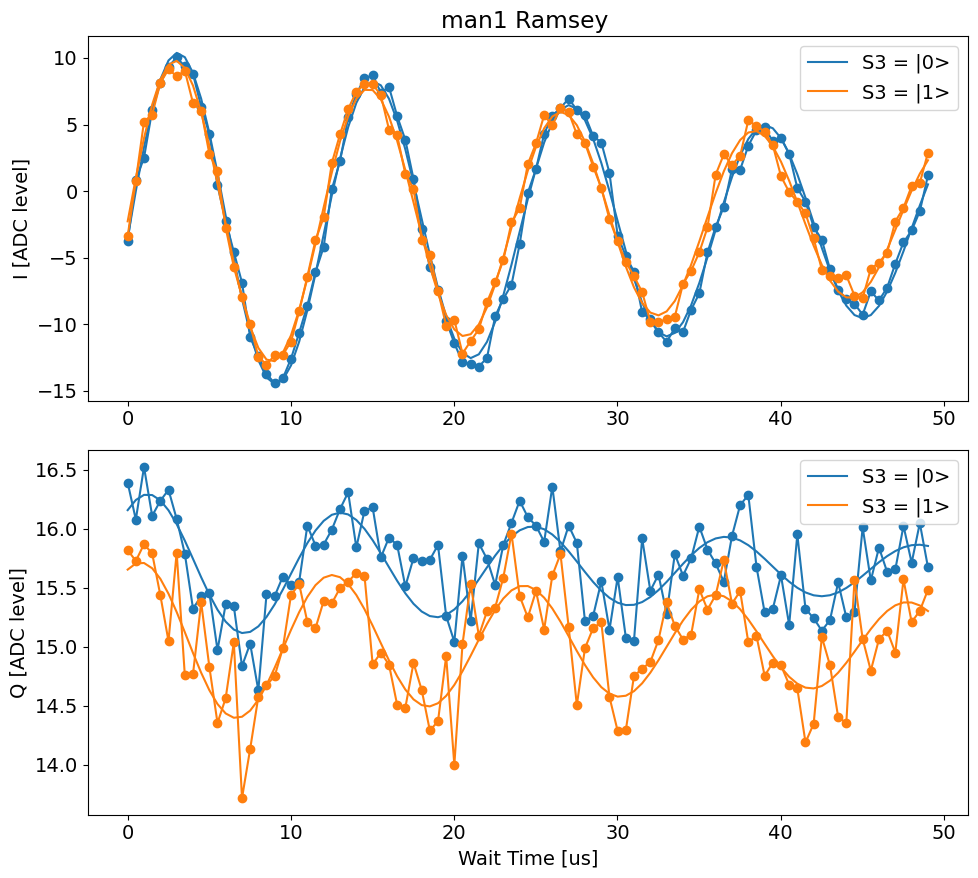

In [1890]:
file_list = np.array([214, 215])
label_list = [f'S3 = |0>', f'S3 = |1>']
color_list = ['tab:blue', 'tab:orange']#, 'tab:green']

temp_data, attrs = prev_data(expt_path, '00214_CavityRamseyExperiment.h5') # just to get configs
multiple_Ramsey_display(file_list, label_list, color_list, active_reset = True, threshold = -4.3, readouts_per_rep = 4,
                         ramsey_freq= attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
                         fitparams = None, #[100, 0.2, 90, 25.0, 8, None],
                           normalize= [False, 'g_data', 'e_data'], title='man1 Ramsey')

In [1897]:
# 0.08466113412005272 +/- 0.00012871659494218798
# 0.0834692184894246 +/- 0.00010652576731592861
print(0.0834692184894246-0.08466113412005272,'+- ', np.sqrt(0.00012871659494218798**2+0.00010652576731592861**2))

-0.001191915630628121 +-  0.00016707992373639227


494
486
491
491
492
493
496
490
484
496
495
494
490
490
494
489
497
496
493
499
496
493
491
494
493
492
493
481
492
492
489
495
496
498
494
492
494
493
490
494
493
499
494
490
488
489
496
493
493
488
498
494
493
494
495
495
491
490
493
492
492
491
498
490
495
497
494
494
494
490
491
492
496
491
495
492
493
488
489
493
494
489
488
491
497
493
486
490
490
494
493
494
497
490
491
490
498
494
487
493
Current pi pulse frequency: 2006.72
Fit frequency from I [MHz]: 0.0834692184894246 +/- 0.00010652576731592861
Suggested new pi pulse frequency from fit I [MHz]:
 	2003.7034692184895
 	2003.5365307815107
T2 Ramsey from fit I [us]: 66.63137679651896
Fit frequency from Q [MHz]: 0.08483910832519373 +/- 0.0012220773279551043
Suggested new pi pulse frequencies from fit Q [MHz]:
 	2003.7048391083251
 	2003.5351608916749
T2 Ramsey from fit Q [us]: 41.64039785114099
495
494
487
490
492
485
489
492
489
489
488
488
492
494
491
494
493
487
488
493
494
488
492
491
492
488
495
486
491
490
487
494
494
490
48

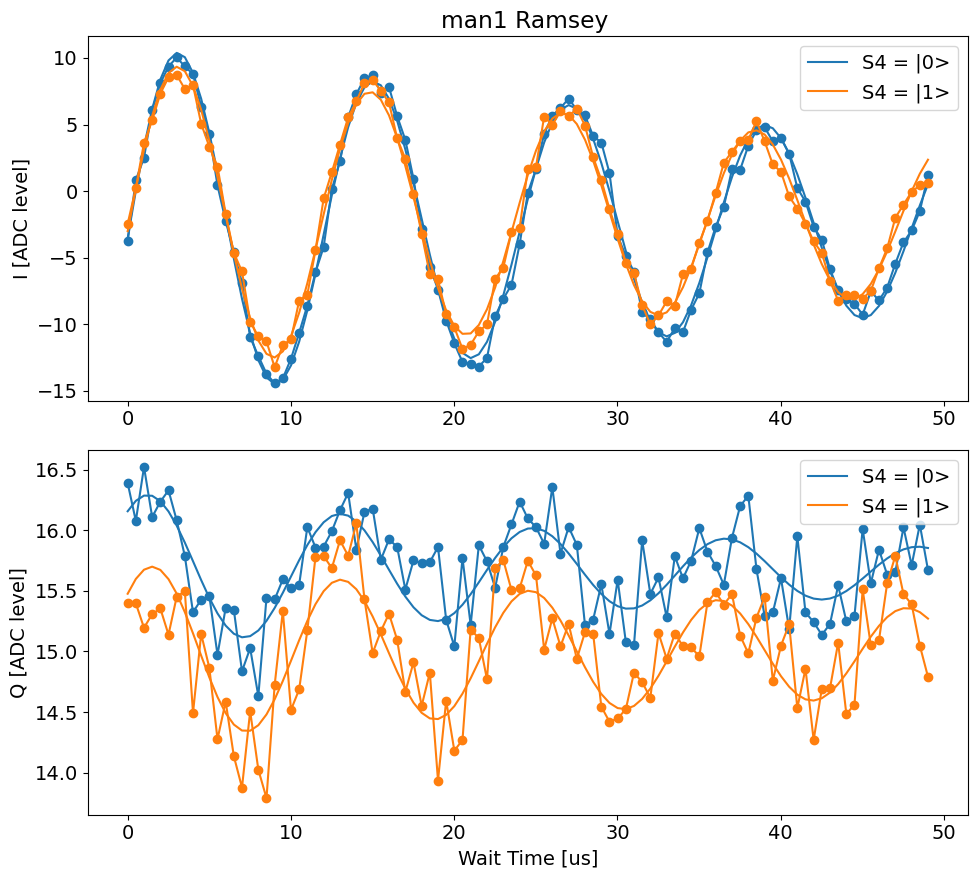

In [1891]:
file_list = np.array([214, 216])
label_list = [f'S4 = |0>', f'S4 = |1>']
color_list = ['tab:blue', 'tab:orange']#, 'tab:green']

temp_data, attrs = prev_data(expt_path, '00214_CavityRamseyExperiment.h5') # just to get configs
multiple_Ramsey_display(file_list, label_list, color_list, active_reset = True, threshold = -4.3, readouts_per_rep = 4,
                         ramsey_freq= attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
                         fitparams = None, #[100, 0.2, 90, 25.0, 8, None],
                           normalize= [False, 'g_data', 'e_data'], title='man1 Ramsey')

In [1898]:
# 0.08481287686069368 +/- 0.00013593828763116576
# 0.0834692184894246 +/- 0.00010652576731592861
print(0.0834692184894246-0.08481287686069368,'+- ', np.sqrt(0.00013593828763116576**2+0.00010652576731592861**2))

-0.0013436583712690825 +-  0.00017270482664459878


494
486
491
491
492
493
496
490
484
496
495
494
490
490
494
489
497
496
493
499
496
493
491
494
493
492
493
481
492
492
489
495
496
498
494
492
494
493
490
494
493
499
494
490
488
489
496
493
493
488
498
494
493
494
495
495
491
490
493
492
492
491
498
490
495
497
494
494
494
490
491
492
496
491
495
492
493
488
489
493
494
489
488
491
497
493
486
490
490
494
493
494
497
490
491
490
498
494
487
493
Current pi pulse frequency: 2006.72
Fit frequency from I [MHz]: 0.0834692184894246 +/- 0.00010652576731592861
Suggested new pi pulse frequency from fit I [MHz]:
 	2003.7034692184895
 	2003.5365307815107
T2 Ramsey from fit I [us]: 66.63137679651896
Fit frequency from Q [MHz]: 0.08483910832519373 +/- 0.0012220773279551043
Suggested new pi pulse frequencies from fit Q [MHz]:
 	2003.7048391083251
 	2003.5351608916749
T2 Ramsey from fit Q [us]: 41.64039785114099
491
487
486
493
488
492
486
494
489
490
486
493
493
493
497
491
491
493
488
492
495
489
493
494
489
491
497
492
489
492
490
484
482
489
49

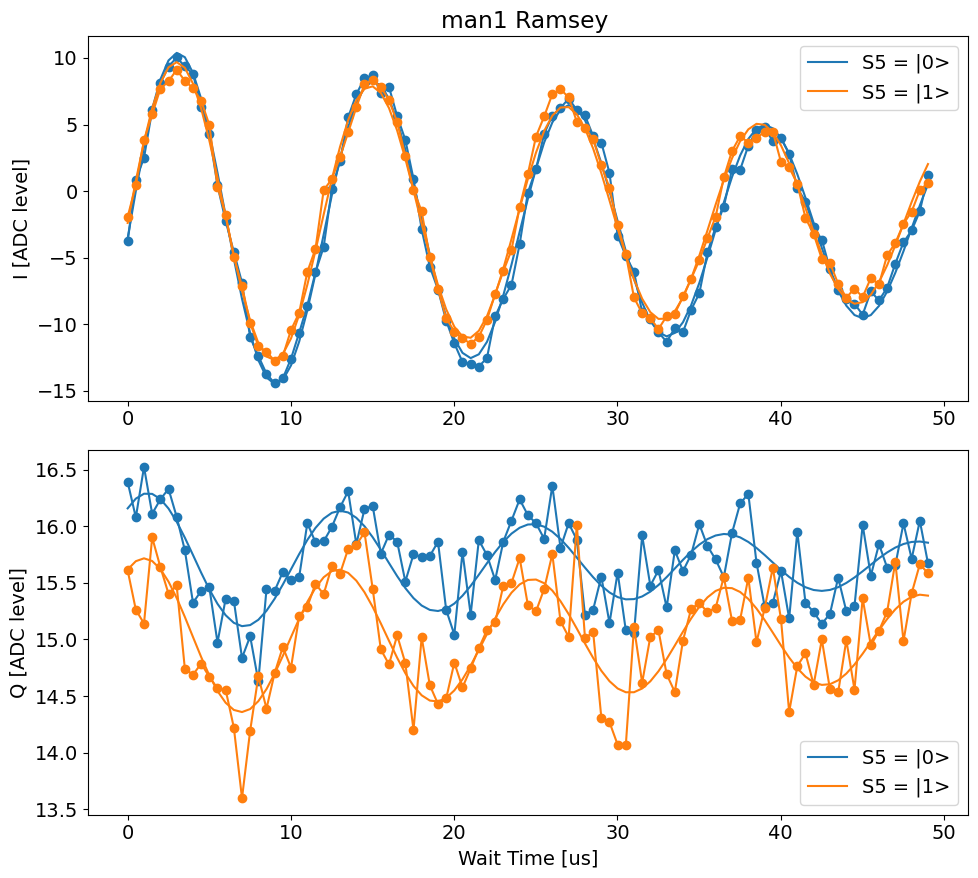

In [1892]:
file_list = np.array([214, 217])
label_list = [f'S5 = |0>', f'S5 = |1>']
color_list = ['tab:blue', 'tab:orange']#, 'tab:green']

temp_data, attrs = prev_data(expt_path, '00214_CavityRamseyExperiment.h5') # just to get configs
multiple_Ramsey_display(file_list, label_list, color_list, active_reset = True, threshold = -4.3, readouts_per_rep = 4,
                         ramsey_freq= attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
                         fitparams = None, #[100, 0.2, 90, 25.0, 8, None],
                           normalize= [False, 'g_data', 'e_data'], title='man1 Ramsey')

In [1899]:
# 0.08406957862366404 +/- 0.0001237734099237037
# 0.0834692184894246 +/- 0.00010652576731592861
print(0.0834692184894246-0.08406957862366404,'+- ', np.sqrt(0.0001237734099237037**2+0.00010652576731592861**2))

-0.0006003601342394471 +-  0.00016330216197708026


494
486
491
491
492
493
496
490
484
496
495
494
490
490
494
489
497
496
493
499
496
493
491
494
493
492
493
481
492
492
489
495
496
498
494
492
494
493
490
494
493
499
494
490
488
489
496
493
493
488
498
494
493
494
495
495
491
490
493
492
492
491
498
490
495
497
494
494
494
490
491
492
496
491
495
492
493
488
489
493
494
489
488
491
497
493
486
490
490
494
493
494
497
490
491
490
498
494
487
493
Current pi pulse frequency: 2006.72
Fit frequency from I [MHz]: 0.0834692184894246 +/- 0.00010652576731592861
Suggested new pi pulse frequency from fit I [MHz]:
 	2003.7034692184895
 	2003.5365307815107
T2 Ramsey from fit I [us]: 66.63137679651896
Fit frequency from Q [MHz]: 0.08483910832519373 +/- 0.0012220773279551043
Suggested new pi pulse frequencies from fit Q [MHz]:
 	2003.7048391083251
 	2003.5351608916749
T2 Ramsey from fit Q [us]: 41.64039785114099
498
497
495
487
490
495
489
489
487
491
487
485
493
491
497
492
494
493
491
489
496
492
497
487
487
487
496
490
487
490
492
493
493
495
48

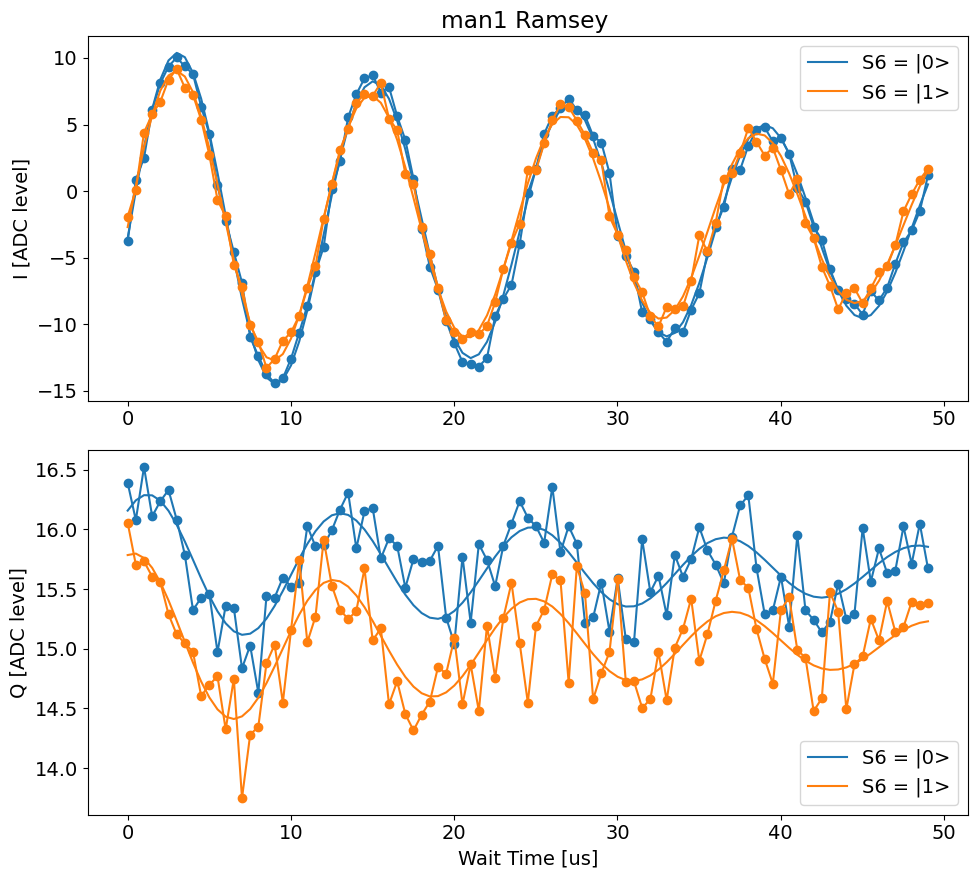

In [1893]:
file_list = np.array([214, 218])
label_list = [f'S6 = |0>', f'S6 = |1>']
color_list = ['tab:blue', 'tab:orange']#, 'tab:green']

temp_data, attrs = prev_data(expt_path, '00214_CavityRamseyExperiment.h5') # just to get configs
multiple_Ramsey_display(file_list, label_list, color_list, active_reset = True, threshold = -4.3, readouts_per_rep = 4,
                         ramsey_freq= attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
                         fitparams = None, #[100, 0.2, 90, 25.0, 8, None],
                           normalize= [False, 'g_data', 'e_data'], title='man1 Ramsey')

In [1900]:
# 0.08418510075769187 +/- 0.00013508753959775828
# 0.0834692184894246 +/- 0.00010652576731592861
print(0.0834692184894246-0.08418510075769187,'+- ', np.sqrt(0.00013508753959775828**2+0.00010652576731592861**2))

-0.0007158822682672705 +-  0.0001720359917483062


494
486
491
491
492
493
496
490
484
496
495
494
490
490
494
489
497
496
493
499
496
493
491
494
493
492
493
481
492
492
489
495
496
498
494
492
494
493
490
494
493
499
494
490
488
489
496
493
493
488
498
494
493
494
495
495
491
490
493
492
492
491
498
490
495
497
494
494
494
490
491
492
496
491
495
492
493
488
489
493
494
489
488
491
497
493
486
490
490
494
493
494
497
490
491
490
498
494
487
493
Current pi pulse frequency: 2006.72
Fit frequency from I [MHz]: 0.0834692184894246 +/- 0.00010652576731592861
Suggested new pi pulse frequency from fit I [MHz]:
 	2003.7034692184895
 	2003.5365307815107
T2 Ramsey from fit I [us]: 66.63137679651896
Fit frequency from Q [MHz]: 0.08483910832519373 +/- 0.0012220773279551043
Suggested new pi pulse frequencies from fit Q [MHz]:
 	2003.7048391083251
 	2003.5351608916749
T2 Ramsey from fit Q [us]: 41.64039785114099
492
491
492
492
490
490
492
490
493
488
494
490
483
492
493
494
495
493
488
492
494
492
489
493
492
493
497
493
496
488
494
487
492
493
48

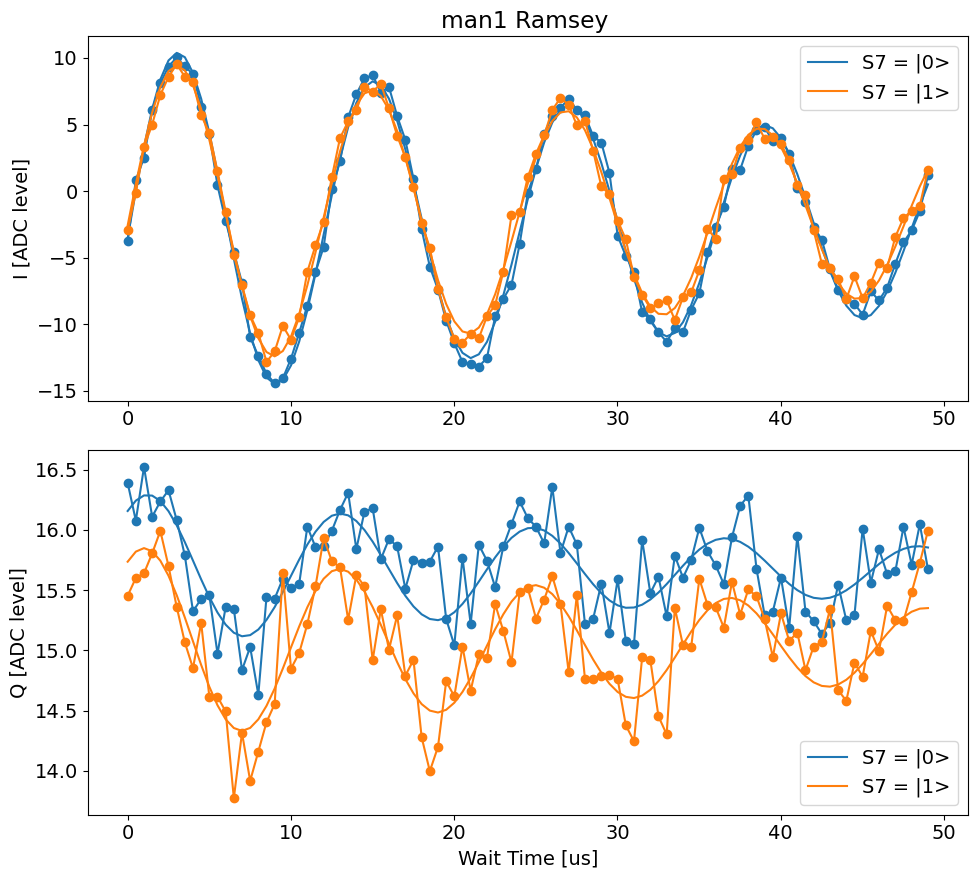

In [1894]:
file_list = np.array([214, 219])
label_list = [f'S7 = |0>', f'S7 = |1>']
color_list = ['tab:blue', 'tab:orange']#, 'tab:green']

temp_data, attrs = prev_data(expt_path, '00214_CavityRamseyExperiment.h5') # just to get configs
multiple_Ramsey_display(file_list, label_list, color_list, active_reset = True, threshold = -4.3, readouts_per_rep = 4,
                         ramsey_freq= attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
                         fitparams = None, #[100, 0.2, 90, 25.0, 8, None],
                           normalize= [False, 'g_data', 'e_data'], title='man1 Ramsey')

In [1901]:
# 0.08399447840232611 +/- 0.00013461139748251912
# 0.0834692184894246 +/- 0.00010652576731592861
print(0.0834692184894246-0.08399447840232611,'+- ', np.sqrt(0.00013461139748251912**2+0.00010652576731592861**2))

-0.0005252599129015184 +-  0.00017166236464188683


#### Man 2 at |1>

Attempted to init fitparam 4 to 8, which is out of bounds 13.905493506493507 to 16.31246103896104. Instead init to 15.108977272727273
Current pi pulse frequency: 4984.026194477733
Fit frequency from I [MHz]: 0.2150399108933675 +/- 0.000554890625770449
Suggested new pi pulse frequency from fit I [MHz]:
 	4984.01115456684
 	4984.441234388626
T2 Ramsey from fit I [us]: 60.76309214793972
Fit frequency from Q [MHz]: 0.21430444742043145 +/- 0.001975342545588561
Suggested new pi pulse frequencies from fit Q [MHz]:
 	4984.011890030312
 	4984.440498925153
T2 Ramsey from fit Q [us]: 10.671227205768293


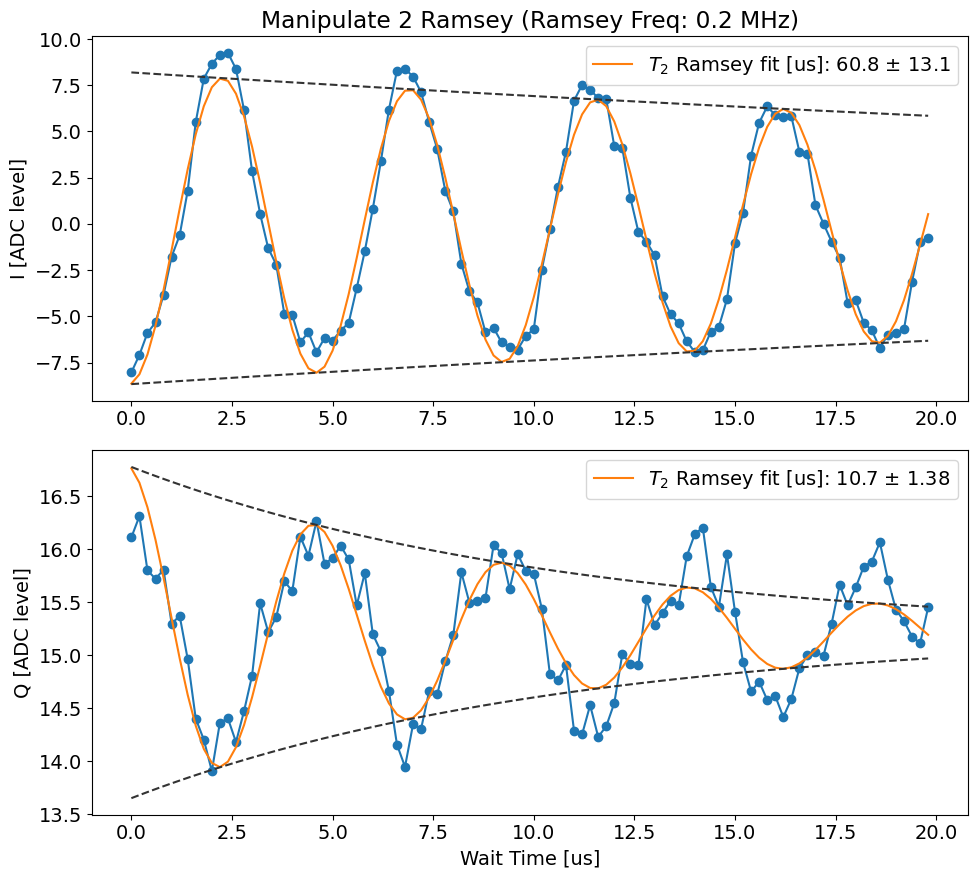

In [434]:
temp_data, attrs = prev_data(expt_path, '00024_CavityRamseyExperiment.h5')
Ramsey_display(temp_data, attrs, ramsey_freq=attrs['config']['expt']['ramsey_freq'], 
               initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
               fitparams =   [20, 0.2, 0, 25.0, 8, None], title='Manipulate 2 Ramsey')

#### stor1 at |1>

1969
1980
1957
1965
1970
1978
1968
1969
1967
1967
1968
1969
1962
1962
1965
1965
1965
1962
1964
1960
1967
1953
1953
1966
1965
1958
1971
1974
1978
1965
1969
1967
1963
1966
1967
1963
1964
1945
1967
1969
1965
1963
1959
1954
1962
1961
1964
1974
1985
1965
1969
1976
1977
1976
1967
1973
1974
1968
1973
1971
1962
1970
1968
1965
1972
1971
1965
1976
1973
1971
1964
1973
1970
1969
1976
1962
1975
1971
1957
1968
1972
1972
1967
1983
1974
1966
1973
1972
1958
1957
1966
1965
1968
1972
1973
1976
1956
1974
1975
1970
Attempted to init fitparam 4 to 8, which is out of bounds 0.7247277505325538 to 7.62827066280596. Instead init to 4.176499206669257
Attempted to init fitparam 4 to 4.176499206669257, which is out of bounds 15.41072833019398 to 16.460059990770652. Instead init to 15.935394160482316
Attempted to init fitparam 4 to 15.935394160482316, which is out of bounds 16.409094933010326 to 18.165637489472072. Instead init to 17.2873662112412
Current pi pulse frequency: 4984.02431625832
Fit frequency from I [M

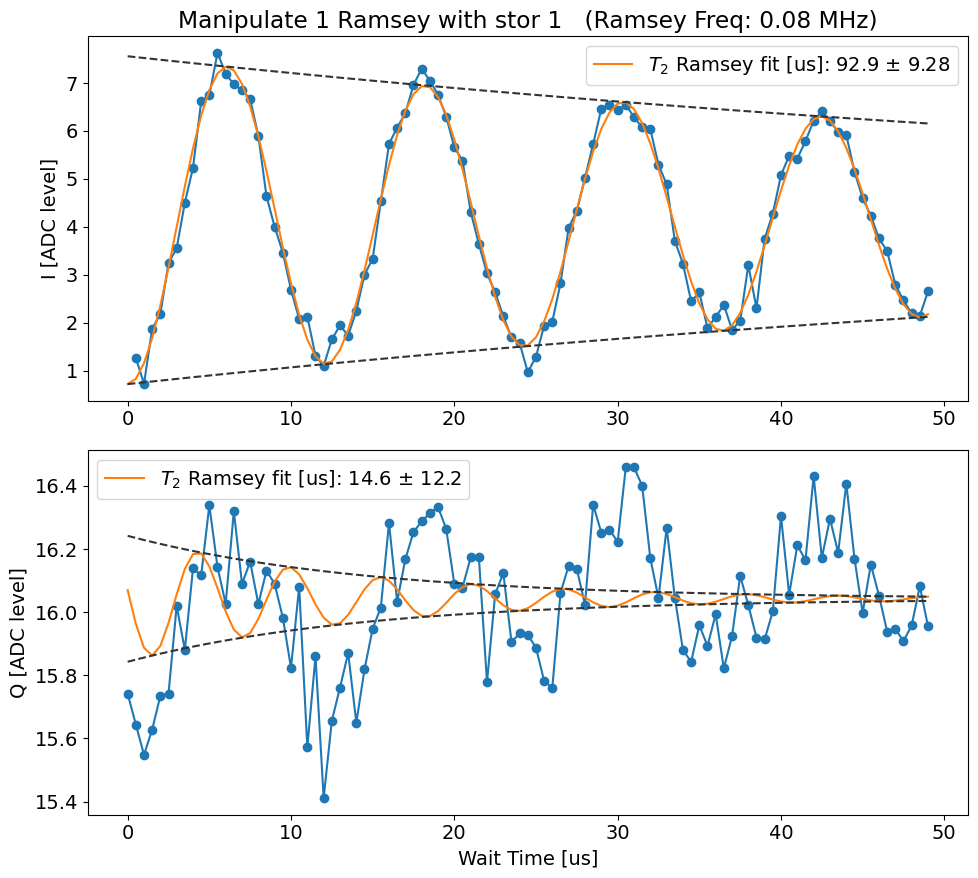

In [1539]:
temp_data, attrs = prev_data(expt_path, '00040_CavityRamseyExperiment.h5')
Ramsey_display(temp_data,attrs,  ramsey_freq=attrs['config']['expt']['ramsey_freq'], 
               active_reset=True, threshold=-4.323194812977462, readouts_per_rep=4,
               initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
               fitparams =   [4, 0.2, 90, 25.0, 8, None], title='Manipulate 1 Ramsey with stor 1  ')

### Sweep for Kerr

In [2587]:
2/ (0.00031099 * 3 )

2143.6916513928636

Gain to alpha: 0.00093297


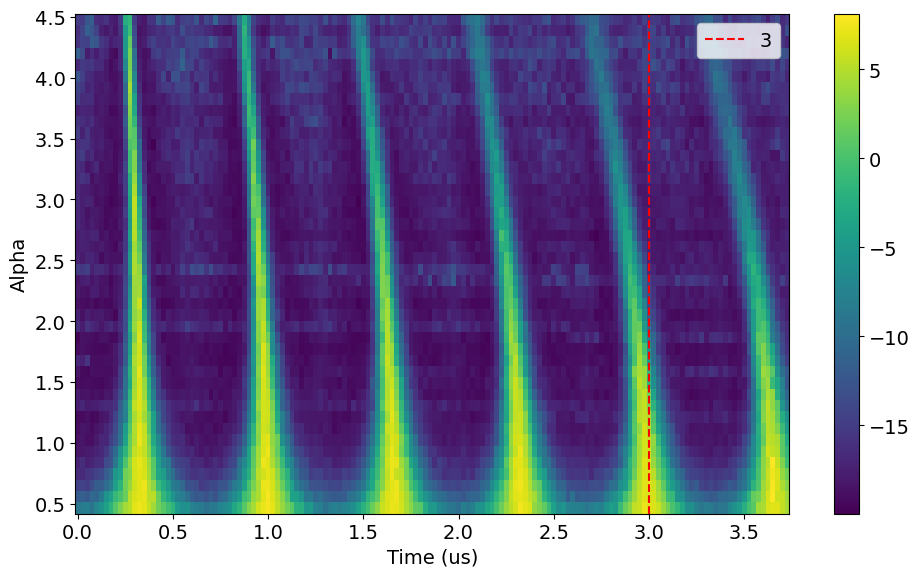

In [154]:
file_list = np.arange(554,598,1)
y_list = []
gain_list = []
name = '_cavity_ramsey_sweep.h5'
data_list = []
attrs_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    data_list.append(temp_data)
    attrs_list.append(attrs)
    gain_list.append(attrs['config']['expt']['user_defined_pulse'][2])

gain_to_alpha = 0.00031099 * 3 # attrs['config']['device']['manipulate']['gain_to_alpha'][0] * 3
alpha_list = np.array(gain_list)*gain_to_alpha
print('Gain to alpha:', gain_to_alpha)  

xlist, ylist, zlist = plot_ramsey_sideband(data_list, attrs_list, y_list = alpha_list, active_reset=True, threshold=-4.323194812977462, readouts_per_rep=4, 
                                           vlines = [3])

In [2464]:
attrs['config']['expt']['user_defined_pulse']

[True, 4984.026194477733, 4800, 0.15, 0, 4]

In [2463]:
attrs['config']['device']['manipulate']['gain_to_alpha'][0]

0.00014572

In [2468]:
import numpy as np
from scipy.optimize import minimize

idx_list = np.arange(0, len(ylist), 1)
freqs = []
alpha_list_ = []
t0s = []
alpha_list = ylist

for idx in idx_list:

# parameters for the model
# idx = 15
# pr
# int(f'Alpha: {alpha_list[idx]}')
#choose the ydata 
    ydata = zlist[idx]
    tlist = xlist
    omega = 0.5 * 2 *np.pi # MHz 
    alpha = alpha_list[idx]
    print(f'Alpha: {alpha_list[idx]}')

    args = {'alpha': alpha, 'omega': omega, 't0': 0.3}


    def small_angle_approx_P0(t, args): 
        return np.exp(-2* np.abs(args['alpha'])**2 * (1 - np.cos(args['omega'] * (t + args['t0']))) )




    #rescale data to be between 0 and 1
    min_value_model = np.exp(-2*2* np.abs(alpha)**2)
    ydata_scaled = (ydata - min(ydata))/(max(ydata) - min(ydata))

    # Map the scaled data to have min value of min_value_model and max value of 1
    min_value_model = np.exp(-2*2* np.abs(alpha)**2)
    ydata_final = ydata_scaled * (1 - min_value_model) + min_value_model




    # rescale data between 1 and min value

    # invert data
    # ydata = 1 - ydata
    # rescale data to have max value of max(ws)
    # ydata = ydata * max(ws)

    # Objective function to fit data to wigner function curve 
    def objective(param):

        args['omega'] = param[0]
        args['t0'] = param[1]
        ws = small_angle_approx_P0(tlist, args)

        return np.sum(np.abs(ws - ydata_final))  # sum of absolute differences

    # Initial guess for start and end of alpha_list
    initial_guess = [1.5 * 2 * np.pi, 0.4]

    # Bounds for start and end values of alpha_list
    bounds = [(1 * 2 * np.pi, 2 * 2 * np.pi), (0, 1)]

    # Run the optimizer
    result = minimize(objective, initial_guess, bounds=bounds, tol=1e-5, options={'disp': True}) #, method = 'BFGS')

    # store all params
    freqs.append(result.x[0])
    t0s.append(result.x[1])
    alpha_list_.append(alpha_list[idx])

# plt.plot(tlist, ydata, 'o', label='Data')
# plt.plot(tlist, small_angle_approx_P0(tlist, args), label='Model')
# print(result.x)

Alpha: 0.466485
Alpha: 0.559782
Alpha: 0.653079
Alpha: 0.7463759999999999
Alpha: 0.839673
Alpha: 0.93297
Alpha: 1.026267
Alpha: 1.119564
Alpha: 1.212861
Alpha: 1.306158
Alpha: 1.399455
Alpha: 1.4927519999999999
Alpha: 1.586049
Alpha: 1.679346
Alpha: 1.772643
Alpha: 1.86594
Alpha: 1.959237
Alpha: 2.052534
Alpha: 2.145831
Alpha: 2.239128
Alpha: 2.3324249999999997
Alpha: 2.425722
Alpha: 2.519019
Alpha: 2.612316
Alpha: 2.705613
Alpha: 2.79891
Alpha: 2.892207
Alpha: 2.9855039999999997
Alpha: 3.078801
Alpha: 3.172098
Alpha: 3.265395
Alpha: 3.358692
Alpha: 3.4519889999999998
Alpha: 3.545286
Alpha: 3.638583
Alpha: 3.73188
Alpha: 3.825177
Alpha: 3.918474
Alpha: 4.0117709999999995
Alpha: 4.105068
Alpha: 4.198365
Alpha: 4.291662
Alpha: 4.384959
Alpha: 4.478256


Slope: 0.007050603137578685
Man 1 Slope: 7.05060 +/- 0.16731kHz


Text(0, 0.5, 'Ramsey Frequency (MHz)')

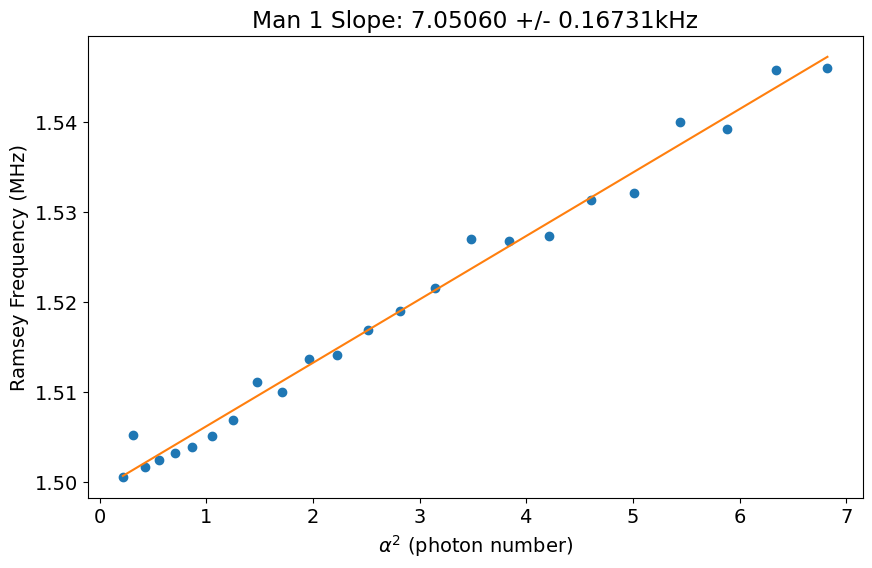

In [2471]:
from scipy import stats
idx_skip =None
idx_end = -20
plt.plot([alpha **2 for alpha in alpha_list_[idx_skip:idx_end]], np.array(freqs[idx_skip: idx_end])/(2*np.pi), 'o', label='Data')

x = [alpha **2 for alpha in alpha_list_[idx_skip:idx_end]]
y = np.array(freqs[idx_skip: idx_end])/(2*np.pi)
slope, intercept, r_value, p_value, std_err = stats.linregress(x, y)

print(f"Slope: {slope}")
plt.plot(x, [slope * x_ + intercept for x_ in x], label='Fit')
# put slope in title (round to 5 decimal places)
plt.title(f'Man 1 Slope: {slope * 1e+3:.5f} +/- {std_err * 1e+3:.5f}kHz')
# print the title 
print(f'Man 1 Slope: {slope * 1e+3:.5f} +/- {std_err * 1e+3:.5f}kHz')
plt.xlabel(r'$\alpha^2$ (photon number)')
plt.ylabel('Ramsey Frequency (MHz)')

[9.79625726 0.29640821]
freq: 1.5591227674164476


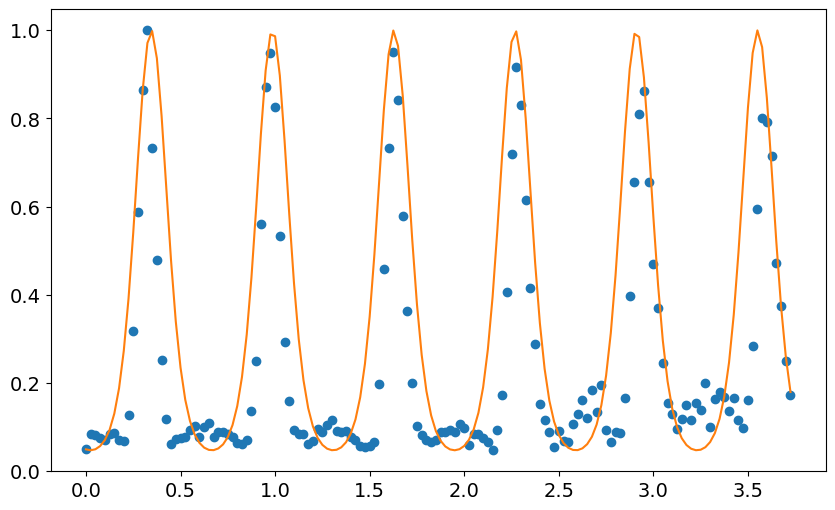

In [2462]:
idx_list = np.arange(0, len(ylist), 1)
freqs = []
alpha_list_ = []
t0s = []
alpha_list = ylist

# for idx in idx_list:

# parameters for the model
idx = 15
# pr
# int(f'Alpha: {alpha_list[idx]}')
#choose the ydata 
ydata = zlist[idx]
tlist = xlist
omega = 0.5 * 2 *np.pi # MHz 
alpha = alpha_list[idx]

args = {'alpha': alpha, 'omega': omega, 't0': 0.3}


def small_angle_approx_P0(t, args): 
    return np.exp(-2* np.abs(args['alpha'])**2 * (1 - np.cos(args['omega'] * (t + args['t0']))) )



#rescale data to be between 0 and 1
min_value_model = np.exp(-2*2* np.abs(alpha)**2)
ydata_scaled = (ydata - min(ydata))/(max(ydata) - min(ydata))

# Map the scaled data to have min value of min_value_model and max value of 1
min_value_model = np.exp(-2*2* np.abs(alpha)**2)
ydata_final = ydata_scaled * (1 - min_value_model) + min_value_model




# rescale data between 1 and min value

# invert data
# ydata = 1 - ydata
# rescale data to have max value of max(ws)
# ydata = ydata * max(ws)

# Objective function to fit data to wigner function curve 
def objective(param):

    args['omega'] = param[0]
    args['t0'] = param[1]
    ws = small_angle_approx_P0(tlist, args)

    return np.sum(np.abs(ws - ydata_final))  # sum of absolute differences

# Initial guess for start and end of alpha_list
initial_guess = [1.5 * 2 * np.pi, 0.4]

# Bounds for start and end values of alpha_list
bounds = [(1 * 2 * np.pi, 2 * 2 * np.pi), (0, 1)]

# Run the optimizer
result = minimize(objective, initial_guess, bounds=bounds, tol=1e-5, options={'disp': True}) #, method = 'BFGS')

# store all params
freqs.append(result.x[0])
t0s.append(result.x[1])
alpha_list_.append(alpha_list[idx])

plt.plot(tlist, ydata_final, 'o', label='Data')
args['omega'] = result.x[0]
args['t0'] = result.x[1]
plt.plot(tlist, small_angle_approx_P0(tlist, args), label='Model')
print(result.x)
print('freq:', result.x[0]/(2*np.pi))

In [2438]:
result.x[0]/2/np.pi

2.0

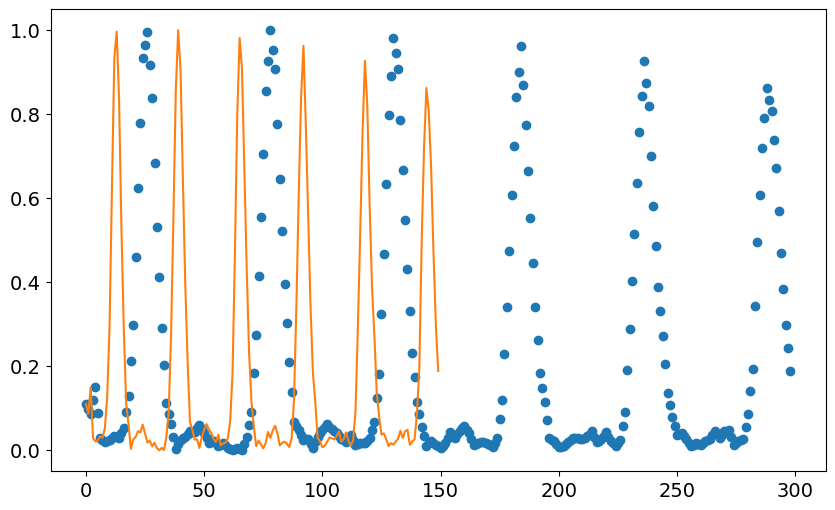

In [2434]:
new_y_data = []
for idx in range(len(ydata) - 1):
    new_y_data.append(ydata[idx])
    new_y_data.append((ydata[idx] + ydata[idx + 1]) / 2)
new_y_data.append(ydata[-1])  # Append the last point

# Convert new_y_data to a numpy array for further processing if needed
new_y_data = np.array(new_y_data)

# Print the new interpolated data
plt.plot(new_y_data, 'o', label='Interpolated Data')
plt.plot(ydata, label='Model')

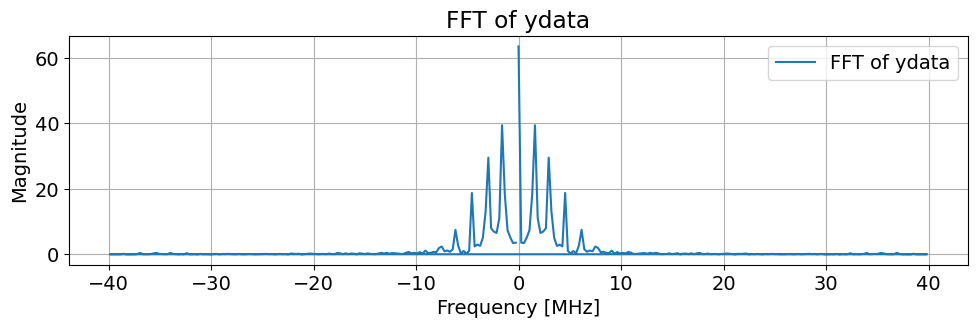

In [2435]:
# Perform FFT on ydata
ydata_fft = np.fft.fft(new_y_data)
freqs_fft = np.fft.fftfreq(len(new_y_data), d=(tlist[1] - tlist[0])/2)

# Plot the FFT magnitude spectrum
plt.subplot(2, 1, 2)
plt.plot(freqs_fft, np.abs(ydata_fft), label='FFT of ydata')
plt.xlabel('Frequency [MHz]')
plt.ylabel('Magnitude')
plt.legend()
plt.title('FFT of ydata')
plt.grid(True)

plt.tight_layout()
plt.show()


In [2436]:
# find the frequency correspond to the peaks
# Find the peak frequency
peak_freqs = freqs_fft[np.argsort(np.abs(ydata_fft))[::-1][:2]]
peak_freqs

array([0.        , 1.60535117])

### Sweep

In [425]:
# def plot_sideband_sweep(x_timelist, y_freqlist, z_datalist, hlines=None, vlines=None, normalize = None, title="Sideband Sweep", xlabel = None, ylabel = None):
#     plt.figure(figsize = (15,6))
#     plt.subplot(111,xlabel=xlabel,ylabel=ylabel)
#     plt.title(title)
#     cax = plt.pcolormesh(x_timelist,y_freqlist[:z_datalist.shape[0]],z_datalist)
#     cbar = plt.colorbar()



#     if vlines is not None:
#         for vline in vlines:
#             plt.axvline(vline, color='r', ls='--', label = str(vline))
#     if hlines is not None:
#         for hline in hlines:
#             plt.axhline(hline, color='r', ls='--', label = str(hline))
#     plt.legend()
#     plt.tight_layout()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Gain to alpha: 0.00043716


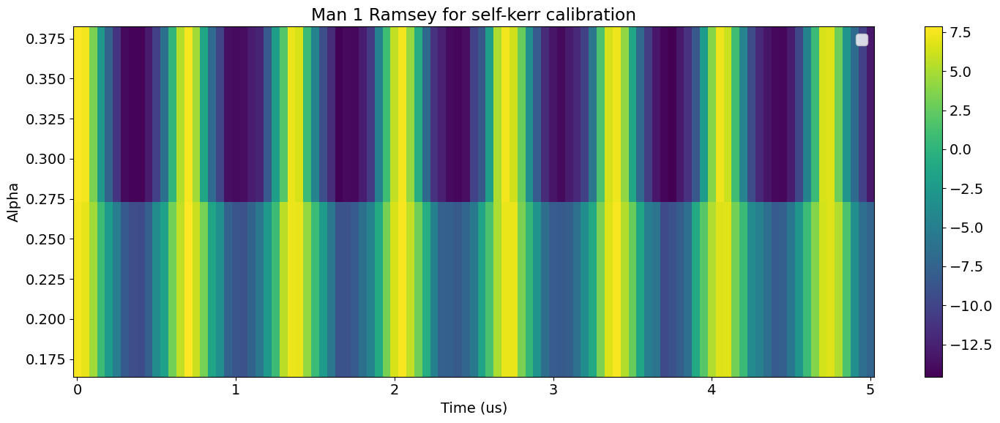

In [2328]:
file_list = np.arange(530,523,1)
y_list = []
freq_list = []
name = '_cavity_ramsey_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['user_defined_pulse'][2])

gain_to_alpha = attrs['config']['device']['manipulate']['gain_to_alpha'][0] * 3
alpha_list = np.array(freq_list)*gain_to_alpha
print('Gain to alpha:', gain_to_alpha)  

plot_sideband_sweep(len_x, alpha_list, np.array(y_list), hlines=[], vlines=None, title="Man 1 Ramsey for self-kerr calibration", xlabel='Time (us)', ylabel='Alpha')
    

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Gain to alpha: 0.00043716
496
496
494
495
492
492
497
497
490
490
496
494
493
499
499
496
494
497
497
493
495
495
496
490
497
495
495
494
496
496
493
492
493
494
494
496
499
496
498
498
496
495
493
493
493
493
492
494
495
494
495
495
496
494
495
498
496
495
490
497
496
489
494
495
495
498
498
496
496
496
495
492
499
495
499
494
494
497
494
494
498
498
495
495
494
496
495
488
495
494
495
494
492
495
495
498
495
496
495
491
497
498
496
494
492
494
491
489
491
495
494
496
495
496
496
497
494
495
491
496
495
493
493
496
497
493
496
495
495
493
497
496
490
491
492
491
495
495
496
493
498
497
497
496
494
492
497
490
494
495
495
492
491
496
493
498
495
493
495
490
495
495
498
494
497
489
497
496
497
492
495
491
494
496
496
493
495
495
495
496
494
495
495
496
493
497
492
486
496
493
495
492
494
496
494
496
495
499
494
493


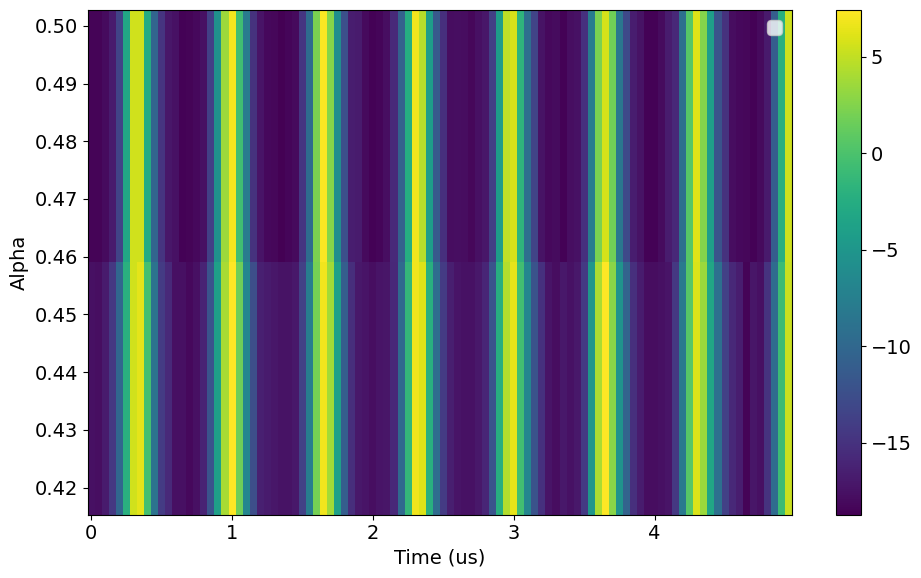

In [2363]:
file_list = np.arange(530,532,1)
y_list = []
gain_list = []
name = '_cavity_ramsey_sweep.h5'
data_list = []
attrs_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    data_list.append(temp_data)
    attrs_list.append(attrs)
    gain_list.append(attrs['config']['expt']['user_defined_pulse'][2])

gain_to_alpha = attrs['config']['device']['manipulate']['gain_to_alpha'][0] * 3
alpha_list = np.array(gain_list)*gain_to_alpha
print('Gain to alpha:', gain_to_alpha)  

plot_ramsey_sideband(data_list, attrs_list, y_list = alpha_list, active_reset=True, threshold=-4.323194812977462, readouts_per_rep=4)

In [2351]:
1/gain_to_alpha

2287.491993778022

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Gain to alpha: 0.00043716


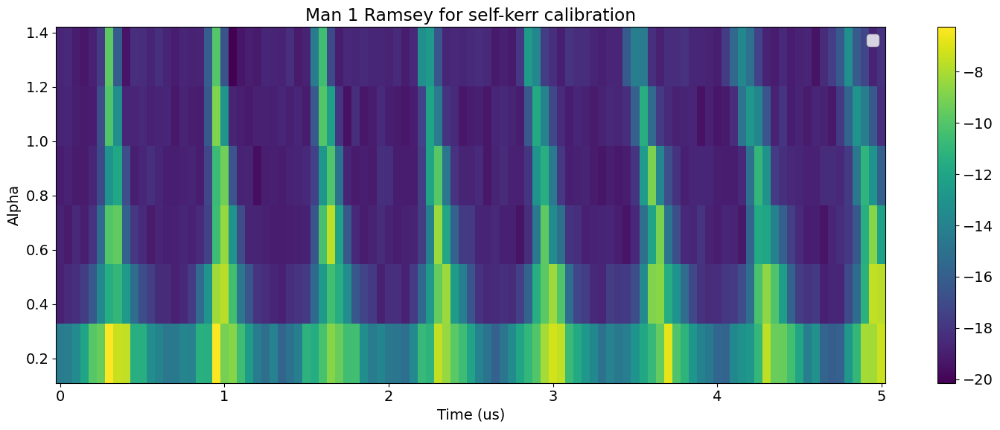

In [2104]:
file_list = np.arange(495,501,1)
y_list = []
freq_list = []
name = '_cavity_ramsey_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['user_defined_pulse'][2])

gain_to_alpha = attrs['config']['device']['manipulate']['gain_to_alpha'][0] * 3
alpha_list = np.array(freq_list)*gain_to_alpha
print('Gain to alpha:', gain_to_alpha)  

plot_sideband_sweep(len_x, alpha_list, np.array(y_list), hlines=[], vlines=None, title="Man 1 Ramsey for self-kerr calibration", xlabel='Time (us)', ylabel='Alpha')
    

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Gain to alpha: 0.00043716


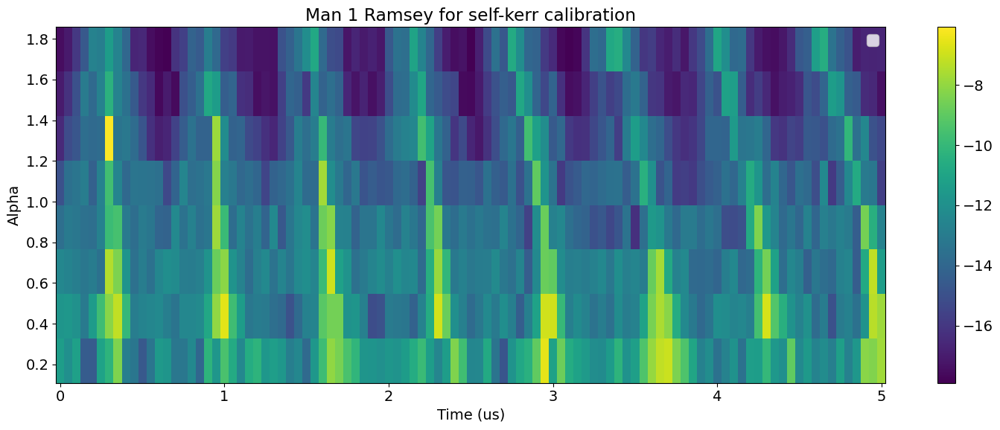

In [2090]:
file_list = np.arange(486,494,1)
y_list = []
freq_list = []
name = '_cavity_ramsey_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['user_defined_pulse'][2])

gain_to_alpha = attrs['config']['device']['manipulate']['gain_to_alpha'][0] * 3
alpha_list = np.array(freq_list)*gain_to_alpha
print('Gain to alpha:', gain_to_alpha)  

plot_sideband_sweep(len_x, alpha_list, np.array(y_list), hlines=[], vlines=None, title="Man 1 Ramsey for self-kerr calibration", xlabel='Time (us)', ylabel='Alpha')
    

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Gain to alpha: 0.00045477


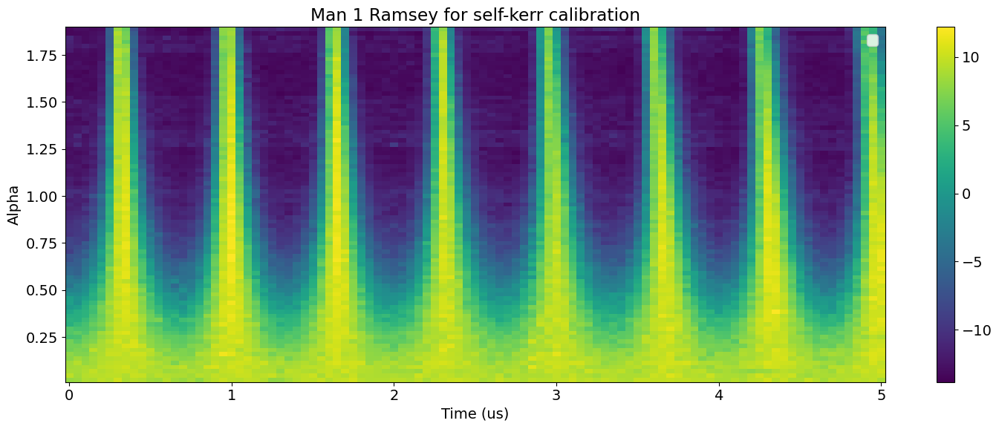

In [443]:
file_list = np.arange(378,461,1)
y_list = []
freq_list = []
name = '_cavity_ramsey_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['user_defined_pulse'][2])

gain_to_alpha = attrs['config']['device']['manipulate']['gain_to_alpha'][0] * 3
alpha_list = np.array(freq_list)*gain_to_alpha
print('Gain to alpha:', gain_to_alpha)  

plot_sideband_sweep(len_x, alpha_list, np.array(y_list), hlines=[], vlines=None, title="Man 1 Ramsey for self-kerr calibration", xlabel='Time (us)', ylabel='Alpha')
    

In [2466]:
temp_data, attrs = prev_data(expt_path, '00460_cavity_ramsey_sweep.h5')
attrs['config']['expt']

{'start': 0,
 'step': 0.05,
 'expts': 101,
 'ramsey_freq': 1.5,
 'reps': 500,
 'rounds': 1,
 'qubits': [0],
 'checkEF': False,
 'f0g1_cavity': 0,
 'init_gf': False,
 'user_defined_pulse': [True, 4984.026194477733, 4150, 0.15, 0, 4],
 'parity_meas': False,
 'manipulate': 1,
 'prepulse': False,
 'postpulse': True,
 'pre_sweep_pulse': [[3568.1782381859975, 3425.559887601728, 0],
  [13639, 10338, 0],
  [0, 0, 0.01],
  [0, 0, 0],
  [2, 2, 5],
  ['gaussian', 'gaussian', 'flat_top'],
  [0.025, 0.025, 0.005]],
 'post_sweep_pulse': [[3568.184366463191],
  [50],
  [6.504911065860095],
  [0],
  [2],
  ['flat_top'],
  [0.005]]}

In [409]:
len(alpha_list)

77

In [369]:
import numpy as np
from scipy.optimize import minimize

# parameters for the model
idx = 30
print(f'Alpha: {alpha_list[idx]}')
#choose the ydata 
ydata = y_list[idx]
tlist = len_x
omega = 0.5 * 2 *np.pi # MHz 
alpha = alpha_list[idx]

args = {'alpha': alpha, 'omega': omega, 'phase': 0, 'n_max': 20, 'kerr': 0.002 * 2 * np.pi}


def P_0(t, args):
    alpha = args['alpha']
    omega = args['omega']
    phase = args['phase']
    n_max = args['n_max']
    kerr = args['kerr']
    return np.abs(np.exp(-np.abs(alpha)**2) *
                    np.sum([np.abs(alpha)**(2*n)/math.factorial(n) * np.exp(-1j * (-1 * kerr/2* n**2 + omega *n)  * (t + phase) ) for n in range(0, n_max)])
                    )**2

def ramsey_plot(tlist, args):
    P0_list = [P_0(t, args) for t in tlist]
    return P0_list



#rescale data to be between 0 and 1
ydata = (ydata - min(ydata))/(max(ydata) - min(ydata)) * 0.993
# invert data
# ydata = 1 - ydata
# rescale data to have max value of max(ws)
# ydata = ydata * max(ws)

# Objective function to fit data to wigner function curve 
def objective(param):
    kerr = param[0]
    phase = param[1] # t_offset

    args['kerr'] = kerr
    args['phase'] = phase
    ws = ramsey_plot(tlist, args)
    # print('gain_to_alpha:', gain_to_alpha)
    # print('objective:', np.sum(np.abs(ws - ydata)))
    # print('-----------------------------------')
    return np.sum(np.abs(ws - ydata))  # sum of absolute differences

# Initial guess for start and end of alpha_list
initial_guess = [0.002 * 2 * np.pi, 1.2]

# Bounds for start and end values of alpha_list
bounds = [(0, 0.050 * 2 * np.pi), (0, 1.5)]

# Run the optimizer
result = minimize(objective, initial_guess, bounds=bounds, tol=1e-5, options={'disp': True}) #, method = 'BFGS')

Alpha: 0.7048935000000001


In [370]:
result

  message: CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH
  success: True
   status: 0
      fun: 34.4279202051732
        x: [ 3.142e-01  1.473e+00]
      nit: 4
      jac: [-9.266e+00  2.584e-01]
     nfev: 30
     njev: 10
 hess_inv: <2x2 LbfgsInvHessProduct with dtype=float64>

Text(0.5, 1.0, 'Kerr: 0.00000000')

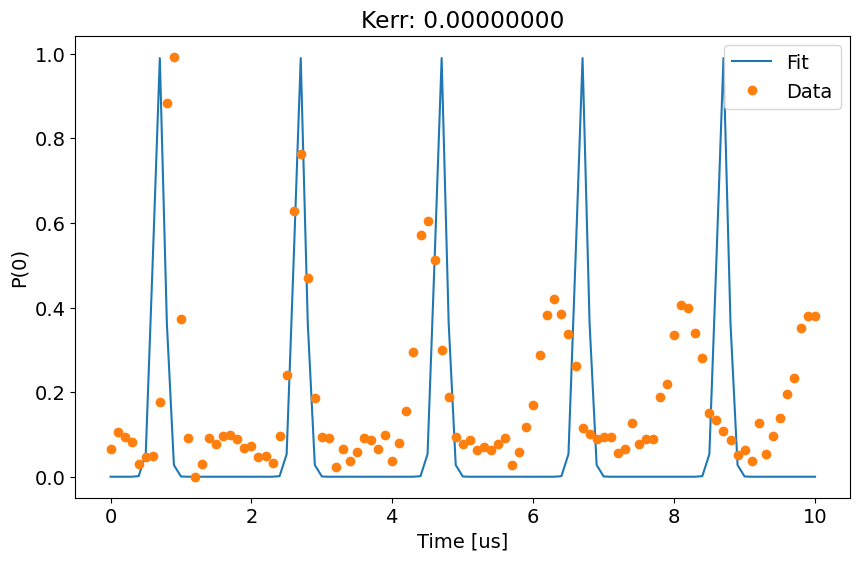

In [944]:
# plot the result 
args['kerr'] = result.x[0]
args['phase'] = result.x[1]

plt.plot(tlist, ramsey_plot(tlist, args), '-', label='Fit')
plt.plot(tlist, ydata, 'o', label='Data')

#label axes
plt.xlabel(r'Time [us]')
plt.ylabel(r'P(0)')
plt.legend()
plt.title('Kerr: {:.8f}'.format(args['kerr']/(2*np.pi)))
#gain_to_alpha = 0.00030837
# print('Conversion factor: {:.8f}'.format(gain_to_alpha))
# print('alpha = 1 requires gain of : {:.8f}'.format(1/gain_to_alpha))

Text(0, 0.5, 'P(0)')

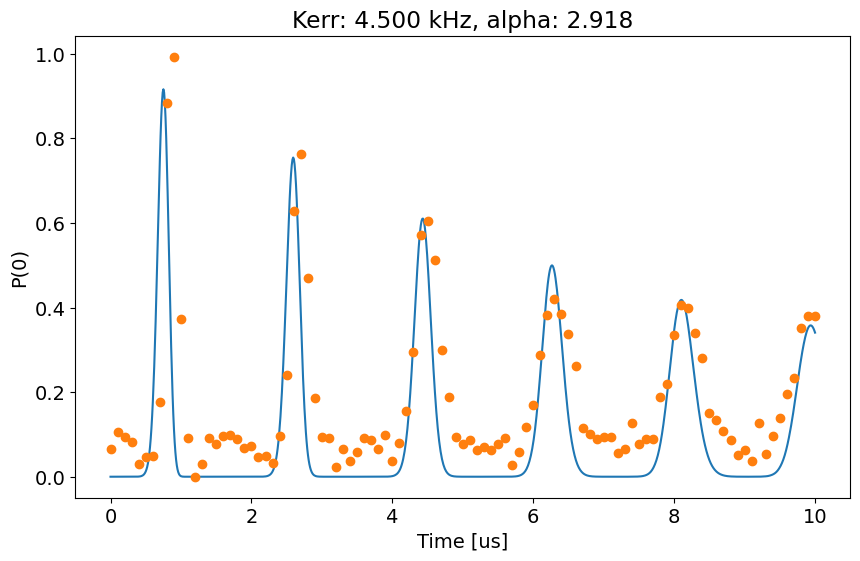

In [959]:
args['kerr'] = 0.0045* 2* np.pi#result.x[0]
args['phase'] = 1.1   # |#result.x[1]
args['omega'] = 0.58 * 2 *np.pi # MHz
#args['alpha'] = 2
new_tlist = np.linspace(0, 10, 1000)
plt.plot(new_tlist, ramsey_plot(new_tlist, args), '-', label='Fit')
plt.plot(tlist, ydata, 'o', label='Data')
# include alpha, kerr in title
plt.title('Kerr: {:.3f} kHz, alpha: {:.3f}'.format(args['kerr']/(2*np.pi) * 1e+3,args['alpha']))

#plt.title('Kerr: {:.8f}'.format(args['kerr']/(2*np.pi)))
# x and y labvels 
plt.xlabel(r'Time [us]')
plt.ylabel(r'P(0)')

###### Fit using small time approx

In [419]:
len(alpha_list)

83

In [427]:
import numpy as np
from scipy.optimize import minimize

idx_list = np.arange(0, 83, 1)
freqs = []
alpha_list_ = []
t0s = []

for idx in idx_list:

    # parameters for the model
    #idx = 150
    print(f'Alpha: {alpha_list[idx]}')
    #choose the ydata 
    ydata = y_list[idx]
    tlist = len_x
    omega = 0.5 * 2 *np.pi # MHz 
    alpha = alpha_list[idx]

    args = {'alpha': alpha, 'omega': omega, 't0': 0.3}


    def small_angle_approx_P0(t, args): 
        return np.exp(-2* np.abs(args['alpha'])**2 * (1 - np.cos(args['omega'] * (t + args['t0']))) )



    #rescale data to be between 0 and 1
    ydata = (ydata - min(ydata))/(max(ydata) - min(ydata))
    # invert data
    # ydata = 1 - ydata
    # rescale data to have max value of max(ws)
    # ydata = ydata * max(ws)

    # Objective function to fit data to wigner function curve 
    def objective(param):

        args['omega'] = param[0]
        args['t0'] = param[1]
        ws = small_angle_approx_P0(tlist, args)

        return np.sum(np.abs(ws - ydata))  # sum of absolute differences

    # Initial guess for start and end of alpha_list
    initial_guess = [1.5 * 2 * np.pi, 0.3]

    # Bounds for start and end values of alpha_list
    bounds = [(1 * 2 * np.pi, 2 * 2 * np.pi), (0, 0.5)]

    # Run the optimizer
    result = minimize(objective, initial_guess, bounds=bounds, tol=1e-5, options={'disp': True}) #, method = 'BFGS')

    # store all params
    freqs.append(result.x[0])
    t0s.append(result.x[1])
    alpha_list_.append(alpha_list[idx])

Alpha: 0.022738500000000002
Alpha: 0.045477000000000004
Alpha: 0.0682155
Alpha: 0.09095400000000001
Alpha: 0.1136925
Alpha: 0.136431
Alpha: 0.1591695
Alpha: 0.18190800000000001
Alpha: 0.2046465
Alpha: 0.227385
Alpha: 0.2501235
Alpha: 0.272862
Alpha: 0.2956005
Alpha: 0.318339
Alpha: 0.34107750000000003
Alpha: 0.36381600000000003
Alpha: 0.3865545
Alpha: 0.409293
Alpha: 0.4320315
Alpha: 0.45477
Alpha: 0.4775085
Alpha: 0.500247
Alpha: 0.5229855
Alpha: 0.545724
Alpha: 0.5684625
Alpha: 0.591201
Alpha: 0.6139395
Alpha: 0.636678
Alpha: 0.6594165000000001
Alpha: 0.6821550000000001
Alpha: 0.7048935000000001
Alpha: 0.7276320000000001
Alpha: 0.7503705
Alpha: 0.773109
Alpha: 0.7958475
Alpha: 0.818586
Alpha: 0.8413245
Alpha: 0.864063
Alpha: 0.8868015
Alpha: 0.90954
Alpha: 0.9322785
Alpha: 0.955017
Alpha: 0.9777555
Alpha: 1.000494
Alpha: 1.0232325
Alpha: 1.045971
Alpha: 1.0687095
Alpha: 1.091448
Alpha: 1.1141865
Alpha: 1.136925
Alpha: 1.1596635
Alpha: 1.182402
Alpha: 1.2051405
Alpha: 1.227879
Alpha: 

Slope: 0.006757419635819339
Man 1 Slope: 6.75742 +/- 0.31360kHz


Text(0, 0.5, 'Ramsey Frequency (MHz)')

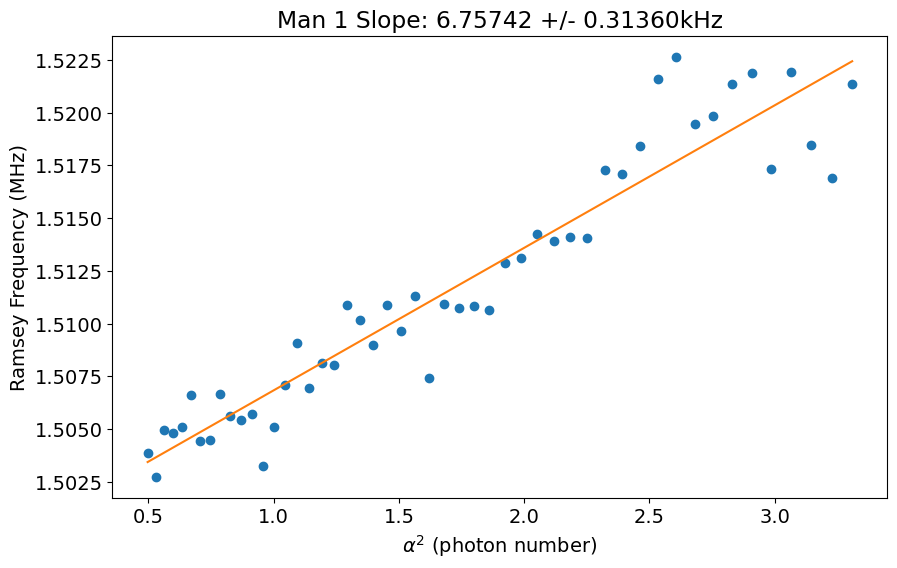

In [430]:
from scipy import stats
idx_skip =30
idx_end = 80
plt.plot([alpha **2 for alpha in alpha_list_[idx_skip:idx_end]], np.array(freqs[idx_skip: idx_end])/(2*np.pi), 'o', label='Data')

x = [alpha **2 for alpha in alpha_list_[idx_skip:idx_end]]
y = np.array(freqs[idx_skip: idx_end])/(2*np.pi)
slope, intercept, r_value, p_value, std_err = stats.linregress(x, y)

print(f"Slope: {slope}")
plt.plot(x, [slope * x_ + intercept for x_ in x], label='Fit')
# put slope in title (round to 5 decimal places)
plt.title(f'Man 1 Slope: {slope * 1e+3:.5f} +/- {std_err * 1e+3:.5f}kHz')
# print the title 
print(f'Man 1 Slope: {slope * 1e+3:.5f} +/- {std_err * 1e+3:.5f}kHz')
plt.xlabel(r'$\alpha^2$ (photon number)')
plt.ylabel('Ramsey Frequency (MHz)')

In [416]:
f_ge = attrs['config']['device']['qubit']['f_ge'][0]
f_ef = attrs['config']['device']['qubit']['f_ef'][0]
anharmonicity = f_ef - f_ge
print(f'Anharmonicity: {anharmonicity}')

Anharmonicity: -142.63078393748492


## Manipulate 2 Ramsey

1951
1932
1952
1958
1947
1946
1953
1953
1945
1950
1943
1942
1945
1947
1938
1950
1953
1948
1956
1948
1951
1946
1956
1945
1945
1940
1951
1954
1946
1933
1944
1943
1946
1950
1940
1951
1950
1943
1942
1949
1940
1946
1940
1933
1944
1938
1945
1952
1951
1946
1950
1955
1940
1943
1933
1938
1946
1954
1943
1950
1938
1934
1947
1932
1945
1946
1953
1948
1954
1949
1942
1948
1935
1957
1944
1944
1941
1950
1952
1946
1943
1947
1948
1953
1938
1933
1948
1951
1948
1940
1939
1948
1933
1950
1946
1956
1953
1957
1943
1958
Current pi pulse frequency: 5157.8527963217475
Fit frequency from I [MHz]: 0.051724318306218806 +/- 0.00017869856427594273
Suggested new pi pulse frequency from fit I [MHz]:
 	5157.851072003441
 	5157.9545206400535
T2 Ramsey from fit I [us]: 70.57255526284187
Fit frequency from Q [MHz]: 0.05167547655126514 +/- 0.0003929128459244165
Suggested new pi pulse frequencies from fit Q [MHz]:
 	5157.851120845196
 	5157.954471798299
T2 Ramsey from fit Q [us]: 55.72764349635876


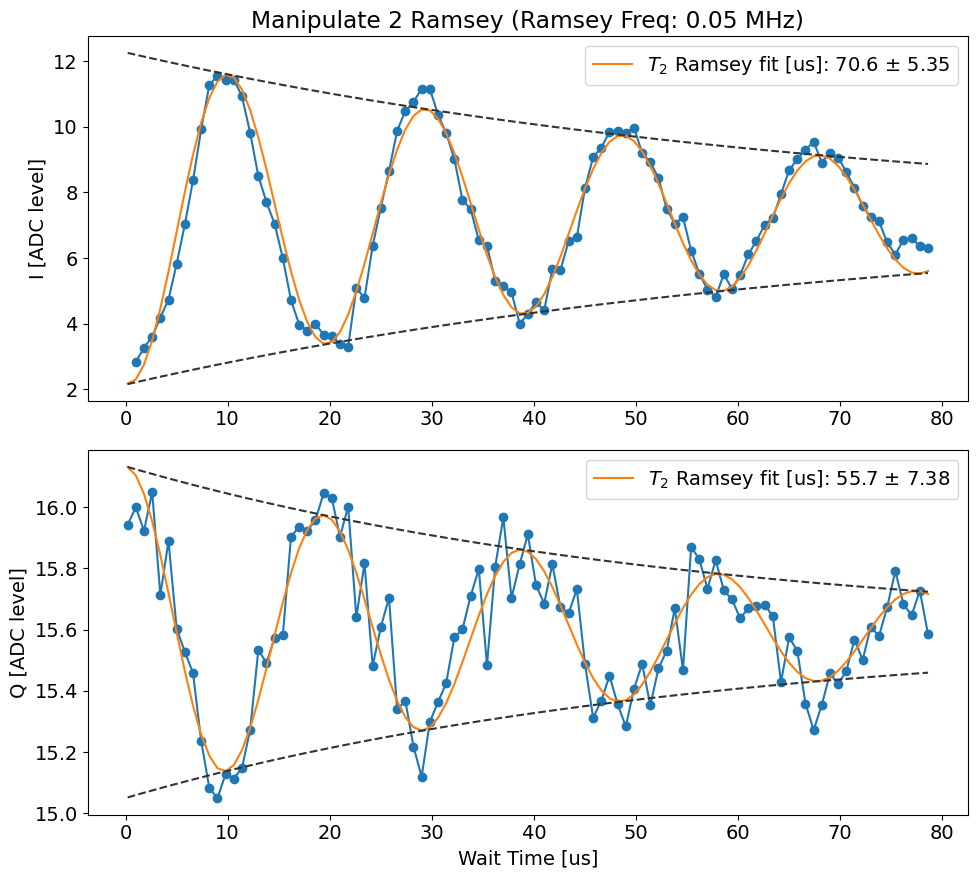

In [1725]:
temp_data, attrs = prev_data(expt_path, '00092_CavityRamseyExperiment.h5')
Ramsey_display(temp_data, attrs, ramsey_freq=attrs['config']['expt']['ramsey_freq'], 
               active_reset=True, threshold=-4.323194812977462, readouts_per_rep=4, initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, fitparams = None, title='Manipulate 2 Ramsey')

Attempted to init fitparam 4 to 8, which is out of bounds -12.763694805194806 to -9.021448051948052. Instead init to -10.89257142857143
Attempted to init fitparam 4 to -10.89257142857143, which is out of bounds 16.441857142857142 to 17.515915584415584. Instead init to 16.978886363636363
Attempted to init fitparam 4 to 16.978886363636363, which is out of bounds 18.863479728455346 to 21.394906563920777. Instead init to 20.12919314618806
Current pi pulse frequency: 5157.85201184238
Fit frequency from I [MHz]: 0.19921552063298384 +/- 0.0009477391614358848
Suggested new pi pulse frequency from fit I [MHz]:
 	5157.8527963217475
 	5158.251227363014
T2 Ramsey from fit I [us]: 85.58565429836932
Fit frequency from Q [MHz]: 0.19848880745597772 +/- 0.00390886231100101
Suggested new pi pulse frequencies from fit Q [MHz]:
 	5157.853523034924
 	5158.250500649836
T2 Ramsey from fit Q [us]: 12.41986257145677


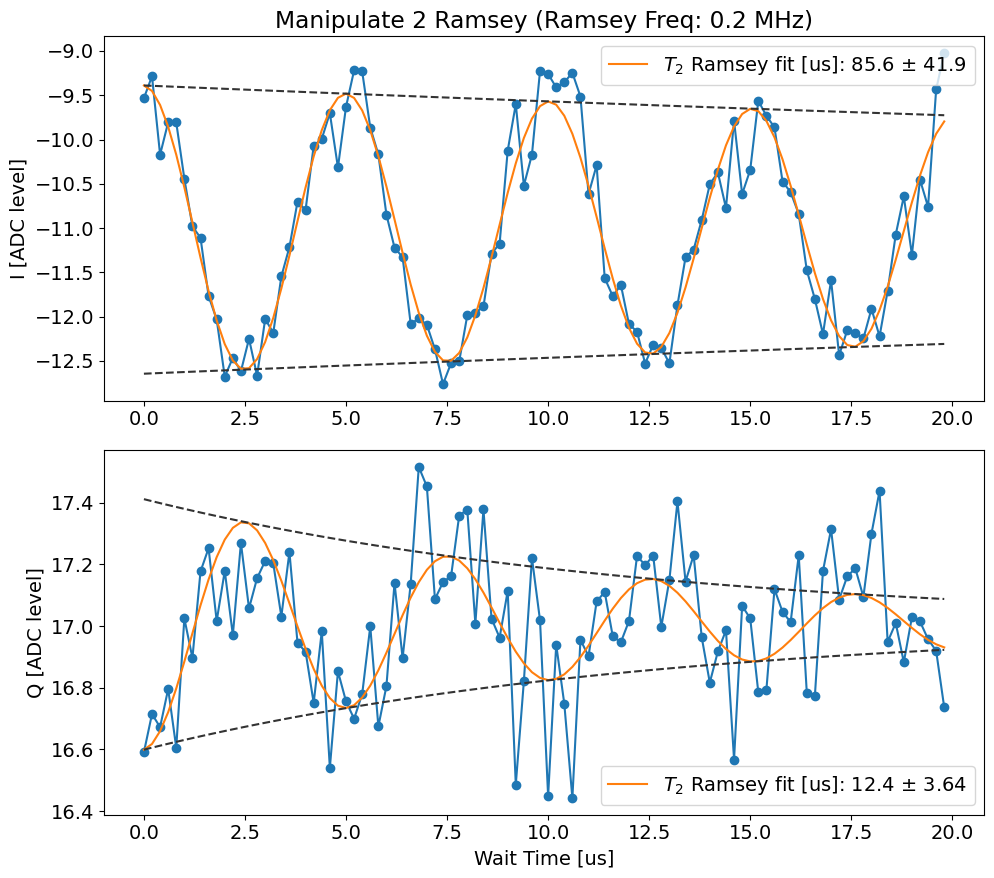

In [278]:
temp_data, attrs = prev_data(expt_path, '00021_CavityRamseyExperiment.h5')
# fitparams=[amp, freq (non-angular), phase (deg), decay time, amp offset, decay time offset]
Ramsey_display(temp_data, ramsey_freq=attrs['config']['expt']['ramsey_freq'], 
               initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
               fitparams = [4, 0.2, None, 25.0, 8, None],
                 title='Manipulate 2 Ramsey')

In [277]:
attrs['config']['expt']

{'start': 0,
 'step': 0.2,
 'expts': 101,
 'ramsey_freq': 0.2,
 'reps': 500,
 'rounds': 1,
 'qubits': [0],
 'checkEF': False,
 'f0g1_cavity': 0,
 'init_gf': False,
 'user_defined_pulse': [True, 5157.8510478336775, 200, 0.15, 0, 4],
 'parity_meas': True,
 'manipulate': 2,
 'prepulse': False,
 'postpulse': False,
 'pre_sweep_pulse': [[3568.187817769269, 3425.557033831784, 2006.76],
  [9653, 7575, 15000],
  [0, 0, 0.6151067375075144],
  [0, 0, 0],
  [2, 2, 5],
  ['gaussian', 'gaussian', 'flat_top'],
  [0.035, 0.035, 0.005]],
 'post_sweep_pulse': [[349.37],
  [5000],
  [0.5905848097264548],
  [0],
  [1],
  ['flat_top'],
  [0.005]]}

#### Man1 in 1

Attempted to init fitparam 4 to 8, which is out of bounds 13.994954545454545 to 16.426831168831168. Instead init to 15.210892857142856
Current pi pulse frequency: 5157.8527963217475
Fit frequency from I [MHz]: 0.21455768171540296 +/- 0.0006131948720393044
Suggested new pi pulse frequency from fit I [MHz]:
 	5157.838238640032
 	5158.267354003463
T2 Ramsey from fit I [us]: 70.07115135214754
Fit frequency from Q [MHz]: 0.21151385137909817 +/- 0.002764898271471539
Suggested new pi pulse frequencies from fit Q [MHz]:
 	5157.841282470368
 	5158.264310173126
T2 Ramsey from fit Q [us]: 9.754969459007746


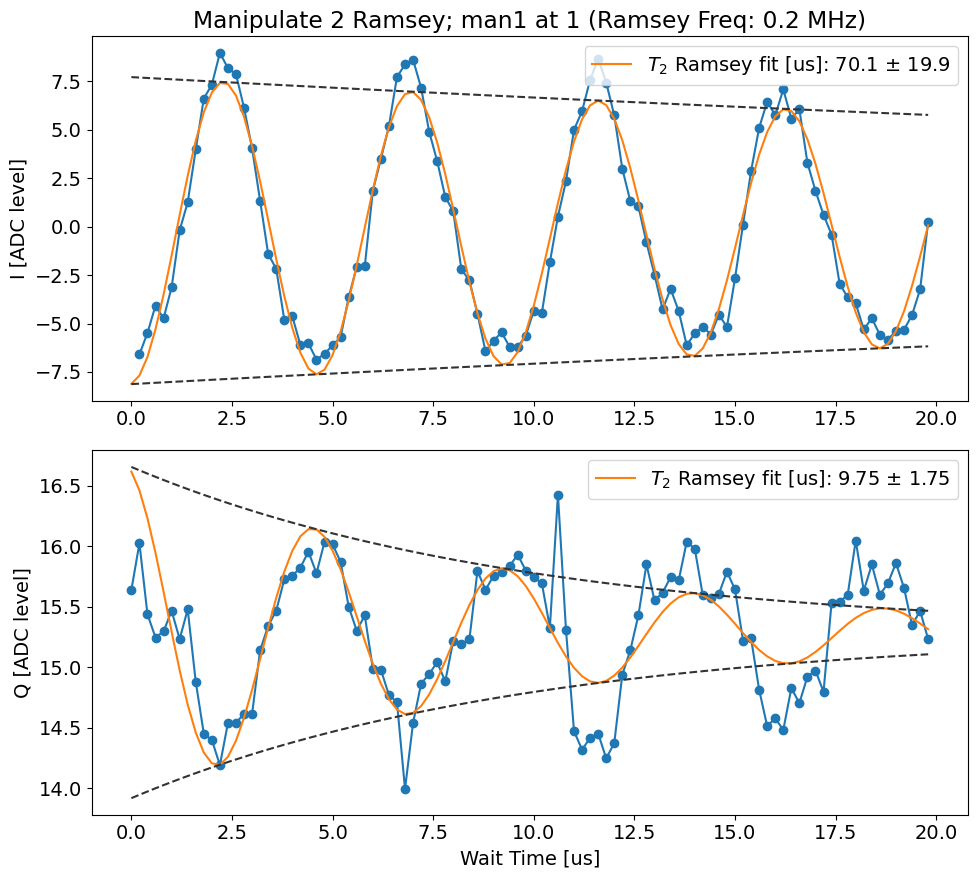

In [1470]:
temp_data, attrs = prev_data(expt_path, '00025_CavityRamseyExperiment.h5')
Ramsey_display(temp_data, attrs,ramsey_freq=attrs['config']['expt']['ramsey_freq'], 
               active_reset=False, threshold = -4.323194812977462, readouts_per_rep=4,
               initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
               fitparams =   [20, 0.2, 90, 25.0, 8, None], title='Manipulate 2 Ramsey; man1 at 1')

In [1471]:
attrs['config']['expt']

{'start': 0,
 'step': 0.2,
 'expts': 101,
 'ramsey_freq': 0.2,
 'reps': 500,
 'rounds': 1,
 'qubits': [0],
 'checkEF': False,
 'f0g1_cavity': 0,
 'init_gf': False,
 'user_defined_pulse': [True, 5157.8527963217475, 1000, 0.15, 0, 4],
 'parity_meas': False,
 'manipulate': 2,
 'prepulse': True,
 'postpulse': True,
 'pre_sweep_pulse': [[3568.187817769269, 3425.557033831784, 2006.76],
  [9653, 7575, 15000],
  [0, 0, 0.6151067375075144],
  [0, 0, 0],
  [2, 2, 5],
  ['gaussian', 'gaussian', 'flat_top'],
  [0.035, 0.035, 0.005]],
 'post_sweep_pulse': [[3567.9194338546786],
  [50],
  [6.288721018841144],
  [0],
  [2],
  ['flat_top'],
  [0.005]]}

#### stor1 in 1

Attempted to init fitparam 4 to 8, which is out of bounds -12.293012987012988 to -8.260058441558442. Instead init to -10.276535714285714
Attempted to init fitparam 4 to -10.276535714285714, which is out of bounds 16.090363636363637 to 17.312824675324677. Instead init to 16.701594155844155
Attempted to init fitparam 4 to 16.701594155844155, which is out of bounds 18.228764064641908 to 21.11389145536102. Instead init to 19.671327760001464
Current pi pulse frequency: 5157.8527963217475
Fit frequency from I [MHz]: 0.20213841531060656 +/- 0.0012550465916450866
Suggested new pi pulse frequency from fit I [MHz]:
 	5157.850657906437
 	5158.254934737058
T2 Ramsey from fit I [us]: 65.47208879434226
Fit frequency from Q [MHz]: 0.03993430221302284 +/- 0.0353797804808954
Suggested new pi pulse frequencies from fit Q [MHz]:
 	5158.012862019535
 	5158.092730623961
T2 Ramsey from fit Q [us]: 7.5974658105807285


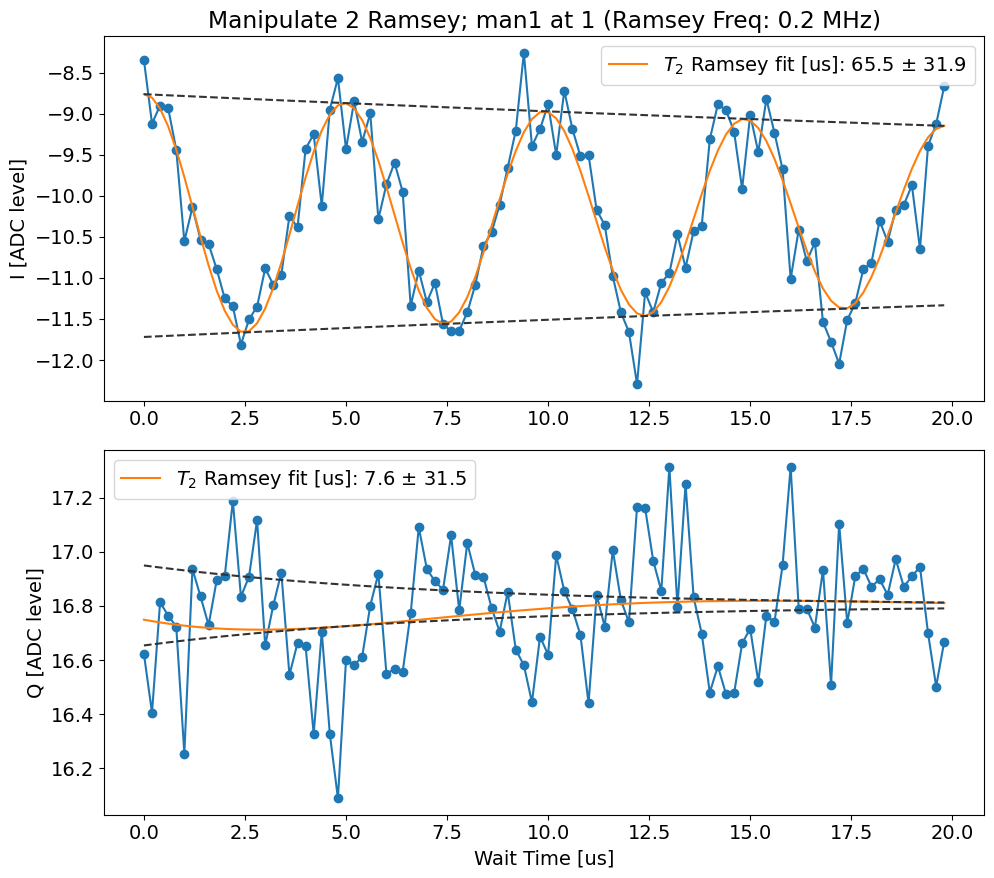

In [328]:
temp_data, attrs = prev_data(expt_path, '00022_CavityRamseyExperiment.h5')
Ramsey_display(temp_data, ramsey_freq=attrs['config']['expt']['ramsey_freq'], 
               initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, 
               fitparams =   [4, 0.2, 90, 25.0, 8, None], title='Manipulate 2 Ramsey; man1 at 1')

#### Multiple ramseys

In [350]:
def multiple_Ramsey_display(file_list, label_list, color_list, ramsey_freq=0.02, initial_freq=3500, fit=True, fitparams = None, normalize= [False, 'g_data', 'e_data'], title='Ramsey'):

    ### figure plot
    plt.figure(figsize=(10,9))
    axi = plt.subplot(211, 
        title=f"{title} ",
        ylabel="I [ADC level]")
    axq = plt.subplot(212, xlabel="Wait Time [us]", ylabel="Q [ADC level]")
    
    for idx, file_no in enumerate(file_list):
        full_name = str(file_no).zfill(5)+'_CavityRamseyExperiment.h5'
        data, attrs = prev_data(expt_path, full_name)
        label = label_list[idx]
        color = color_list[idx]
        
        if fit:
            # fitparams=[amp, freq (non-angular), phase (deg), decay time, amp offset, decay time offset]
            # Remove the first and last point from fit in case weird edge measurements
            # fitparams = None
            # fitparams=[8, 0.5, 0, 20, None, None]
            p_avgi, pCov_avgi = fitter.fitdecaysin(data['xpts'][:-1], data["avgi"][:-1], fitparams=fitparams)
            p_avgq, pCov_avgq = fitter.fitdecaysin(data['xpts'][:-1], data["avgq"][:-1], fitparams=fitparams)
            p_amps, pCov_amps = fitter.fitdecaysin(data['xpts'][:-1], data["amps"][:-1], fitparams=fitparams)
            data['fit_avgi'] = p_avgi   
            data['fit_avgq'] = p_avgq
            data['fit_amps'] = p_amps
            data['fit_err_avgi'] = pCov_avgi   
            data['fit_err_avgq'] = pCov_avgq
            data['fit_err_amps'] = pCov_amps

            if isinstance(p_avgi, (list, np.ndarray)): data['f_adjust_ramsey_avgi'] = sorted((ramsey_freq - p_avgi[1], ramsey_freq + p_avgi[1]), key=abs)
            if isinstance(p_avgq, (list, np.ndarray)): data['f_adjust_ramsey_avgq'] = sorted((ramsey_freq - p_avgq[1], ramsey_freq + p_avgq[1]), key=abs)
            if isinstance(p_amps, (list, np.ndarray)): data['f_adjust_ramsey_amps'] = sorted((ramsey_freq - p_amps[1], ramsey_freq + p_amps[1]), key=abs)

        f_pi_test = initial_freq

        
        axi.plot(data["xpts"][:-1], data["avgi"][:-1],'o-', color=color)
        if fit:
            p = data['fit_avgi']
            if isinstance(p, (list, np.ndarray)): 
                pCov = data['fit_err_avgi']
                captionStr = f'$T_2$ Ramsey fit [us]: {p[3]:.3} $\pm$ {np.sqrt(pCov[3][3]):.3}'
                axi.plot(data["xpts"][:-1], fitter.decaysin(data["xpts"][:-1], *p), label = label , color=color)
                #plt.plot(data["xpts"][:-1], fitter.expfunc(data['xpts'][:-1], p[4], p[0], p[5], p[3]), color='0.2', linestyle='--')
                #plt.plot(data["xpts"][:-1], fitter.expfunc(data['xpts'][:-1], p[4], -p[0], p[5], p[3]), color='0.2', linestyle='--')
                #plt.legend()
                print(f'Current pi pulse frequency: {f_pi_test}')
                print(f'Fit frequency from I [MHz]: {p[1]} +/- {np.sqrt(pCov[1][1])}')
                if p[1] > 2*ramsey_freq: print('WARNING: Fit frequency >2*wR, you may be too far from the real pi pulse frequency!')
                print('Suggested new pi pulse frequency from fit I [MHz]:\n',
                        f'\t{f_pi_test + data["f_adjust_ramsey_avgi"][0]}\n',
                        f'\t{f_pi_test + data["f_adjust_ramsey_avgi"][1]}')
                print(f'T2 Ramsey from fit I [us]: {p[3]}')
        axi.legend()
       
        axq.plot(data["xpts"][:-1], data["avgq"][:-1],'o-', color=color)
        if fit:
            p = data['fit_avgq']
            if isinstance(p, (list, np.ndarray)): 
                pCov = data['fit_err_avgq']
                captionStr = f'$T_2$ Ramsey fit [us]: {p[3]:.3} $\pm$ {np.sqrt(pCov[3][3]):.3}'
                axq.plot(data["xpts"][:-1], fitter.decaysin(data["xpts"][:-1], *p), label = label , color=color)
                #plt.plot(data["xpts"][:-1], fitter.expfunc(data['xpts'][:-1], p[4], p[0], p[5], p[3]), color='0.2', linestyle='--')
                #plt.plot(data["xpts"][:-1], fitter.expfunc(data['xpts'][:-1], p[4], -p[0], p[5], p[3]), color='0.2', linestyle='--')
                #plt.legend()
                print(f'Fit frequency from Q [MHz]: {p[1]} +/- {np.sqrt(pCov[1][1])}')
                if p[1] > 2*ramsey_freq: print('WARNING: Fit frequency >2*wR, you may be too far from the real pi pulse frequency!')
                print('Suggested new pi pulse frequencies from fit Q [MHz]:\n',
                        f'\t{f_pi_test + data["f_adjust_ramsey_avgq"][0]}\n',
                        f'\t{f_pi_test + data["f_adjust_ramsey_avgq"][1]}')
                print(f'T2 Ramsey from fit Q [us]: {p[3]}')
        axq.legend()
    
        if normalize[0]:
            axi,axq = normalize_data(axi, axq, data, normalize)
    plt.legend()
        
    plt.tight_layout()
    plt.show()

Attempted to init fitparam 4 to 8, which is out of bounds -12.763694805194806 to -9.021448051948052. Instead init to -10.89257142857143
Attempted to init fitparam 4 to -10.89257142857143, which is out of bounds 16.441857142857142 to 17.515915584415584. Instead init to 16.978886363636363
Attempted to init fitparam 4 to 16.978886363636363, which is out of bounds 18.863479728455346 to 21.394906563920777. Instead init to 20.12919314618806
Current pi pulse frequency: 5157.85201184238
Fit frequency from I [MHz]: 0.1992155191572379 +/- 0.0009321343327148673
Suggested new pi pulse frequency from fit I [MHz]:
 	5157.852796323223
 	5158.2512273615375
T2 Ramsey from fit I [us]: 85.5857675291003
Fit frequency from Q [MHz]: 0.19848934044506614 +/- 0.003922111821186159
Suggested new pi pulse frequencies from fit Q [MHz]:
 	5157.853522501935
 	5158.250501182825
T2 Ramsey from fit Q [us]: 12.419846146170036
Attempted to init fitparam 4 to 20.12919314618806, which is out of bounds -11.995071428571428 t

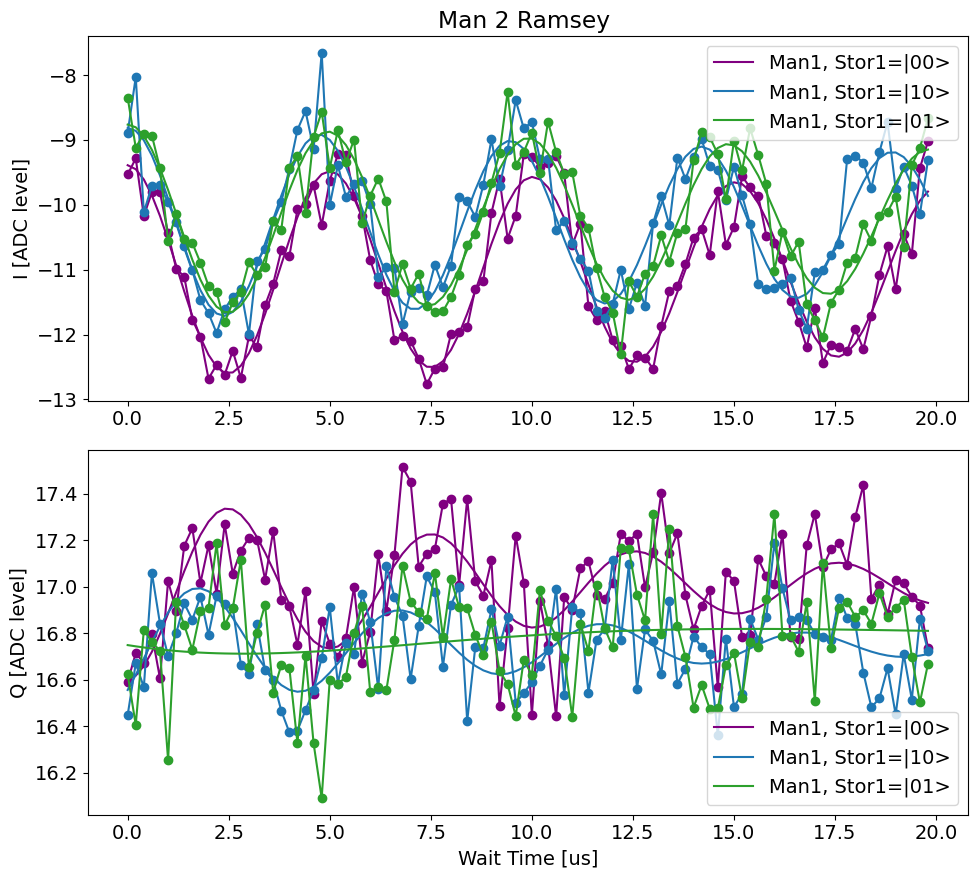

In [438]:
file_list = np.array([21, 15, 22])
label_list = ['Man1, Stor1=|00>', 'Man1, Stor1=|10>', 'Man1, Stor1=|01>']
color_list = ['purple', 'tab:blue', 'tab:green']

temp_data, attrs = prev_data(expt_path, '00021_CavityRamseyExperiment.h5') # just to get configs
multiple_Ramsey_display(file_list, label_list, color_list, ramsey_freq= attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['expt']['user_defined_pulse'][1], fit=True, fitparams = [4, 0.2, 90, 25.0, 8, None], normalize= [False, 'g_data', 'e_data'], title='Man 2 Ramsey')

#### Sweep

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


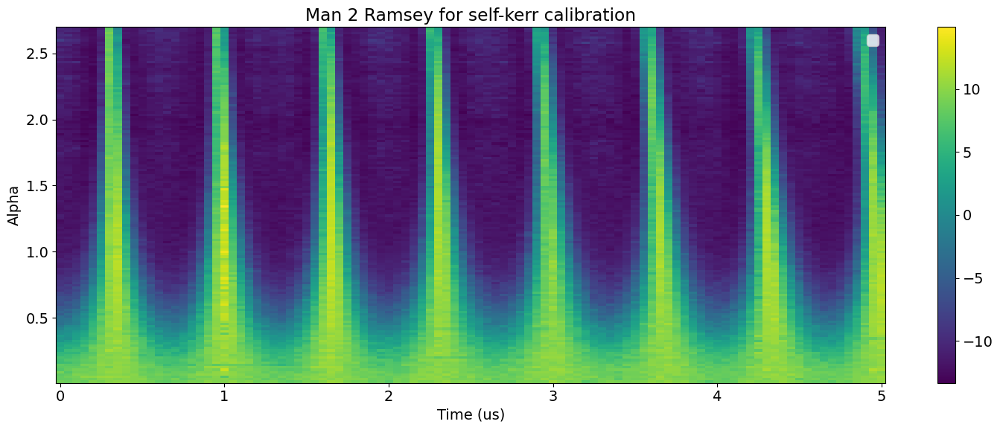

In [440]:
#file_list = np.arange(0,205,1)
file_list = np.arange(214,362,1)
y_list = []
freq_list = []
name = '_cavity_ramsey_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # efk
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['user_defined_pulse'][2])

gain_to_alpha =attrs['config']['device']['manipulate']['gain_to_alpha'][1] * 3
alpha_list = np.array(freq_list)*gain_to_alpha

plot_sideband_sweep(len_x, alpha_list, np.array(y_list), hlines=[], vlines=None, title="Man 2 Ramsey for self-kerr calibration", xlabel='Time (us)', ylabel='Alpha')
    

In [1018]:
import numpy as np
from scipy.optimize import minimize

# parameters for the model
idx = 80
print(f'Alpha: {alpha_list[idx]}')
#choose the ydata 
ydata = y_list[idx]
tlist = len_x
omega = 0.5 * 2 *np.pi # MHz 
alpha = alpha_list[idx]

args = {'alpha': alpha, 'omega': omega, 'phase': 0, 'n_max': 20, 'kerr': 0.002 * 2 * np.pi}


def P_0(t, args):
    alpha = args['alpha']
    omega = args['omega']
    phase = args['phase']
    n_max = args['n_max']
    kerr = args['kerr']
    return np.abs(np.exp(-np.abs(alpha)**2) *
                    np.sum([np.abs(alpha)**(2*n)/math.factorial(n) * np.exp(-1j * (-1 * kerr/2* n**2 + omega *n)  * (t + phase) ) for n in range(0, n_max)])
                    )**2

def ramsey_plot(tlist, args):
    P0_list = [P_0(t, args) for t in tlist]
    return P0_list



#rescale data to be between 0 and 1
ydata = (ydata - min(ydata))/(max(ydata) - min(ydata)) * 0.993
# invert data
# ydata = 1 - ydata
# rescale data to have max value of max(ws)
# ydata = ydata * max(ws)

# Objective function to fit data to wigner function curve 
def objective(param):
    kerr = param[0]
    phase = param[1] # t_offset

    args['kerr'] = kerr
    args['phase'] = phase
    ws = ramsey_plot(tlist, args)
    # print('gain_to_alpha:', gain_to_alpha)
    # print('objective:', np.sum(np.abs(ws - ydata)))
    # print('-----------------------------------')
    return np.sum(np.abs(ws - ydata))  # sum of absolute differences

# Initial guess for start and end of alpha_list
initial_guess = [0.002 * 2 * np.pi, 1.2]

# Bounds for start and end values of alpha_list
bounds = [(0, 0.050 * 2 * np.pi), (0, 1.5)]

# Run the optimizer
result = minimize(objective, initial_guess, bounds=bounds, tol=1e-5, options={'disp': True}) #, method = 'BFGS')

Alpha: 2.9895074999999998


In [1019]:
result

  message: CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH
  success: True
   status: 0
      fun: 10.936049712879564
        x: [ 1.984e-01  1.500e+00]
      nit: 9
      jac: [ 2.969e+01  6.760e-01]
     nfev: 111
     njev: 37
 hess_inv: <2x2 LbfgsInvHessProduct with dtype=float64>

Text(0.5, 1.0, 'Kerr: 0.03158090')

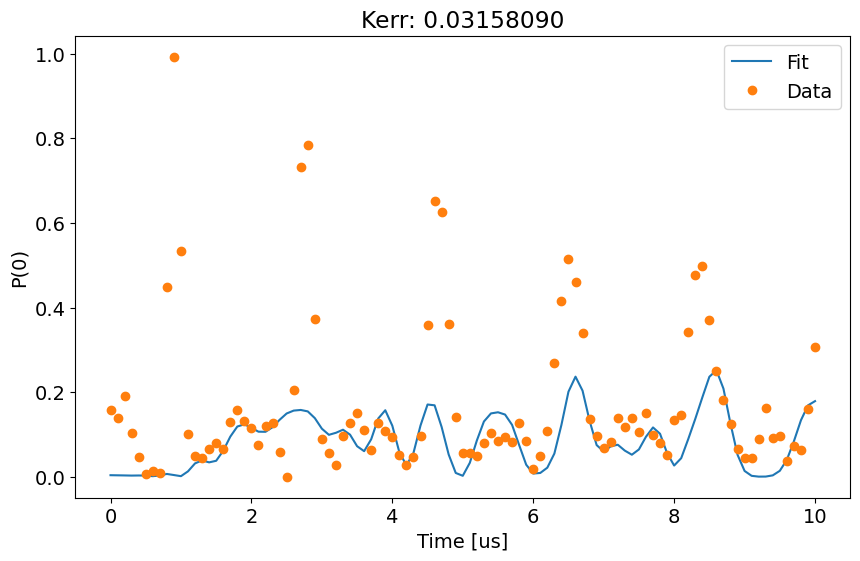

In [1020]:
# plot the result 
args['kerr'] = result.x[0]
args['phase'] = result.x[1]

plt.plot(tlist, ramsey_plot(tlist, args), '-', label='Fit')
plt.plot(tlist, ydata, 'o', label='Data')

#label axes
plt.xlabel(r'Time [us]')
plt.ylabel(r'P(0)')
plt.legend()
plt.title('Kerr: {:.8f}'.format(args['kerr']/(2*np.pi)))
#gain_to_alpha = 0.00030837
# print('Conversion factor: {:.8f}'.format(gain_to_alpha))
# print('alpha = 1 requires gain of : {:.8f}'.format(1/gain_to_alpha))

Text(0, 0.5, 'P(0)')

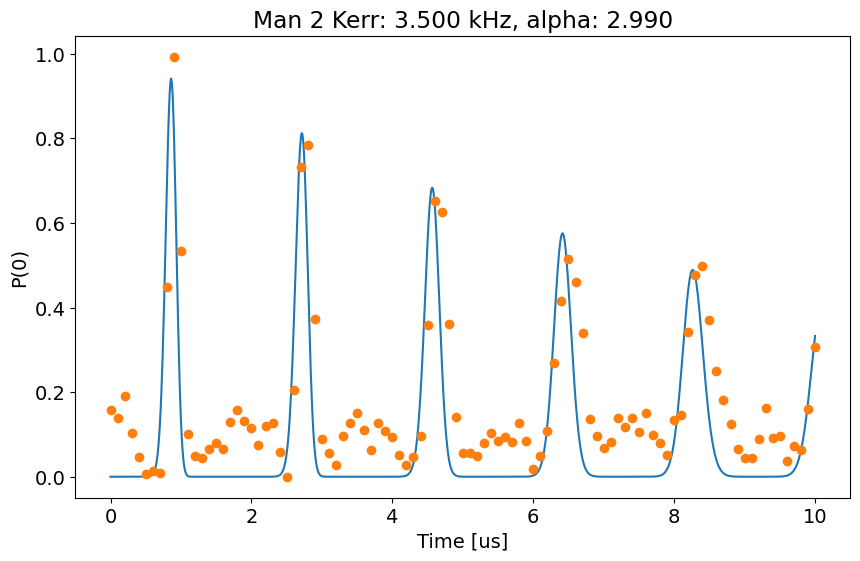

In [1027]:
args['kerr'] = 0.0035* 2* np.pi#result.x[0]
args['phase'] = 1.0   # |#result.x[1]
args['omega'] = 0.57 * 2 *np.pi # MHz
#args['alpha'] = 2
new_tlist = np.linspace(0, 10, 1000)
plt.plot(new_tlist, ramsey_plot(new_tlist, args), '-', label='Fit')
plt.plot(tlist, ydata, 'o', label='Data')
# include alpha, kerr in title
plt.title('Man 2 Kerr: {:.3f} kHz, alpha: {:.3f}'.format(args['kerr']/(2*np.pi) * 1e+3,args['alpha']))

#plt.title('Kerr: {:.8f}'.format(args['kerr']/(2*np.pi)))
# x and y labvels 
plt.xlabel(r'Time [us]')
plt.ylabel(r'P(0)')

##### Fit using small time approx

Alpha: 0.8322291
Peak frequency: 1.584158415841584


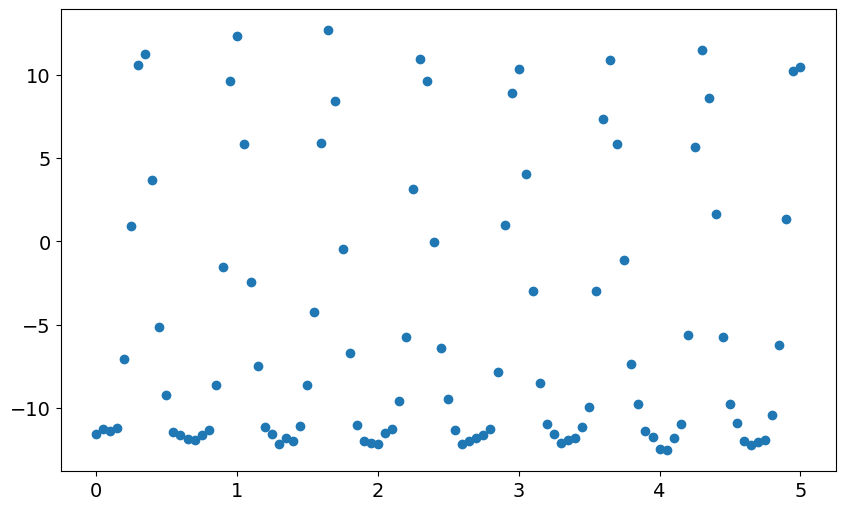

In [285]:
idx_list = np.arange(0, 100, 4)
peak_freqs = []
alpha_list_ = []

# for idx in idx_list:
idx = 60 
print(f'Alpha: {alpha_list[idx]}')
alpha_list_.append(alpha_list[idx])
#choose the ydata
ydata = y_list[idx]
tlist = len_x
plt.plot(tlist, ydata, 'o', label='Data')


# performing fft 
import numpy as np
from scipy.fft import fft, fftfreq

# Number of sample points
N = len(tlist)

# Sample spacing
T = tlist[1] - tlist[0]  # Assuming uniform spacing

# Compute the FFT
yf = fft(ydata)
xf = fftfreq(N, T)[:N//2]

idx_skip = 2 # skip the first two points since yf has a peak at 0 Mhz

# Find the peak frequency
idx_peak = np.argmax(np.abs(yf[idx_skip:N//2]))
peak_frequency = xf[idx_skip:][idx_peak]

print('Peak frequency:', peak_frequency)
peak_freqs.append(peak_frequency)

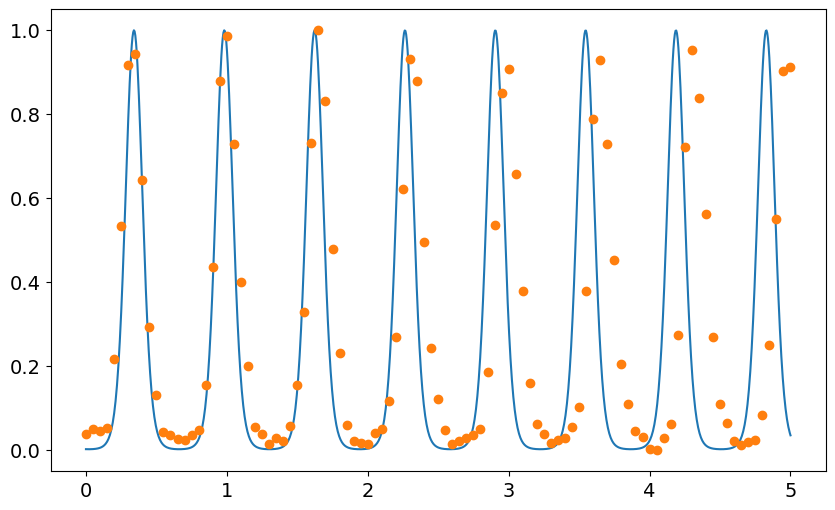

In [288]:
def small_angle_approx_P0(t, params): 
    return np.exp(-2* np.abs(params['alpha'])**2 * (1 - np.cos(params['omega'] * (t + params['t0']))) )

params = {'alpha': 1.224, 'omega': 1.56 * 2 * np.pi, 't0': 0.3}
new_tlist = np.linspace(0, 5, 1000)
plt.plot(new_tlist, small_angle_approx_P0(new_tlist, params), '-', label='Fit')
plt.plot(tlist, (ydata - min(ydata))/(max(ydata) - min(ydata)), 'o', label='Data')

##### Fit using small time approx version 2 

In [441]:
import numpy as np
from scipy.optimize import minimize

idx_list = np.arange(0, 148, 1)
freqs = []
alpha_list_ = []
t0s = []

for idx in idx_list:

    # parameters for the model
    #idx = 150
    print(f'Alpha: {alpha_list[idx]}')
    #choose the ydata 
    ydata = y_list[idx]
    tlist = len_x
    omega = 0.5 * 2 *np.pi # MHz 
    alpha = alpha_list[idx]

    args = {'alpha': alpha, 'omega': omega, 't0': 0.3}


    def small_angle_approx_P0(t, args): 
        return np.exp(-2* np.abs(args['alpha'])**2 * (1 - np.cos(args['omega'] * (t + args['t0']))) )



    #rescale data to be between 0 and 1
    ydata = (ydata - min(ydata))/(max(ydata) - min(ydata))
    # invert data
    # ydata = 1 - ydata
    # rescale data to have max value of max(ws)
    # ydata = ydata * max(ws)

    # Objective function to fit data to wigner function curve 
    def objective(param):

        args['omega'] = param[0]
        args['t0'] = param[1]
        ws = small_angle_approx_P0(tlist, args)

        return np.sum(np.abs(ws - ydata))  # sum of absolute differences

    # Initial guess for start and end of alpha_list
    initial_guess = [1.5 * 2 * np.pi, 0.3]

    # Bounds for start and end values of alpha_list
    bounds = [(1 * 2 * np.pi, 2 * 2 * np.pi), (0, 0.5)]

    # Run the optimizer
    result = minimize(objective, initial_guess, bounds=bounds, tol=1e-5, options={'disp': True}) #, method = 'BFGS')

    # store all params
    freqs.append(result.x[0])
    t0s.append(result.x[1])
    alpha_list_.append(alpha_list[idx])

Alpha: 0.0181683
Alpha: 0.0363366
Alpha: 0.054504899999999995
Alpha: 0.0726732
Alpha: 0.09084149999999999
Alpha: 0.10900979999999999
Alpha: 0.1271781
Alpha: 0.1453464
Alpha: 0.16351469999999999
Alpha: 0.18168299999999998
Alpha: 0.19985129999999998
Alpha: 0.21801959999999998
Alpha: 0.23618789999999998
Alpha: 0.2543562
Alpha: 0.27252449999999995
Alpha: 0.2906928
Alpha: 0.30886109999999994
Alpha: 0.32702939999999997
Alpha: 0.34519769999999994
Alpha: 0.36336599999999997
Alpha: 0.38153429999999994
Alpha: 0.39970259999999996
Alpha: 0.41787089999999993
Alpha: 0.43603919999999996
Alpha: 0.45420749999999993
Alpha: 0.47237579999999996
Alpha: 0.4905440999999999
Alpha: 0.5087124
Alpha: 0.5268807
Alpha: 0.5450489999999999
Alpha: 0.5632172999999999
Alpha: 0.5813856
Alpha: 0.5995538999999999
Alpha: 0.6177221999999999
Alpha: 0.6358904999999999
Alpha: 0.6540587999999999
Alpha: 0.6722270999999999
Alpha: 0.6903953999999999
Alpha: 0.7085636999999999
Alpha: 0.7267319999999999
Alpha: 0.7449002999999998
Alph

Slope: 0.00510765068040449


Text(0, 0.5, 'Ramsey Frequency (MHz)')

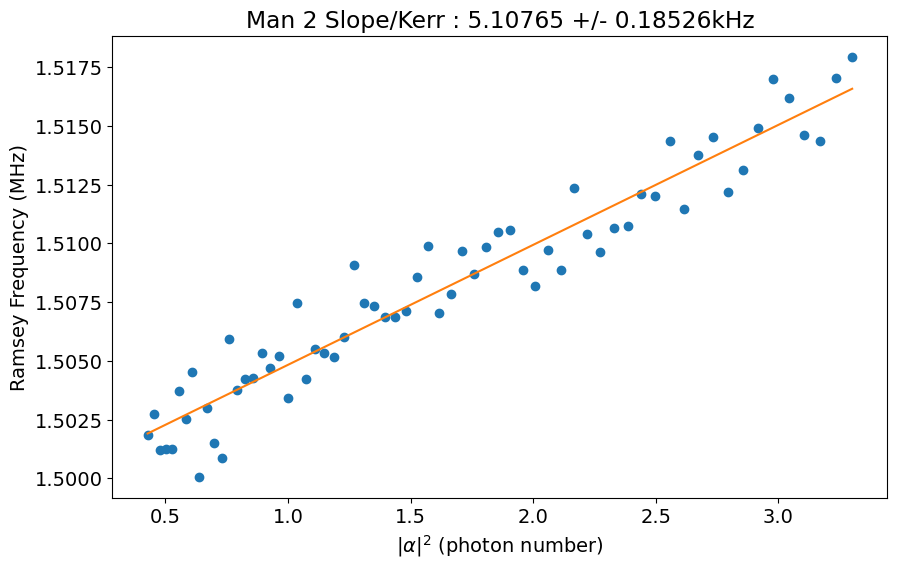

In [442]:
from scipy import stats
idx_skip = 35
idx_end = 100
plt.plot([alpha **2 for alpha in alpha_list_[idx_skip:idx_end]], np.array(freqs[idx_skip: idx_end])/(2*np.pi), 'o', label='Data')

x = [alpha **2 for alpha in alpha_list_[idx_skip:idx_end]]
y = np.array(freqs[idx_skip: idx_end])/(2*np.pi)
slope, intercept, r_value, p_value, std_err = stats.linregress(x, y)

print(f"Slope: {slope}")
plt.plot(x, [slope * x_ + intercept for x_ in x], label='Fit')
# put slope in title (round to 5 decimal places)
plt.title(f'Man 2 Slope/Kerr : {slope * 1e+3:.5f} +/- {std_err * 1e+3:.5f}kHz')
plt.xlabel(r'$|\alpha|^2$ (photon number)')
plt.ylabel('Ramsey Frequency (MHz)')

In [323]:
std_err*1e+3

0.1430733921173088

In [298]:
result

  message: CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH
  success: True
   status: 0
      fun: 7.243054664612599
        x: [ 9.471e+00  3.254e-01]
      nit: 7
      jac: [-1.593e+00 -3.895e+00]
     nfev: 90
     njev: 30
 hess_inv: <2x2 LbfgsInvHessProduct with dtype=float64>

Text(0.5, 1.0, 'Omega: 1.507')

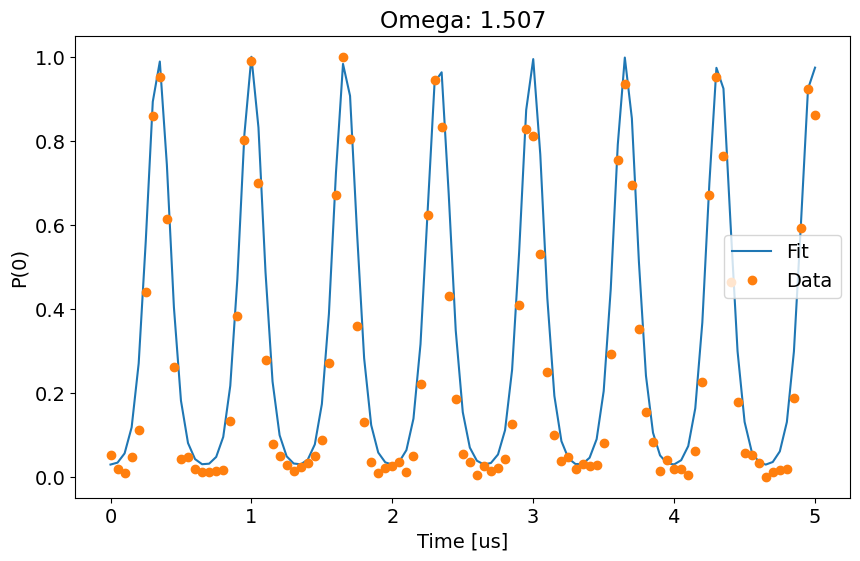

In [299]:
args['omega'] = result.x[0]
args['t0'] = result.x[1]

plt.plot(tlist, small_angle_approx_P0(tlist, args), '-', label='Fit')
plt.plot(tlist, ydata, 'o', label='Data')

#label axes
plt.xlabel(r'Time [us]')
plt.ylabel(r'P(0)')
plt.legend()
plt.title('Omega: {:.3f}'.format(args['omega']/(2*np.pi)))
#gain_to_alpha = 0.00030837
# print('Conversion factor: {:.8f}'.format(gain_to_alpha))
# print('alpha = 1 requires gain of : {:.8f}'.format(1/gain_to_alpha))

## Echo

Current pi pulse frequency: 3568.150270972182
Fit frequency from I [MHz]: 0.020011156816483723 +/- 2.4610468747160333e-05
Suggested new pi pulse frequency from fit I [MHz]:
 	3568.1502598153656
 	3568.1902821289987
T2 Ramsey from fit I [us]: 479.70240502355824
Fit frequency from Q [MHz]: 0.020252097488411204 +/- 0.00028949539485121956
Suggested new pi pulse frequencies from fit Q [MHz]:
 	3568.1500188746936
 	3568.1905230696707
T2 Ramsey from fit Q [us]: 275.47574072614395


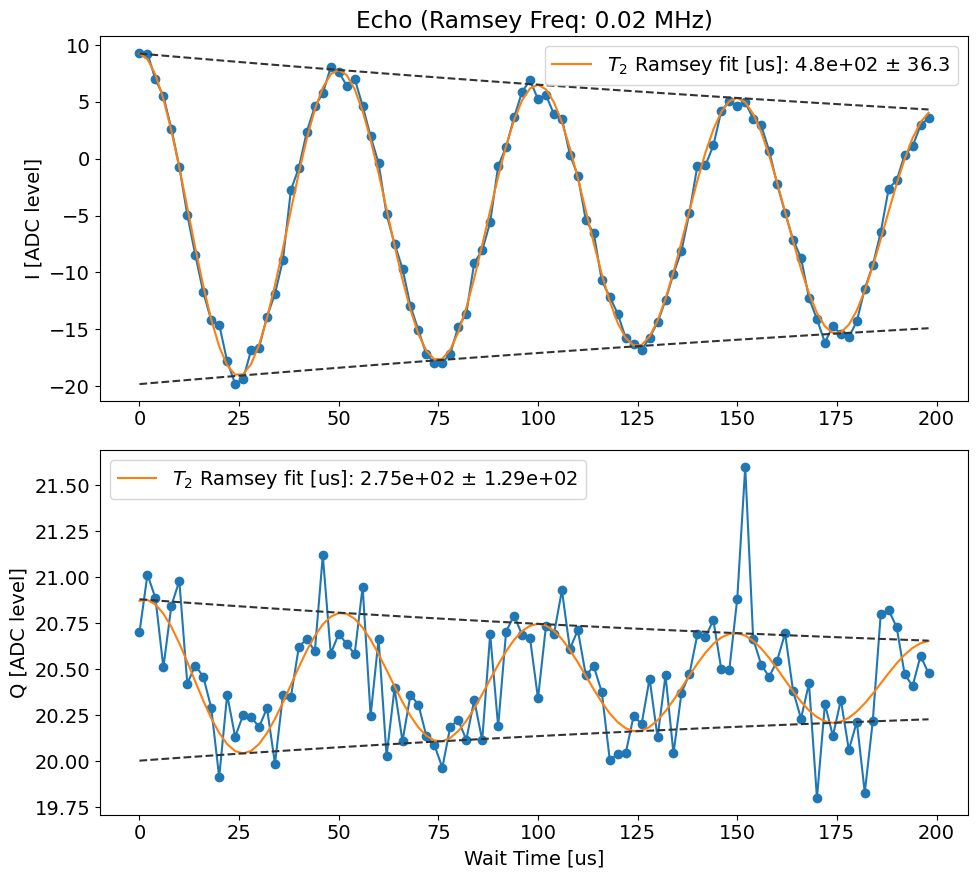

In [170]:
temp_data, attrs = prev_data(expt_path, '00002_RamseyEchoExperiment.h5')
Ramsey_display(temp_data, ramsey_freq=attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['device']['qubit']['f_ge'], fit=True, fitparams=None, title='Echo')

## amplitude rabi

Attempted to init fitparam 4 to -10, which is out of bounds -314.7307792207792 to -296.03059523809526. Instead init to -305.3806872294372
Attempted to init fitparam 4 to -305.3806872294372, which is out of bounds 297.567334951504 to 402.3424421288756. Instead init to 349.9548885401898
Pi gain from avgi data [dac units]: 10716
	Pi/2 gain from avgi data [dac units]: 5510
Pi gain from avgq data [dac units]: 15656
	Pi/2 gain from avgq data [dac units]: 9656


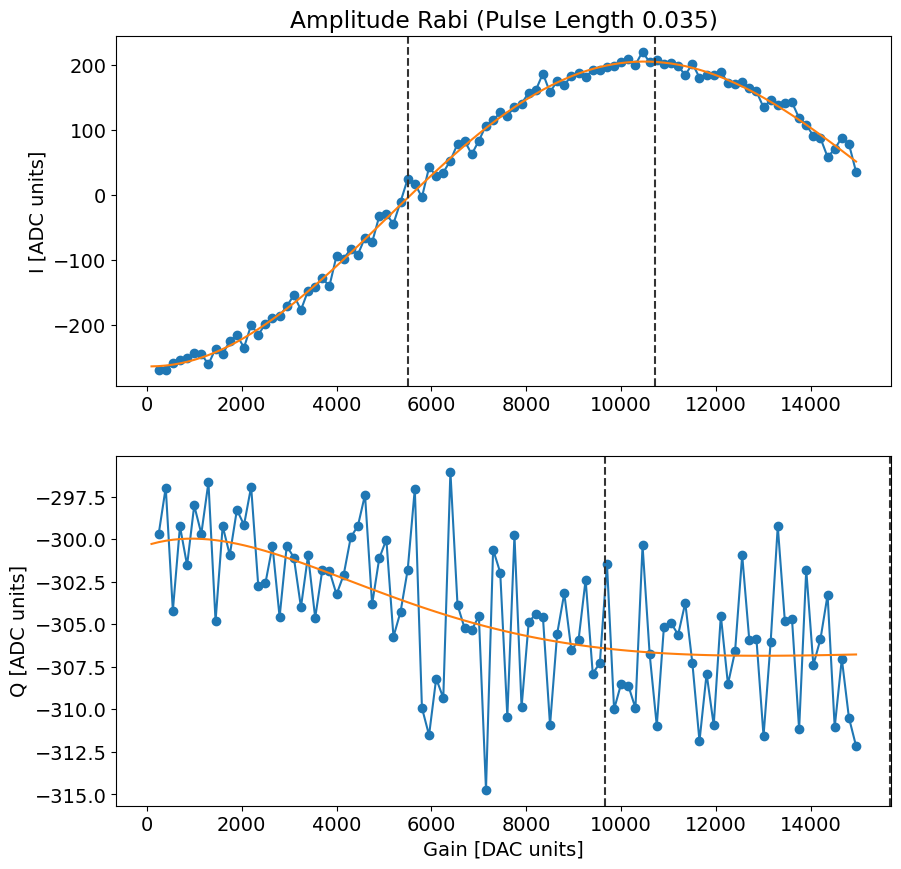

In [50]:
temp_data, attrs = prev_data(expt_path, '00021_AmplitudeRabiExperiment.h5')
# [amp, freq (non-angular), phase (deg), decay time, amp offset, decay time offset]
amp_display(temp_data, sigma= attrs['config']['expt']['sigma_test'], fit=True, fitparams=[250,0.0001,90,None,-10,None])

### man1 at |1>

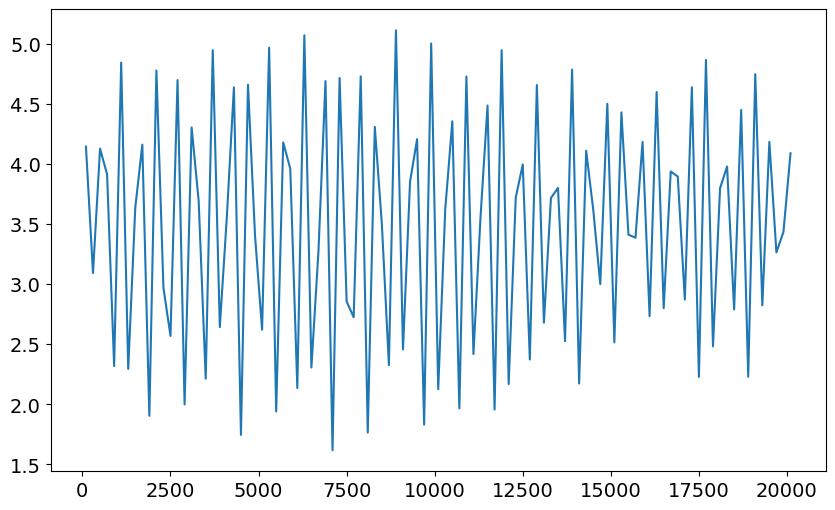

In [459]:
temp_data, attrs = prev_data(expt_path, '00001_AmplitudeRabiGeneralExperiment.h5')
data = temp_data['avgi']
xdata = temp_data['xpts']
plt.plot(xdata, data)
#amp_display(temp_data, sigma= attrs['config']['expt']['sigma_test'], fit=True, fitparams=[4,0.00009,90,None,-6.5,None])

Attempted to init fitparam 4 to -6.5, which is out of bounds -2.6832536585365854 to 5.5633333333333335. Instead init to 1.440039837398374
Attempted to init fitparam 4 to 1.440039837398374, which is out of bounds -1.8910422764227643 to -1.286531707317073. Instead init to -1.5887869918699187
Attempted to init fitparam 4 to -1.5887869918699187, which is out of bounds 1.4839399450804804 to 5.8588919565652064. Instead init to 3.671415950822843
Pi gain from avgi data [dac units]: 9011
	Pi/2 gain from avgi data [dac units]: 4558
Pi gain from avgq data [dac units]: 7425
	Pi/2 gain from avgq data [dac units]: 4334


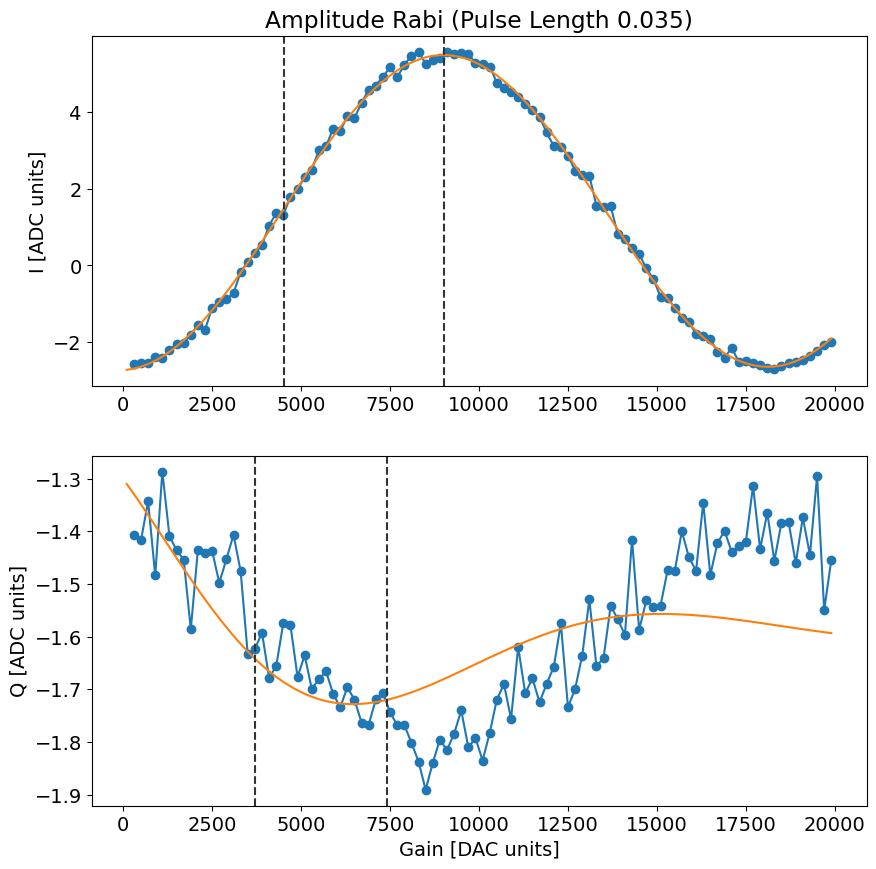

In [461]:
temp_data, attrs = prev_data(expt_path, '00050_AmplitudeRabiExperiment.h5')
amp_display(temp_data, sigma= attrs['config']['expt']['sigma_test'], fit=True, fitparams=[4,0.00009,90,None,-6.5,None])

### man2 at |1>

Attempted to init fitparam 4 to -6.5, which is out of bounds -1.127882926829268 to 7.295110569105692. Instead init to 3.083613821138212
Attempted to init fitparam 4 to 3.083613821138212, which is out of bounds -1.7788439024390246 to -0.7747300813008131. Instead init to -1.2767869918699188
Attempted to init fitparam 4 to -1.2767869918699188, which is out of bounds 1.5534669225256523 to 7.354005593721781. Instead init to 4.453736258123716
Pi gain from avgi data [dac units]: 8970
	Pi/2 gain from avgi data [dac units]: 4564
Pi gain from avgq data [dac units]: 8909
	Pi/2 gain from avgq data [dac units]: 5886


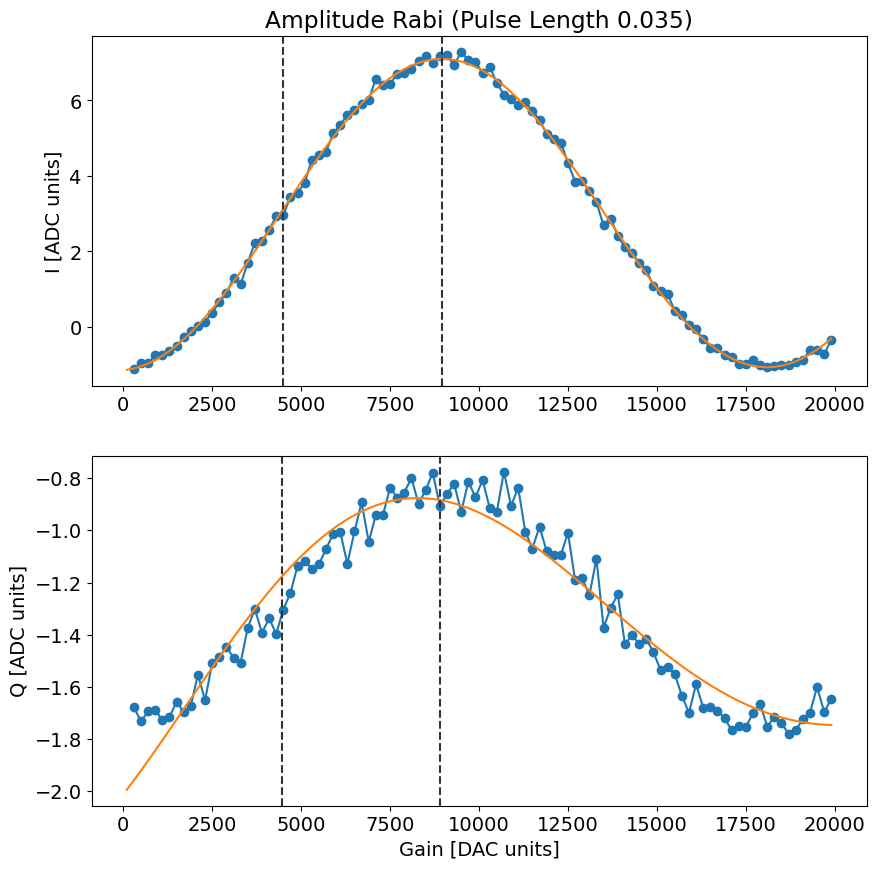

In [336]:
temp_data, attrs = prev_data(expt_path, '00043_AmplitudeRabiExperiment.h5')
amp_display(temp_data, sigma= attrs['config']['expt']['sigma_test'], fit=True, fitparams=[4,0.00009,90,None,-6.5,None])

## amplitude EF rabi

Attempted to init fitparam 1 to 0.0028, which is out of bounds 4.47427293064877e-06 to 0.0006711409395973154. Instead init to 0.0003378076062639821
Pi gain from avgi data [dac units]: 1567
	Pi/2 gain from avgi data [dac units]: 684
Pi gain from avgq data [dac units]: 8236
	Pi/2 gain from avgq data [dac units]: 3863


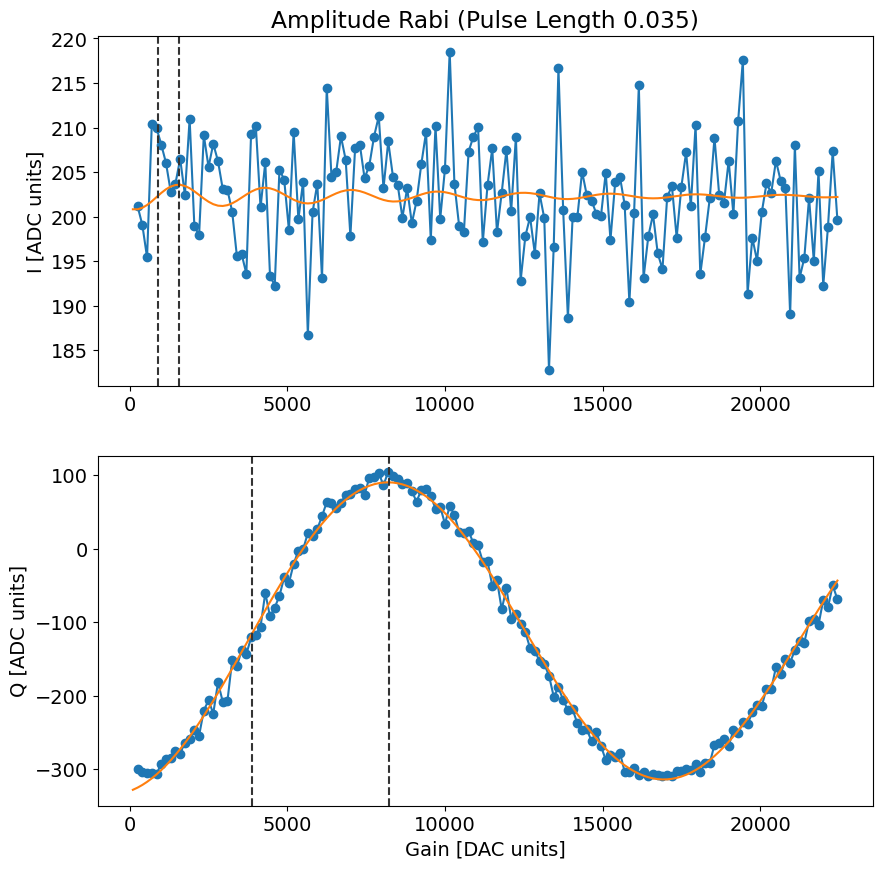

In [42]:
temp_data, attrs = prev_data(expt_path, '00023_AmplitudeRabiExperiment.h5')
amp_display(temp_data, sigma= attrs['config']['expt']['sigma_test'], fit=True, normalize = [False, 'g_data', 'e_data'], 
            fitparams=None)#[1000,None,None,None,None,None])

In [41]:
8236/2

4118.0

In [388]:
3566.8-(3566.3981918052864-3566.1359110698945)

3566.5377192646083

### man1 at |1>

Attempted to init fitparam 4 to 7.23127850406504, which is out of bounds -5.934364227642275 to -0.7961024390243902. Instead init to -3.365233333333333
Attempted to init fitparam 4 to -3.365233333333333, which is out of bounds 6.771746030241174 to 9.779047996060104. Instead init to 8.27539701315064
Pi gain from avgi data [dac units]: 6749
	Pi/2 gain from avgi data [dac units]: 4477
Pi gain from avgq data [dac units]: 7931
	Pi/2 gain from avgq data [dac units]: 4192


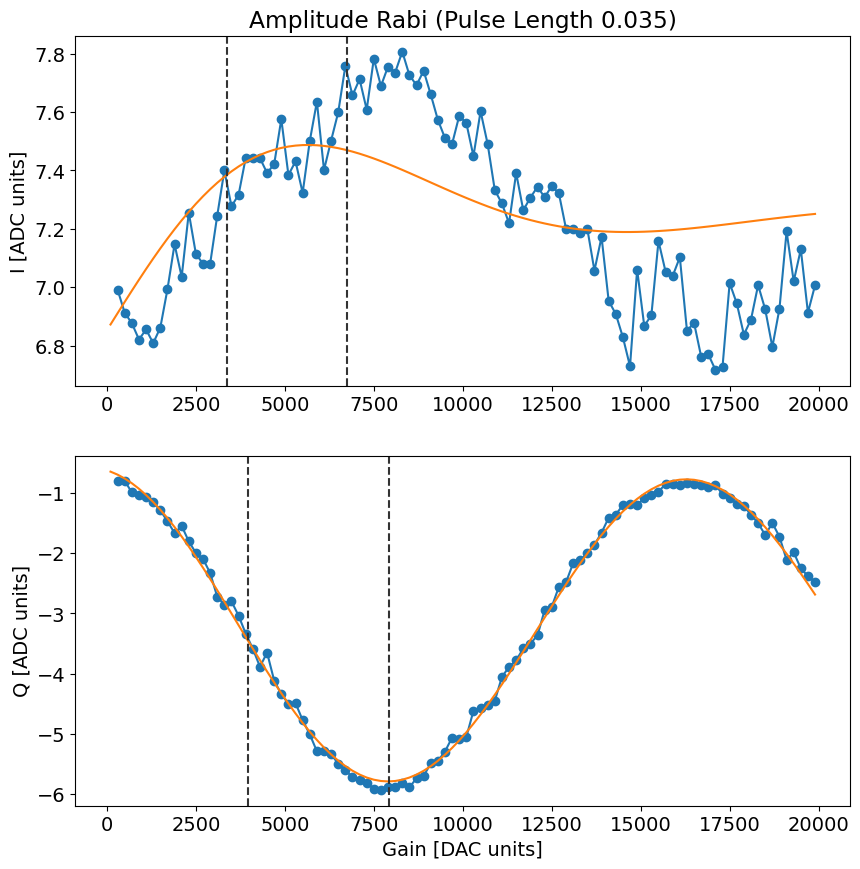

In [385]:
temp_data, attrs = prev_data(expt_path, '00045_AmplitudeRabiExperiment.h5')
amp_display(temp_data, sigma= attrs['config']['expt']['sigma_test'], fit=True, normalize = [False, 'g_data', 'e_data'], fitparams=[2.7,0.0001,None,None,None,None])

### man2 at |1>

Attempted to init fitparam 4 to 7.536244715447153, which is out of bounds -6.366936585365853 to -0.770219512195122. Instead init to -3.5685780487804872
Attempted to init fitparam 4 to -3.5685780487804872, which is out of bounds 6.871816335671836 to 10.604417313088707. Instead init to 8.73811682438027
Pi gain from avgi data [dac units]: 7715
	Pi/2 gain from avgi data [dac units]: 4368
Pi gain from avgq data [dac units]: 7887
	Pi/2 gain from avgq data [dac units]: 4205


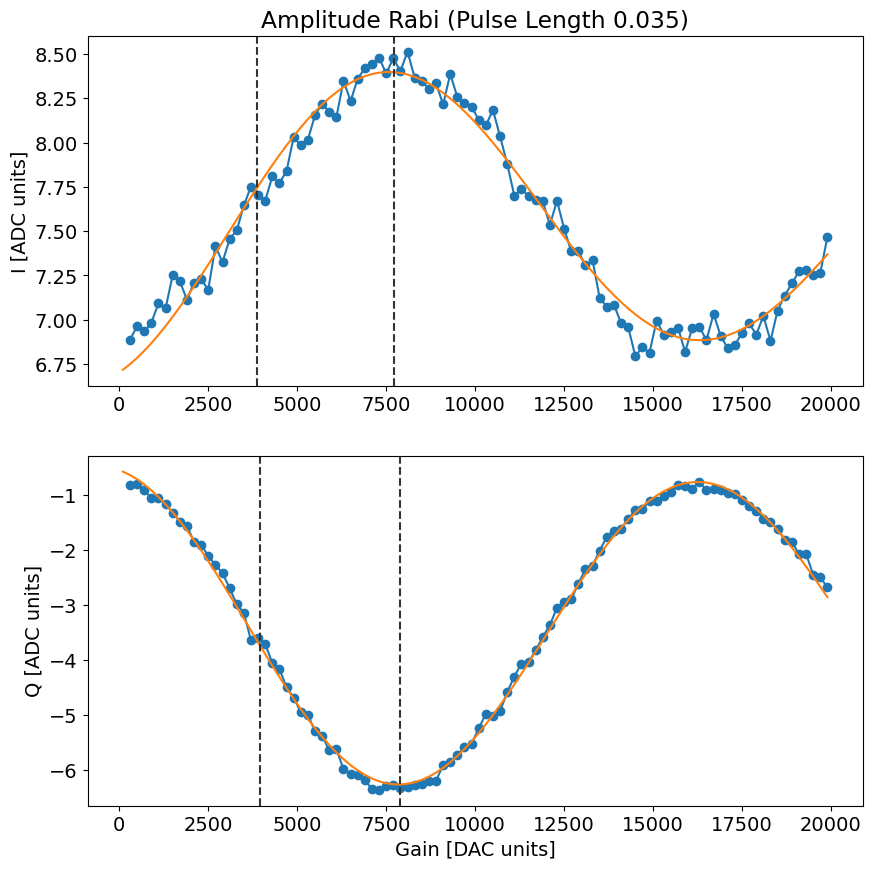

In [383]:
temp_data, attrs = prev_data(expt_path, '00044_AmplitudeRabiExperiment.h5')
amp_display(temp_data, sigma= attrs['config']['expt']['sigma_test'], fit=True, normalize = [False, 'g_data', 'e_data'], fitparams=[2.7,0.00005,None,None,None,None])

## Qubit Noise Temperature

## length Rabi qubit resolved pi

Attempted to init fitparam 4 to -37.49002198051948, which is out of bounds -320.8135909090909 to -285.7468181818182. Instead init to -303.2802045454546
[ 2.35787582e+02  3.34581095e+00 -7.99790044e+01  1.41252544e+03
 -4.42416293e+01 -3.70494255e-01]
Decay from avgi [us] 1412.5254416311866
Rate [MHz] 3.3458109477259903
Pi length from avgi data [us]: 0.14112091459439022
	Pi/2 length from avgi data [us]: 0.06640061392411035
Fit params:  [ 2.35787582e+02  3.34581095e+00 -7.99790044e+01  1.41252544e+03
 -4.42416293e+01 -3.70494255e-01]

Decay from avgq [us] 1.0664626459313042
Rate [MHz] 3.3340183146833193
Pi length from avgq data [us]: 0.13877869808637464
Pi/2 length from avgq data [us]: 0.06938934904318732
Fit params:  [ 150.            3.33401831  103.4313404     1.06646265 -302.69826233
   -1.98302455]


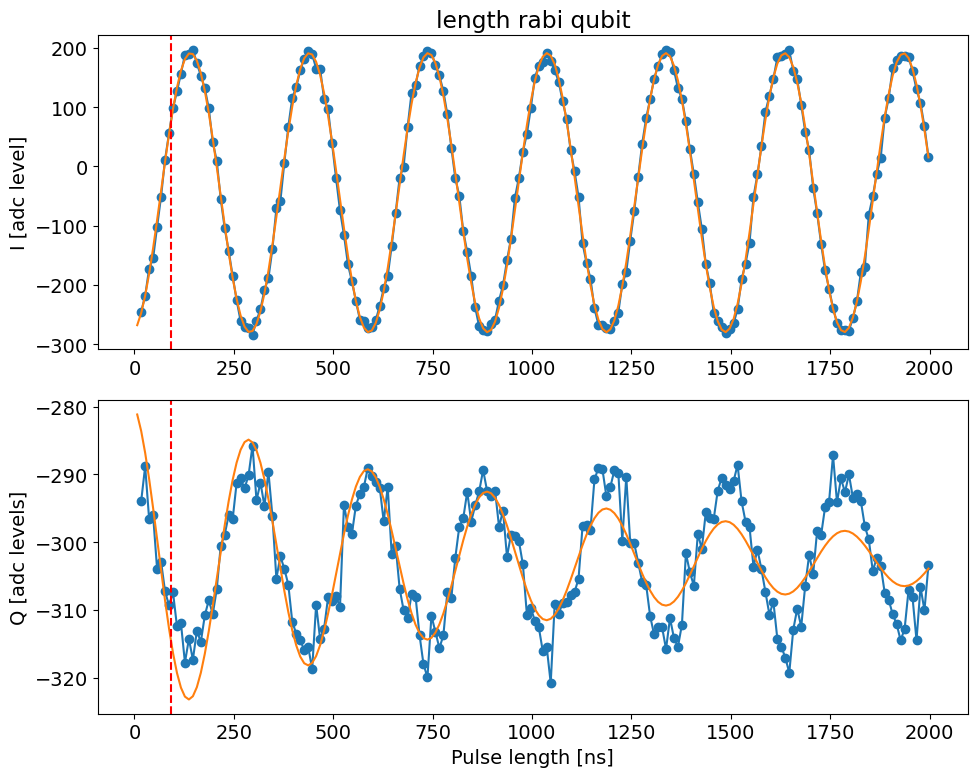

In [146]:
temp_data, attrs = prev_data(expt_path, '00027_LengthRabiGeneralExperiment.h5')
Ilist1 = length_rabi_display(temp_data, fit=True, fitparams=[300, None, None, None, None, None], title='length rabi qubit', 
                    vlines = [1000* 0.09155227039820665], active_reset=False)

Attempted to init fitparam 4 to -37.0978875, which is out of bounds -322.04859090909093 to -282.8464025974026. Instead init to -302.44749675324675
[242.17731472   3.34607077 -76.29756644  71.622509   -44.18563245
  -0.98865567]
Decay from avgi [us] 71.62250900263649
Rate [MHz] 3.346070771537072
Pi length from avgi data [us]: 0.1380537699565266
	Pi/2 length from avgi data [us]: 0.06333927134920682
Fit params:  [242.17731472   3.34607077 -76.29756644  71.622509   -44.18563245
  -0.98865567]

Decay from avgq [us] 1.1358970303612639
Rate [MHz] 3.331437633033404
Pi length from avgq data [us]: 0.13360236111220744
Pi/2 length from avgq data [us]: 0.06680118055610372
Fit params:  [ 150.            3.33143763  109.76834388    1.13589703 -302.24207782
   -1.98302455]


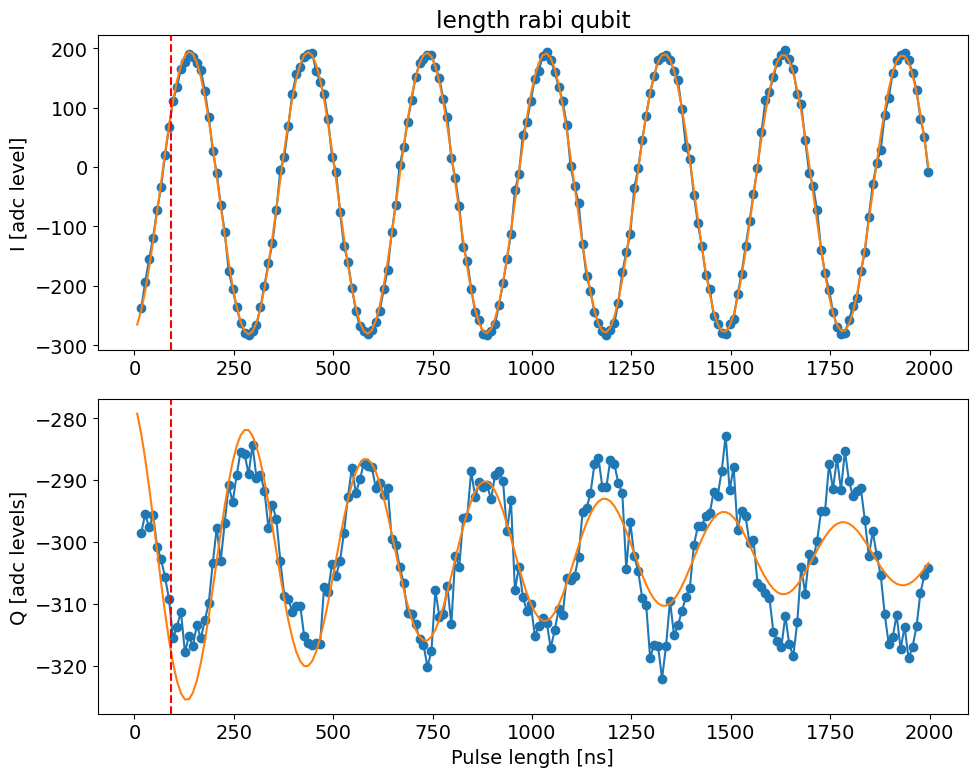

In [147]:
temp_data, attrs = prev_data(expt_path, '00026_LengthRabiGeneralExperiment.h5')
Ilist2 = length_rabi_display(temp_data, fit=True, fitparams=[300, None, None, None, None, None], title='length rabi qubit', 
                    vlines = [1000* 0.09155227039820665], active_reset=False)

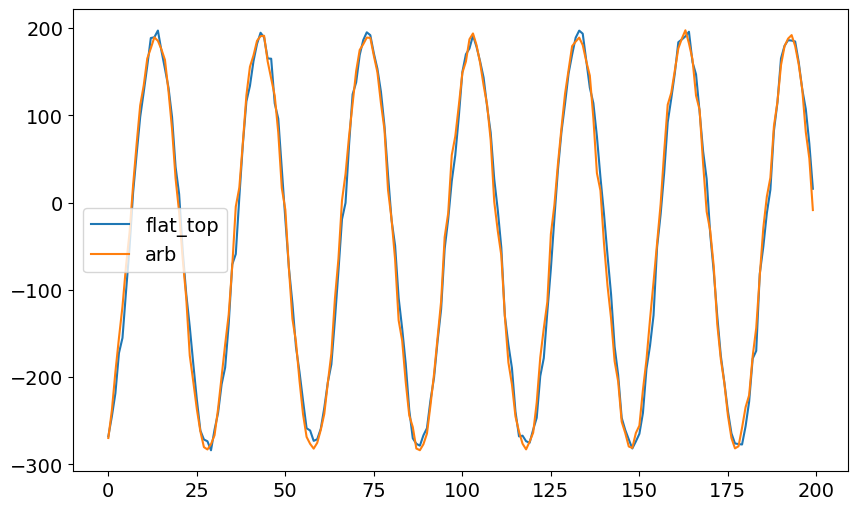

In [151]:
plt.plot(Ilist1, label='flat_top')
plt.plot(Ilist2, label='arb')
plt.legend()

In [785]:
pi_length = 0.1479663656513157
pi2_length =  0.0698555226175473
actual_pi2_length = pi_length - pi2_length
print(f'Actual pi/2 length: {actual_pi2_length}')
print(f'Actual 2pi length: {2*actual_pi2_length + pi_length}')

Actual pi/2 length: 0.07811084303376842
Actual 2pi length: 0.30418805171885255


Decay from avgi [us] 14.341087545266198
Pi length from avgi data [us]: 0.46099715409216324
	Pi/2 length from avgi data [us]: 0.22641573845146365

Decay from avgq [us] 32.3630326786029
Pi length from avgq data [us]: 0.4587602080390284
Pi/2 length from avgq data [us]: 0.2293801040195142


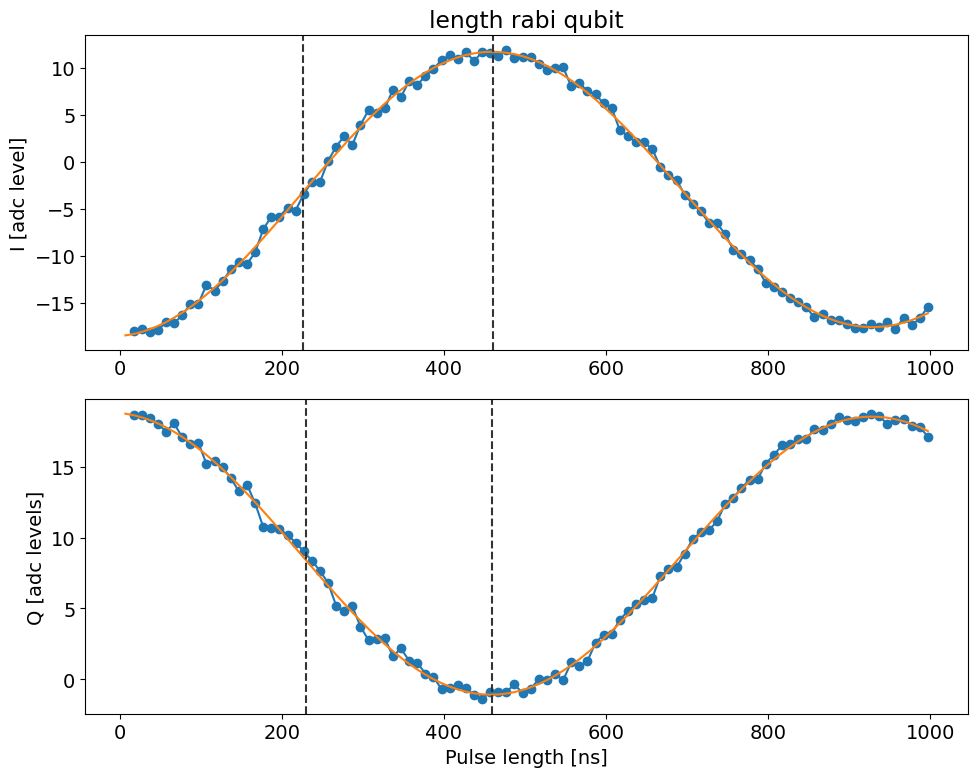

In [806]:
temp_data, attrs = prev_data(expt_path, '00011_LengthRabiGeneralExperiment.h5')
length_rabi_display(temp_data, fit=True, fitparams=None, title='length rabi qubit')

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


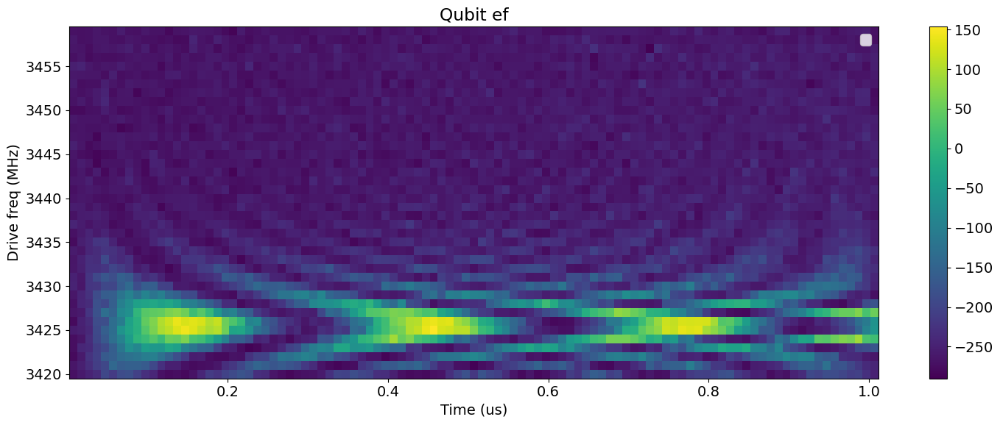

In [52]:
file_list = np.arange(112,152,1)
# file_list = np.arange(72,112,1)
y_list = []
freq_list = []
name = '_length_rabi_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['freq'])

plot_lengthrabi_sweep(len_x, freq_list, np.array(y_list), hlines=[], vlines=None, active_reset=False, readout_per_round=4, threshold=-4.0, title="Qubit ef")
    

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


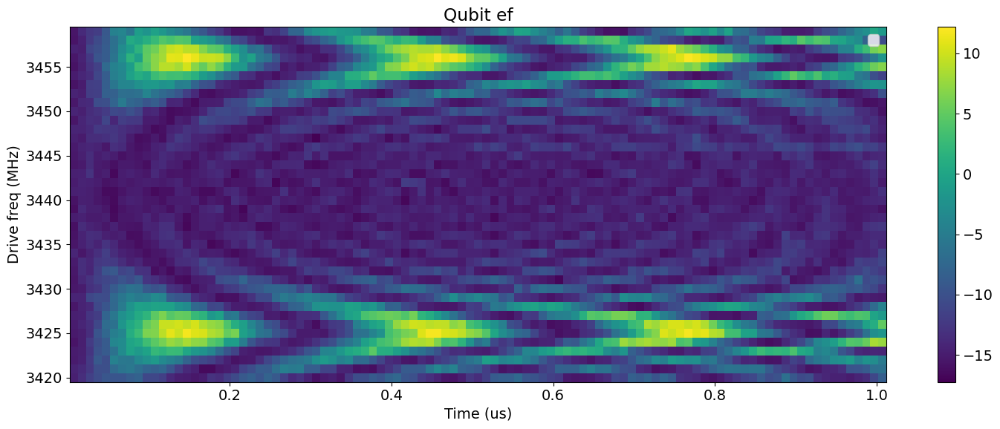

In [49]:
# file_list = np.arange(112,140,1)
file_list = np.arange(72,112,1)
y_list = []
freq_list = []
name = '_length_rabi_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['freq'])

plot_lengthrabi_sweep(len_x, freq_list, np.array(y_list), hlines=[], vlines=None, active_reset=False, readout_per_round=4, threshold=-4.0, title="Qubit ef")
    

### man1 at |1>

Attempted to init fitparam 1 to 5.0, which is out of bounds 0.010101010101010102 to 1.5151515151515151. Instead init to 0.7626262626262627
Decay from avgi [us] 2.9700000000000006
Pi length from avgi data [us]: 0.9776379833434021
	Pi/2 length from avgi data [us]: 0.48881899167170106

Decay from avgq [us] 103.10548773233162
Pi length from avgq data [us]: 6.288721018841144
Pi/2 length from avgq data [us]: 3.144360509420572


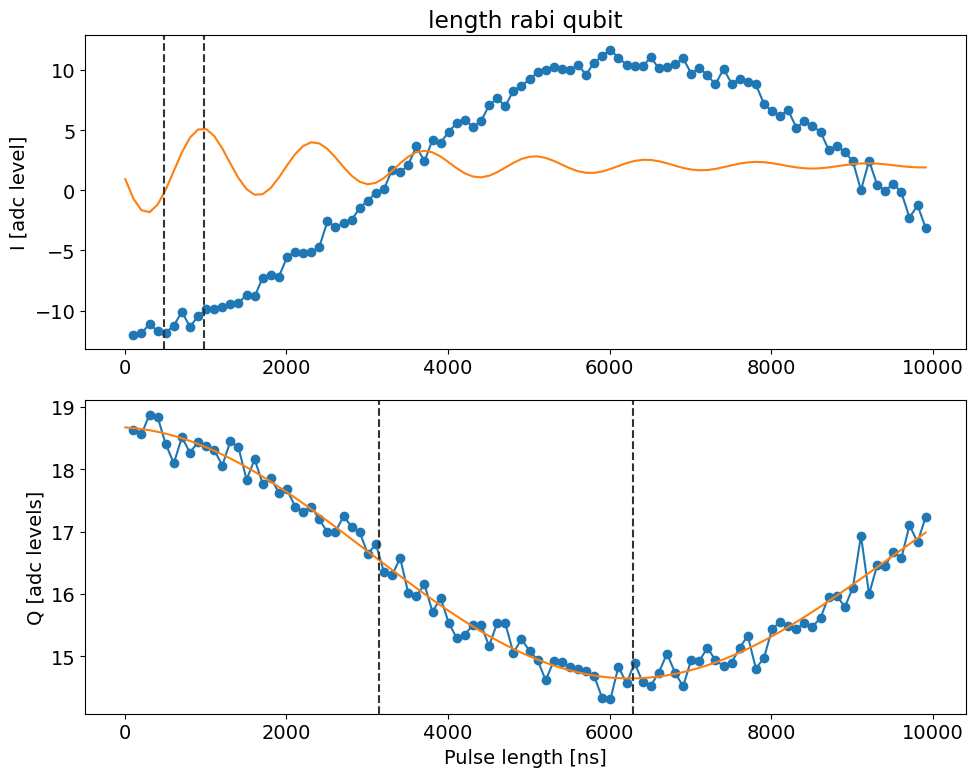

In [132]:
temp_data, attrs = prev_data(expt_path, '00008_LengthRabiGeneralExperiment.h5')
length_rabi_display(temp_data, fit=True, fitparams=None, title='length rabi qubit')

## Cavity spectroscopy

### M1

[4982.9995, 5000, 5000, 0, 0.055391142943433724, 2.851845841557388, 0.009518627160689536]
[ 4.98307387e+03  4.72077962e+03  7.01629450e+00  8.06113490e-02
  3.37353564e-02  2.84872253e+00 -6.04032587e-03]

Freq with minimum transmission: 4983.255
Freq with maximum transmission: 4982.61
From fit:
	f0: 4983.073870251055
	Qi: 4720.779621372072
	Qe: 7.016294495189139
	Q0: 7.005881950037179
	kappa [MHz]: 711.2700307810084
	phi [radians]: 0.08061134900101978


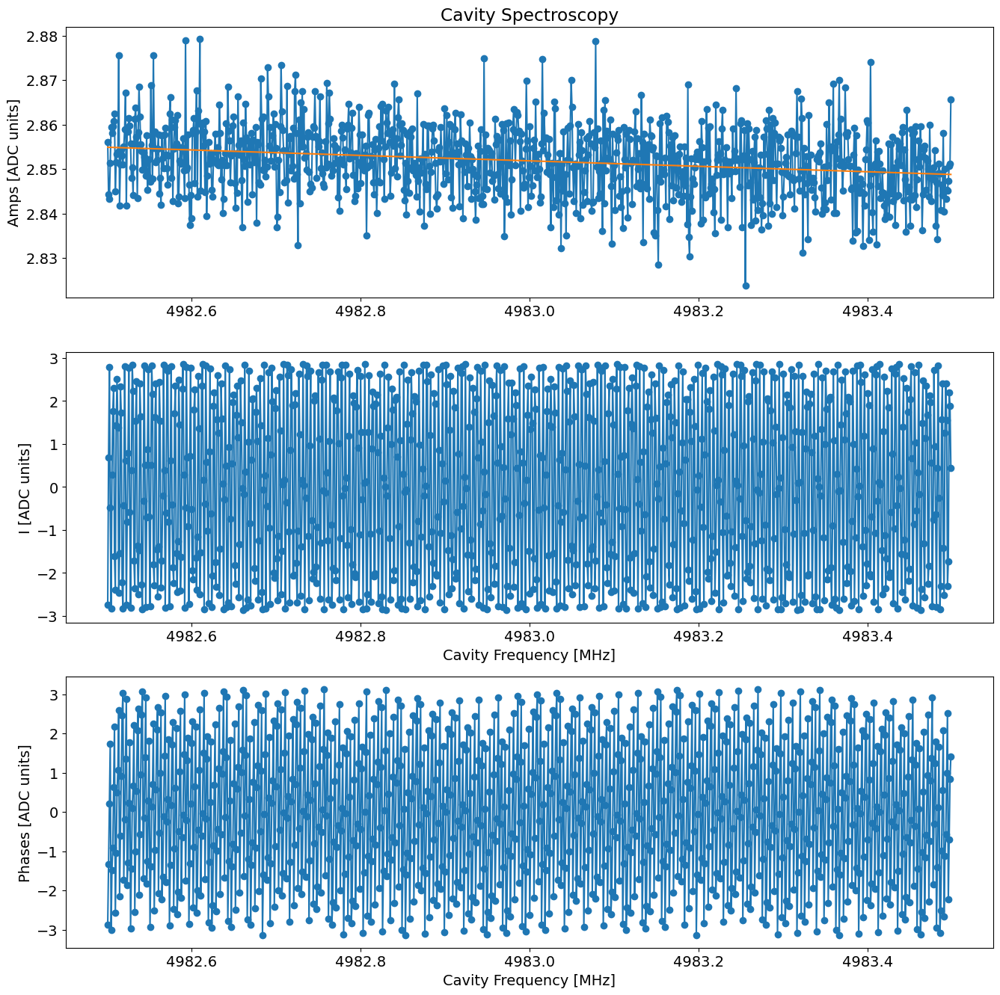

In [392]:
temp_data, attrs = prev_data(expt_path, '00020_CavitySpectroscopyExperiment.h5')
cavity_spec_display(temp_data, findpeaks=False, verbose=True, fitparams=[None, 5000, 5000, None, None, None, None], fit=True)

#### Parity Spectroscopy

Found peak in amps at [MHz] 4984.050520283204, HWHM -1.4706966492133295
Found peak in I at [MHz] 4984.060108640151, HWHM 1.2981951185345002
Found peak in Q at [MHz] 4976.957606502558, HWHM 1435.2677890436942


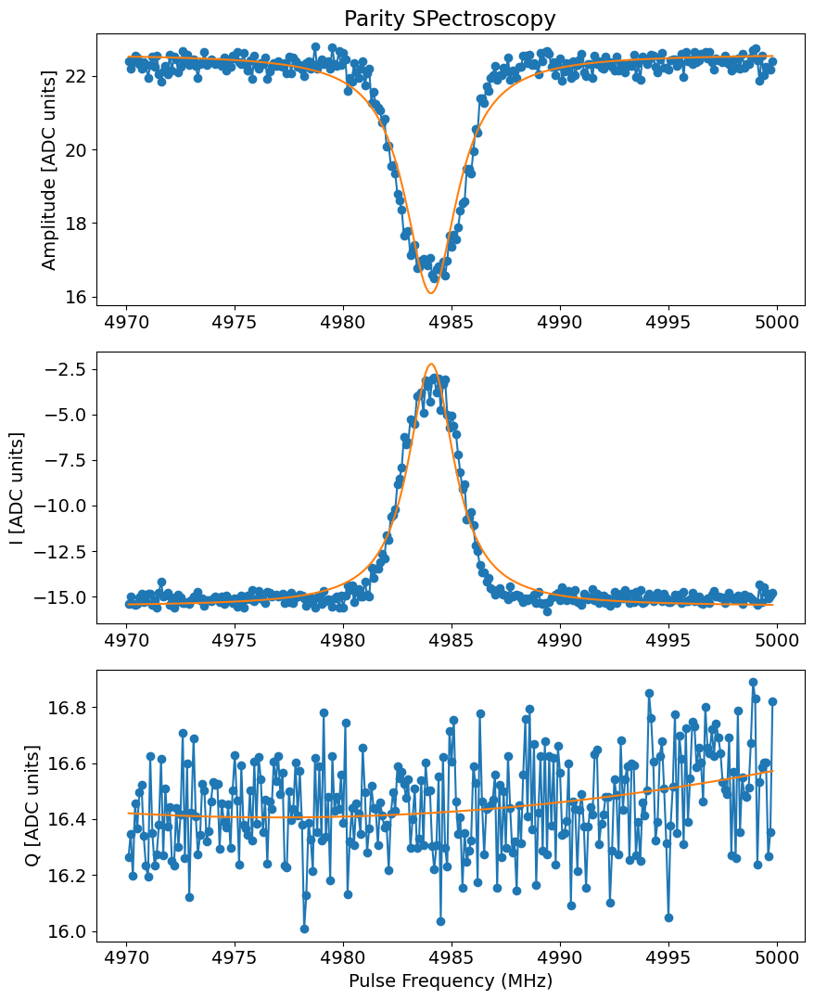

In [25]:
temp_data, attrs = prev_data(expt_path, '00000_ParityFreqExperiment.h5')
spectroscopy_display(temp_data, fit=True, signs=[1,1,1], hlines=None, vlines=None,  title='Parity SPectroscopy')

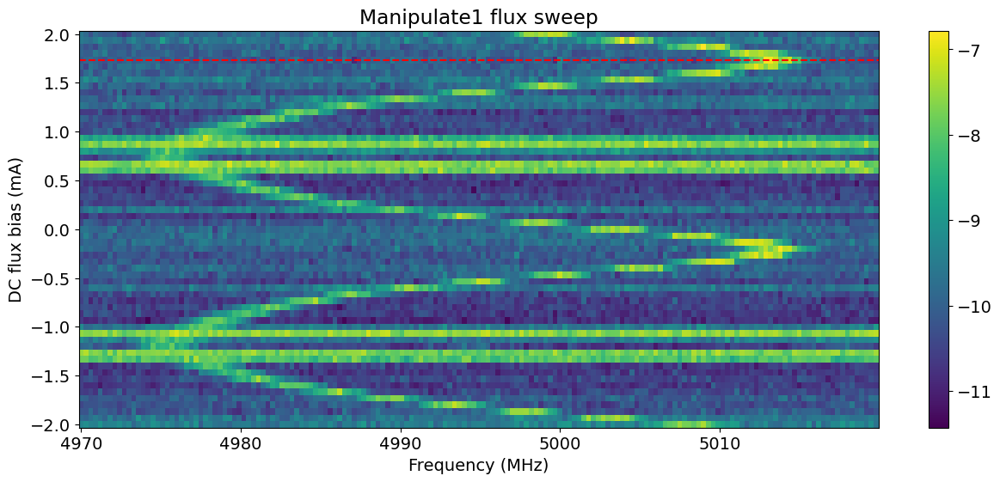

In [718]:
file_list = np.arange(30,91,1)
y_list = []
flux_list = []
# flux_list = np.linspace(-1.25, 0.7, 31)
name = '_manipulate_dc_flux_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    flux_list.append(attrs['config']['expt']['current'])

plot_spectroscopy_sweep(len_x, flux_list, np.array(y_list), hlines=[1.733], vlines=None, title="Manipulate1 flux sweep")

##### Ramsey Sweep

In [416]:
def plot_sideband_sweep(x_timelist, y_freqlist, z_datalist, hlines=None, vlines=None, normalize = None, title="Sideband Sweep"):
    plt.figure(figsize = (15,6))
    plt.subplot(111,xlabel='Time (us)',ylabel='Drive freq (MHz)')
    plt.title(title)
    cax = plt.pcolormesh(x_timelist,y_freqlist[:z_datalist.shape[0]],z_datalist)
    cbar = plt.colorbar()



    if vlines is not None:
        for vline in vlines:
            plt.axvline(vline, color='r', ls='--', label = str(vline))
    if hlines is not None:
        for hline in hlines:
            plt.axhline(hline, color='r', ls='--', label = str(hline))
    plt.legend()
    plt.tight_layout()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


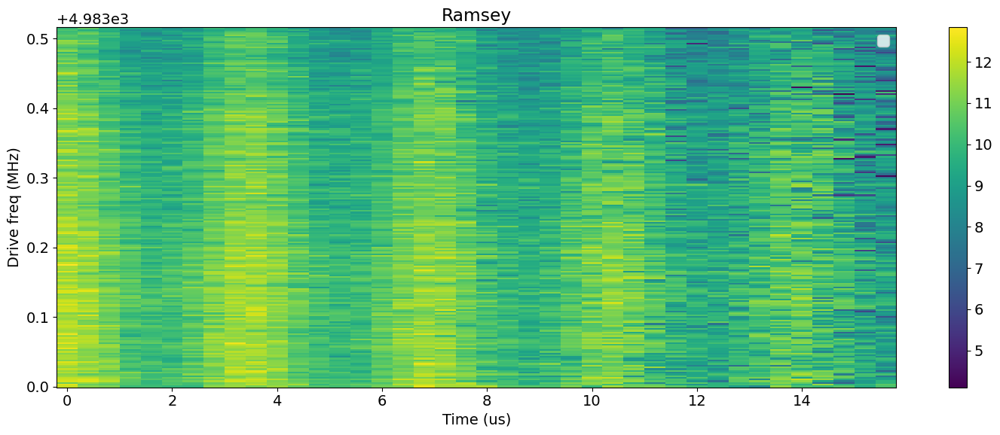

In [453]:
file_list = np.arange(3,210,1)
y_list = []
freq_list = []
name = '_ramsey_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    freq_list.append(attrs['config']['expt']['pre_sweep_pulse'][0][0])

plot_sideband_sweep(len_x, freq_list, np.array(y_list), hlines=[], vlines=None, title="Ramsey")
    

### M2

Found peak in amps at [MHz] 5157.839604515955, HWHM -1.175023737819997
Found peak in I at [MHz] 5157.841815837218, HWHM -1.0987187351754362
Found peak in Q at [MHz] 5157.854209661388, HWHM -1.0511346251119946


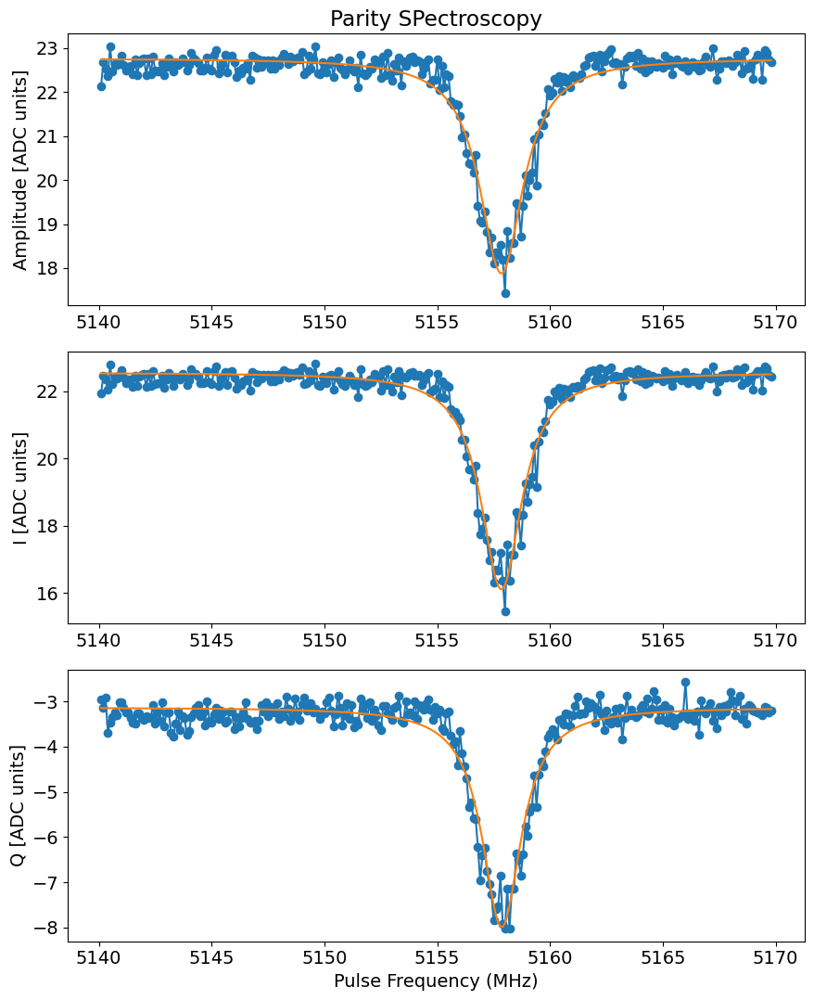

In [19]:
temp_data, attrs = prev_data(expt_path, '00001_ParityFreqExperiment.h5')
spectroscopy_display(temp_data, fit=True, signs=[1,1,1], hlines=None, vlines=None,  title='Parity SPectroscopy')

[5159.998500000001, 5000, 5000, 0, 2.499985120908949, 22.14774748438989, 0.4153390334929126]

Freq with minimum transmission: 5157.009
Freq with maximum transmission: 5162.991
From fit:
	f0: 5159.998500000001
	Qi: 5000
	Qe: 5000
	Q0: 2500.0
	kappa [MHz]: 2.0639994
	phi [radians]: 0


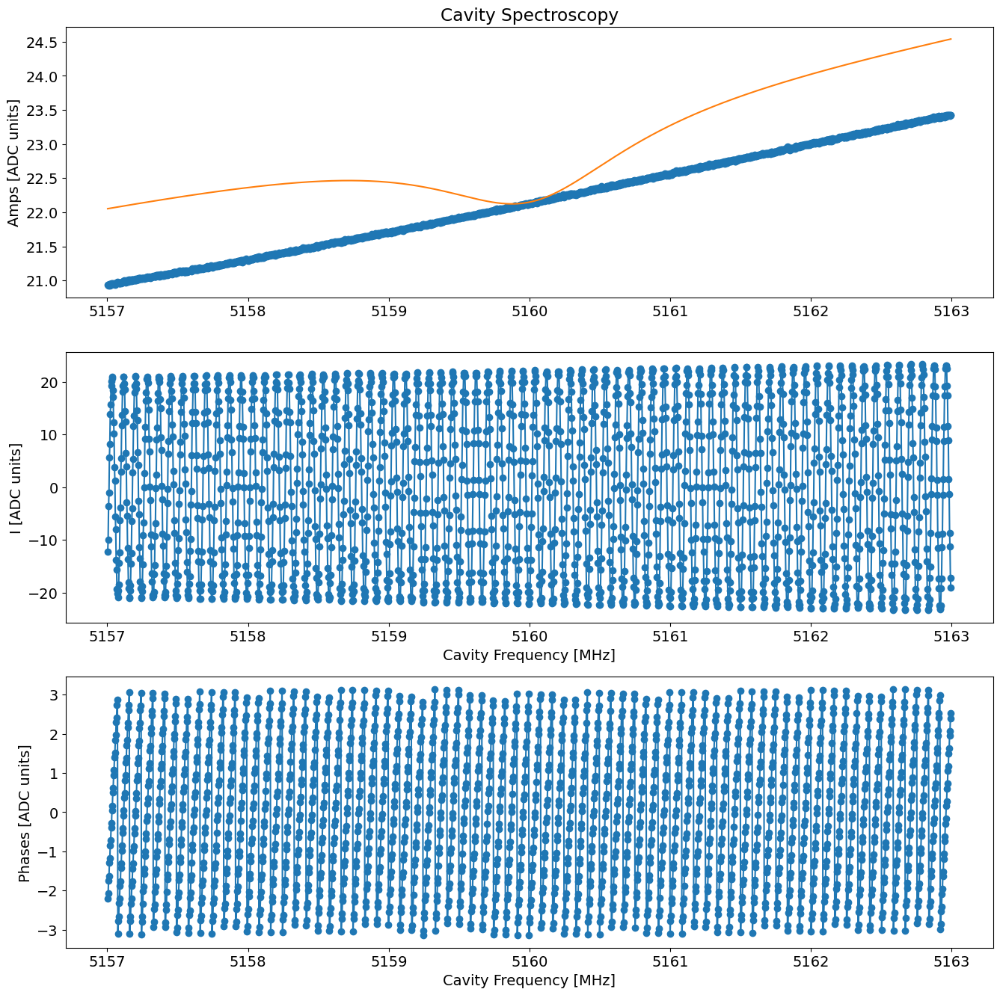

In [221]:
temp_data, attrs = prev_data(expt_path, '00010_CavitySpectroscopyExperiment.h5')
cavity_spec_display(temp_data, findpeaks=False, verbose=True, fitparams=[None, 5000, 5000, None, None, None, None], fit=True)

Found peak in amps at [MHz] 5157.921539709281, HWHM -1.574283957586095
Found peak in I at [MHz] 5157.923192671654, HWHM 1.4326883155769305
Found peak in Q at [MHz] 5157.980609127782, HWHM -1.4234051583826253


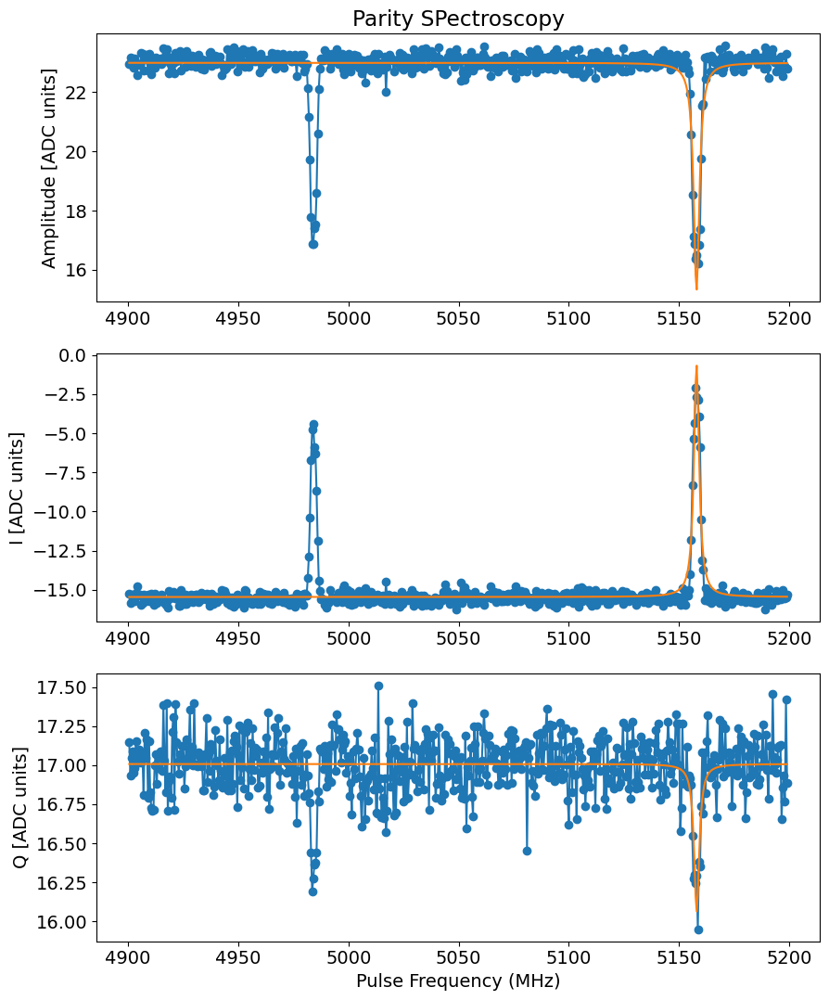

In [458]:
temp_data, attrs = prev_data(expt_path, '00007_ParityFreqExperiment.h5')
spectroscopy_display(temp_data, fit=True, signs=[1,1,1], hlines=None, vlines=None,  title='Parity SPectroscopy')

[5160.499000000001, 5000, 5000, 0, 0.2155517065553001, 4.976577247364358, 0.09605737996150189]
[5.16039921e+03 2.60880254e+04 3.94437858e+06 5.88747609e-01
 7.79154862e+00 4.92166963e+00 1.02495215e-01]

Freq with minimum transmission: 5159.524
Freq with maximum transmission: 5161.424
From fit:
	f0: 5160.399213932691
	Qi: 26088.025380186788
	Qe: 3944378.581200437
	Q0: 25916.613519648967
	kappa [MHz]: 0.19911549053352504
	phi [radians]: 0.5887476093129803


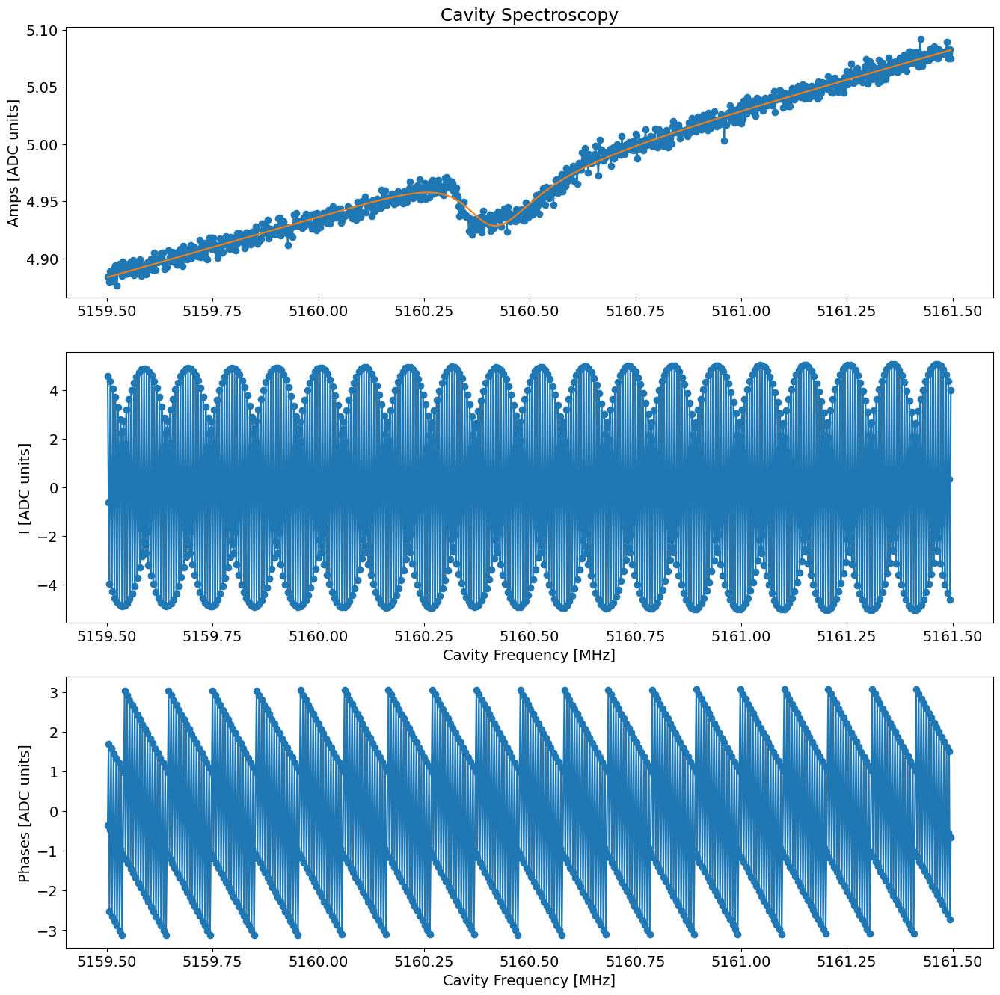

In [408]:
temp_data, attrs = prev_data(expt_path, '00018_CavitySpectroscopyExperiment.h5')
cavity_spec_display(temp_data, findpeaks=False, verbose=True, fitparams=[None, 5000, 5000, None, None, None, None], fit=True)

### S1

[5329.295999999999, 5000, 5000, 0, 0.09327018952439659, 2.7737766046504273, 0.019844028178172837]
[5.32924502e+03 5.43655755e+04 3.99108992e+06 1.48393704e-01
 1.95309781e+00 2.74774474e+00 1.53922260e-02]

Freq with minimum transmission: 5327.34
Freq with maximum transmission: 5331.284000000001
From fit:
	f0: 5329.245020382877
	Qi: 54365.57545557168
	Qe: 3991089.9235552195
	Q0: 53634.97397068618
	kappa [MHz]: 0.0993613798208523
	phi [radians]: 0.14839370381906072


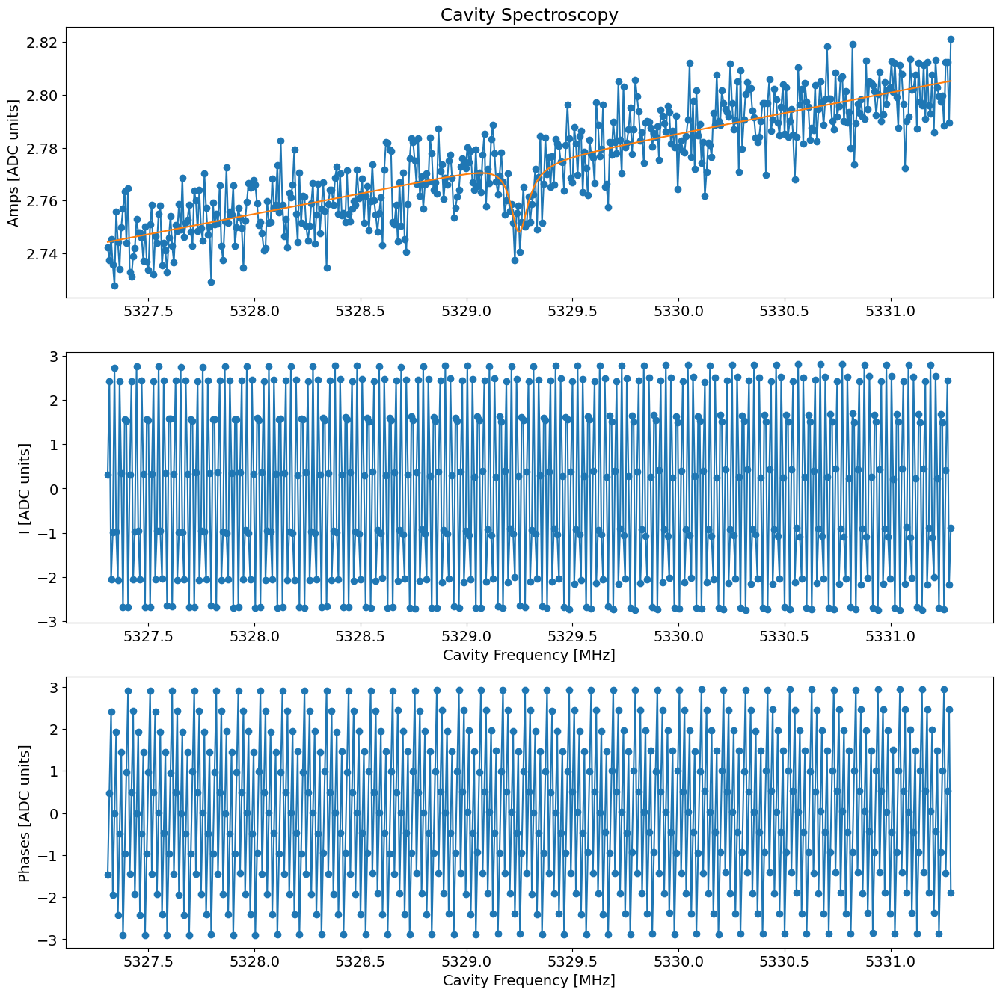

In [22]:
temp_data, attrs = prev_data(expt_path, '00043_CavitySpectroscopyExperiment.h5')
cavity_spec_display(temp_data, findpeaks=False, verbose=True, fitparams=[None, 5000, 5000, None, None, None, None], fit=True)

### S2

[5499.9975, 5000, 5000, 0, 0.09449713233001544, 3.9646628459277156, -0.0015012841101524925]

Freq with minimum transmission: 5501.535
Freq with maximum transmission: 5495.66
From fit:
	f0: 5499.9975
	Qi: 5000
	Qe: 5000
	Q0: 2500.0
	kappa [MHz]: 2.1999990000000005
	phi [radians]: 0


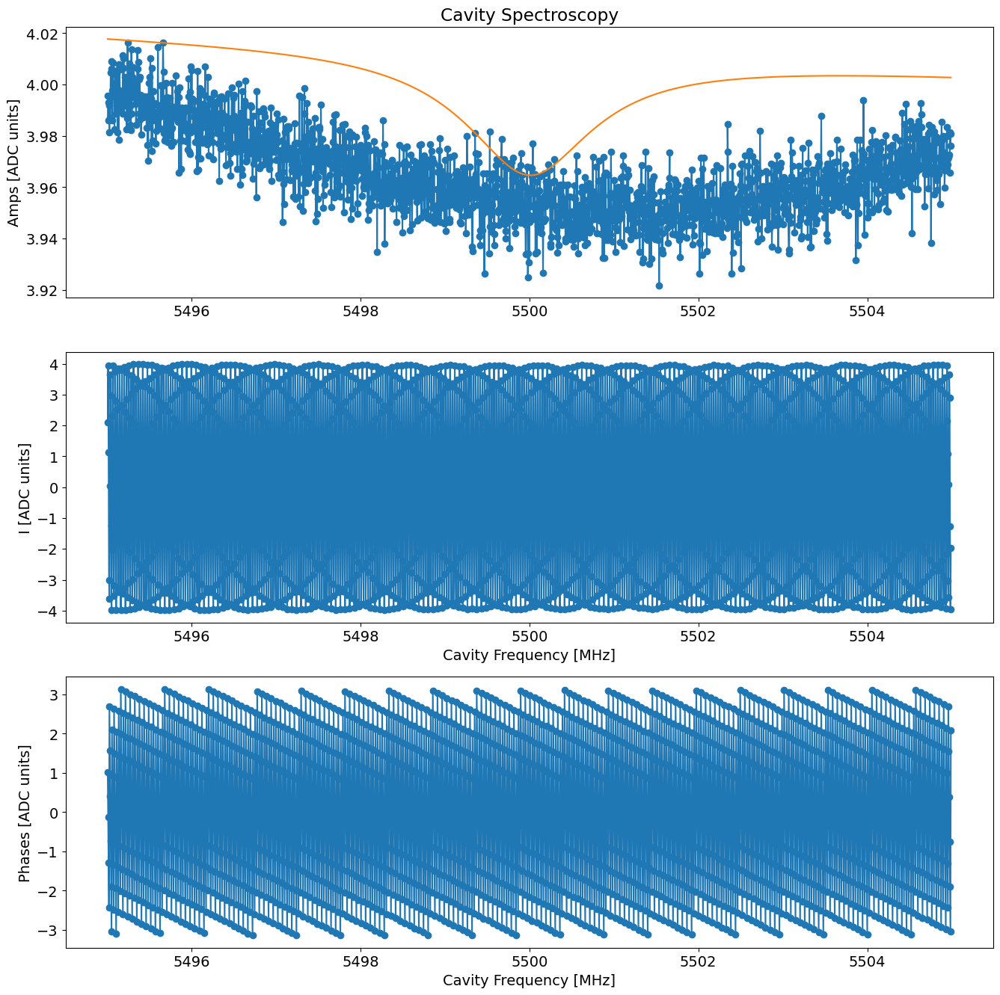

In [28]:
temp_data, attrs = prev_data(expt_path, '00049_CavitySpectroscopyExperiment.h5')
cavity_spec_display(temp_data, findpeaks=False, verbose=True, fitparams=[None, 5000, 5000, None, None, None, None], fit=True)

### S3

[5651.99, 5000, 5000, 0, 0.3970238008510263, 6.001526266939286, 0.03848253093346977]

Freq with minimum transmission: 5647.12
Freq with maximum transmission: 5656.96
From fit:
	f0: 5651.99
	Qi: 5000
	Qe: 5000
	Q0: 2500.0
	kappa [MHz]: 2.260796
	phi [radians]: 0


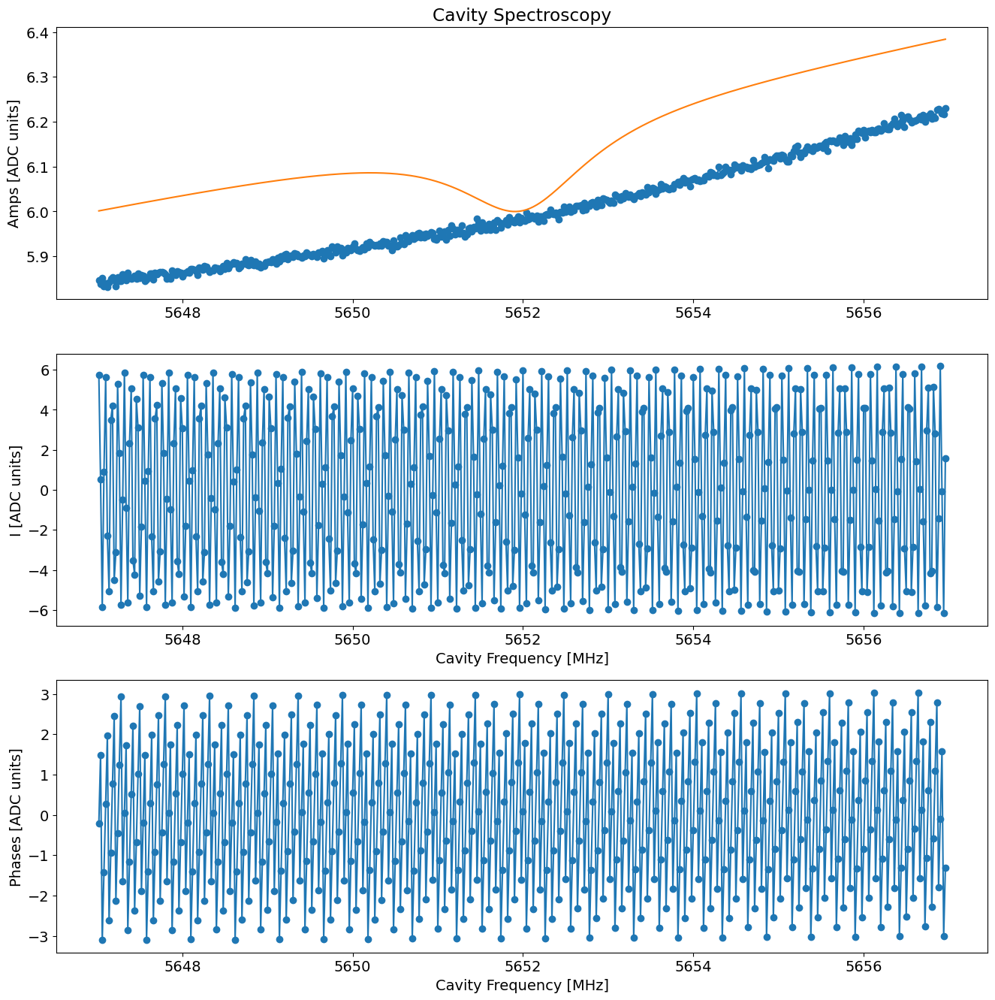

In [34]:
temp_data, attrs = prev_data(expt_path, '00054_CavitySpectroscopyExperiment.h5')
cavity_spec_display(temp_data, findpeaks=False, verbose=True, fitparams=[None, 5000, 5000, None, None, None, None], fit=True)

### S4

[5868.365300288982, 5000, 5000, 0, 0.4169179413368429, 14.55018156905914, 0.08267713693328468]
[ 5.87037646e+03  2.78627681e+07  4.96093931e+02 -6.64370249e-01
  2.08733009e-01  1.45937274e+01  6.04923357e-02]

Freq with minimum transmission: 5865.962800288982
Freq with maximum transmission: 5870.8478002889815
From fit:
	f0: 5870.376459551001
	Qi: 27862768.074746165
	Qe: 496.0939307456811
	Q0: 496.08509799777926
	kappa [MHz]: 11.833406170118982
	phi [radians]: -0.6643702487347428


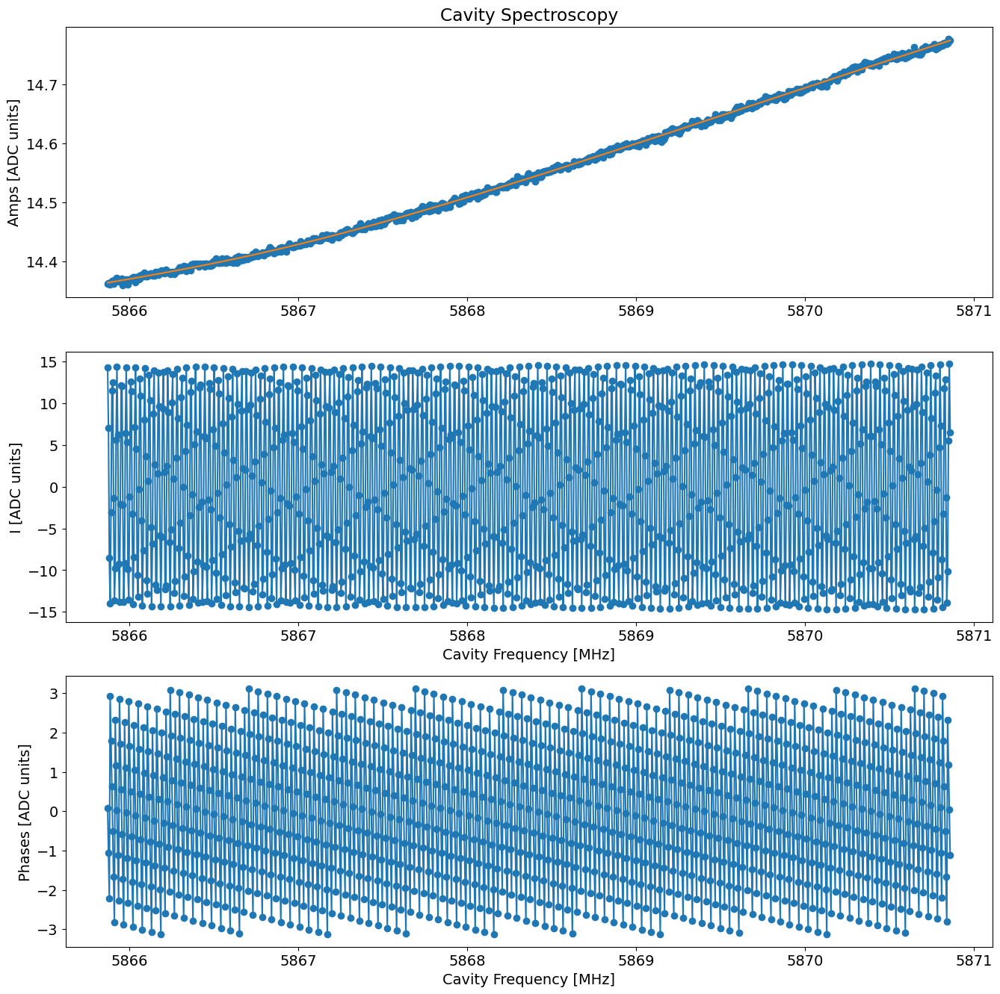

In [94]:
temp_data, attrs = prev_data(expt_path, '00005_CavitySpectroscopyExperiment.h5')
cavity_spec_display(temp_data, findpeaks=False, verbose=True, fitparams=[None, 5000, 5000, None, None, None, None], fit=True)

### S5

[6036.247, 5000, 5000, 0, 0.1747913831791319, 8.438167231623392, -0.1147345436981377]
[ 6.03627265e+03  4.31670904e+03 -7.73329390e+04 -1.48607048e-03
  3.40998810e-06  8.43556268e+00 -1.01569744e-01]

Freq with minimum transmission: 6036.976
Freq with maximum transmission: 6035.542
From fit:
	f0: 6036.2726521134655
	Qi: 4316.709043840474
	Qe: -77332.93899695927
	Q0: 4571.912263469019
	kappa [MHz]: 1.32029494536567
	phi [radians]: -0.0014860704830975085


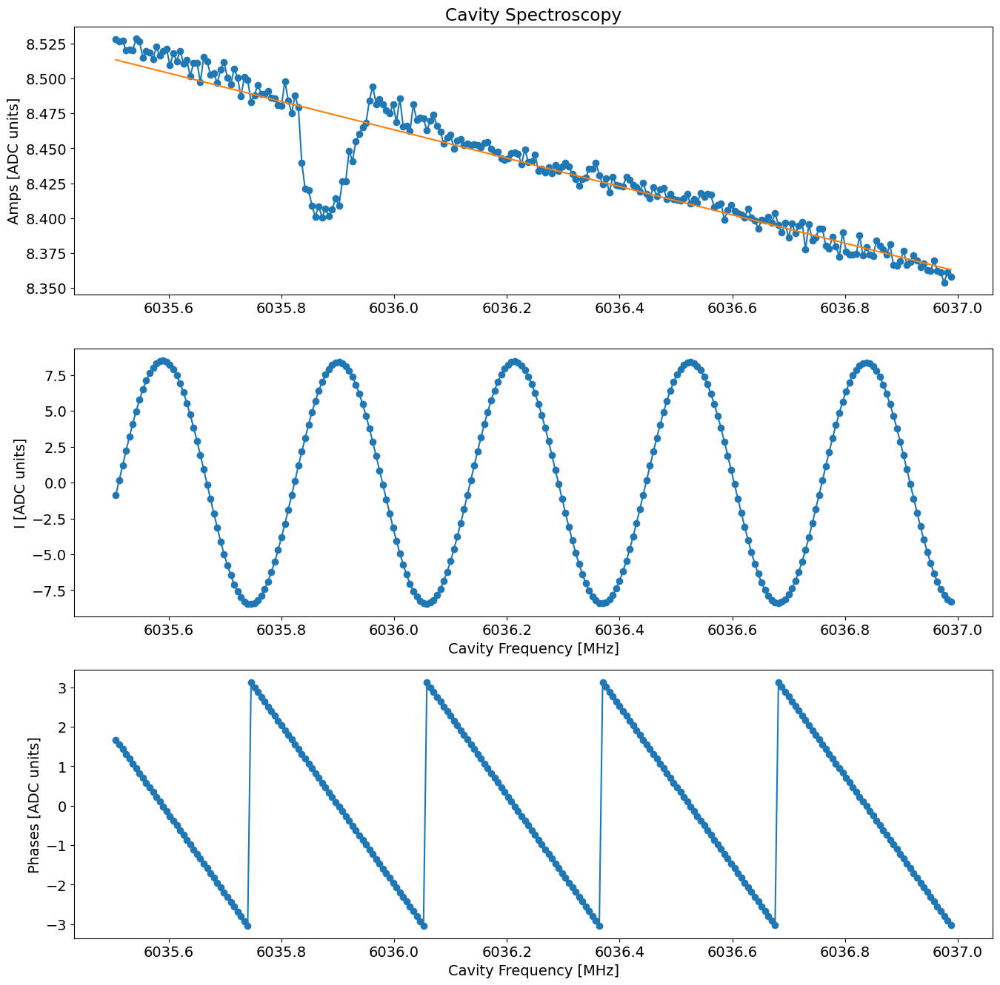

In [431]:
temp_data, attrs = prev_data(expt_path, '00033_CavitySpectroscopyExperiment.h5')
cavity_spec_display(temp_data, findpeaks=False, verbose=True, fitparams=[None, 5000, 5000, None, None, None, None], fit=True)

### S6

[6229.998, 5000, 5000, 0, 0.100577852480496, 0.9117655887156833, -0.006714678834033573]
[ 6.22976069e+03  4.77448023e+04  5.60822312e+06 -9.14468149e-02
  5.79514529e+00  8.69356301e-01 -7.42431289e-03]

Freq with minimum transmission: 6229.756
Freq with maximum transmission: 6229.34
From fit:
	f0: 6229.760692972176
	Qi: 47744.802349518344
	Qe: 5608223.11585577
	Q0: 47341.76502958286
	kappa [MHz]: 0.13159122160061695
	phi [radians]: -0.09144681486422693


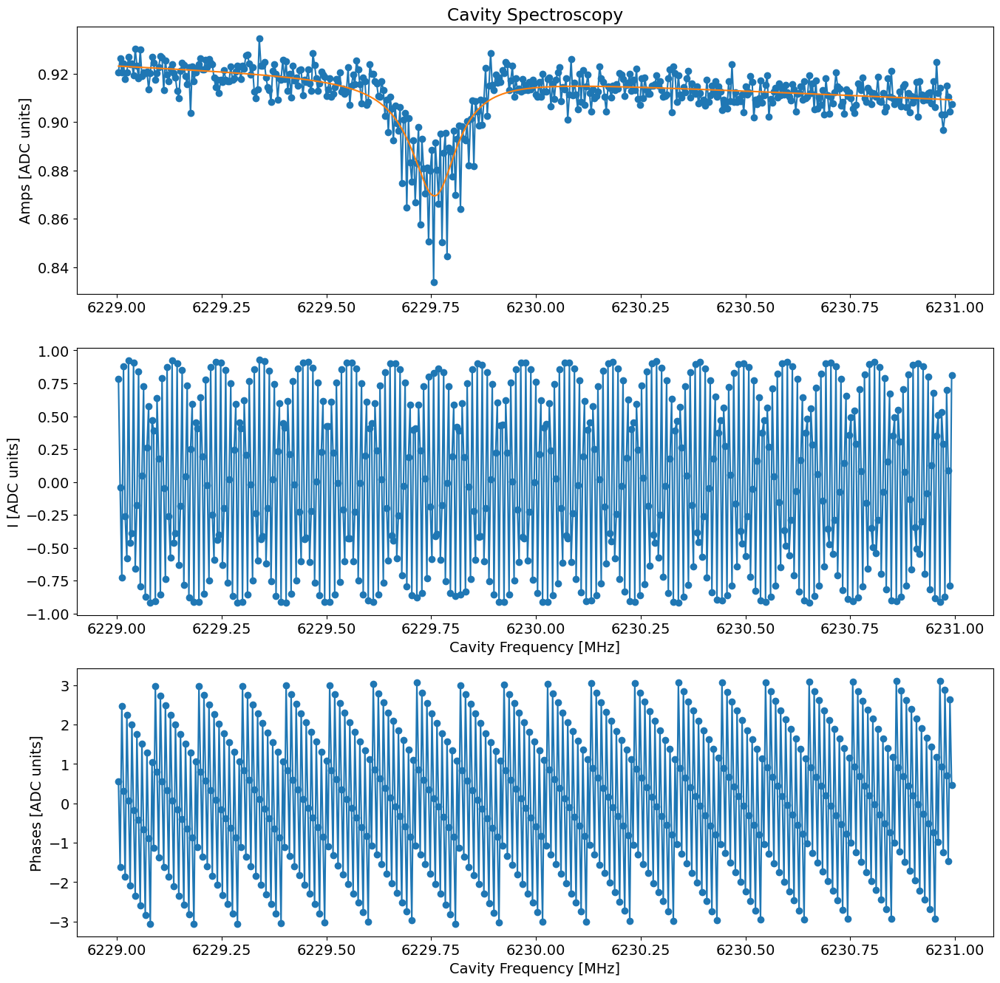

In [228]:
temp_data, attrs = prev_data(expt_path, '00049_CavitySpectroscopyExperiment.h5')
cavity_spec_display(temp_data, findpeaks=False, verbose=True, fitparams=[None, 5000, 5000, None, None, None, None], fit=True)

### S7

[6407.998, 5000, 5000, 0, 0.10798718565907683, 0.9751339519287148, 0.006521115659860144]
[6.40826388e+03 4.90341843e+04 5.91952977e+06 2.02259909e-01
 7.65478347e+00 9.20520458e-01 9.03462157e-03]

Freq with minimum transmission: 6408.248
Freq with maximum transmission: 6408.844
From fit:
	f0: 6408.2638789532475
	Qi: 49034.18432728494
	Qe: 5919529.771640579
	Q0: 48631.348527856484
	kappa [MHz]: 0.13177228419406334
	phi [radians]: 0.20225990856947504


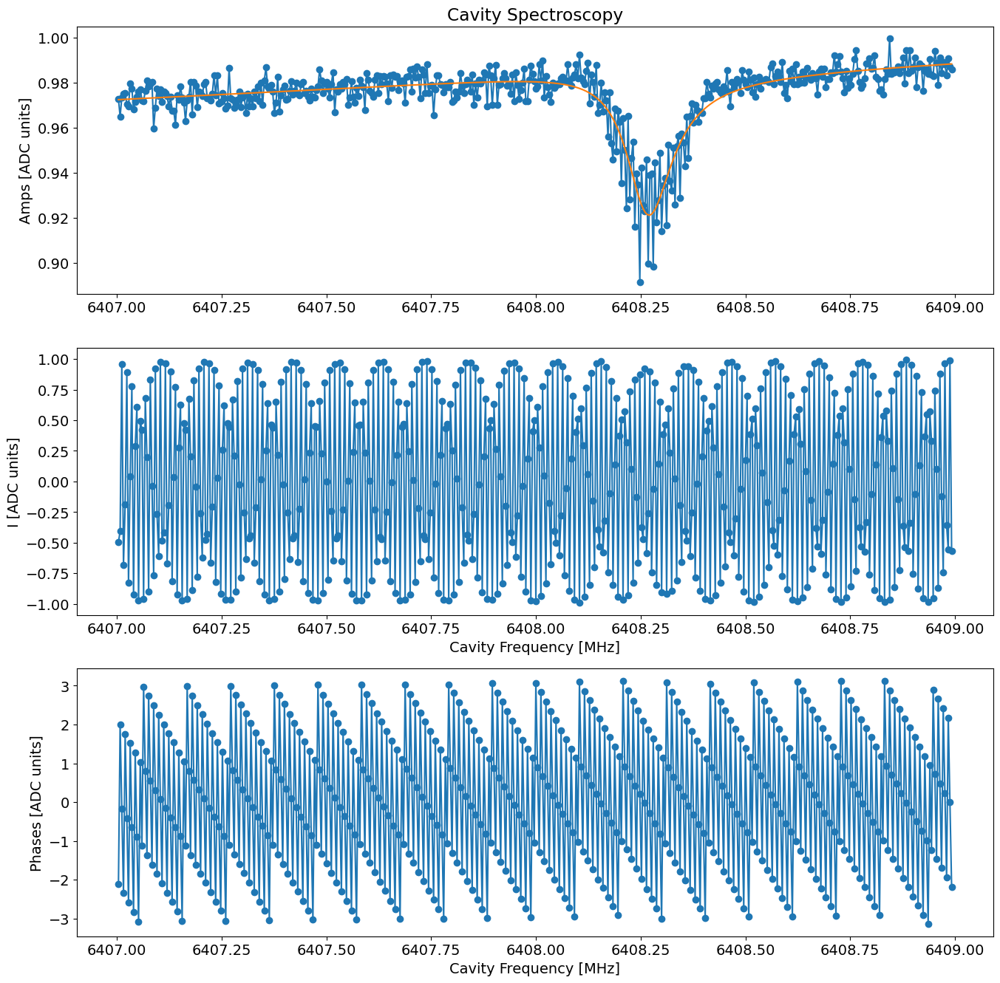

In [229]:
temp_data, attrs = prev_data(expt_path, '00050_CavitySpectroscopyExperiment.h5')
cavity_spec_display(temp_data, findpeaks=False, verbose=True, fitparams=[None, 5000, 5000, None, None, None, None], fit=True)

### S8

[6587.998, 5000, 5000, 0, 0.09148834618486246, 1.0318532045204607, 0.0056997715276935566]
[6.58830545e+03 5.46670931e+04 5.65556384e+06 2.00687289e-01
 4.02439773e+00 9.97375843e-01 2.40824142e-03]

Freq with minimum transmission: 6588.288
Freq with maximum transmission: 6587.388
From fit:
	f0: 6588.305450199396
	Qi: 54667.093087709974
	Qe: 5655563.844894505
	Q0: 54143.73578410566
	kappa [MHz]: 0.12168176714790795
	phi [radians]: 0.20068728912344994


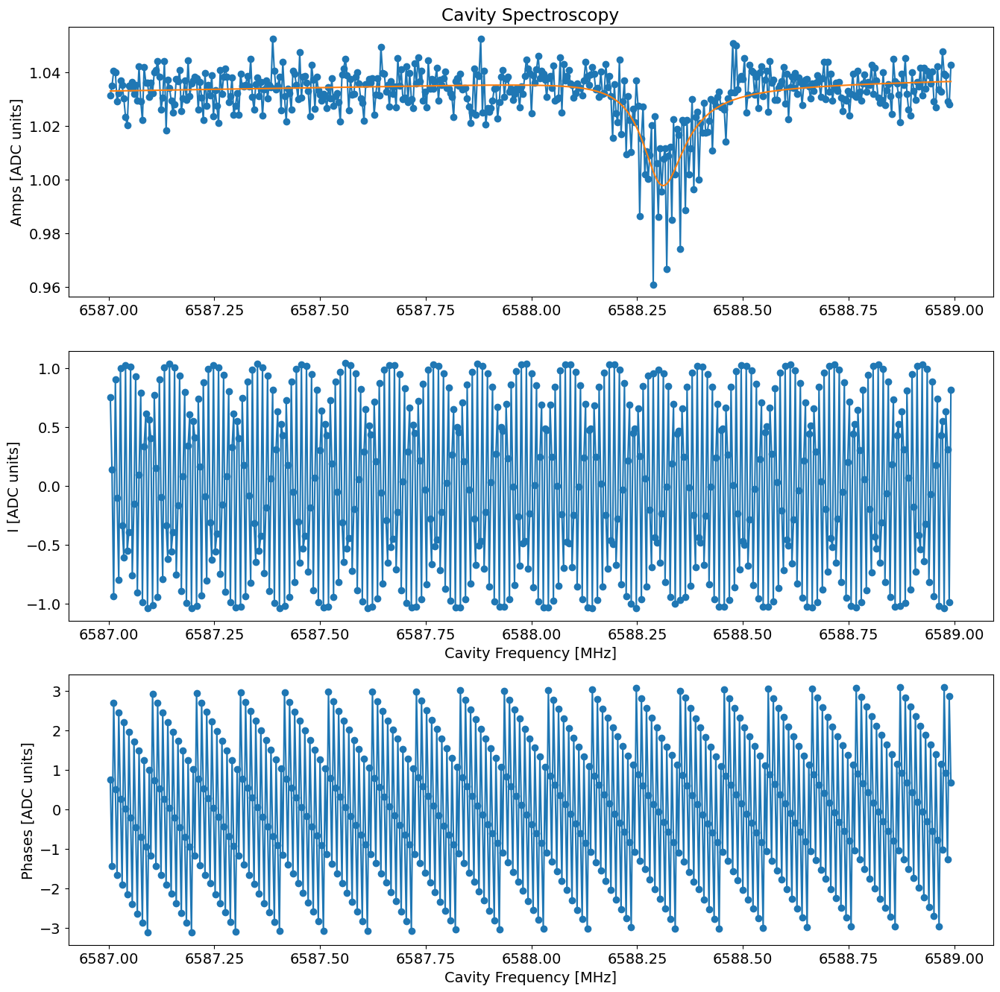

In [230]:
temp_data, attrs = prev_data(expt_path, '00051_CavitySpectroscopyExperiment.h5')
cavity_spec_display(temp_data, findpeaks=False, verbose=True, fitparams=[None, 5000, 5000, None, None, None, None], fit=True)

### S9

[6766, 3000, 3000, 0, 0.1587470030389957, 4.6897905440524115, -0.020455260649759832]
Attempted to init fitparam 0 to 6766, which is out of bounds 6766.201 to 6766.697999999999. Instead init to 6766.4495

Freq with minimum transmission: 6766.401
Freq with maximum transmission: 6766.218
From fit:
	f0: 6766.4495
	Qi: 3000
	Qe: 3000
	Q0: 1500.0
	kappa [MHz]: 4.510966333333333
	phi [radians]: 0


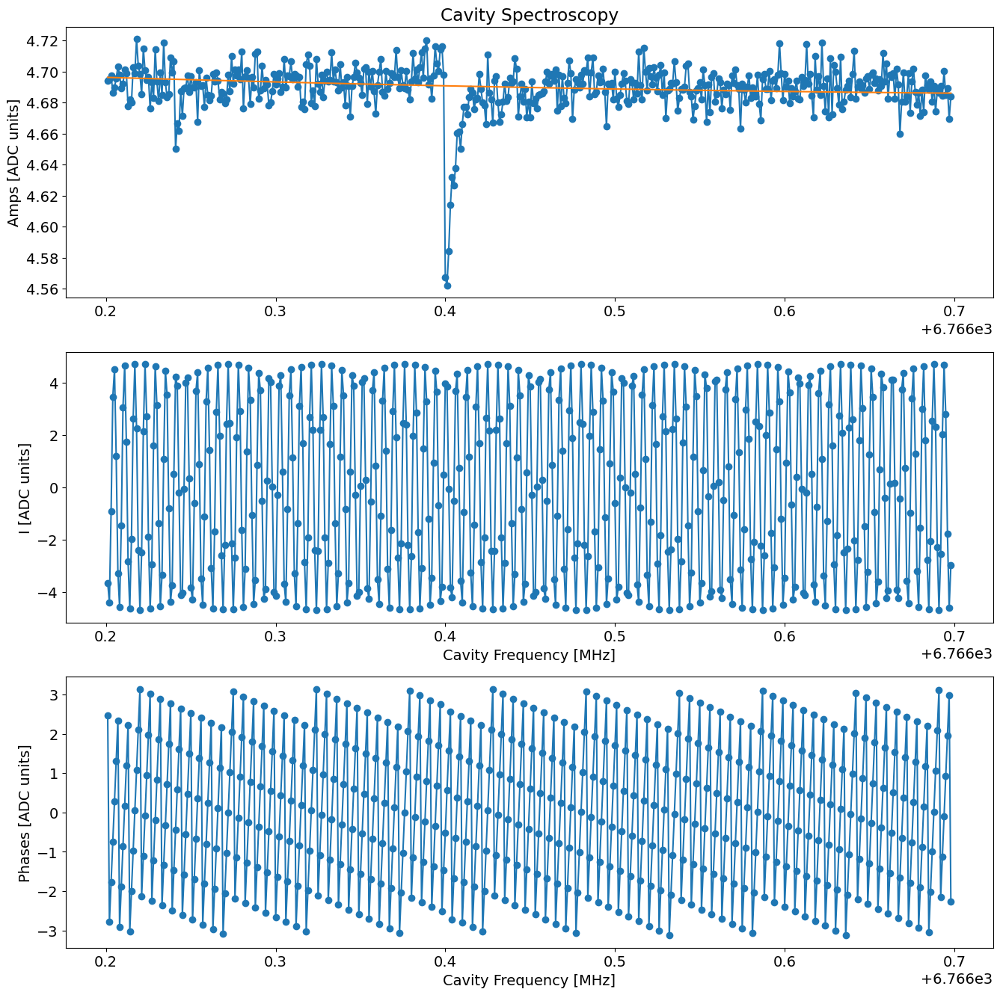

In [242]:
temp_data, attrs = prev_data(expt_path, '00060_CavitySpectroscopyExperiment.h5')
cavity_spec_display(temp_data, findpeaks=False, verbose=True, fitparams=[6766, 3000, 3000, None, None, None, None], fit=True)

### S10

[7339.9980000000005, 3000, 3000, 0, 0.10517358207307825, 0.8726385780732591, 0.008887851823398341]
[ 7.33985412e+03  3.54187788e+05  4.94399131e+04 -4.89536594e-02
  5.63523062e-02  8.27854461e-01 -1.82938705e-03]

Freq with minimum transmission: 7339.852
Freq with maximum transmission: 7340.608
From fit:
	f0: 7339.8541203887835
	Qi: 354187.78793133143
	Qe: 49439.91306579563
	Q0: 43384.07250303201
	kappa [MHz]: 0.16918315171716114
	phi [radians]: -0.048953659361168585


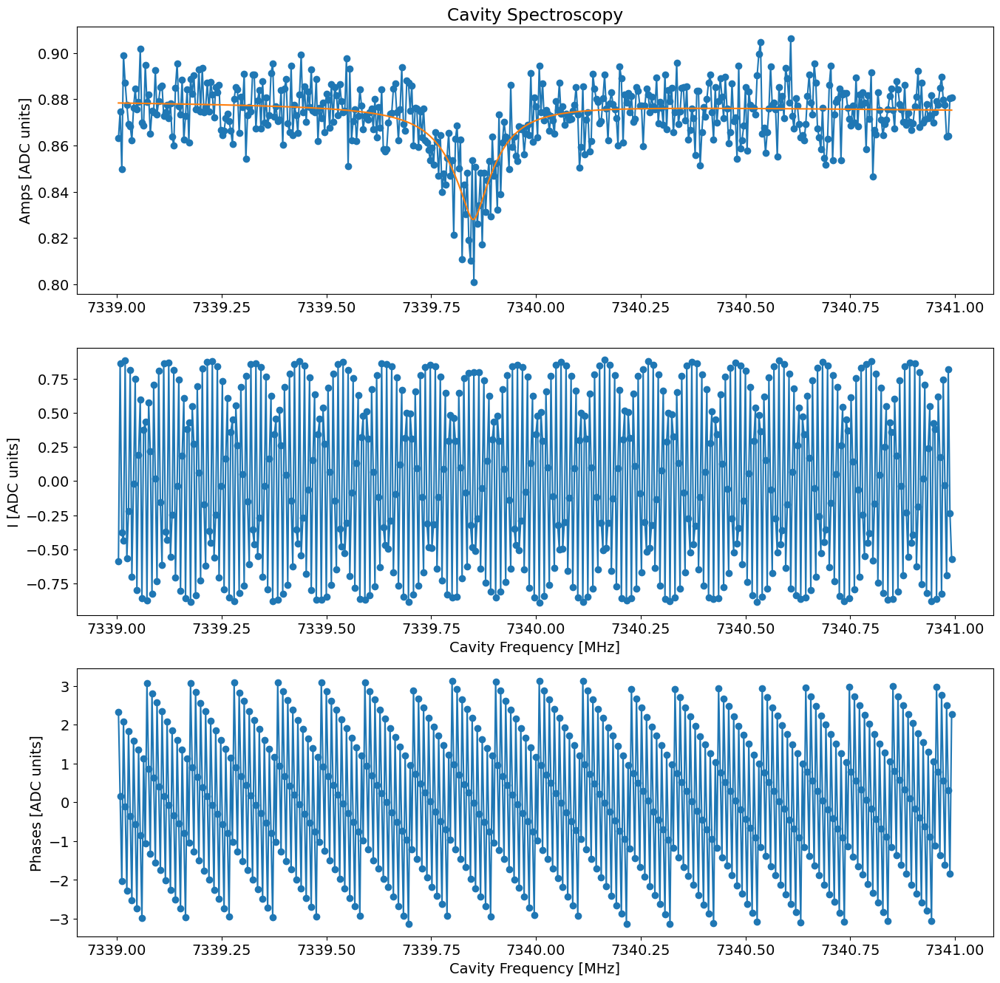

In [245]:
temp_data, attrs = prev_data(expt_path, '00062_CavitySpectroscopyExperiment.h5')
cavity_spec_display(temp_data, findpeaks=False, verbose=True, fitparams=[None, 3000, 3000, None, None, None, None], fit=True)

### S11

[7536.4980000000005, 3000, 3000, 0, 0.09237858972649976, 0.41001954907162524, 0.0030311903422297263]
[ 7.53645696e+03  6.29308696e+04  8.53992380e+06 -4.26834067e-01
  5.51837741e+00  3.72925872e-01  9.44107946e-04]

Freq with minimum transmission: 7536.4
Freq with maximum transmission: 7536.936
From fit:
	f0: 7536.45696063941
	Qi: 62930.86958280553
	Qe: 8539923.795661207
	Q0: 62470.52304662052
	kappa [MHz]: 0.12064020906332257
	phi [radians]: -0.42683406671797575


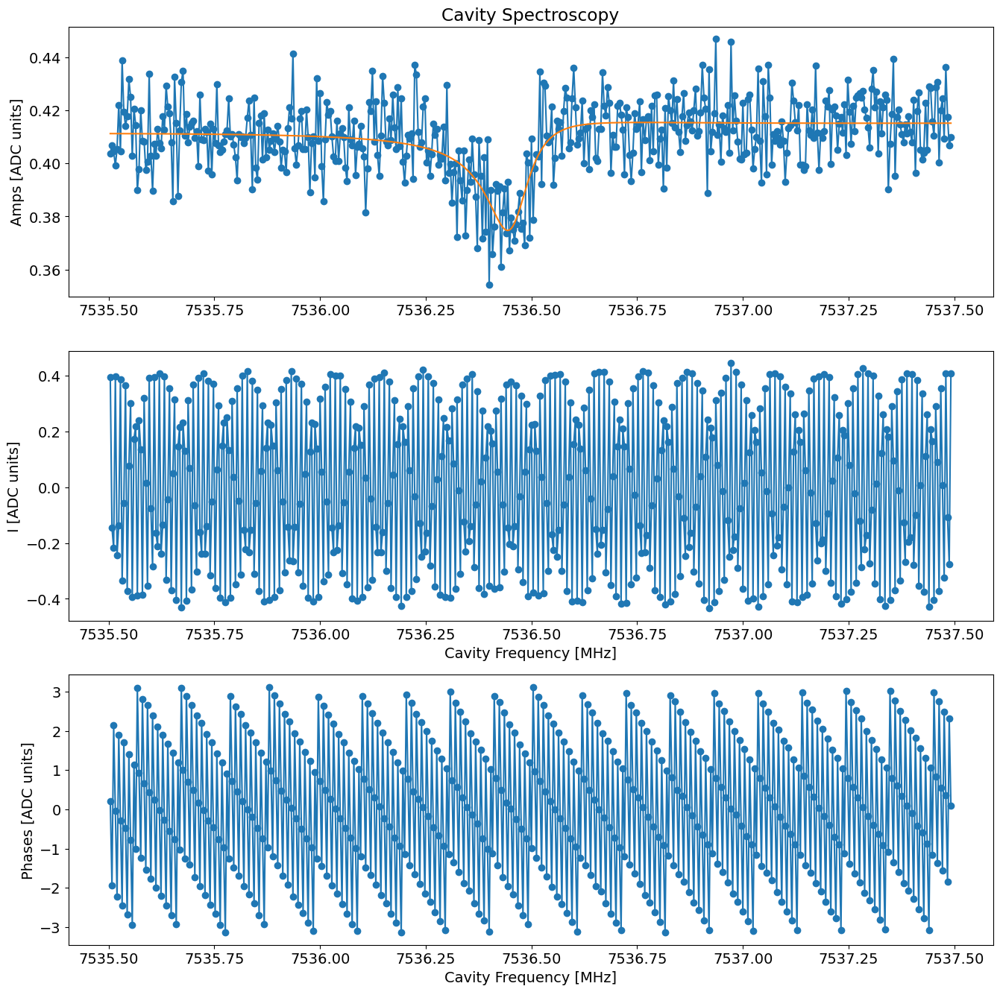

In [246]:
temp_data, attrs = prev_data(expt_path, '00063_CavitySpectroscopyExperiment.h5')
cavity_spec_display(temp_data, findpeaks=False, verbose=True, fitparams=[None, 3000, 3000, None, None, None, None], fit=True)

## e1 calib

### Ramsey 


Current pi pulse frequency: 3568.1147522256774
Fit frequency from I [MHz]: 0.3142794646348807 +/- 0.0010082424670251778
Suggested new pi pulse frequency from fit I [MHz]:
 	3567.8004727610423
 	3568.4290316903125
T2 Ramsey from fit I [us]: 8.940000000000001
Fit frequency from Q [MHz]: 0.2998385426884651 +/- 0.0029324490896498454
Suggested new pi pulse frequencies from fit Q [MHz]:
 	3567.814913682989
 	3568.414590768366
T2 Ramsey from fit Q [us]: 8.940000000000001


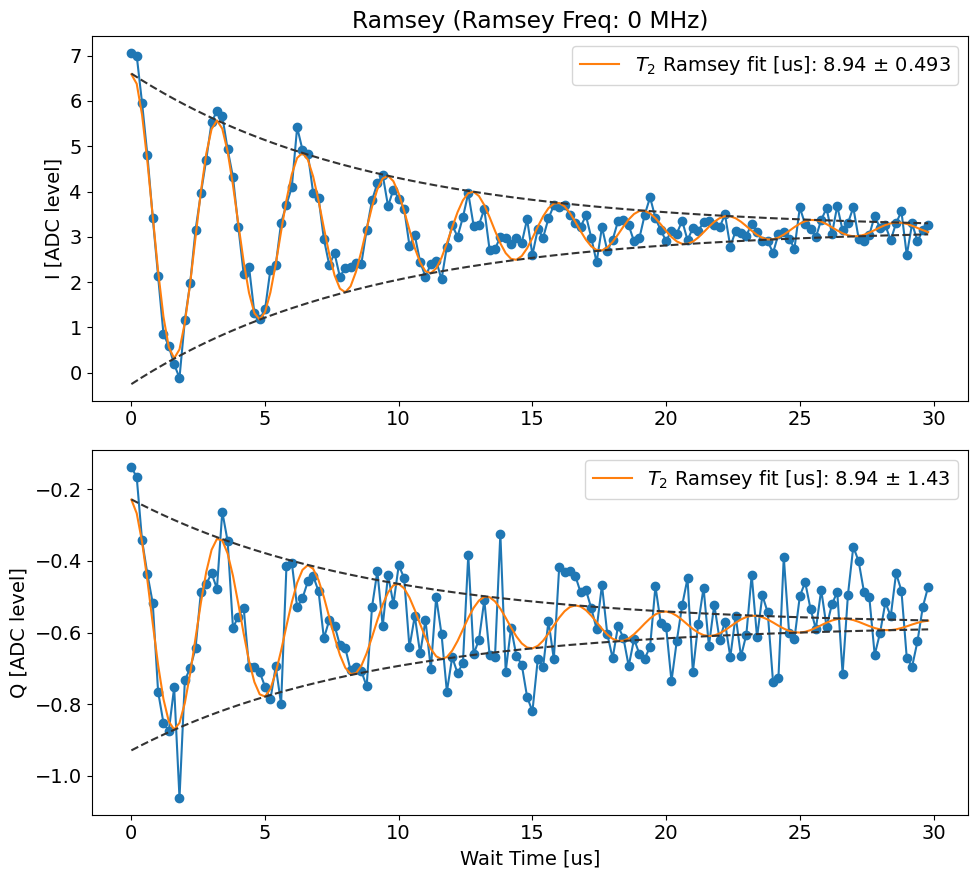

In [245]:
temp_data, attrs = prev_data(expt_path, '00025_RamseyExperiment.h5')
Ramsey_display(temp_data, normalize = [False, 'g_data', 'e_data'], ramsey_freq=attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['device']['qubit']['f_ge_idle'][0], fit=True, title='Ramsey')

Attempted to init fitparam 4 to 8, which is out of bounds 3.8984010840108403 to 7.70379945799458. Instead init to 5.80110027100271
Attempted to init fitparam 4 to 5.80110027100271, which is out of bounds -4.198130081300813 to -1.0876856368563685. Instead init to -2.6429078590785906
Attempted to init fitparam 4 to -2.6429078590785906, which is out of bounds 4.089354014549757 to 8.773415655747787. Instead init to 6.431384835148772
Current pi pulse frequency: 3425.034285340653
Fit frequency from I [MHz]: 0.3946023792845508 +/- 0.0026884097565733423
Suggested new pi pulse frequency from fit I [MHz]:
 	3424.739682961368
 	3425.5288877199373
T2 Ramsey from fit I [us]: 5.235561494870162
Fit frequency from Q [MHz]: 0.39242805538455855 +/- 0.0024295219642179815
Suggested new pi pulse frequencies from fit Q [MHz]:
 	3424.7418572852685
 	3425.5267133960374
T2 Ramsey from fit Q [us]: 5.812564071968108


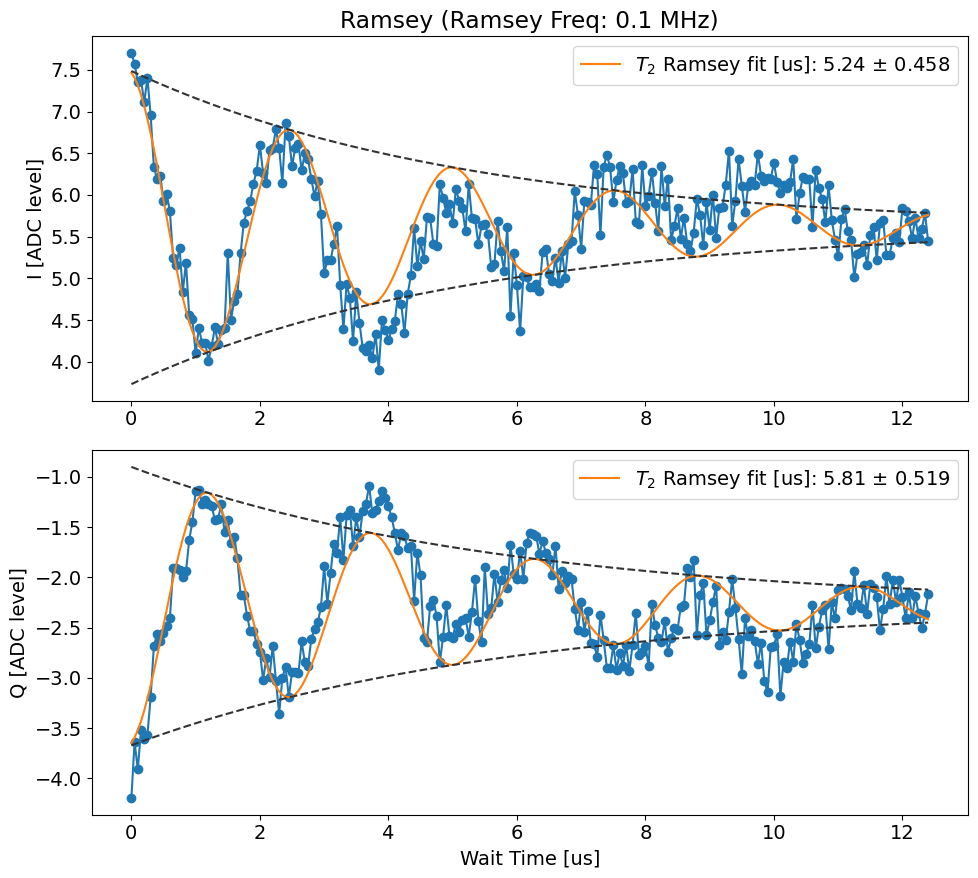

In [337]:
temp_data, attrs = prev_data(expt_path, '00036_RamseyExperiment.h5')
# fitparams=[amp, freq (non-angular), phase (deg), decay time, amp offset, decay time offset]
Ramsey_display(temp_data, ramsey_freq=attrs['config']['expt']['ramsey_freq'], initial_freq=attrs['config']['device']['qubit']['f_ef'][0], fit=True, fitparams=[10, None, 90, 25.0, 8, None], title='Ramsey')

### Amplitude Rabi 

In [24]:
temp_data, attrs = prev_data(expt_path, '00022_AmplitudeRabiGeneralExperiment.h5')
# [amp, freq (non-angular), phase (deg), decay time, amp offset, decay time offset]
amp_display(temp_data, sigma= attrs['config']['expt']['sigma_test'], fit=True, fitparams=[8,0.0005,0,None,0,None])

FileNotFoundError: [Errno 2] Unable to open file (unable to open file: name = 'h:\Shared drives\SLab\Multimode\experiment\240911\data/00022_AmplitudeRabiGeneralExperiment.h5', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)

#### EF

Attempted to init fitparam 4 to 7.348887850045168, which is out of bounds -5.867620596205962 to -0.5528780487804879. Instead init to -3.210249322493225
Attempted to init fitparam 4 to -3.210249322493225, which is out of bounds 7.458112654671297 to 9.328078050238364. Instead init to 8.39309535245483
Pi gain from avgi data [dac units]: 7600
	Pi/2 gain from avgi data [dac units]: 2564
Pi gain from avgq data [dac units]: 2597
	Pi/2 gain from avgq data [dac units]: 1269


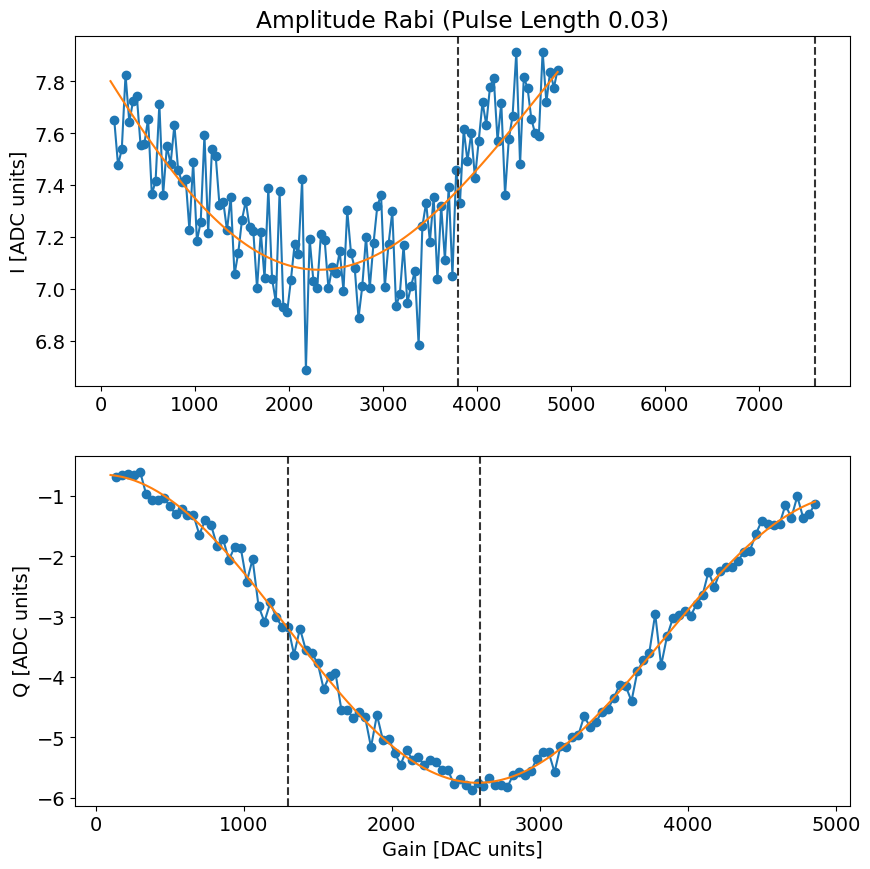

In [338]:
temp_data, attrs = prev_data(expt_path, '00020_AmplitudeRabiExperiment.h5')
amp_display(temp_data, sigma= attrs['config']['expt']['sigma_test'], fit=True, normalize = [False, 'g_data', 'e_data'], fitparams=[2.5,0.0003,-90,None,None,None])

## Qubit Spectroscopy (resolved peaks)

Found peak in amps at [MHz] 3497.7518396057853, HWHM 0.8523020826060407
Found peak in I at [MHz] 3497.7441862847004, HWHM 0.7783340050795502
Found peak in Q at [MHz] 3497.749591533634, HWHM 0.7542718599234199


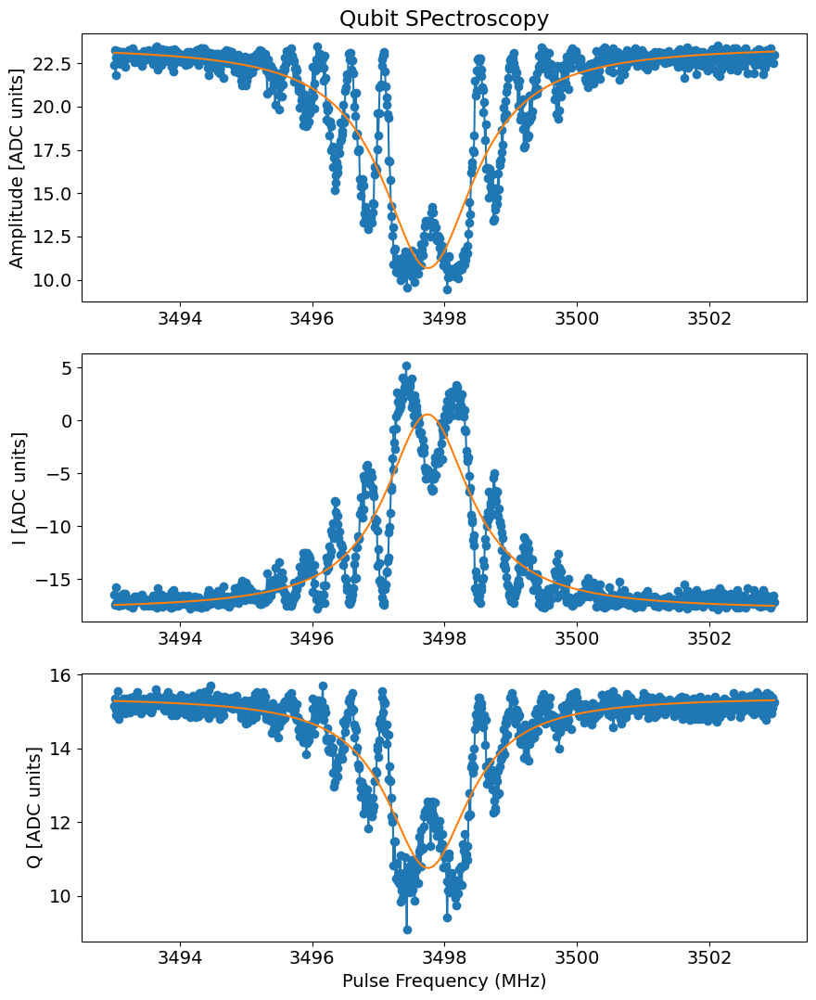

In [66]:
temp_data, attrs = prev_data(expt_path, '00002_PulseProbeSpectroscopyExperiment.h5')
qubit_spectroscopy_display(temp_data, vlines=None)

 ### resolved pi

Found peak in amps at [MHz] 3568.0701734836603, HWHM 0.7065903802078878
Found peak in I at [MHz] 3568.0583747876694, HWHM 0.7633465010496007
Found peak in Q at [MHz] 3568.0852252265804, HWHM 0.6807828329731433


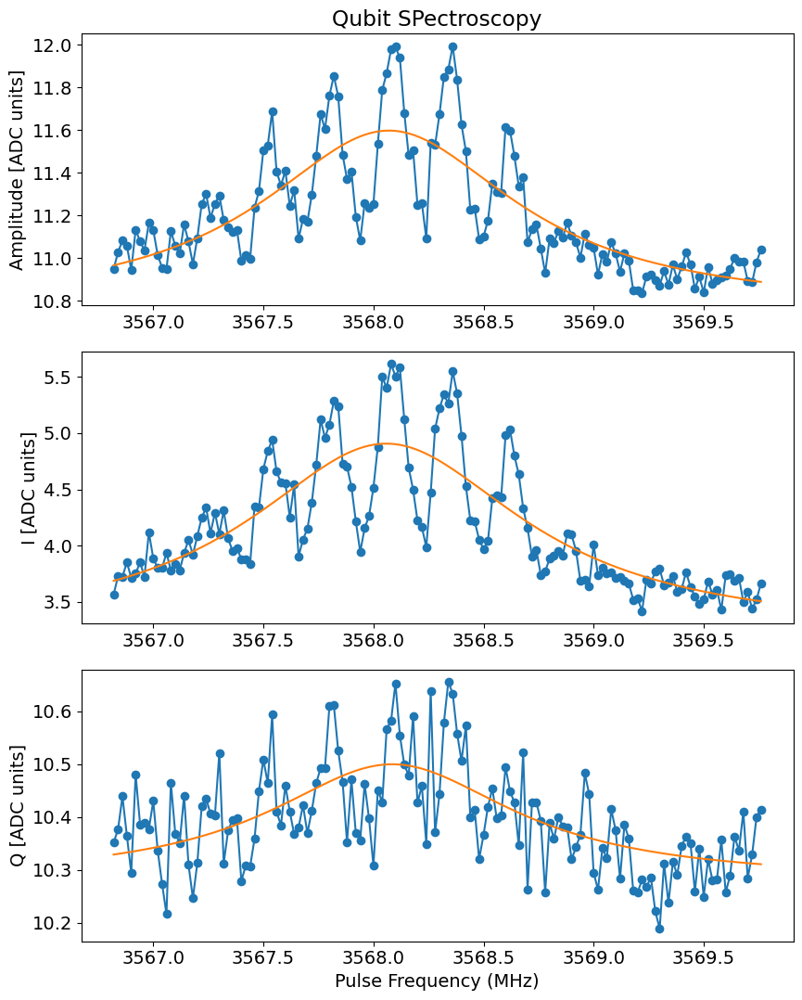

In [193]:
temp_data, attrs = prev_data(expt_path, '00022_PulseProbeSpectroscopyExperiment.h5')
qubit_spectroscopy_display(temp_data)

### M1 Chi shift

[3568.90438, 13694146000.0, -23989.3927, 3.90620184, 4.2021655, -0.545740412, 6.61080298]
Attempted to init fitparam 5 to -0.545740412, which is out of bounds 4.358347967479675 to 7.5070243902439024. Instead init to 5.932686178861789
[ 3.56890438e+03  3.48982338e+15 -2.39897618e+04  3.90618794e+00
  4.20213687e+00 -5.45685547e-01  6.61061340e+00]
f0 at |g>: 3568.904380297104
[3568.90438, 13694146000.0, -23989.3927, 3.90620184, 4.2021655, 5.932686178861789, 6.61080298]
Attempted to init fitparam 0 to 3568.90438, which is out of bounds 3568.4700000000003 to 3568.768. Instead init to 3568.619
[ 3.56862098e+03 -2.88847126e+15 -2.17425905e+04  3.07952167e+00
  4.72286912e+00 -1.68563946e+00 -1.24338837e+00]
f0 at |e>: 3568.620975716107


c:\Users\26049\.conda\envs\slab\lib\site-packages\scipy\optimize\_minpack_py.py:906: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


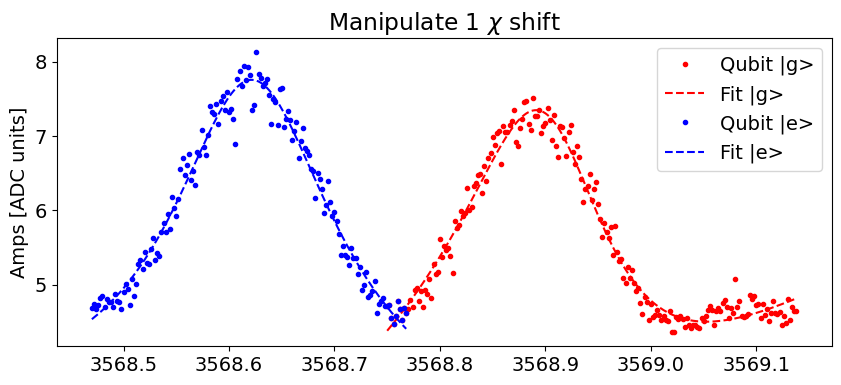

In [191]:
temp_data1, attrs1 = prev_data(expt_path, '00021_PulseProbeSpectroscopyExperiment.h5')  # |g>
plot_spectroscopy1(temp_data1['xpts'][475:-80], temp_data1['avgi'][475:-80], temp_data1['xpts'][335:485],  temp_data1['avgi'][335:485], title="Manipulate 1 $\chi$ shift", fitparams=[ 3.56890438e+03,  1.36941460e+10, -2.39893927e+04,  3.90620184e+00,  4.20216550e+00, -5.45740412e-01,  6.61080298e+00])

### Man1=|1>, qubit spectroscopy

Found peak in amps at [MHz] 3567.927884373913, HWHM 0.1506345559358267
Found peak in I at [MHz] 3567.9194338546786, HWHM 0.13414477149555018
Found peak in Q at [MHz] 3567.9336636865573, HWHM 0.13231637286980477


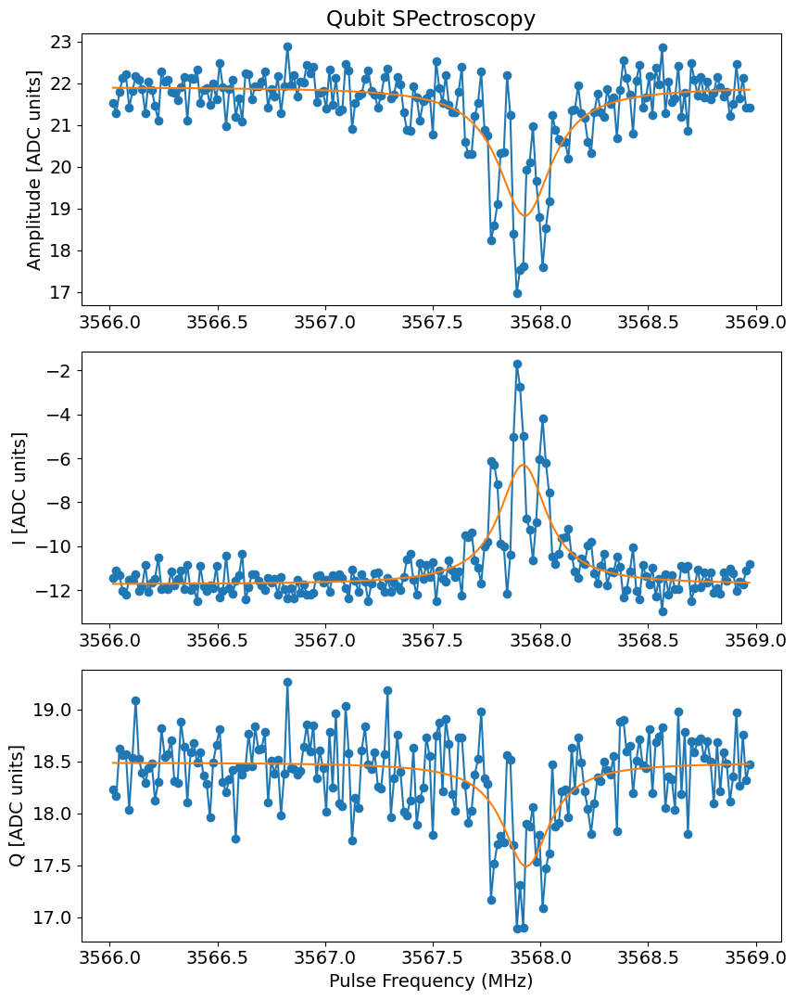

In [131]:
temp_data, attrs = prev_data(expt_path, '00003_PulseProbePrePulseSpectroscopyExperiment.h5')
qubit_spectroscopy_display(temp_data)

### f0g1-readout spectroscopy

Found peak in amps at [MHz] 1834.3672770236794, HWHM -0.2061192423463556
Found peak in I at [MHz] 1836.778879657604, HWHM 0.07569254992792923
Found peak in Q at [MHz] 1834.3681523059438, HWHM 0.24383027269346227


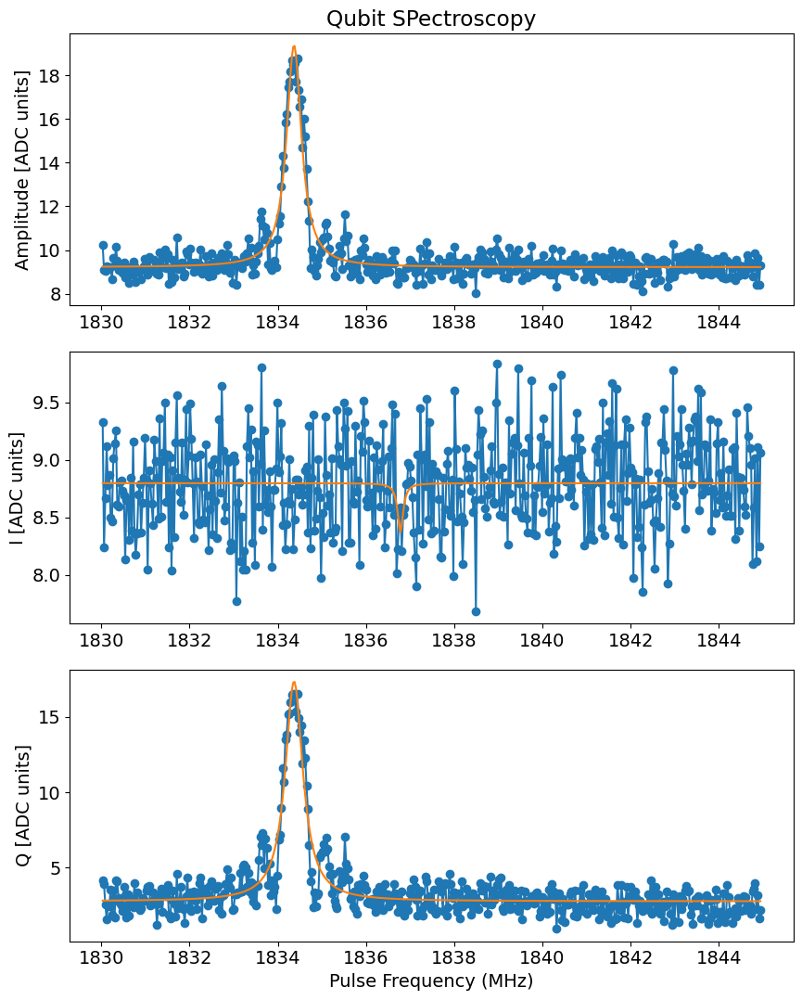

In [778]:
temp_data, attrs = prev_data(expt_path, '00003_PulseProbeF0g1SpectroscopyExperiment.h5')
qubit_spectroscopy_display(temp_data)

## ECD Spectroscopy

Found peak in amps at [MHz] 3565.7131896377073, HWHM 0.03517361474173648
Found peak in I at [MHz] 3565.5292147702658, HWHM 0.17263917072604976
Found peak in Q at [MHz] 3565.8864789274085, HWHM 0.0575215928124037


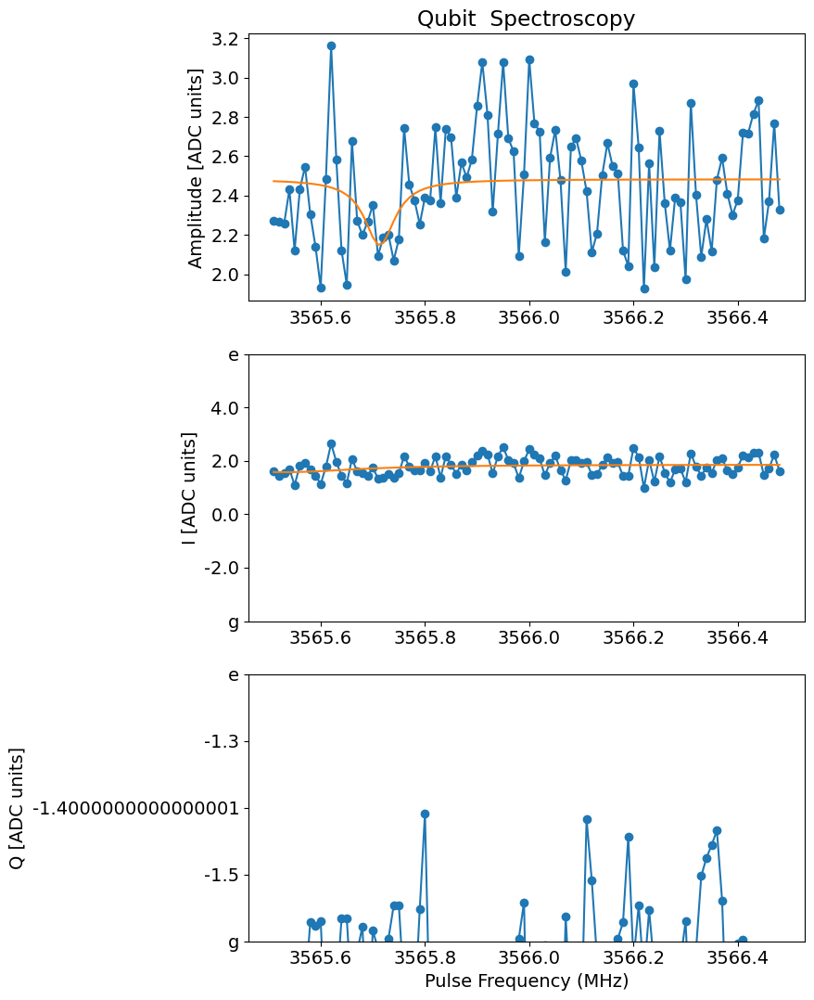

In [495]:
temp_data, attr = prev_data(expt_path, '00010_ECDExperiment.h5')  # |g>
ECD_pulse_spectroscopy(data = temp_data, normalize = [True, 'g_data', 'e_data'])

Found peak in amps at [MHz] 3568.8961244337434, HWHM 0.04327419295648351
Found peak in I at [MHz] 3568.8955988775915, HWHM 0.049097820175840995
Found peak in Q at [MHz] 3568.8928722996397, HWHM 0.04687877693357728


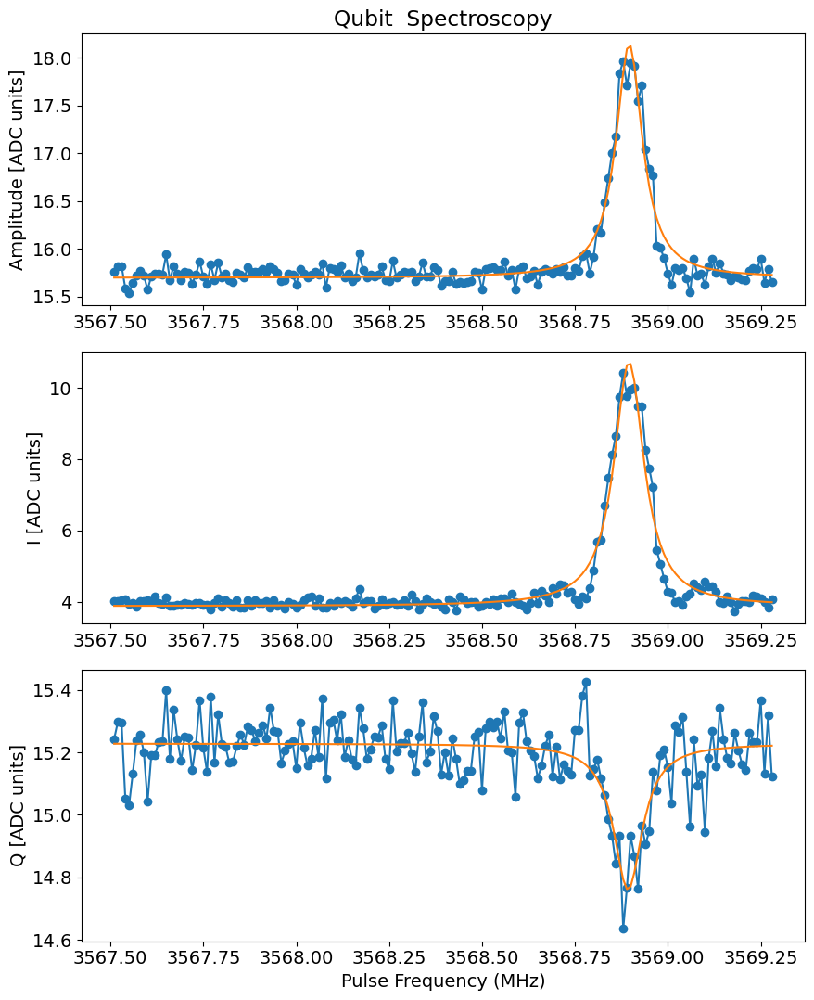

In [14]:
temp_data, attr = prev_data(expt_path, '00039_ECDExperiment.h5')  # |g>
ECD_pulse_spectroscopy(data = temp_data)

## f0-g1 M1

Found peak in amps at [MHz] 2006.279676890333, HWHM -0.3622386842213878
Found peak in I at [MHz] 2006.2495402452635, HWHM -0.3222577657903093
Found peak in Q at [MHz] 2006.3047021775744, HWHM 0.4773056984661913


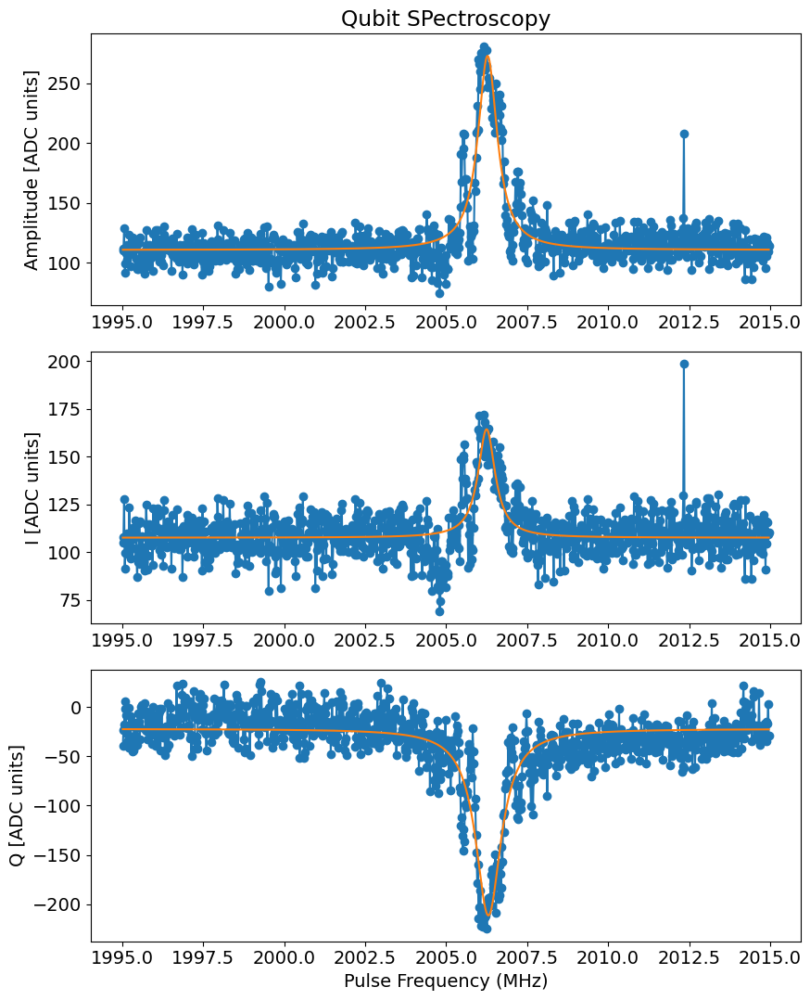

In [118]:
temp_data, attrs = prev_data(expt_path, '00019_PulseProbeF0g1SpectroscopyExperiment.h5')
qubit_spectroscopy_display(temp_data)

In [131]:
attrs

{'config': {'prepulse_qubit': {'freq': [3568.105490770579],
   'length': [0.06],
   'gain': [30],
   'phase': [0],
   'repeat_time': 10},
  'device': {'qubit': {'T1': 127.0,
    'f_ge': 3568.105490770579,
    'f_ge_resolved': 3568.105490770579,
    'f_ge_idle': 3568.105490770579,
    'f_ef': 3425.0250576126327,
    'f_ef_idle': 3425.0250576126327,
    'ramp_sigma': 0.01,
    'ramp_sigma_num': 2,
    'pulses': {'pi_ge': {'gain': 7203, 'sigma': 0.015, 'type': 'gauss'},
     'pi_ge_middle': {'gain': 7203, 'sigma': 0.015, 'type': 'gauss'},
     'pi_ge_resolved': {'gain': 50,
      'sigma': 0.1,
      'length': 6.271105440458137,
      'type': 'flat_top',
      'repeat_no': 1},
     'hpi_ge': {'gain': 3664, 'sigma': 0.015, 'type': 'gauss'},
     'pi_ef_new': {'gain': 2585,
      'sigma': 0.005,
      'length': 0.08405005321695154,
      'type': 'flat_top'},
     'hpi_ef_new': {'gain': 1293,
      'sigma': 0.005,
      'length': 0.07713167413411094,
      'type': 'flat_top'},
     'pi_ef': {

Found peak in amps at [MHz] 2285.6216072534185, HWHM 295.8850971544104
Found peak in I at [MHz] 2280.9959225788903, HWHM 307.0288171963643
Found peak in Q at [MHz] 2307.9481721764228, HWHM -205.3915348431304


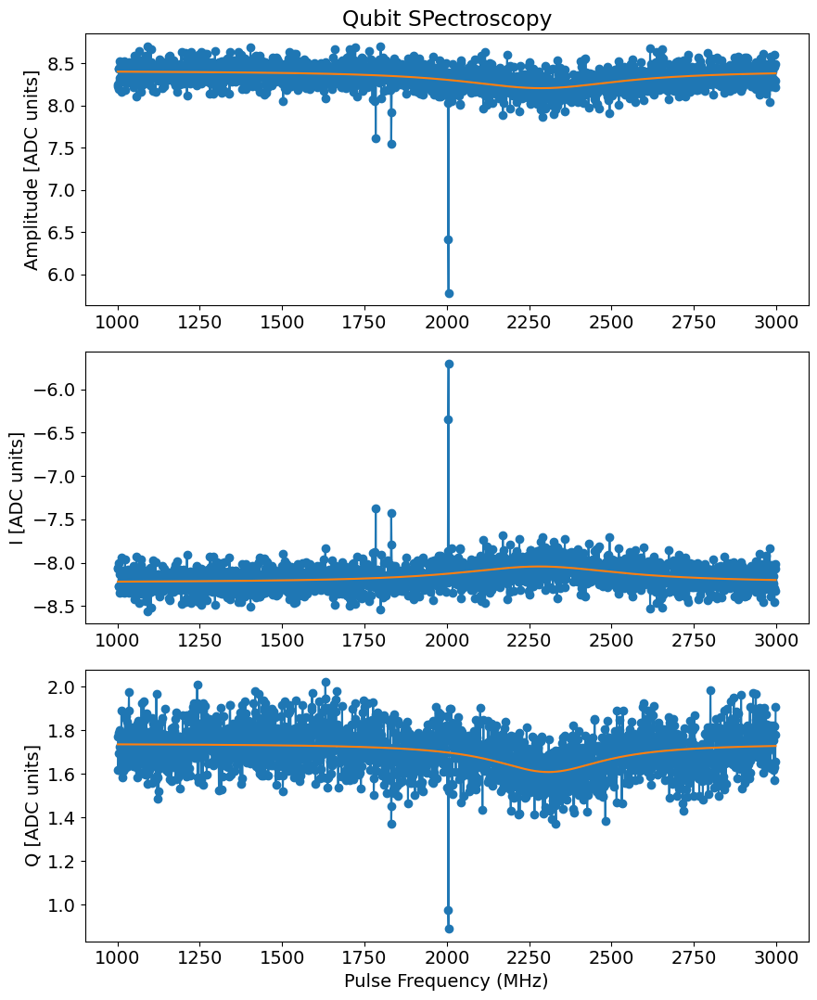

In [115]:
temp_data, attrs = prev_data(expt_path, '00008_PulseProbeF0g1SpectroscopyExperiment.h5')
qubit_spectroscopy_display(temp_data)

Found peak in amps at [MHz] 2246.3450650773057, HWHM 349.06875611456155
Found peak in I at [MHz] 2246.6187940236455, HWHM 349.9064708205609
Found peak in Q at [MHz] 2251.398284965977, HWHM 278.1521397016462


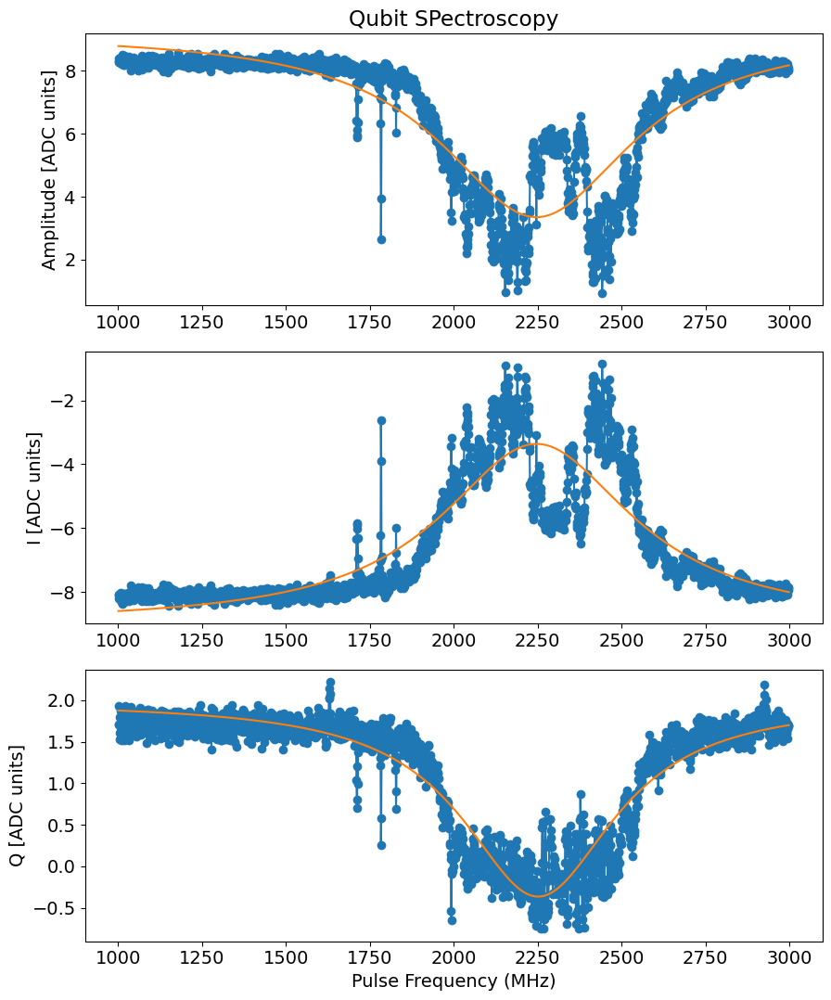

In [116]:
temp_data, attrs = prev_data(expt_path, '00009_PulseProbeF0g1SpectroscopyExperiment.h5')
qubit_spectroscopy_display(temp_data)

### f0-g1 M1 DC flux scan

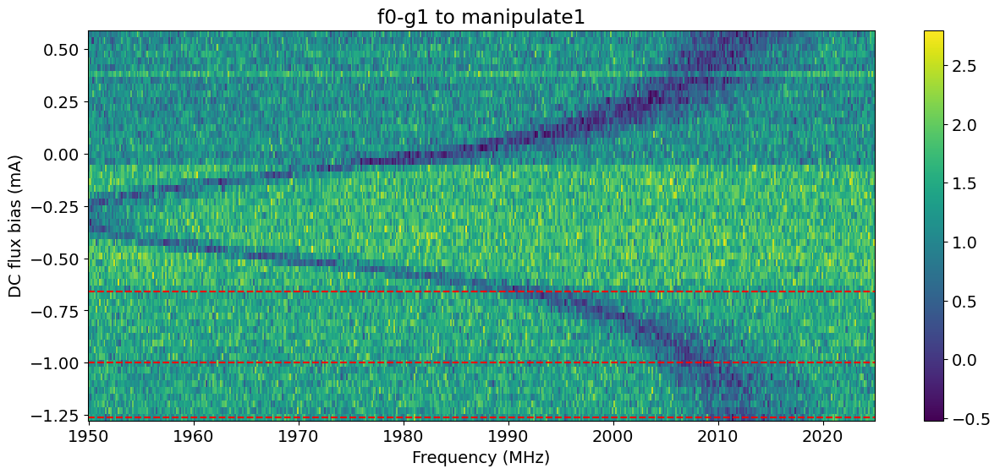

In [106]:
file_list = np.arange(0,58,1)
y_list = []
flux_list = []
# flux_list = np.linspace(-1.25, 0.7, 31)
name = '_pulseprobe_f0g1_dc_flux_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgq']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    flux_list.append(attrs['config']['expt']['current'])

plot_spectroscopy_sweep(len_x, flux_list, np.array(y_list), hlines=[0.67-1.93, 0.93-1.93, 1.27-1.93], vlines=None, title="f0-g1 to manipulate1")

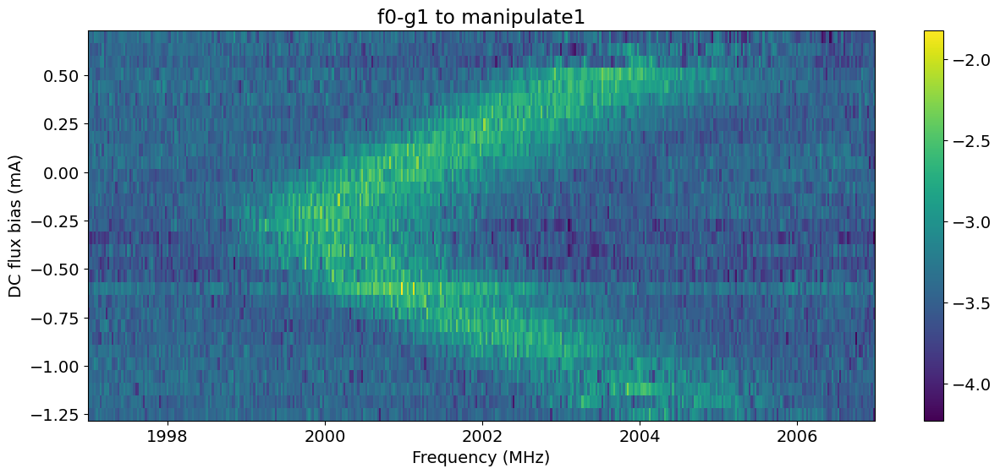

In [44]:
file_list = np.arange(93,124,1)
y_list = []
flux_list = []
# flux_list = np.linspace(-1.25, 0.7, 31)
name = '_pulseprobe_f0g1_dc_flux_sweep.h5'
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  # ef
    signal_y = temp_data['avgi']
    len_x = temp_data['xpts']
    y_list.append(signal_y)
    flux_list.append(attrs['config']['expt']['current'])

plot_spectroscopy_sweep(len_x, flux_list, np.array(y_list), hlines=None, vlines=None, title="f0-g1 to manipulate1")

[ 2.00600452e+03  1.60340455e+00 -1.28684761e+00]
[[ 0.0653718   0.06400215 -0.00854998]
 [ 0.06400215  0.06679758 -0.00924073]
 [-0.00854998 -0.00924073  0.00131199]]


Text(0.5, 1.0, 'f0-g1 to manipulate 1')

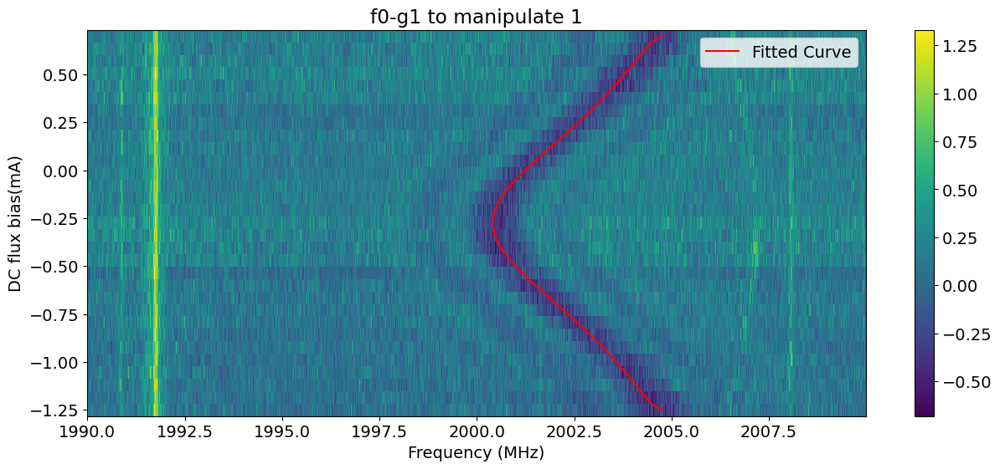

In [48]:
plt.figure(figsize = (15,6))
plt.subplot(111,xlabel='Frequency (MHz)',ylabel='DC flux bias (mA)')
plt.pcolormesh(len_x,flux_list,np.array(y_list))
cbar = plt.colorbar()


z_list = np.argmin(y_list, axis=1)
w_list = [len_x[z] for z in z_list]
# plt.plot(w_list)
# plt.plot(w_list, flux_list, color='r')  # 'r' stands for red, choose any color

# convert current to flux
sweet_spot = -0.275
period = 1.95
flux_new_list = [(x-sweet_spot)/period for x in flux_list]

import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit

# Manipulate frequency response (analytic)
def model(x, a, b, c):
    return a+b/(np.sqrt(abs(np.cos(np.pi*x)))+c)

# Example data
x_list1 = np.array(flux_new_list)
y_list1 = np.array(w_list)

# Perform the curve fitting
params, covariance = curve_fit(model, x_list1, y_list1, maxfev=20000)

print(params)
print(covariance)

# The best-fit parameters
a, b, c = params

# Generate x values for plotting the fitted function
x_fit = np.linspace(min(flux_list), max(flux_list), 100)
x_flux_fit = np.array([(x-sweet_spot)/period for x in x_fit])
y_fit = model(x_flux_fit, a, b, c)

# Plotting the original data and the fitted curve
# plt.scatter(x_list, y_list, color='red', label='Data Points')
plt.plot(y_fit, x_fit, color='r',label=f'Fitted Curve')
plt.legend()
plt.xlabel('Frequency (MHz)')
plt.ylabel('DC flux bias(mA)')
plt.title('f0-g1 to manipulate 1')
# plt.show()

## f0-g1 M2

Found peak in amps at [MHz] 1834.4800927777917, HWHM -0.2227984625971865
Found peak in I at [MHz] 1840.7801943409042, HWHM 0.9739321631110116
Found peak in Q at [MHz] 1834.4806715525265, HWHM -0.2486086674153056


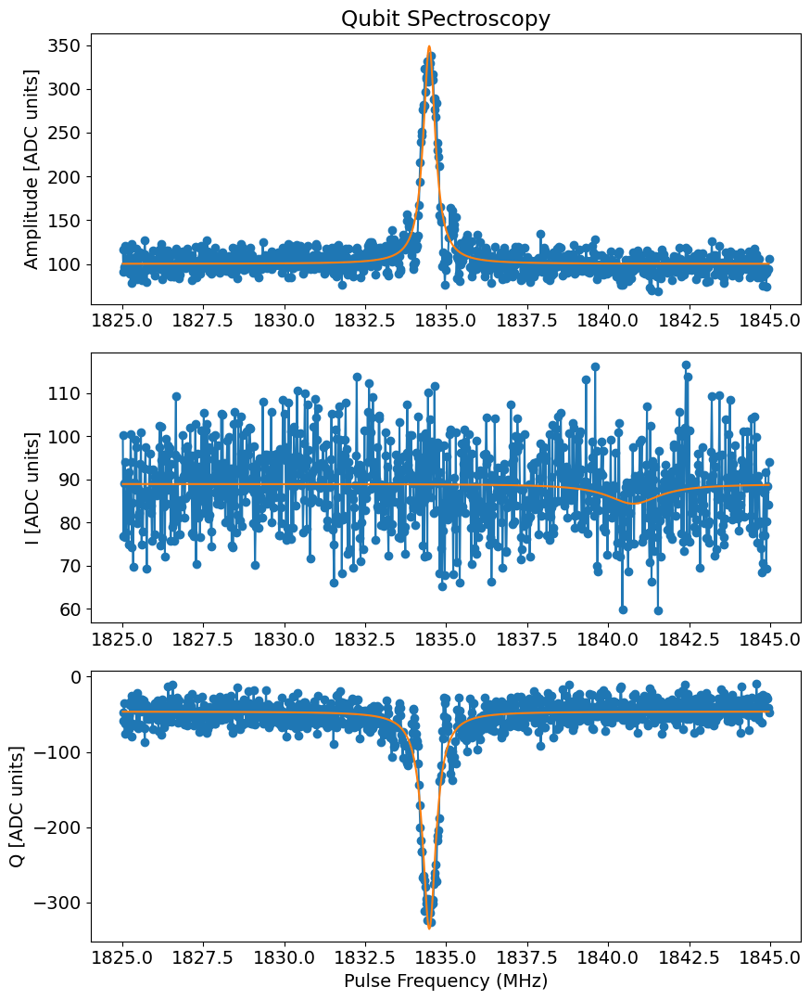

In [7]:
temp_data, attrs = prev_data(expt_path, '00020_PulseProbeF0g1SpectroscopyExperiment.h5')
qubit_spectroscopy_display(temp_data)

Found peak in amps at [MHz] 1834.1501169095795, HWHM 0.32437891930048984
Found peak in I at [MHz] 1834.1535045380085, HWHM 0.3616718768248672
Found peak in Q at [MHz] 1834.1478982266235, HWHM 0.37170060966420065


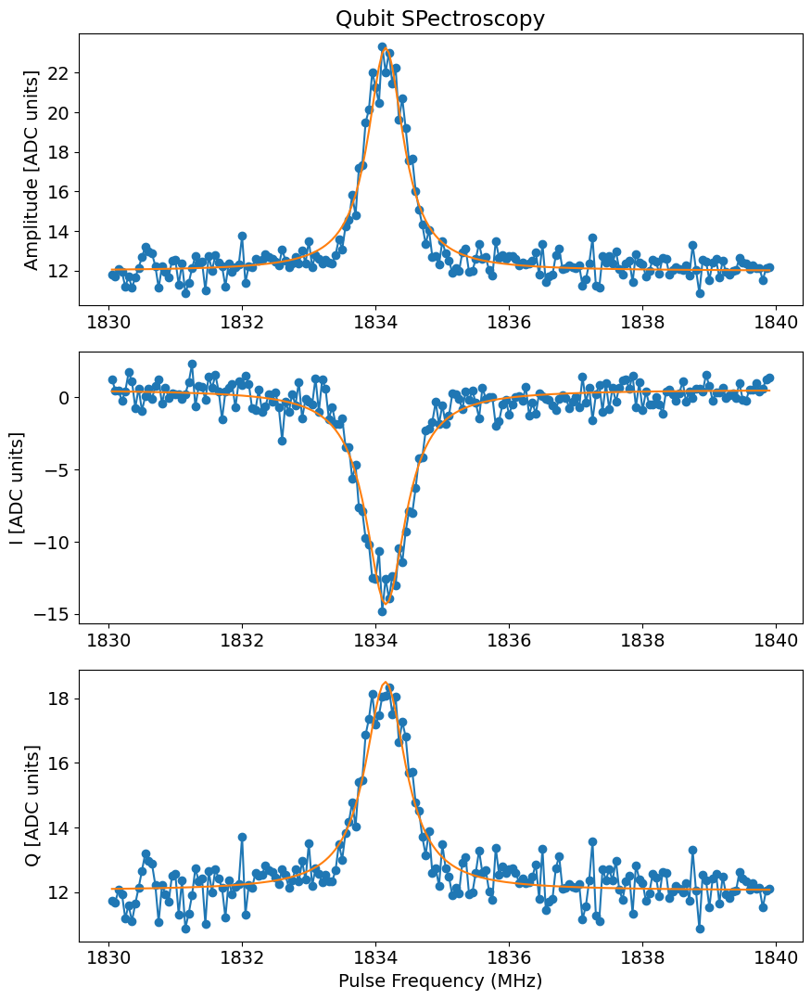

In [157]:
temp_data, attrs = prev_data(expt_path, '00006_PulseProbeF0g1SpectroscopyExperiment.h5')
qubit_spectroscopy_display(temp_data)

## RB calibration

In [121]:
temp_data, attrs = prev_data(expt_path, '00282_SingleRB.h5')
avg_readout = []
for i in range(len(temp_data['Idata'])):
    counting = 0
    for j in temp_data['Idata'][i][0]:
        if j<temp_data['thresholds']:
            counting += 1
    avg_readout.append(counting/len(temp_data['Idata'][i][0]))
#
# avg_readout = RB_extract(temp_data)
mean = np.average(avg_readout)
err = np.std(avg_readout)/np.sqrt(len(avg_readout))
print(mean, err)

0.73305 0.021674579003985287


In [299]:
a1 = 0.618169+0.618169+0.005*12+0.035*4+0.15377089082752435*2+0.005*8
a2 = 0.618169+0.618169+0.005*16+0.035*4+0.15377089082752435*2+0.005*8
a3 = 0.746024111064673+0.746024111064673+0.005*12+0.035*4+0.15377089082752435*2+0.005*8

print(np.exp(-a1/210)**50)
print(np.exp(-a2/210)**50)
print(np.exp(-a3/210)**50)

0.6539441809829537
0.6508375636518429
0.6153176333157722


In [116]:
avg_readout

[0.05668449197860963,
 0.16741071428571427,
 0.1681614349775785,
 0.20362473347547974,
 0.20972972972972972,
 0.20685959271168275,
 0.19498910675381265,
 0.1956521739130435,
 0.16554809843400448,
 0.19021739130434784,
 0.18853362734288864,
 0.2201058201058201,
 0.1989071038251366,
 0.1597300337457818,
 0.2090032154340836,
 0.18432671081677704,
 0.18141592920353983,
 0.22033898305084745,
 0.2167019027484144,
 0.2106951871657754]

In [301]:
np.exp(-a1/210)

0.9915413121001335

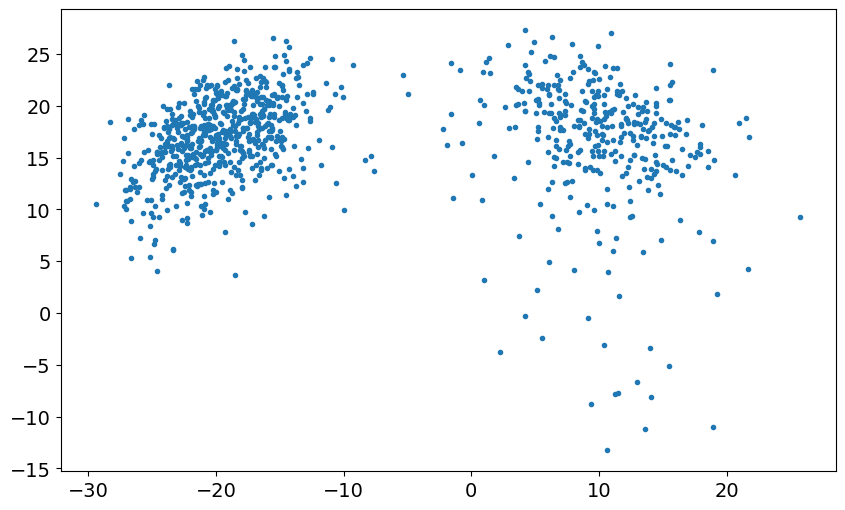

In [676]:
plt.plot(temp_data['Idata'][-1], temp_data['Qdata'][-1],'.')

### RB depth sweep

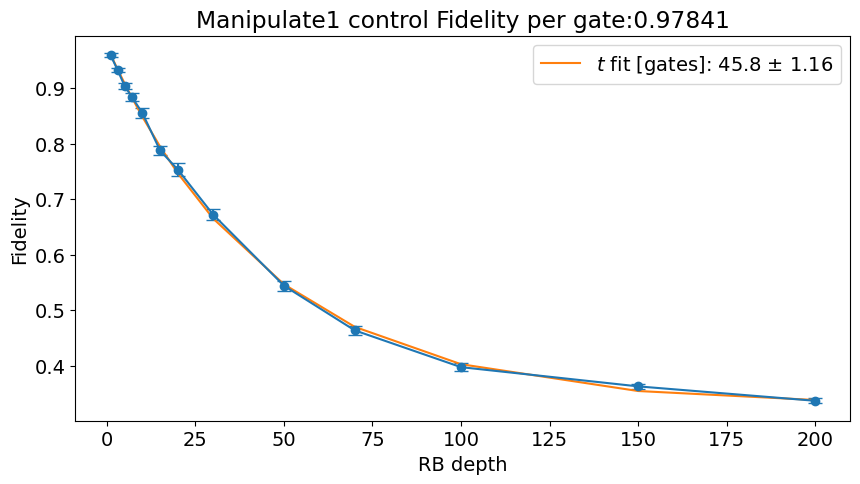

In [101]:
# prepulse_list_labels = ['ge subspace', 'gf subspace', 'man1 subspace']
# file_list = np.arange(0,15,1)
file_list = np.arange(51,64,1)
name = '_SingleRB_sweep_depth.h5'

plt.figure(figsize=(10,5))
plt.subplot(111,  ylabel="Fidelity")

#for idx, prepulse_label in enumerate(prepulse_list_labels):

fids_list = []
xlist = []
ebars_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  
    avg_readout = RB_extract(temp_data, conf=False)
    fids_list.append(np.average(avg_readout))
    ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
    xlist.append(attrs['config']['expt']['rb_depth'])
plt.errorbar(xlist, fids_list, yerr= ebars_list,fmt = '-o', capsize=5)

# fitting 
xpts = xlist
ypts = fids_list
fit,err = fitter.fitexp(xpts, ypts, fitparams=None)

p = fit #data['fit_avgi']
pCov = err #data['fit_err_avgi']
captionStr = f'$t$ fit [gates]: {p[3]:.3} $\pm$ {np.sqrt(pCov[3][3]):.3}'
plt.plot(xpts, fitter.expfunc(xpts, *fit), label=captionStr)

#plt.show()
plt.xlabel('RB depth')
plt.ylabel('Fidelity')
plt.title(f'Manipulate1 control Fidelity per gate:{np.exp(-1/fit[3]):.5f}')
plt.legend()
plt.show()

In [102]:
xpts

[1, 3, 5, 7, 10, 15, 20, 30, 50, 70, 100, 150, 200]

In [103]:
ypts

[0.9598333333333333,
 0.9326666666666665,
 0.9039666666666667,
 0.8845,
 0.8553666666666667,
 0.7878000000000001,
 0.7533333333333335,
 0.6721333333333332,
 0.5440666666666666,
 0.46359999999999996,
 0.39736666666666665,
 0.3627333333333333,
 0.33676666666666677]

In [193]:
def RB_extract_excited(temp_data):
    avg_readout = []
    for i in range(len(temp_data['Idata'])):
        counting = 0
        for j in temp_data['Idata'][i]:
            if j>temp_data['thresholds']:
                counting += 1
        avg_readout.append(counting/len(temp_data['Idata'][i]))
    return avg_readout

## frequency sweep

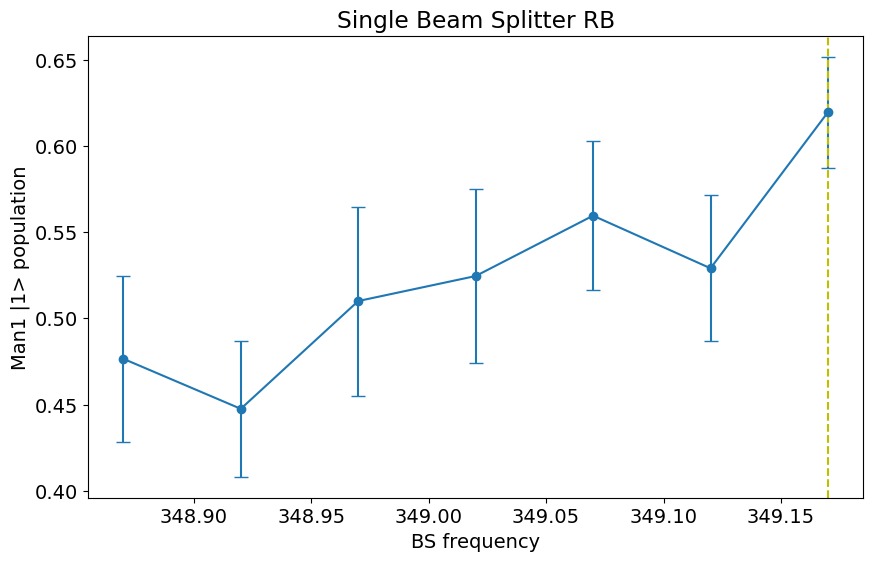

In [151]:
file_list = np.arange(14,24,1)  # gain=5000 s1-m1
file_list = np.arange(29,36,1)  # gain=7000 s1-m1
fids_list = []
conf_m_list = []
freq_list = []
name = '_SingleBeamSplitterRB_sweep_freq.h5'
i = 0
fids_list = []
xlist = []
ebars_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  
    avg_readout = RB_extract_excited(temp_data)
    fids_list.append(np.average(avg_readout))
    ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
    xlist.append(attrs['config']['expt']['bs_para'][0])
plt.errorbar(xlist, fids_list, yerr= ebars_list,fmt = '-o', label='', capsize=5)

plt.xlabel('BS frequency')
plt.ylabel('Man1 |1> population')
plt.title(f'Single Beam Splitter RB')
# plt.plot(xlist, fids_list,'-o',color='r')
# plt.axvline([3567.920628692002], color='b', ls='--', label='Ramsey Freq')
plt.axvline([349.17], color='y', ls='--', label='RB Freq')
# plt.axvline([3568.3], color='g', ls='--', label='Max Single-shot Fid Freq')
# plt.legend()

## gain sweep

Text(0.5, 1.0, 'Single Beam Splitter RB')

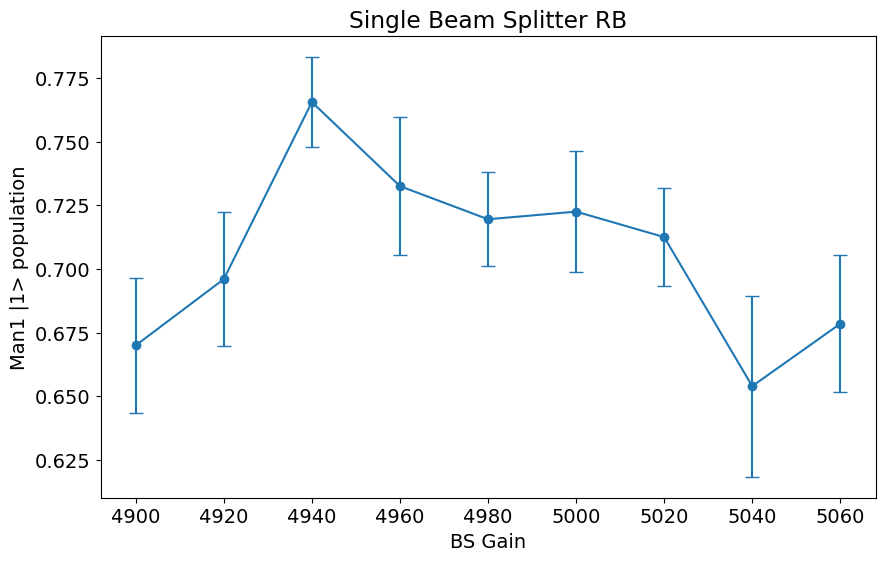

In [136]:
file_list = np.arange(0,9,1)
fids_list = []
conf_m_list = []
freq_list = []
name = '_SingleBeamSplitterRB_gain_freq.h5'
i = 0
fids_list = []
xlist = []
ebars_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  
    avg_readout = RB_extract_excited(temp_data)
    fids_list.append(np.average(avg_readout))
    ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
    xlist.append(attrs['config']['expt']['bs_para'][1])
plt.errorbar(xlist, fids_list, yerr= ebars_list,fmt = '-o', label='', capsize=5)

plt.xlabel('BS Gain')
plt.ylabel('Man1 |1> population')
plt.title(f'Single Beam Splitter RB')
# plt.plot(xlist, fids_list,'-o',color='r')
# plt.axvline([3567.920628692002], color='b', ls='--', label='Ramsey Freq')
# plt.axvline([349.21], color='y', ls='--', label='RB Freq')
# plt.axvline([3568.3], color='g', ls='--', label='Max Single-shot Fid Freq')
# plt.legend()

Text(0.5, 1.0, 'Single Beam Splitter RB')

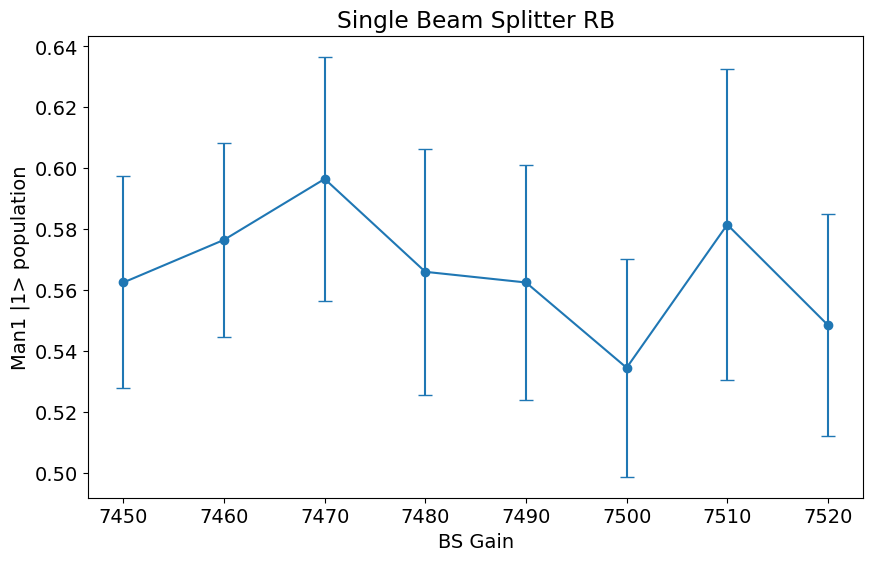

In [148]:
file_list = np.arange(17,25,1)
fids_list = []
conf_m_list = []
freq_list = []
name = '_SingleBeamSplitterRB_gain_freq.h5'
i = 0
fids_list = []
xlist = []
ebars_list = []
for file_no in file_list:
    full_name = str(file_no).zfill(5)+name
    temp_data, attrs = prev_data(expt_path, full_name)  
    avg_readout = RB_extract_excited(temp_data)
    fids_list.append(np.average(avg_readout))
    ebars_list.append(np.std(avg_readout)/np.sqrt(len(avg_readout)))
    xlist.append(attrs['config']['expt']['bs_para'][1])
plt.errorbar(xlist, fids_list, yerr= ebars_list,fmt = '-o', label='', capsize=5)

plt.xlabel('BS Gain')
plt.ylabel('Man1 |1> population')
plt.title(f'Single Beam Splitter RB')
# plt.plot(xlist, fids_list,'-o',color='r')
# plt.axvline([3567.920628692002], color='b', ls='--', label='Ramsey Freq')
# plt.axvline([349.21], color='y', ls='--', label='RB Freq')
# plt.axvline([3568.3], color='g', ls='--', label='Max Single-shot Fid Freq')
# plt.legend()

# Active Reset

Attempted to init fitparam 4 to -10, which is out of bounds 13.975097402597402 to 17.705714285714286. Instead init to 15.840405844155844
Pi gain from avgi data [dac units]: 9685
	Pi/2 gain from avgi data [dac units]: 5073
Pi gain from avgq data [dac units]: 9717
	Pi/2 gain from avgq data [dac units]: 4280


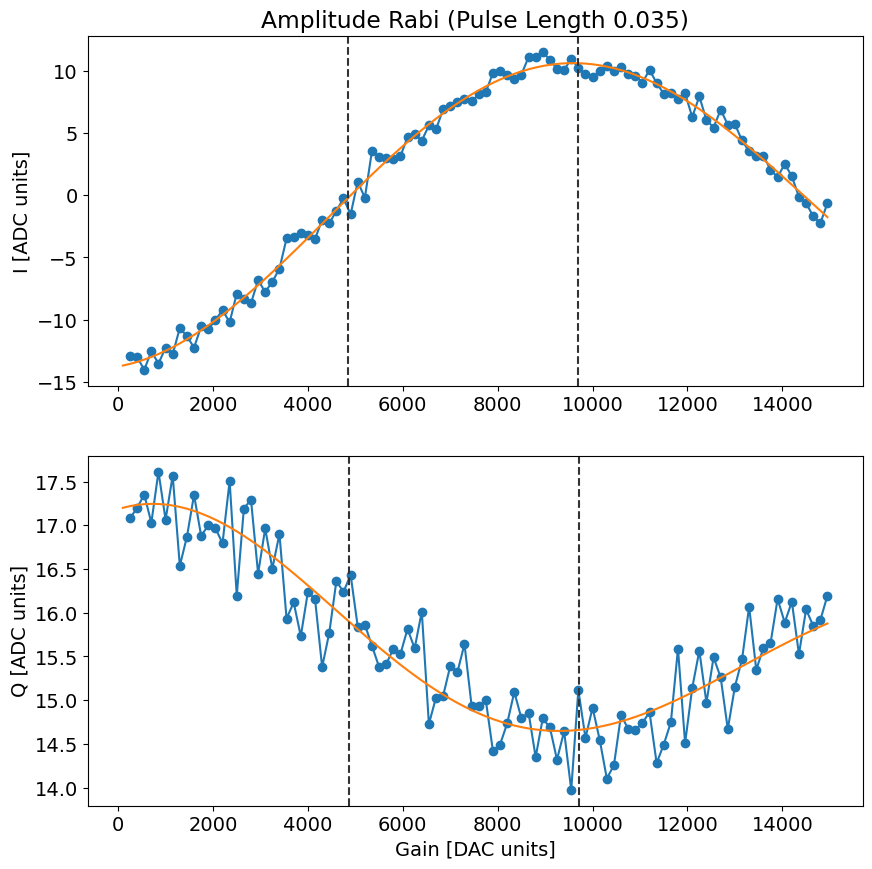

In [589]:
temp_data, attrs = prev_data(expt_path, '00003_FastResetExperiment.h5')
# [amp, freq (non-angular), phase (deg), decay time, amp offset, decay time offset]
amp_display(temp_data, sigma= attrs['config']['expt']['sigma_test'], fit=True, fitparams=[8,0.0001,90,None,-10,None])

In [1022]:
temp_data, attrs = prev_data(expt_path, '00033_FastResetExperiment.h5')
# [amp, freq (non-angular), phase (deg), decay time, amp offset, decay time offset]
# amp_display(temp_data, sigma= attrs['config']['expt']['sigma_test'], fit=False, fitparams=[8,0.0001,90,None,-10,None])

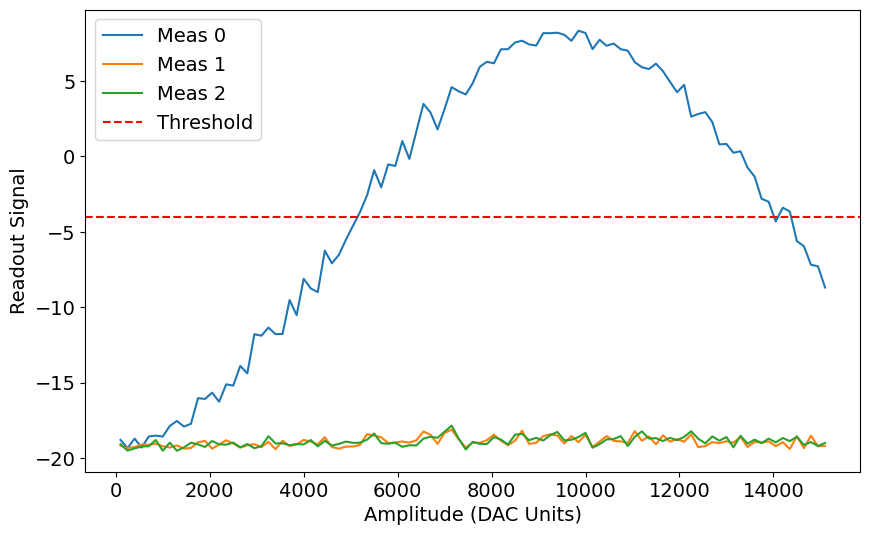

In [1023]:
temp_data, attrs = prev_data(expt_path, '00033_FastResetExperiment.h5')
for idx in range(3):
    plt.plot(temp_data['xpts'], temp_data['avgi'][0][idx], label=f'Meas {idx}')

# draw a horizontal line at -4 
plt.axhline(-4, color='r', ls='--', label = 'Threshold')

plt.xlabel('Amplitude (DAC Units)')
plt.ylabel('Readout Signal')
plt.legend()

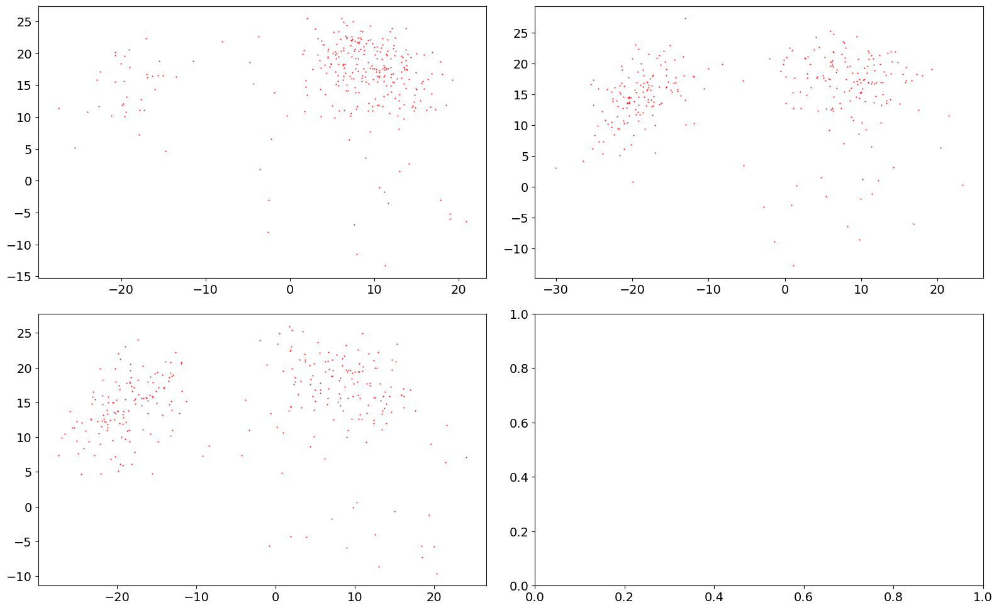

In [711]:
temp_data, attrs = prev_data(expt_path, '00027_FastResetExperiment.h5')
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(16, 10))
fig.tight_layout()
n= int(100*0.5)
for idx in range(3):
    I = temp_data['I'][idx::3][n*300:n*300 + 300]
    Q = temp_data['Q'][idx::3][n*300:n*300 + 300]
    axs[idx//2,idx%2].scatter(I, Q, label='e', color='r', marker='.', s=1)
#axs[0,0].scatter(Ig, Qg, label='g', color='b', marker='.', s=1)

In [1019]:
temp_data, attrs = prev_data(expt_path, '00070_HistogramActiveResetExperiment.h5')

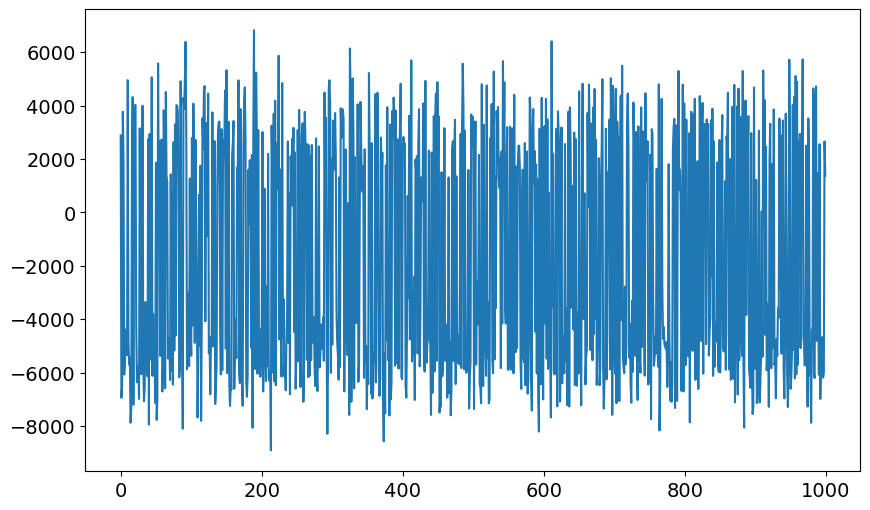

In [1020]:
plt.plot(temp_data['res'],#[1::2],
          '-')

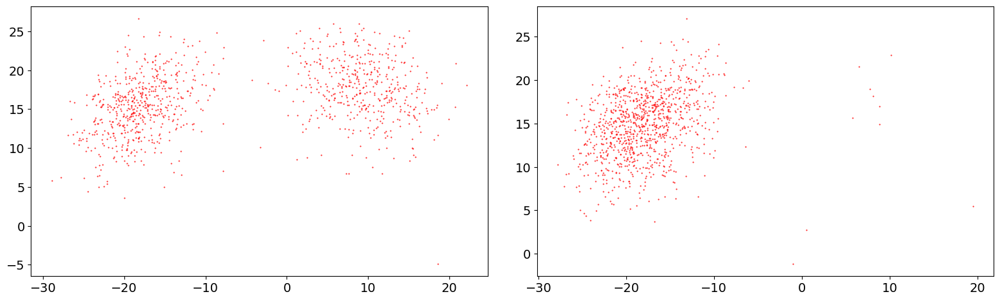

In [1021]:
I1 = np.transpose(temp_data['I'])[0]
Q1 = np.transpose(temp_data['Q'])[0]
I2 = np.transpose(temp_data['I'])[1]
Q2 = np.transpose(temp_data['Q'])[1]
fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))
fig.tight_layout()

axs[0].scatter(I1, Q1, label='e', color='r', marker='.', s=1)
axs[1].scatter(I2, Q2, label='e', color='r', marker='.', s=1)



In [761]:
I1

array([  8.4025974 , -21.00649351])

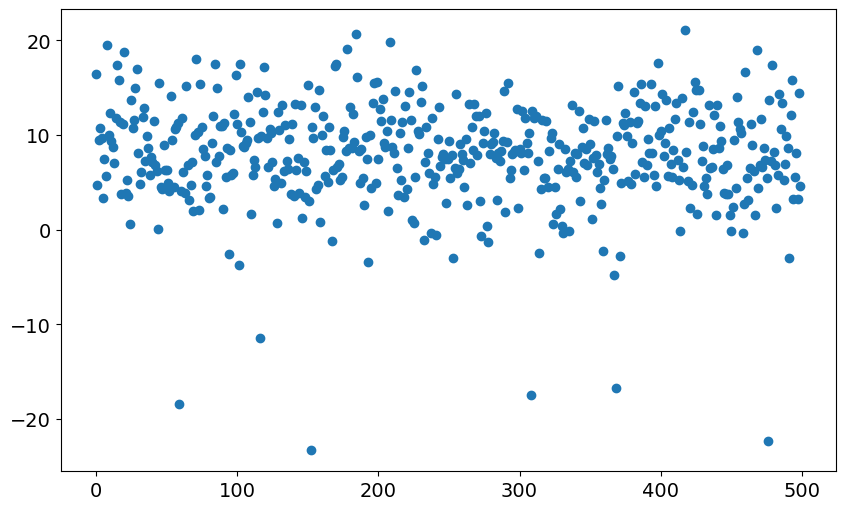

In [745]:
plt.plot(np.transpose(temp_data['I'])[0], 'o')